Notes:

First: Is there a way to see if an image is "inverted" without using ML
Can plot "features" to see if the image is inverted or not

Can ML be used to better identify quantity of scales?

TODO: also figure out a way of reducing the number of scales

Using statistics run hypothesis tests

Overview:

    The goal of this project is to create a tool that can automatically count the number of scales in an image of anoles skin. So far out approach has been one of an initial Image Segmentation: analysis of the data collected from that intial image segmentation through attention to the mean of the scale size and the number of scales. After that,we preform an adaptive segmentation choosing a block size based on the original data analysis.
    
OTSU SEGMENTAION:

    It is an algorithm returns a single intensity threshold that separate pixels into two classes, foreground and background. The way OTSU does this is by iterating through all possible threshold values. It chooses the threshold value that minimizes the sum spread of the color values of the forground and the background after the spread of the forground and background have been multipled by their respective weights (the weights show what percentage of the image the forground and background occupy per threshold) This value is called the Within Class Variance.

<img src="Otsu_visualization1.png"> 
   
MORE:

    The main issue with OTSU is that there seems to be a huge amount of noise. OTSU also does not seem to work well for images where that due to image quality are much darker in some places and much lighter in others: in such cases OTSU is unable to distinguish bettween the foregorund and background in those darker regions and gives usually an undercount. The thresholding errors can be seen with the following images. 
    
    OTSU is a type of simple thresholding: "in simple thresholding, the threshold value is global, i.e., it is same for all the pixels in the image. Adaptive thresholding is the method where the threshold value is calculated for smaller regions and therefore, there will be different threshold values for different regions." "The assumption behind local thresholding is that smaller image regions are more likely to have approximately uniform illumination, thus being more suitable for thresholding."

OTHER TYPES OF THRESHOLDING ALGORITHIMS:

    Adaptive thesholdhing divides the image into subpart/neigborhoods and then applies either a ADAPTIVE_THRESH_MEAN or ADAPTIVE_THRESH_GAUSSIAN to the image: it either takes the mean pixel value of the neighborhood and uses it as the threshold values or takes the weighted sum of the pixel values. This is still not ideal: the neighborhood size has to be chosen carefully. Big niegborhoods may ignore the need for adaptive thresholding in the first place and result in the same issues that OTSU has with images that have uneven illumination. Small neighborhoods can result in a broken up image and in the case of scales, an overcount.
    



Data that may be useful to collect:
    The uniformity of the scales OTSU is able to detect
        - Can be measured by the SD of the distance between the scales: Can plot this
        - The SD of the size of the scales
        - 

The following code creates a heat map for each of the images. It attempts to see the distribution: the density, of the dots.

In [1]:
import cv2
import numpy as np
from datascience import *
import matplotlib as mpl
from matplotlib import pyplot as plt
import sys
import os
import warnings
warnings.filterwarnings('ignore')
%matplotlib inline
import matplotlib.pyplot as plt
mpl.rcParams['figure.dpi'] = 120
from IPython.display import set_matplotlib_formats
set_matplotlib_formats('retina')
import pandas

In [2]:
images = []
labeled_imgs = []
original_img = []
original_img1 = []
filter_img = []
image_names = []

In [3]:
#access img directory
dirname = 'Anolis_cristatellus_images/'


#create an iterator object for img directory
directory = os.scandir(dirname)

In [4]:
def invert(img):
    return cv2.bitwise_not(img)

Anolis_cristatellus_images/212019Ventral-NoFlash-3.png
Anolis_cristatellus_images/212019Dorsal-NoFlash-2.png
Anolis_cristatellus_images/251165Ventral-NoFlash-2.png
Anolis_cristatellus_images/251165Ventral-Flash-3.png
Anolis_cristatellus_images/212018Dorsal-NoFlash-3.png
Anolis_cristatellus_images/212018Dorsal-NoFlash-2.png
Anolis_cristatellus_images/214993Dorsal-NoFlash-1.png
Anolis_cristatellus_images/251165Ventral-Flash-2.png
Anolis_cristatellus_images/251165Ventral-NoFlash-3.png
Anolis_cristatellus_images/212019Dorsal-NoFlash-3.png
Anolis_cristatellus_images/212019Ventral-NoFlash-2.png
Anolis_cristatellus_images/212019Dorsal-NoFlash-1.png
Anolis_cristatellus_images/251165Ventral-NoFlash-1.png
Anolis_cristatellus_images/214993Dorsal-NoFlash-3.png
Anolis_cristatellus_images/212018Dorsal-NoFlash-1.png
Anolis_cristatellus_images/214993Dorsal-NoFlash-2.png
Anolis_cristatellus_images/251165Ventral-Flash-1.png
Anolis_cristatellus_images/212019Ventral-NoFlash-1.png
Anolis_cristatellus_image

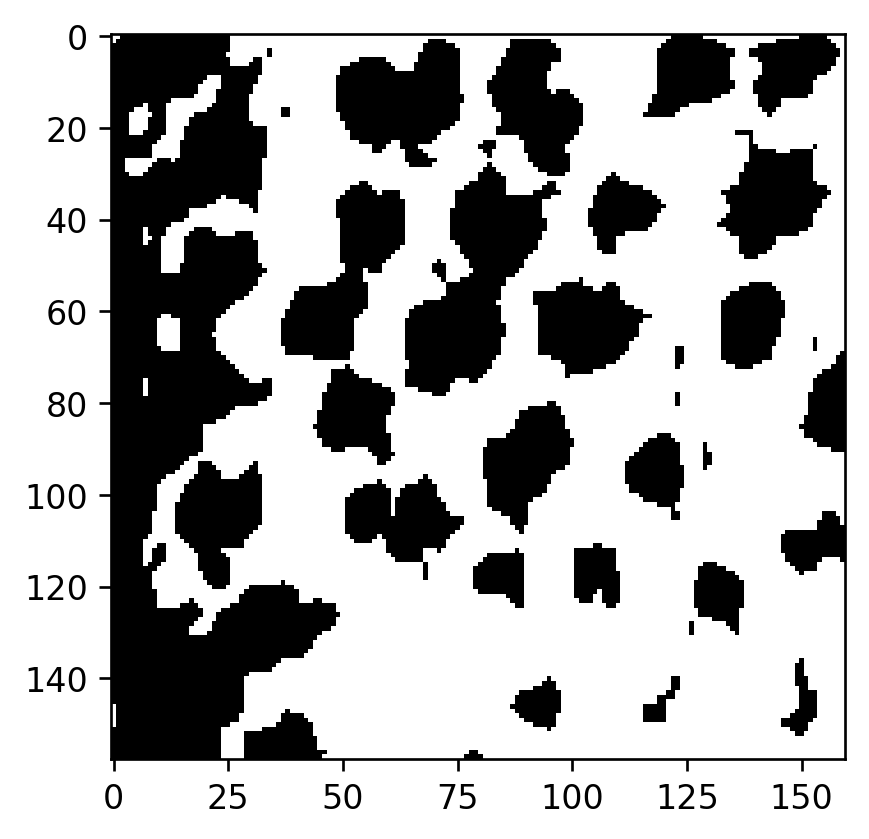

In [5]:
#a different approach: if image has gradient can we split the image up then merge them together: how would we 
#identify where to split the image? --> for loop
#how to measure "density"

heat_maps = []
for img in directory:
    img_name = img.name
    if (img_name != '.ipynb_checkpoints'):
        print(dirname + img_name + "")
        
        orig_img = cv2.imread(dirname + img_name)
        gray = cv2.cvtColor(orig_img, cv2.COLOR_BGR2GRAY)
        img = gray

        ret, thresh = cv2.threshold(img, 0 , 255, cv2.THRESH_BINARY+cv2.THRESH_OTSU)
        #true color of image in RGB
        color = cv2.cvtColor(orig_img, cv2.COLOR_BGR2RGB)

        img = thresh
        plt.imshow(img, "gray")
        images.append(img )        

In [33]:

def centroids(img, average_size, stds):
    average_size = []
    sizes_of_scales = []
    num_scales_and_average_size = []
    total_stats = []

    binary_map = (img > 0).astype(np.uint8)
    connectivity = 4 # or whatever you prefer
    output = cv2.connectedComponentsWithStats(binary_map, connectivity, cv2.CV_32S) 
    num_labels = output[0]

    # The second cell is the label matrix
    labels = output[1]
    # The third cell is the stat matrix
    stats = output[2]
    # The fourth cell is the centroid matrix
    centroids = output[3]

    sizes_of_scales.append((stats[1:,-1]))
    num_scales_and_average_size.append(([num_labels, np.average(stats[1:,-1])]))
    average_size = np.average(stats[1:,-1])
    total_stats.append([num_labels, stats[1:,-1], stats[1:,-1]])
    
    
    print("SCALE NUM", num_scales_and_average_size[0])
    print("Average Size", average_size)
    print("CENTROID NUM", len(centroids))
    print(centroids)
    return average_size, centroids, stats[1:,-1]

    

In [34]:
def heat_map(img, centroids):
    heat = np.zeros(img.shape)    
    img = heat
    print(len(centroids))
    for i in range(len(centroids)):## draw pixels
        x = centroids[i][1].astype(int)
        y = centroids[i][0].astype(int)
        heat[x - 3, y - 3] += 200
    return heat

In [35]:
def display(heat_maps):
    for img in heat_maps:
        plt.imshow(img)
    plt.show()

SCALE NUM [14, 74.53846153846153]
Average Size 74.53846153846153
CENTROID NUM 14
[[27.32763158 27.82236842]
 [ 8.7         1.4       ]
 [26.63636364  2.36363636]
 [42.          0.84615385]
 [53.19753086 12.82716049]
 [40.12396694 15.80991736]
 [24.13513514 17.87837838]
 [ 6.44785276 25.23312883]
 [23.5        27.        ]
 [51.44537815 35.92436975]
 [37.23809524 38.82857143]
 [22.04347826 41.30434783]
 [ 8.46078431 49.20588235]
 [48.5106383  52.61702128]]
SCALE NUM [11, 37.8]
Average Size 37.8
CENTROID NUM 11
[[29.25182863 27.96969697]
 [16.44047619  8.28571429]
 [ 3.33333333 11.27777778]
 [30.66666667 10.83333333]
 [13.87654321 32.43209877]
 [43.375      27.75      ]
 [26.         33.        ]
 [ 1.         36.        ]
 [29.70588235 52.82352941]
 [16.55555556 53.44444444]
 [ 0.5        55.5       ]]
14
11


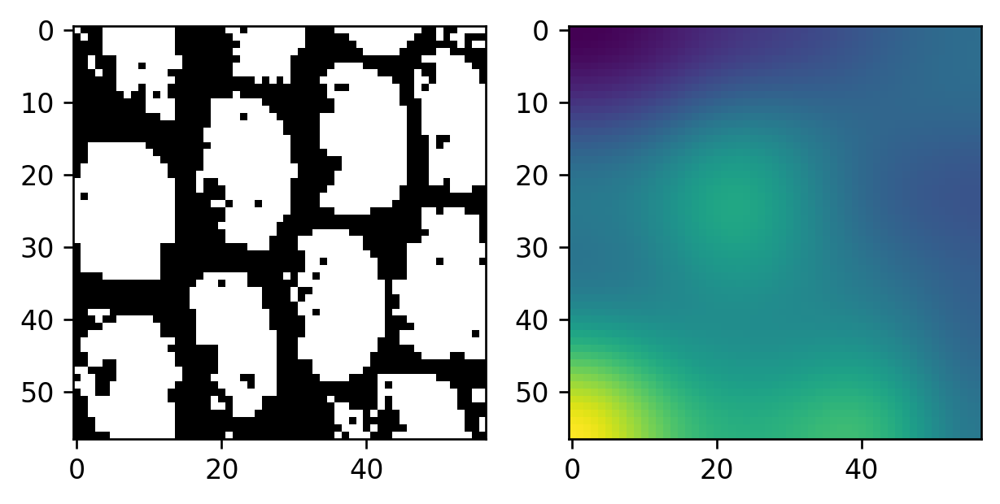

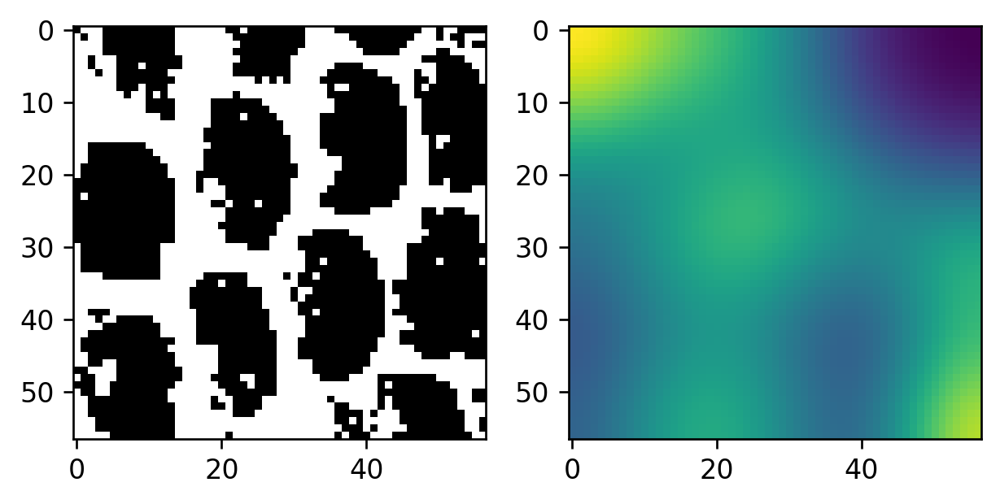

SCALE NUM [6, 11.6]
Average Size 11.6
CENTROID NUM 6
[[26.85406134 27.0529154 ]
 [36.         12.        ]
 [24.83333333 17.33333333]
 [48.         23.        ]
 [26.5        25.5       ]
 [53.125      53.125     ]]
SCALE NUM [17, 22.375]
Average Size 22.375
CENTROID NUM 17
[[26.57292838 26.09373828]
 [ 3.          1.5       ]
 [28.          0.5       ]
 [35.          0.5       ]
 [48.70967742  1.51612903]
 [40.         26.5       ]
 [15.78378378 32.24324324]
 [27.91919192 36.05050505]
 [ 1.         32.        ]
 [50.6        35.4       ]
 [40.77777778 41.44444444]
 [50.         43.        ]
 [17.         45.        ]
 [33.35483871 51.70967742]
 [43.5        49.        ]
 [ 8.64705882 53.23529412]
 [21.5        53.        ]]
6
17


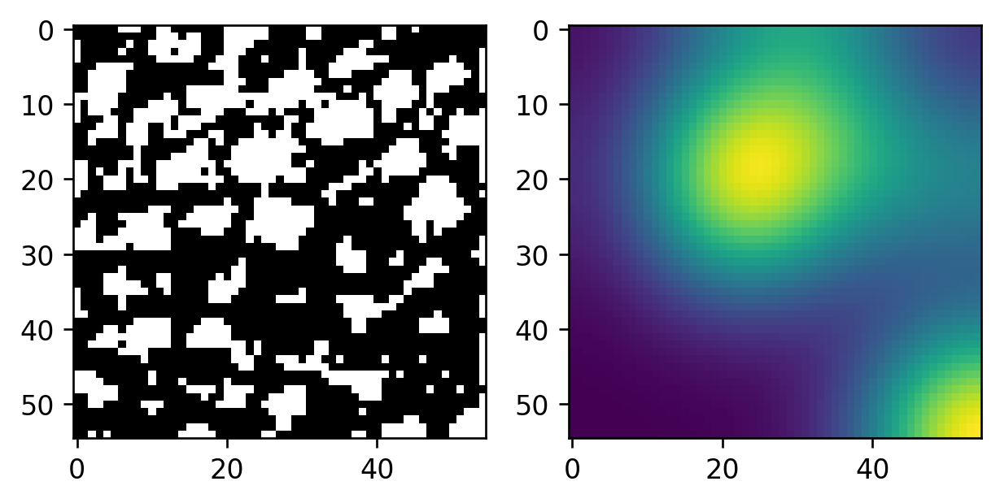

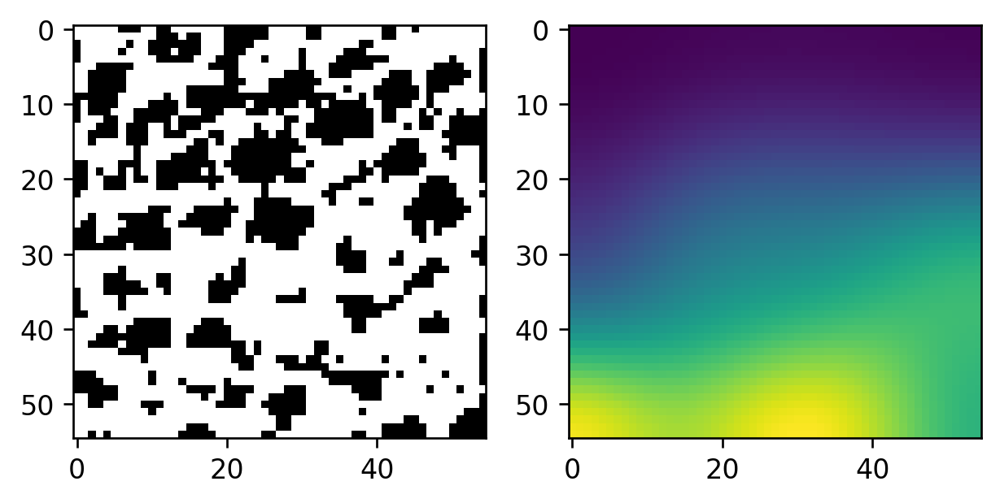

SCALE NUM [9, 864.25]
Average Size 864.25
CENTROID NUM 9
[[ 83.60037667  69.83039805]
 [125.87401575  11.11023622]
 [ 16.34365325  45.87100103]
 [ 43.45454545  67.95454545]
 [ 79.09131262 115.02874657]
 [119.          72.        ]
 [ 28.93478261  79.67391304]
 [ 36.4        102.5       ]
 [145.92150538 147.59784946]]
SCALE NUM [5, 4094.25]
Average Size 4094.25
CENTROID NUM 5
[[ 76.92949033 103.59825199]
 [ 85.96603103  64.21662886]
 [ 95.59375    116.625     ]
 [ 67.5        154.        ]
 [ 94.         153.5       ]]
9
5


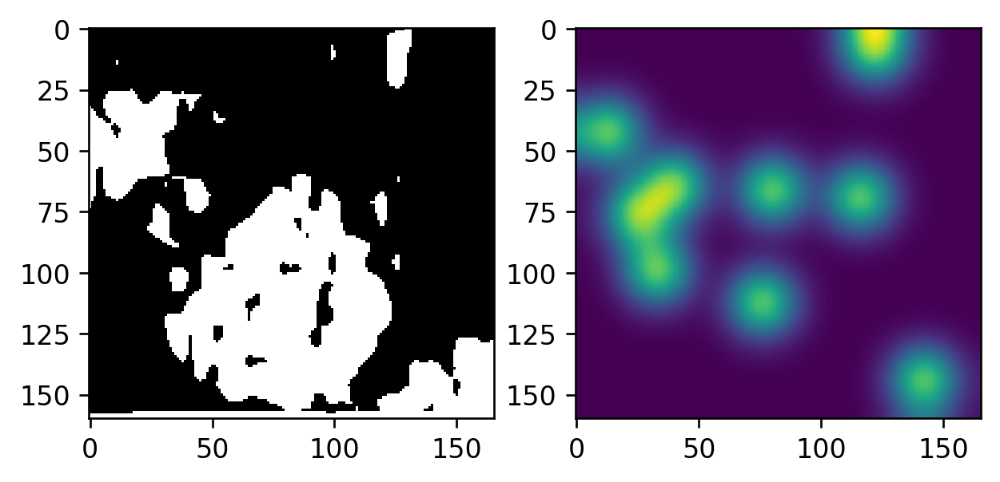

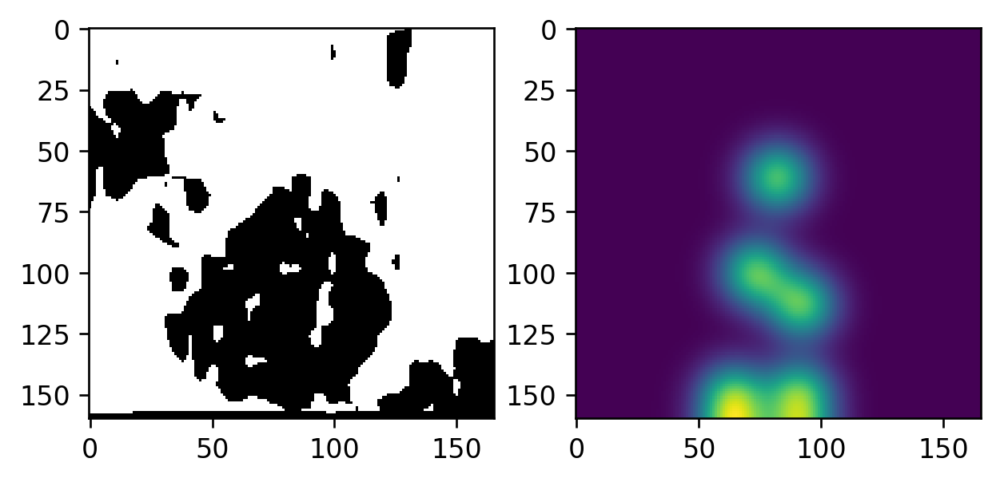

SCALE NUM [12, 778.2727272727273]
Average Size 778.2727272727273
CENTROID NUM 12
[[ 82.31914361  71.87234255]
 [113.           0.5       ]
 [126.25925926   1.81481481]
 [  3.67114094  31.58389262]
 [ 22.65021459  27.06223176]
 [ 63.7704918   18.04918033]
 [ 82.86004057  95.21230561]
 [123.58823529  53.05882353]
 [142.90336912 142.58311736]
 [ 33.11111111 158.33560091]
 [ 61.54444444 160.77777778]
 [  3.17647059 164.23529412]]
SCALE NUM [8, 2283.714285714286]
Average Size 2283.714285714286
CENTROID NUM 8
[[ 89.0599236  100.87259271]
 [ 82.67849937  67.76424968]
 [ 11.          26.        ]
 [ 96.16666667 101.84722222]
 [ 54.         108.5       ]
 [ 69.         118.5       ]
 [151.         124.5       ]
 [ 53.         161.        ]]
12
8


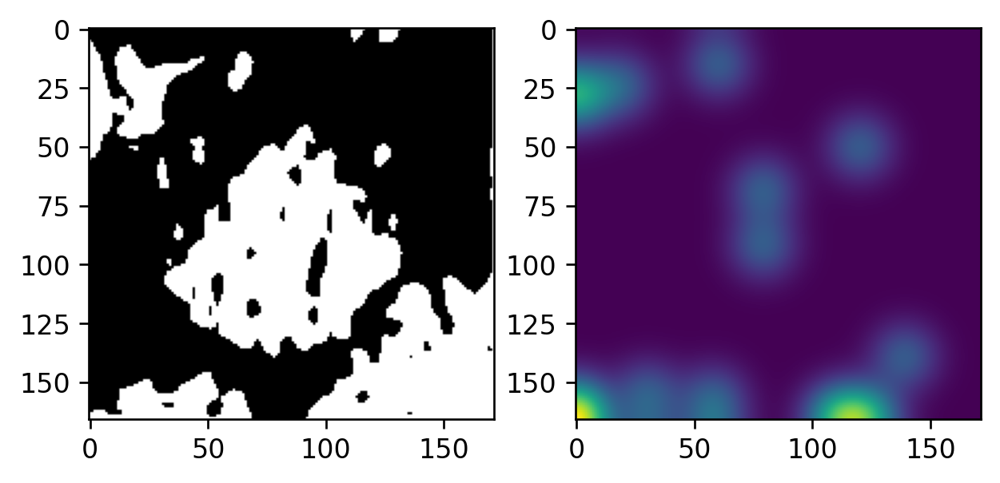

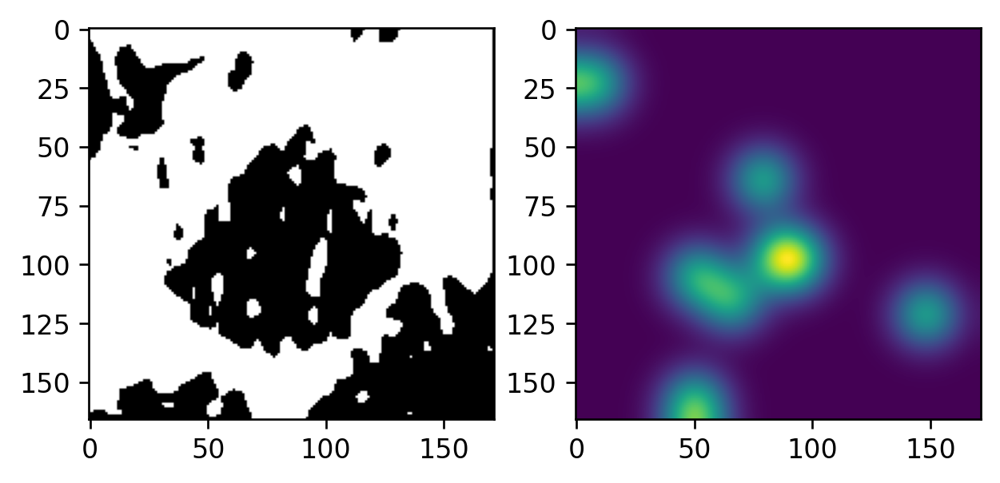

SCALE NUM [5, 9.75]
Average Size 9.75
CENTROID NUM 5
[[27.06141249 26.45649949]
 [ 1.          1.5       ]
 [ 0.5         9.        ]
 [45.6        51.6       ]
 [29.         52.5       ]]
SCALE NUM [10, 15.0]
Average Size 15.0
CENTROID NUM 10
[[26.8335097  26.15767196]
 [53.5        12.        ]
 [ 9.825      29.95      ]
 [48.4        27.6       ]
 [39.         29.        ]
 [23.         31.        ]
 [52.5        32.        ]
 [23.         40.        ]
 [10.         52.        ]
 [52.5        51.5       ]]
5
10


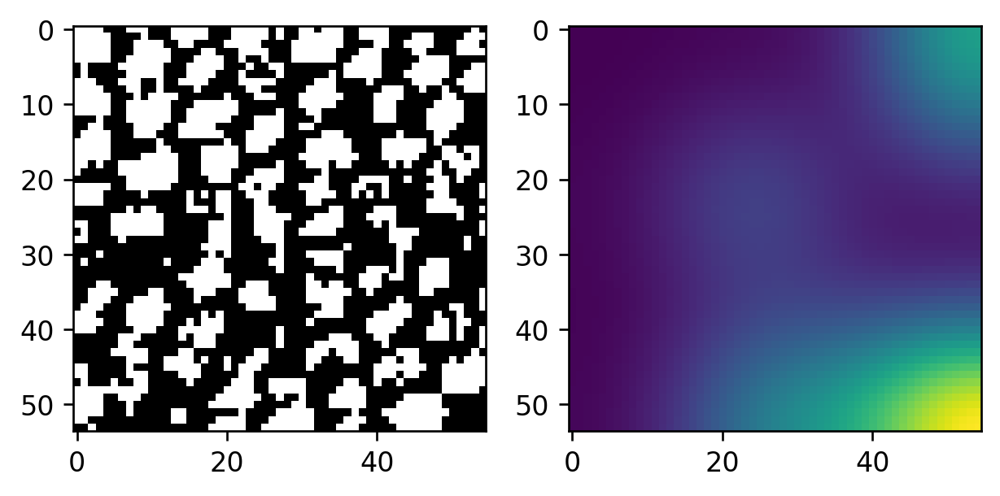

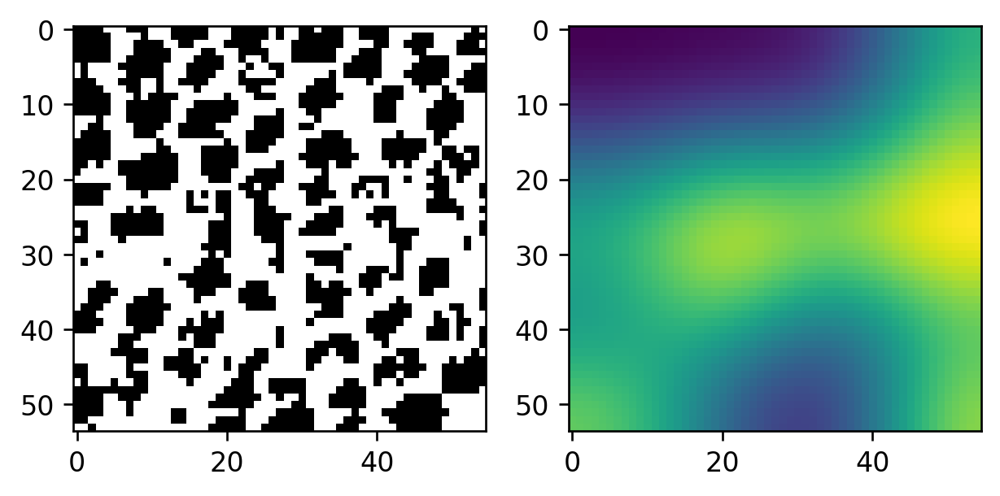

SCALE NUM [5, 6.75]
Average Size 6.75
CENTROID NUM 5
[[26.8388926  27.05403602]
 [53.          0.5       ]
 [53.5        19.        ]
 [28.         26.        ]
 [53.5        36.        ]]
SCALE NUM [9, 18.0]
Average Size 18.0
CENTROID NUM 9
[[26.96737244 26.68205484]
 [ 0.5         0.5       ]
 [10.5         1.        ]
 [22.          2.        ]
 [36.          0.5       ]
 [ 8.         11.        ]
 [36.46341463 48.95121951]
 [ 4.         53.5       ]
 [13.         53.5       ]]
5
9


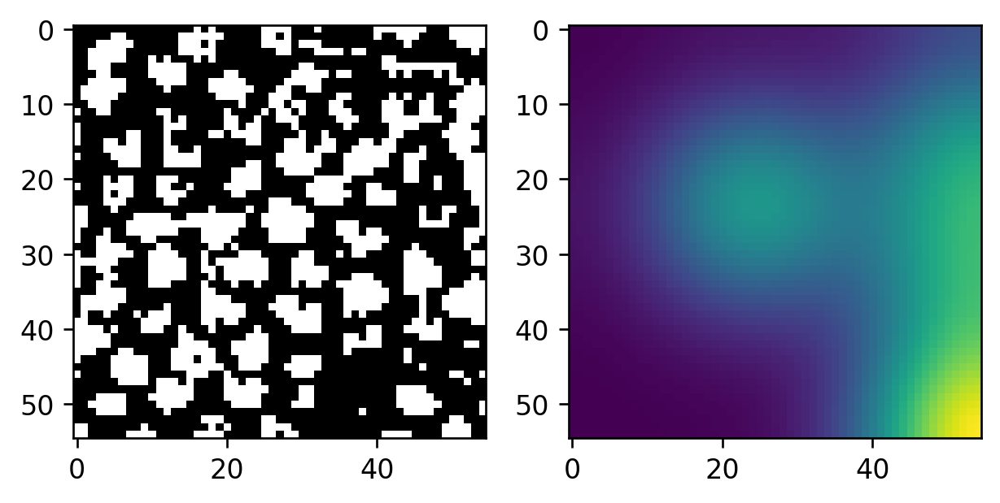

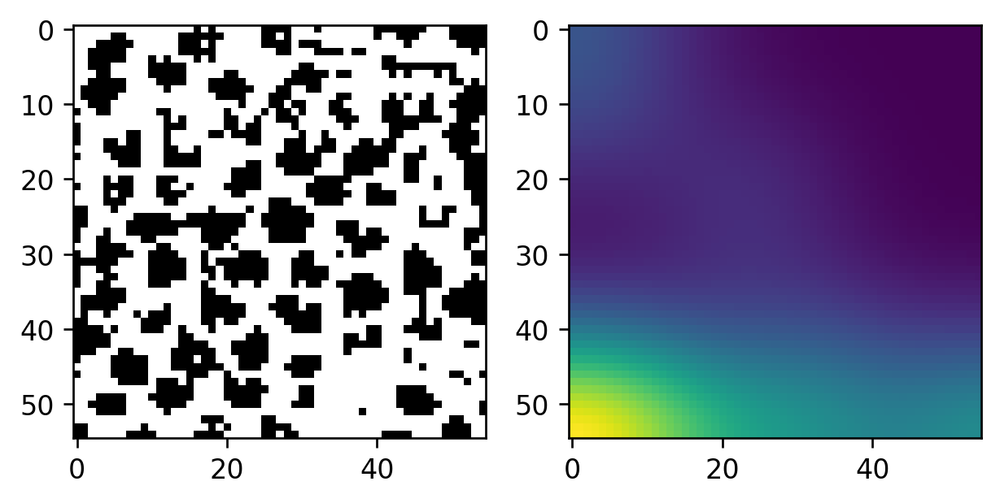

SCALE NUM [2, 9.0]
Average Size 9.0
CENTROID NUM 2
[[26.48328267 26.98176292]
 [32.         33.        ]]
SCALE NUM [13, 14.416666666666666]
Average Size 14.416666666666666
CENTROID NUM 13
[[26.26099392 27.47979979]
 [27.          0.5       ]
 [38.          0.5       ]
 [ 0.96153846  5.84615385]
 [32.09090909  7.09090909]
 [50.          5.5       ]
 [21.16666667  7.33333333]
 [42.68965517  9.27586207]
 [46.         22.        ]
 [43.95652174 51.39130435]
 [ 0.5        53.5       ]
 [20.         53.        ]
 [34.         53.        ]]
2
13


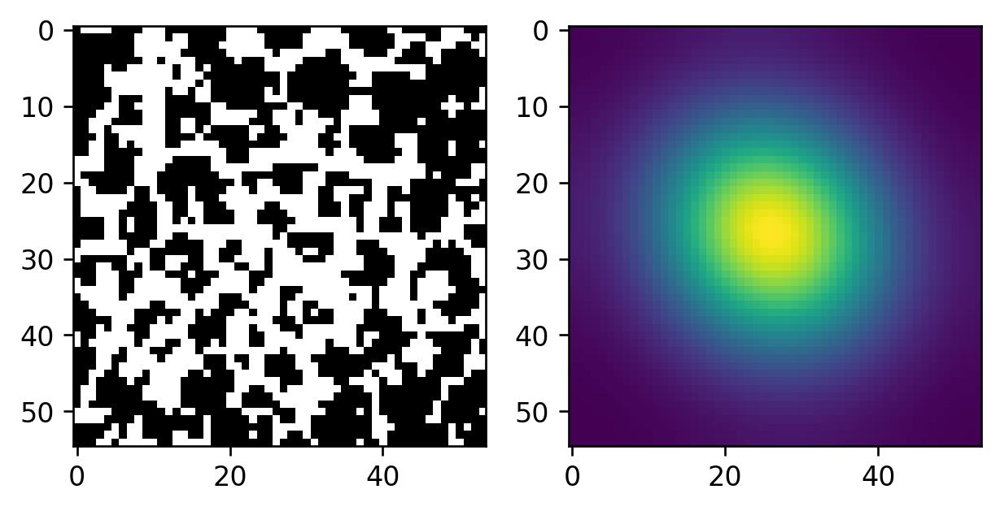

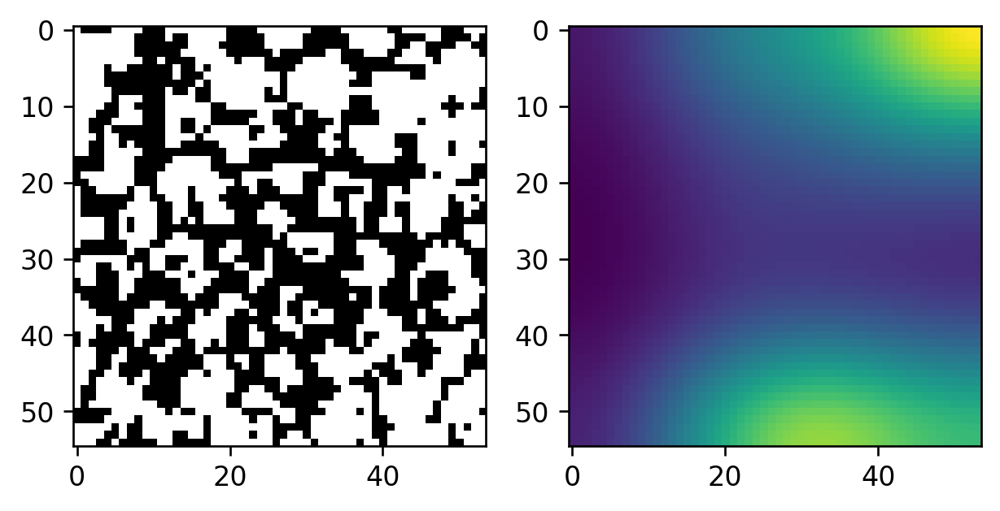

SCALE NUM [8, 1207.7142857142858]
Average Size 1207.7142857142858
CENTROID NUM 8
[[ 85.22214333  72.58340434]
 [127.88452088  12.81818182]
 [101.6         13.4       ]
 [155.62195122  32.67886179]
 [ 45.98900344  69.55463918]
 [122.18518519  80.55555556]
 [103.29519369 113.90853659]
 [ 87.65955631 151.22354949]]
SCALE NUM [12, 1468.4545454545455]
Average Size 1468.4545454545455
CENTROID NUM 12
[[ 90.9980636  105.2626052 ]
 [ 82.32094658  67.04462997]
 [172.          13.5       ]
 [156.5         40.57142857]
 [ 32.28571429  61.42857143]
 [ 52.5         73.5       ]
 [ 99.9047619   84.55555556]
 [127.          86.        ]
 [122.42105263  90.89473684]
 [127.         139.5       ]
 [122.4        160.6       ]
 [161.         161.        ]]
8
12


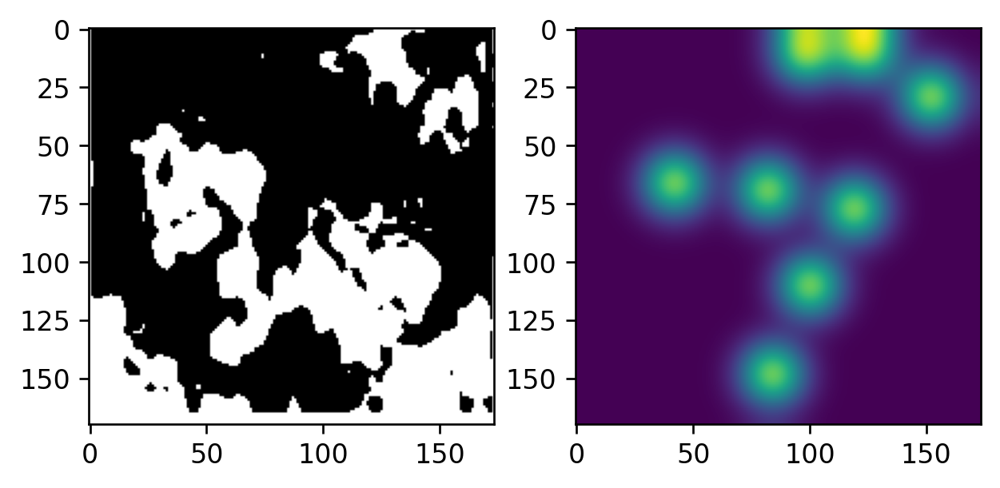

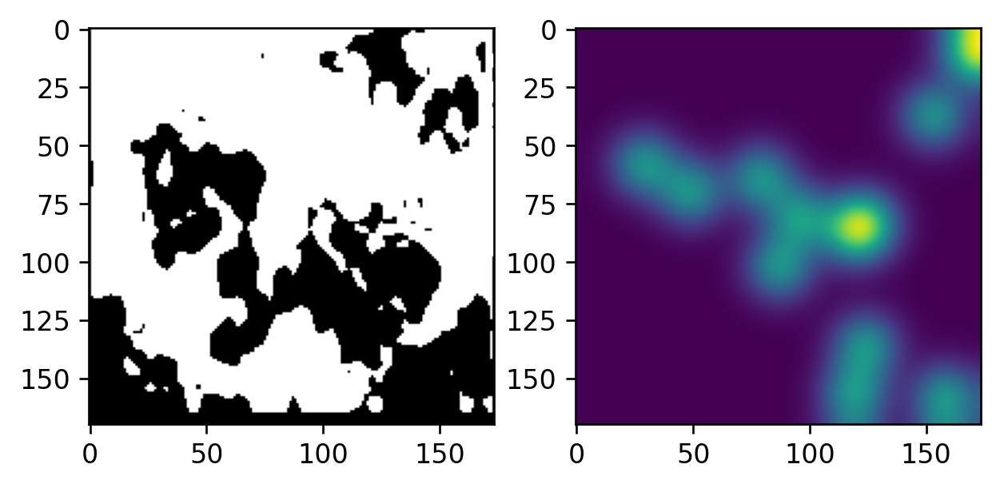

SCALE NUM [12, 445.0]
Average Size 445.0
CENTROID NUM 12
[[ 80.10363205  75.3387523 ]
 [122.8         36.4141844 ]
 [150.33333333  18.16666667]
 [157.51813472  59.08290155]
 [ 31.63539823  93.70088496]
 [149.17241379  78.74712644]
 [109.16604128 137.60037523]
 [ 54.67857143 126.57142857]
 [141.4516129  133.61290323]
 [ 73.62931034 145.80172414]
 [  4.8115942  156.84782609]
 [156.57939914 155.11587983]]
SCALE NUM [6, 3677.8]
Average Size 3677.8
CENTROID NUM 6
[[ 95.15099038 102.68341822]
 [ 76.1715456   71.20021846]
 [164.5         43.5       ]
 [164.16666667  56.88888889]
 [ 26.          92.        ]
 [136.425      137.45      ]]
12
6


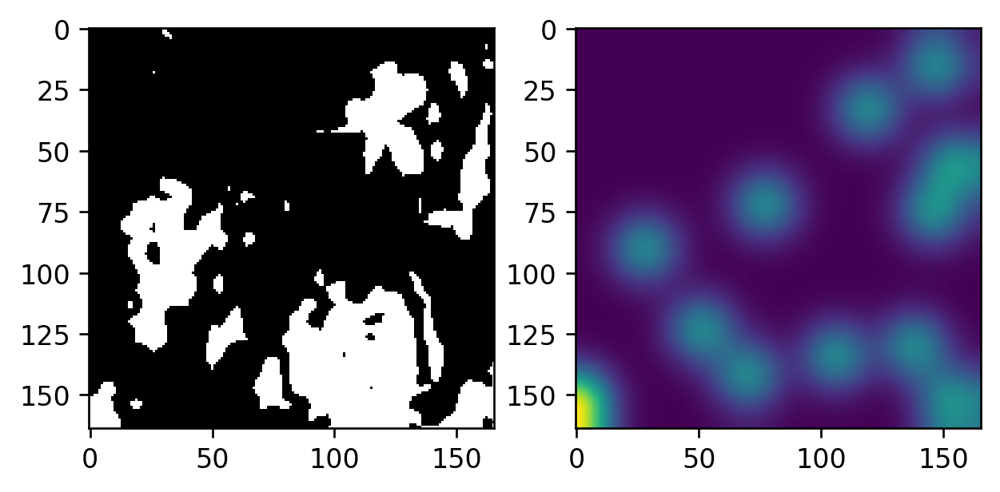

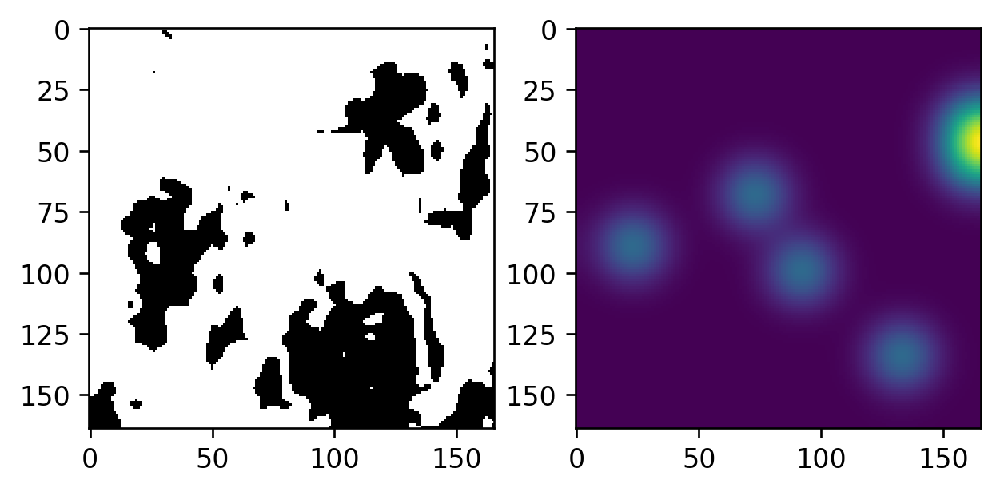

SCALE NUM [5, 10.75]
Average Size 10.75
CENTROID NUM 5
[[27.57419981 27.77756224]
 [16.          0.5       ]
 [39.5         1.5       ]
 [19.         13.        ]
 [ 4.5        15.        ]]
SCALE NUM [16, 38.4]
Average Size 38.4
CENTROID NUM 16
[[26.92382812 28.1984375 ]
 [10.61971831  6.28169014]
 [49.08474576  6.89830508]
 [34.          9.        ]
 [29.07792208 22.2012987 ]
 [46.65178571 23.72321429]
 [ 8.79411765 29.05882353]
 [ 1.25       38.625     ]
 [32.10526316 38.84210526]
 [10.         41.5       ]
 [22.5        41.        ]
 [54.28571429 47.42857143]
 [16.         46.        ]
 [23.         47.        ]
 [33.         50.        ]
 [21.5        54.5       ]]
5
16


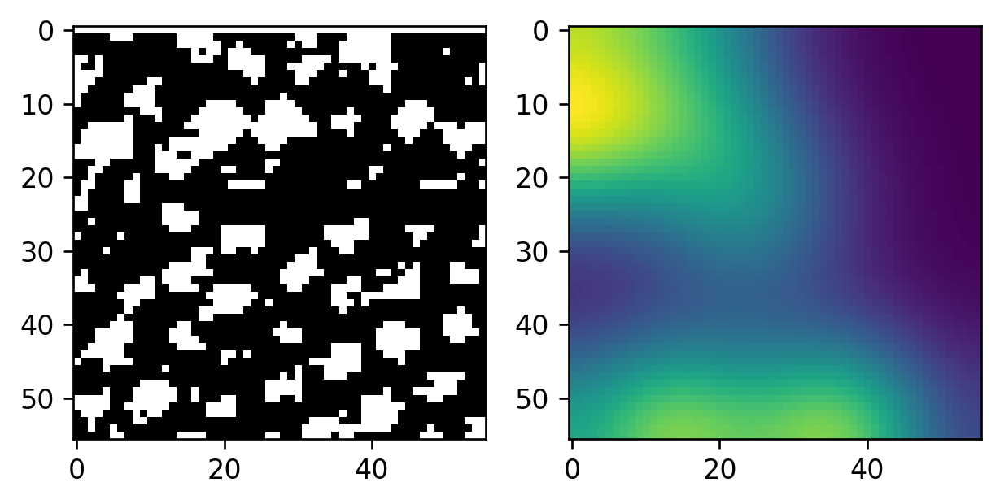

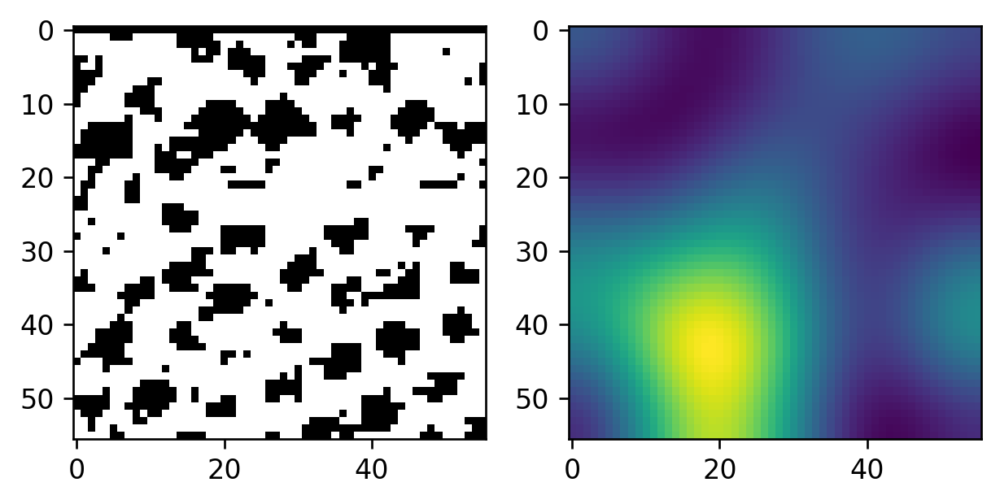

SCALE NUM [14, 77.15384615384616]
Average Size 77.15384615384616
CENTROID NUM 14
[[25.57433291 26.51207116]
 [23.63333333  1.56666667]
 [38.          0.5       ]
 [51.87068966  8.93965517]
 [36.584      16.536     ]
 [22.41176471 14.94117647]
 [12.63934426 24.52459016]
 [25.52       28.72      ]
 [52.032      31.704     ]
 [ 0.5        31.5       ]
 [41.         37.625     ]
 [13.40361446 46.95180723]
 [31.84347826 50.50434783]
 [50.99375    51.36875   ]]
SCALE NUM [12, 27.636363636363637]
Average Size 27.636363636363637
CENTROID NUM 12
[[29.69771242 29.34346405]
 [ 2.07317073 12.6097561 ]
 [31.5         1.5       ]
 [43.          0.5       ]
 [41.          6.        ]
 [28.12903226  9.90322581]
 [20.         22.        ]
 [56.5        21.5       ]
 [34.16326531 32.89795918]
 [ 7.         34.5       ]
 [ 2.37931034 42.48275862]
 [23.5        43.        ]]
14
12


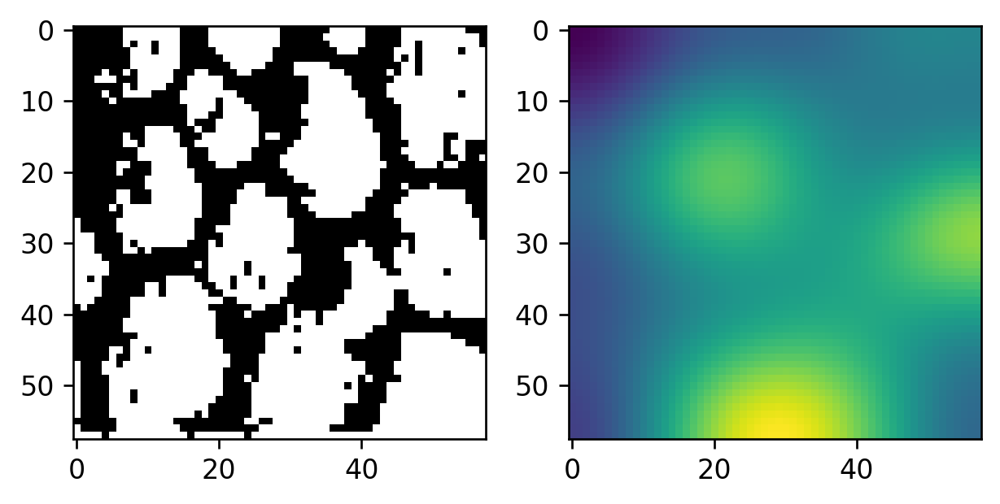

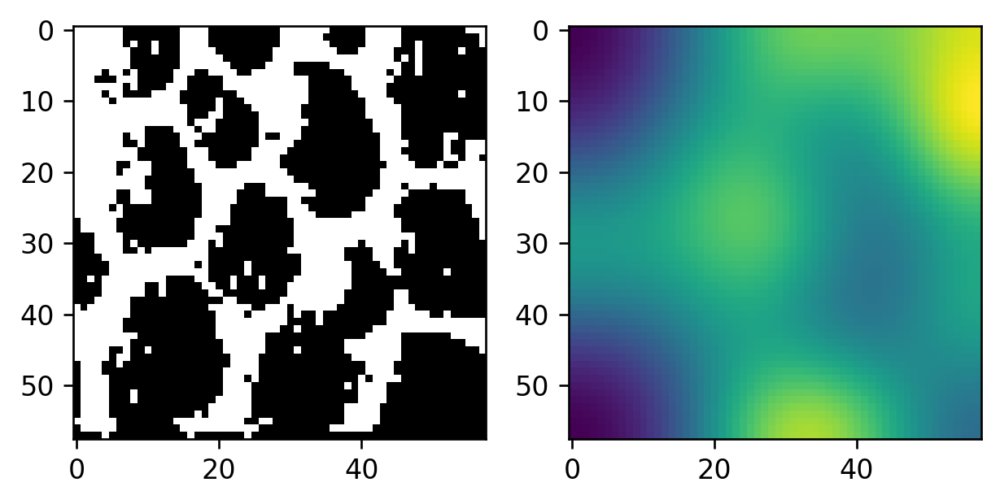

SCALE NUM [4, 13.333333333333334]
Average Size 13.333333333333334
CENTROID NUM 4
[[26.91423786 26.81105528]
 [47.5        22.5       ]
 [19.         53.5       ]
 [39.         53.5       ]]
SCALE NUM [15, 22.071428571428573]
Average Size 22.071428571428573
CENTROID NUM 15
[[26.70802651 27.60530191]
 [ 7.          0.5       ]
 [46.23762376  9.52475248]
 [53.125       0.875     ]
 [22.          7.        ]
 [36.5         7.        ]
 [ 2.63888889 28.30555556]
 [10.         23.        ]
 [53.5        24.        ]
 [28.5        29.        ]
 [34.5        33.        ]
 [49.         34.5       ]
 [24.         42.        ]
 [ 8.5        44.        ]
 [44.76470588 52.17647059]]
4
15


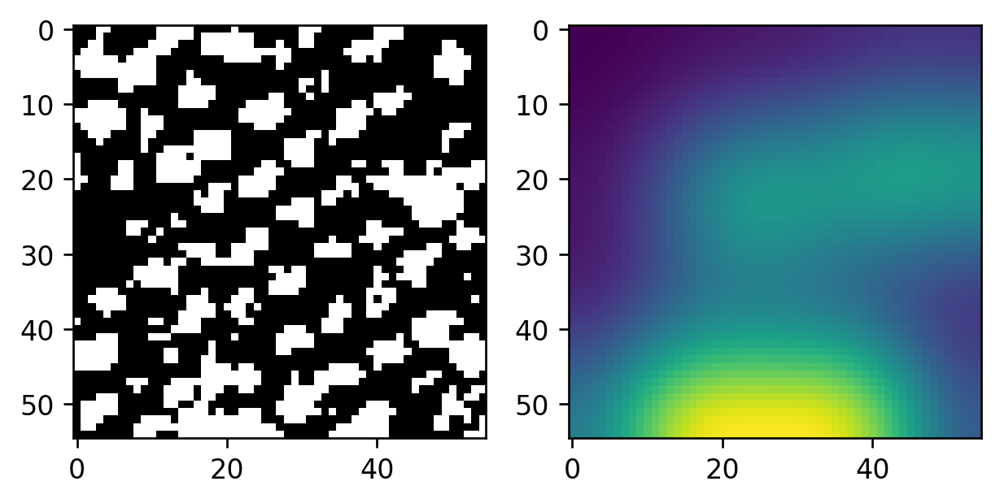

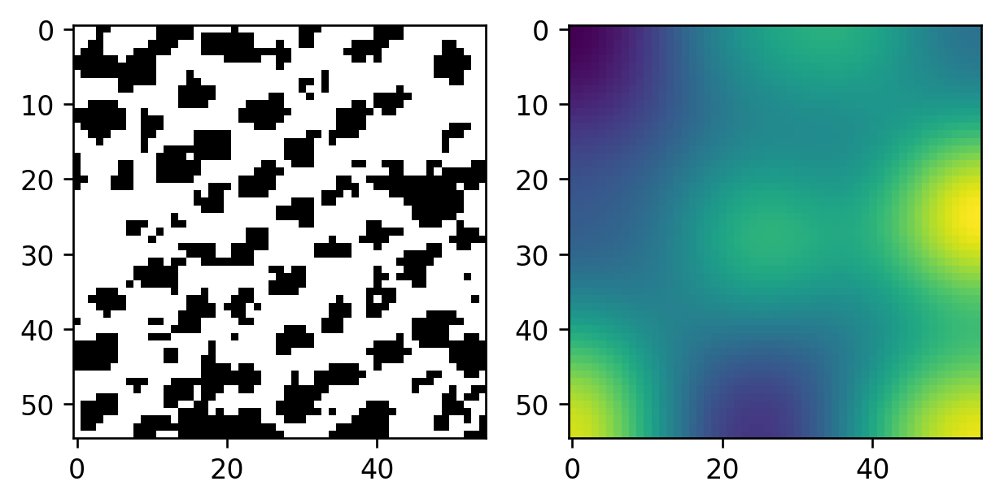

SCALE NUM [15, 581.0]
Average Size 581.0
CENTROID NUM 15
[[ 75.97698936  76.73000507]
 [  6.50518135  16.36528497]
 [ 45.89189189   2.59459459]
 [119.64600551  16.37465565]
 [ 59.6          3.4       ]
 [ 76.93397746  75.34702093]
 [110.          67.        ]
 [141.87142857  95.02857143]
 [108.65        98.4       ]
 [102.20655967 148.88695045]
 [ 36.5        141.        ]
 [ 24.6        148.4       ]
 [ 14.         152.        ]
 [160.42105263 162.92105263]
 [153.5        170.5       ]]
SCALE NUM [8, 2209.8571428571427]
Average Size 2209.8571428571427
CENTROID NUM 8
[[ 89.03743445 100.42839855]
 [ 73.97680531  72.58137854]
 [111.4          1.7       ]
 [126.5          2.        ]
 [ 94.4         89.6       ]
 [ 62.41176471 139.05882353]
 [ 25.63013699 159.32876712]
 [ 86.36111111 164.16666667]]
15
8


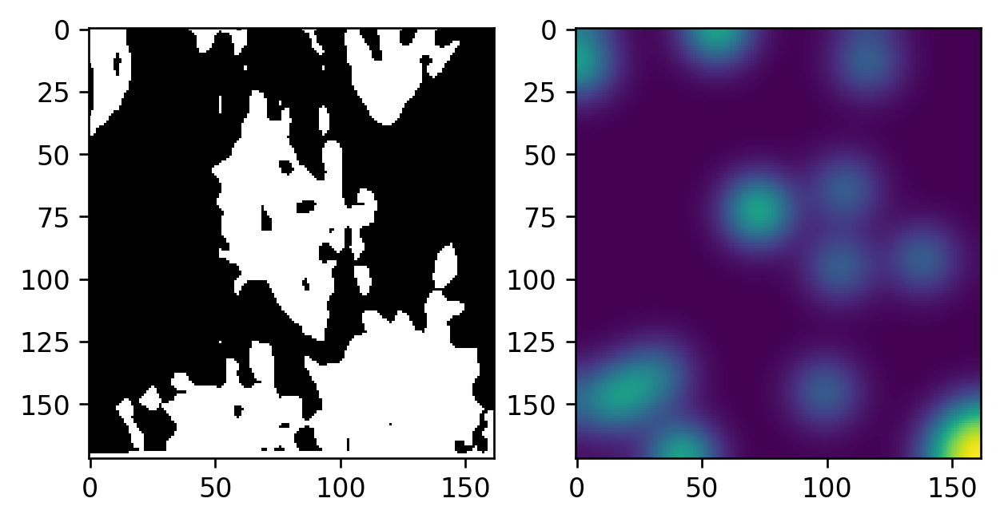

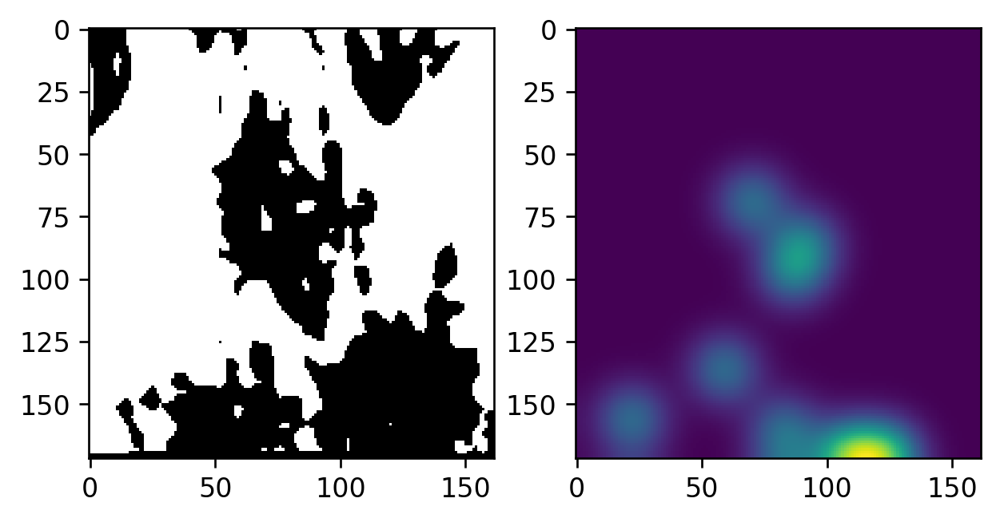

SCALE NUM [5, 8.5]
Average Size 8.5
CENTROID NUM 5
[[26.95921097 27.21297225]
 [26.85714286  0.92857143]
 [42.5         0.5       ]
 [53.5        13.        ]
 [ 0.5        31.        ]]
SCALE NUM [10, 15.88888888888889]
Average Size 15.88888888888889
CENTROID NUM 10
[[27.05725191 26.77376822]
 [39.         10.        ]
 [32.55555556 18.44444444]
 [ 6.         20.        ]
 [21.33333333 20.77777778]
 [14.5        27.5       ]
 [26.         29.        ]
 [18.70588235 52.70588235]
 [44.73913043 52.7826087 ]
 [ 6.5        53.5       ]]
5
10


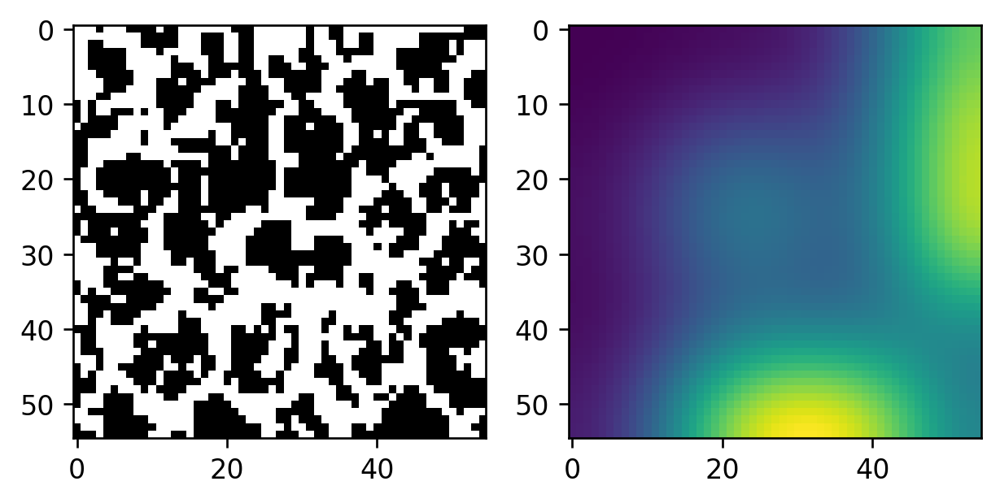

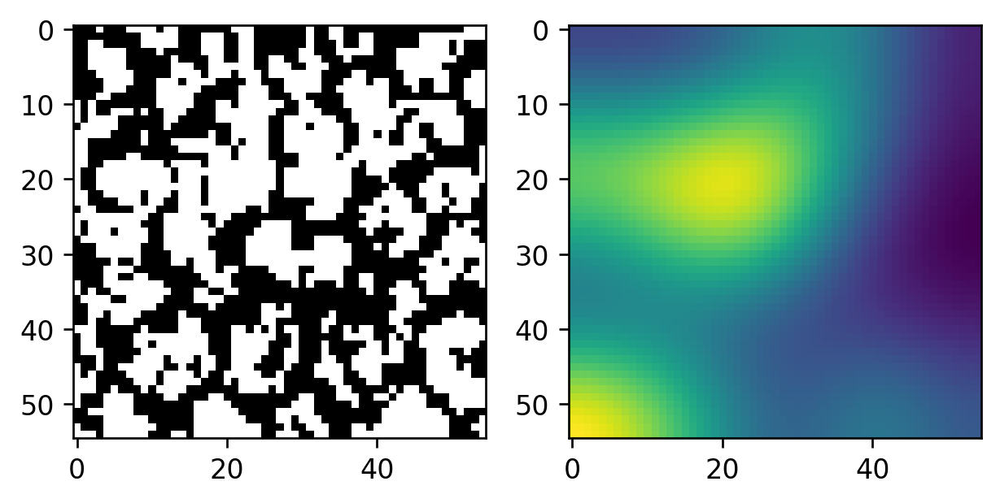

SCALE NUM [4, 10.666666666666666]
Average Size 10.666666666666666
CENTROID NUM 4
[[26.9390742  26.61402314]
 [53.5         1.5       ]
 [30.          4.        ]
 [23.         31.        ]]
SCALE NUM [8, 14.0]
Average Size 14.0
CENTROID NUM 8
[[27.55118384 26.27855153]
 [ 2.         13.5       ]
 [ 0.5        21.        ]
 [ 0.5        29.5       ]
 [35.         38.        ]
 [ 7.         40.5       ]
 [ 3.85714286 52.14285714]
 [51.         52.5       ]]
4
8


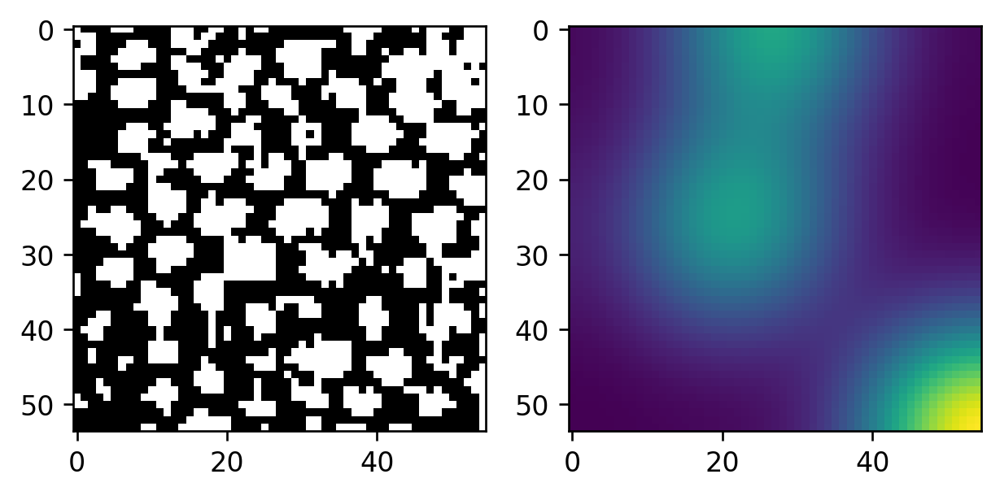

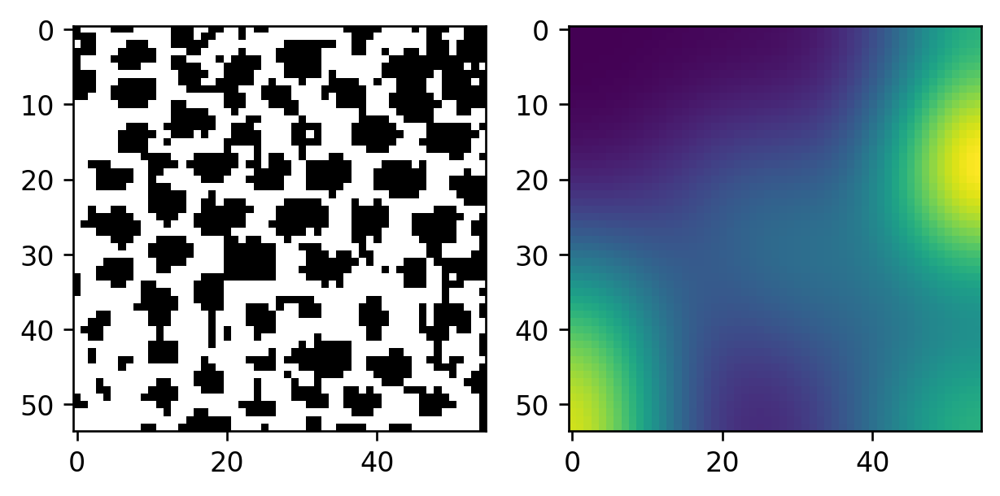

SCALE NUM [2, 6.0]
Average Size 6.0
CENTROID NUM 2
[[27.02226721 26.44736842]
 [16.         52.5       ]]
SCALE NUM [6, 11.4]
Average Size 11.4
CENTROID NUM 6
[[27.07174734 26.32990045]
 [40.5         3.        ]
 [14.         16.        ]
 [ 5.         48.5       ]
 [25.22222222 51.61111111]
 [34.         52.5       ]]
2
6


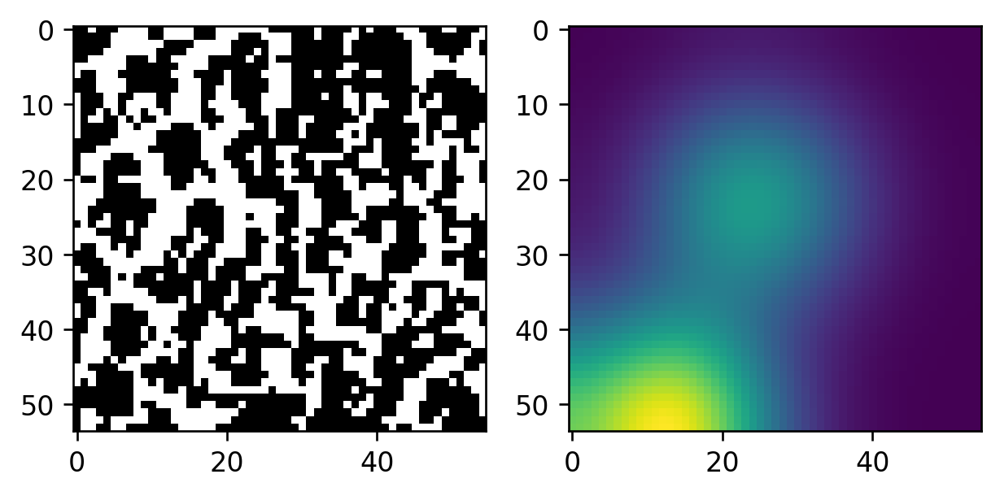

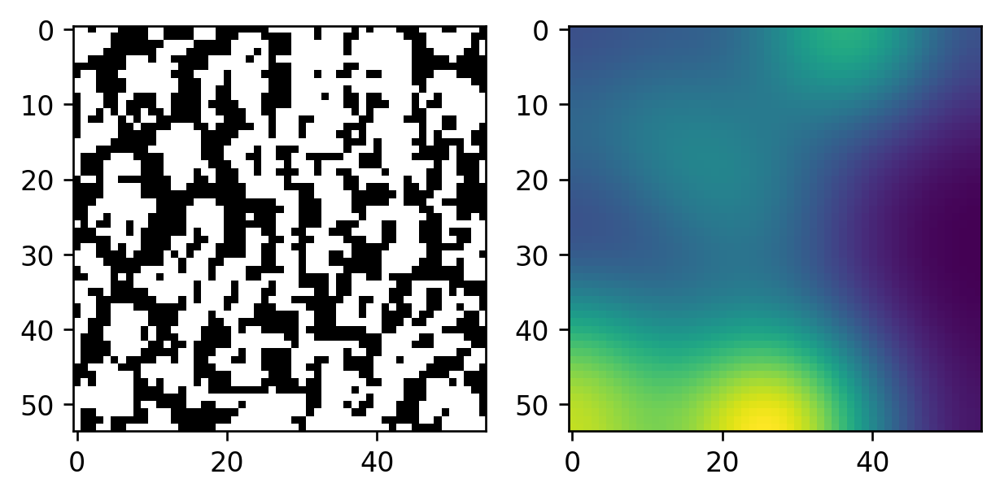

SCALE NUM [17, 426.6875]
Average Size 426.6875
CENTROID NUM 17
[[ 87.15601056  85.58599195]
 [ 30.82402792  23.30807577]
 [ 42.           0.5       ]
 [ 79.5         12.        ]
 [129.28985507  36.19130435]
 [169.89772727  44.10227273]
 [153.04761905  46.42857143]
 [ 77.78701299  76.34025974]
 [124.11940299  81.43283582]
 [129.30912863 121.96970954]
 [ 37.57874016 125.00787402]
 [ 17.5        119.5       ]
 [ 55.48739496 143.84033613]
 [ 87.32683983 157.21861472]
 [ 17.31578947 145.08421053]
 [ 44.         146.        ]
 [172.5        152.5       ]]
SCALE NUM [9, 2240.5]
Average Size 2240.5
CENTROID NUM 9
[[ 85.16652782  84.270993  ]
 [ 82.71776408  80.51974126]
 [  2.76271186  11.57627119]
 [ 44.90909091   5.95454545]
 [ 59.          10.        ]
 [ 22.          13.        ]
 [133.5        123.        ]
 [145.69788732 157.92816901]
 [ 94.         170.5       ]]
17
9


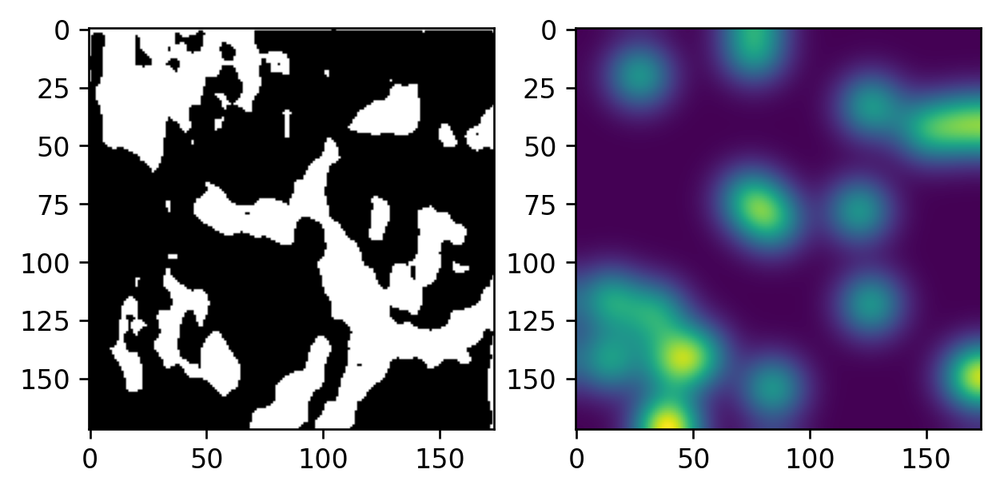

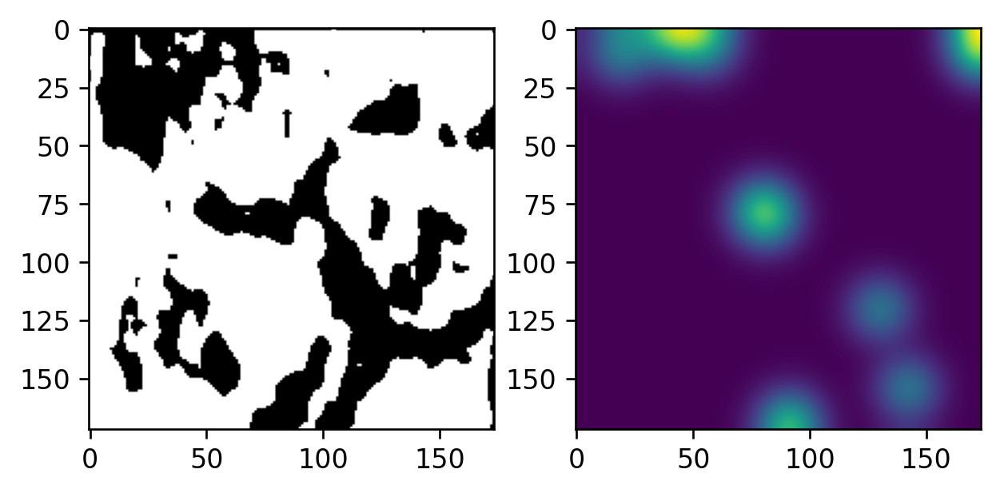

SCALE NUM [12, 88.27272727272727]
Average Size 88.27272727272727
CENTROID NUM 12
[[28.2405619  27.98463565]
 [27.76744186 10.59069767]
 [45.75        7.64473684]
 [ 1.15625    19.6875    ]
 [44.84615385 25.93269231]
 [12.74509804 27.34313725]
 [25.25203252 31.32520325]
 [37.2020202  41.76767677]
 [ 4.07407407 40.09259259]
 [55.5        44.        ]
 [17.24347826 48.64347826]
 [30.28       54.32      ]]
SCALE NUM [10, 17.22222222222222]
Average Size 17.22222222222222
CENTROID NUM 10
[[27.47026503 27.84615385]
 [35.5         0.5       ]
 [52.          0.5       ]
 [54.5         9.        ]
 [12.         10.        ]
 [22.5        19.        ]
 [35.         26.        ]
 [47.         42.5       ]
 [ 0.5        50.5       ]
 [48.39215686 51.90196078]]
12
10


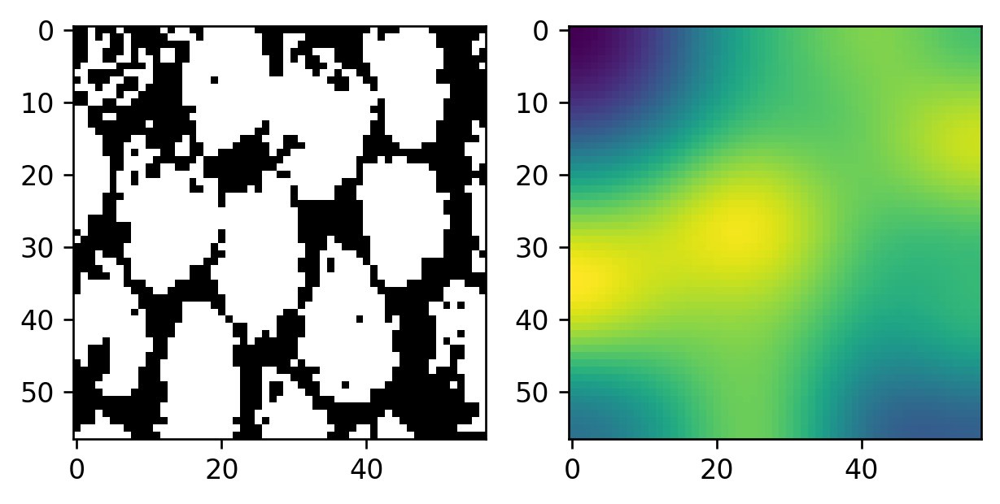

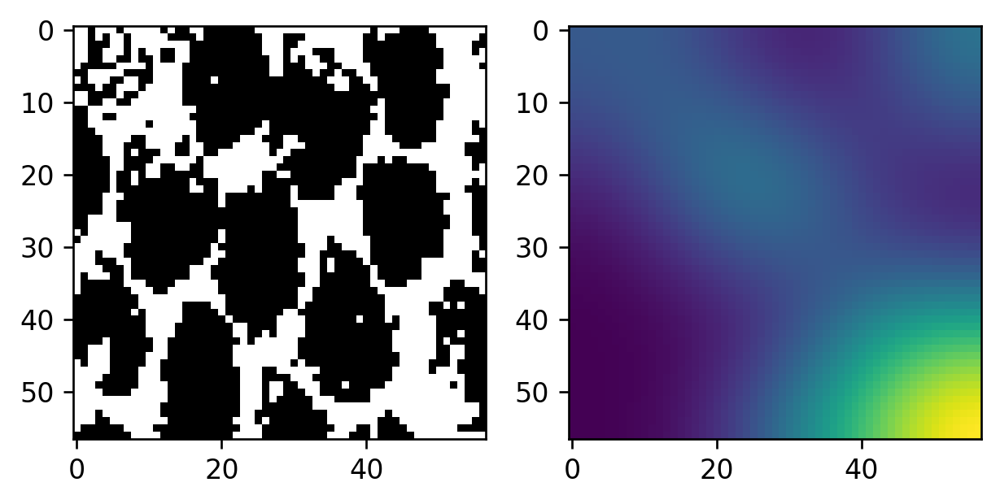

SCALE NUM [38, 145.32432432432432]
Average Size 145.32432432432432
CENTROID NUM 38
[[ 86.29351733  86.4111887 ]
 [  3.49230769   7.06153846]
 [ 34.75028377  19.70034052]
 [ 75.55882353   1.26470588]
 [ 87.12658228   4.39240506]
 [112.01503759   4.82706767]
 [135.14285714   0.92857143]
 [147.36363636   0.90909091]
 [165.97142857   8.45714286]
 [147.95        12.925     ]
 [119.28617886  38.05853659]
 [148.81818182  25.96103896]
 [  7.05128205  27.83333333]
 [166.83333333  44.12777778]
 [ 67.20689655  40.20689655]
 [ 77.67857143  44.        ]
 [ 91.74590164  54.55737705]
 [ 50.98765432  53.71604938]
 [ 74.80487805  56.63414634]
 [  8.96491228  60.56140351]
 [126.          60.5       ]
 [ 47.93918919  83.43581081]
 [135.49712644  89.25862069]
 [ 87.5         81.5       ]
 [119.45132743  98.4159292 ]
 [ 88.16       116.28      ]
 [ 19.08965517 121.95862069]
 [ 73.35135135 125.11711712]
 [163.35251799 140.20503597]
 [ 48.8875     136.225     ]
 [ 34.28205128 140.76923077]
 [148.4516129  139

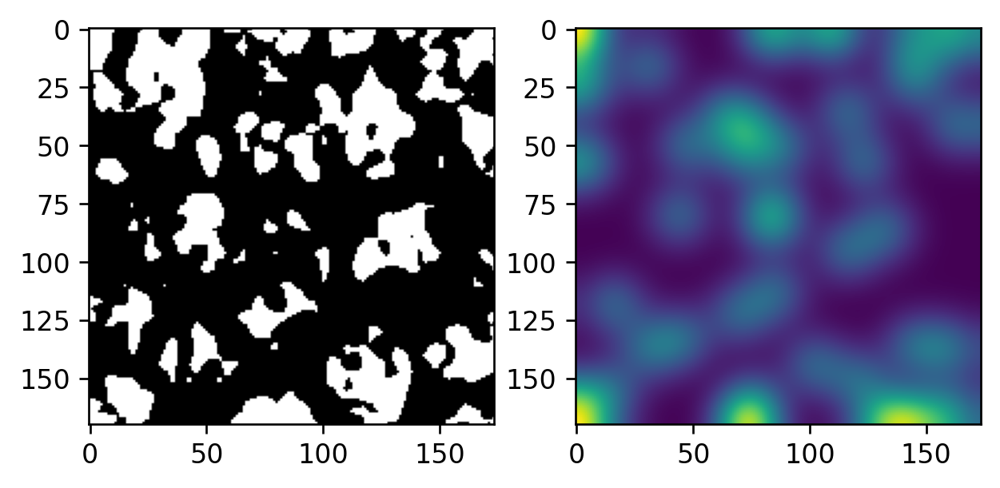

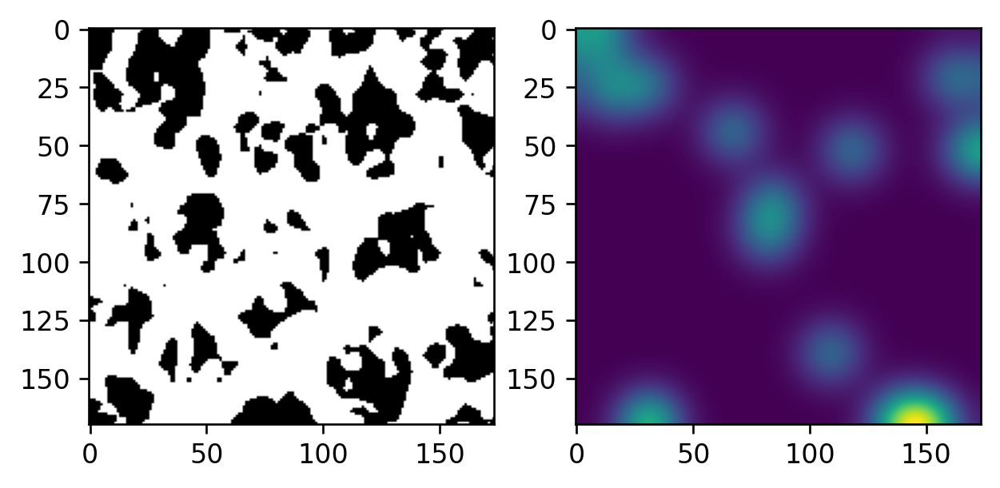

SCALE NUM [30, 242.13793103448276]
Average Size 242.13793103448276
CENTROID NUM 30
[[ 83.20176498  92.41741756]
 [ 17.8858156   31.29574468]
 [ 42.51851852   4.59259259]
 [ 67.92307692   2.58974359]
 [ 92.           0.5       ]
 [107.45378151   3.77310924]
 [149.13095238   5.72619048]
 [ 74.41441441  15.78378378]
 [109.07824427  41.20038168]
 [148.03703704  22.81481481]
 [ 67.62046908  45.39658849]
 [152.23440454  55.42344045]
 [ 28.71226415  70.10849057]
 [ 95.12757605  96.46319921]
 [ 57.61111111  69.74074074]
 [131.1796276   97.32749179]
 [  5.5         77.        ]
 [139.          80.5       ]
 [ 10.74074074  84.81481481]
 [  1.30769231  96.32051282]
 [ 60.87407407 109.93333333]
 [ 16.6        118.6       ]
 [ 18.         132.5       ]
 [ 71.44791667 150.203125  ]
 [ 48.30769231 149.06153846]
 [ 92.22222222 152.77777778]
 [122.25925926 152.81481481]
 [ 54.57894737 165.10526316]
 [  9.17391304 169.13043478]
 [ 66.         169.28571429]]
SCALE NUM [14, 1105.7692307692307]
Average Siz

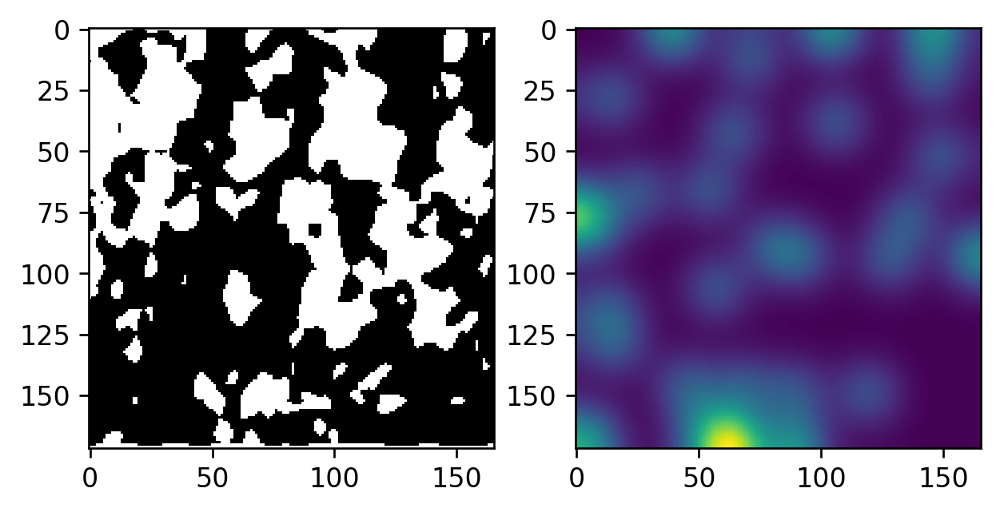

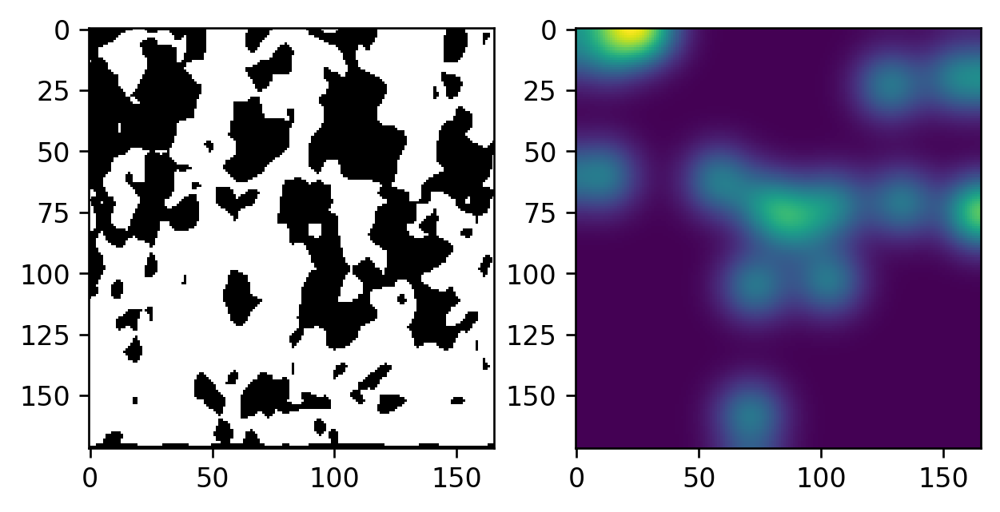

SCALE NUM [42, 121.04878048780488]
Average Size 121.04878048780488
CENTROID NUM 42
[[ 92.12063415  90.57997854]
 [ 45.97402597   6.43722944]
 [ 70.45283019   3.9245283 ]
 [113.34848485  11.6969697 ]
 [128.28235294  11.94117647]
 [ 17.98961938  30.79930796]
 [161.14583333  24.61111111]
 [180.06666667  27.36666667]
 [ 94.19259259  34.84074074]
 [171.16666667  31.2       ]
 [ 70.61538462  43.03418803]
 [133.          45.5       ]
 [144.27419355  51.5483871 ]
 [123.6         56.85714286]
 [133.          53.5       ]
 [ 48.53846154  65.72952854]
 [181.          66.        ]
 [  4.34375     72.578125  ]
 [102.23837209  79.53488372]
 [171.77777778  75.27777778]
 [ 85.23728814  82.15254237]
 [ 28.          80.5       ]
 [167.          91.35135135]
 [ 97.09375     91.84375   ]
 [ 77.          94.        ]
 [134.55384615 103.        ]
 [158.27309237 106.73493976]
 [ 64.22222222 105.5959596 ]
 [ 47.17391304 106.        ]
 [ 25.32380952 120.        ]
 [112.98818898 126.0511811 ]
 [146.18060201 153

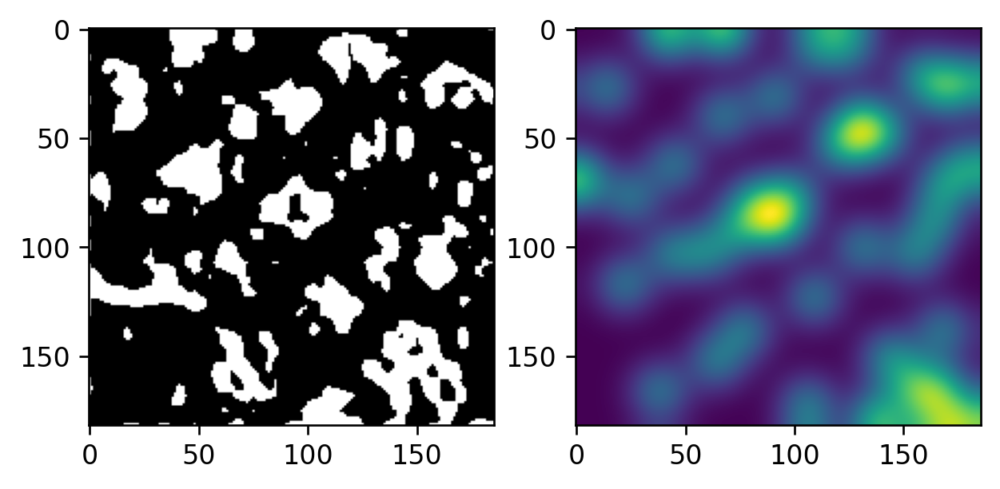

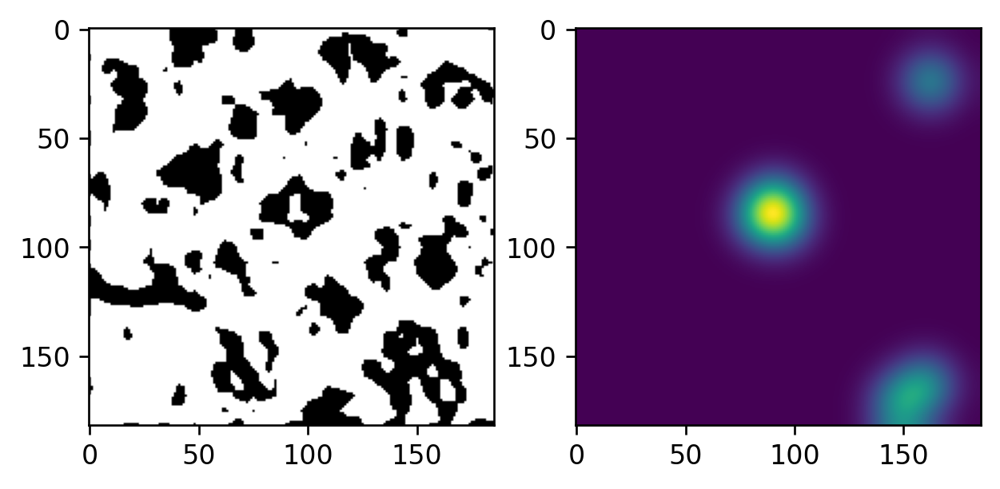

SCALE NUM [37, 134.83333333333334]
Average Size 134.83333333333334
CENTROID NUM 37
[[ 90.43476235  89.83525701]
 [  0.5          1.5       ]
 [106.           1.5       ]
 [152.17602996   5.87640449]
 [169.98571429   5.5       ]
 [ 42.1125      10.01875   ]
 [ 89.5         10.        ]
 [ 79.70652174  19.97826087]
 [ 17.69127517  23.81879195]
 [124.8961039   27.51298701]
 [  0.5         27.5       ]
 [109.49152542  36.30508475]
 [  0.5         47.5       ]
 [153.24857143  51.02      ]
 [127.          43.        ]
 [ 62.5         45.        ]
 [ 60.          55.        ]
 [ 54.34210526  60.26315789]
 [ 67.6         59.4       ]
 [ 85.83333333  63.72916667]
 [  0.5         62.        ]
 [ 41.32222222  70.83333333]
 [ 13.2265625   71.765625  ]
 [  0.5         83.        ]
 [130.87116564  82.52147239]
 [169.03125     79.57291667]
 [ 78.08053691 106.19060403]
 [ 34.59375     95.90625   ]
 [105.3960396   97.98019802]
 [163.89587426 109.11591356]
 [ 27.96893204 118.50873786]
 [121.93581081 125

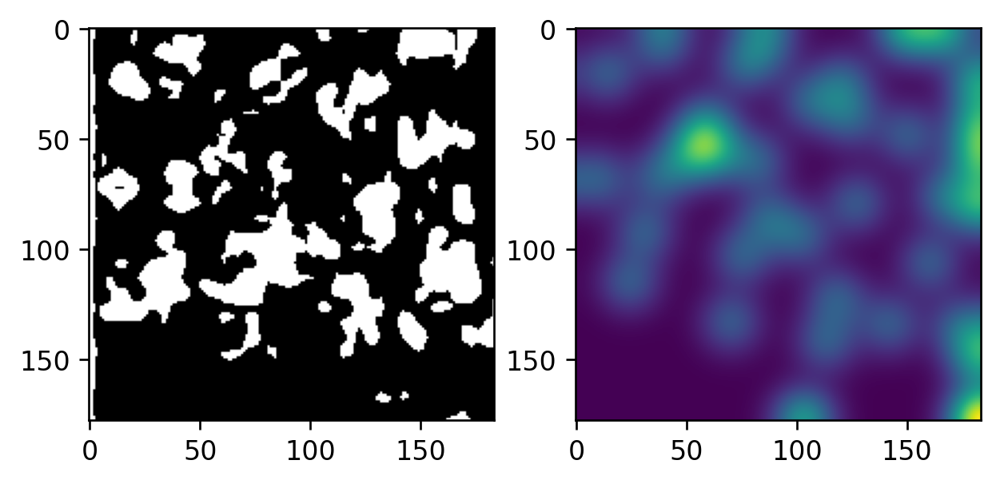

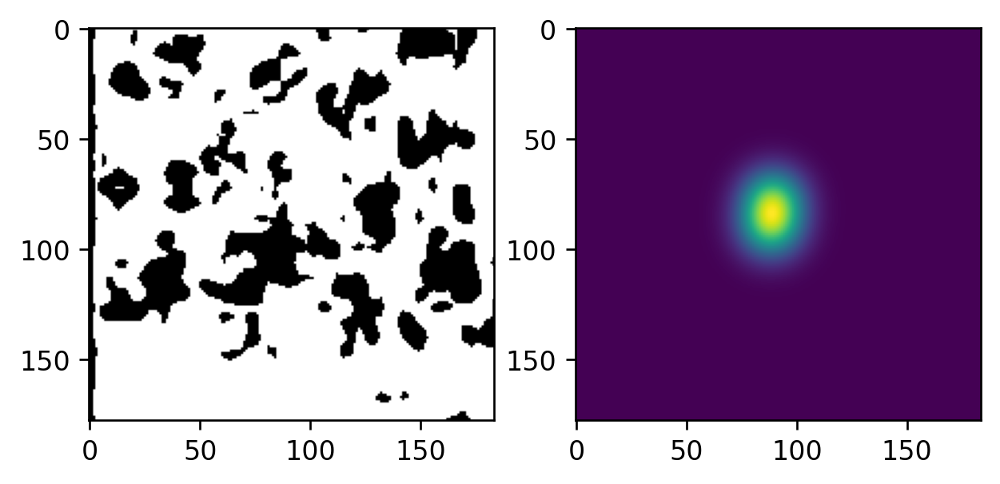

SCALE NUM [42, 131.02439024390245]
Average Size 131.02439024390245
CENTROID NUM 42
[[ 79.20985168  80.31102362]
 [123.           0.5       ]
 [159.4911147   22.68497577]
 [ 59.66666667   7.17283951]
 [126.78947368  11.13684211]
 [146.           7.        ]
 [ 92.92125984  18.62204724]
 [ 64.48734177  34.13291139]
 [124.88416076  46.1536643 ]
 [142.87719298  37.        ]
 [ 32.10714286  47.90306122]
 [164.28346457  62.12598425]
 [  2.20895522  57.50746269]
 [ 86.45045045  55.73873874]
 [ 71.68        57.08      ]
 [151.          57.5       ]
 [ 58.05243446  73.14606742]
 [ 75.32142857  79.9047619 ]
 [100.          72.        ]
 [ 19.78723404  83.92553191]
 [126.          77.        ]
 [137.42307692  92.92760181]
 [101.47752809  99.        ]
 [125.17391304  91.        ]
 [ 32.89795918  95.71428571]
 [166.5         96.5       ]
 [  5.          97.        ]
 [ 70.05940594 112.12211221]
 [145.45357143 120.72142857]
 [ 39.56321839 115.14942529]
 [ 86.5        124.33333333]
 [  3.87820513 127

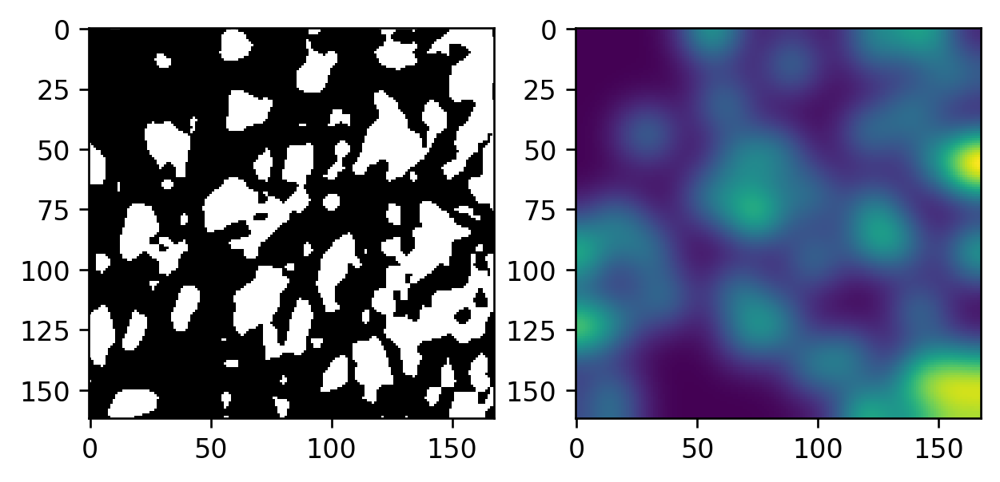

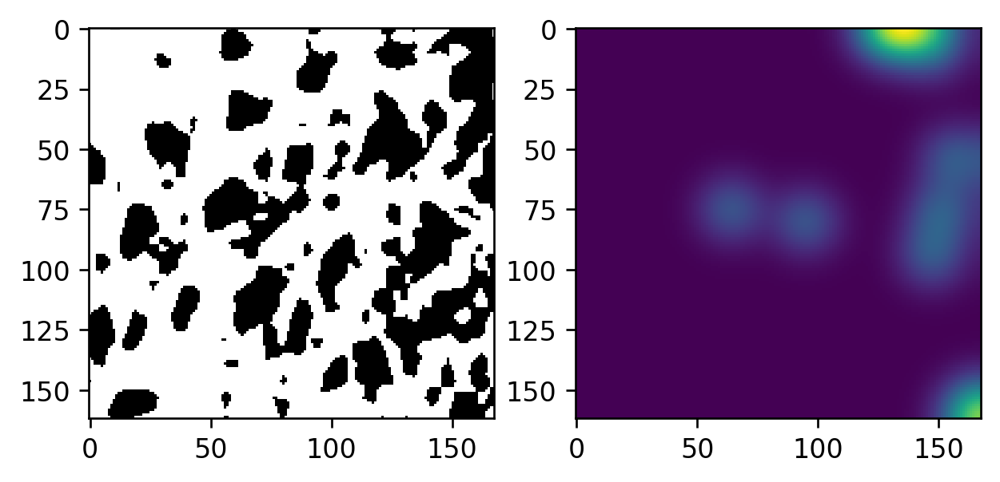

SCALE NUM [31, 136.0]
Average Size 136.0
CENTROID NUM 31
[[ 82.10652288  78.43266702]
 [ 67.92173913   4.67826087]
 [107.75206612   5.14876033]
 [146.65853659  14.99186992]
 [ 25.1875      17.90625   ]
 [ 99.04032258  38.10483871]
 [ 62.03529412  37.98823529]
 [ 29.48096886  53.30103806]
 [135.0974026   44.04545455]
 [  0.90909091  50.63636364]
 [  0.5         67.5       ]
 [141.88888889  82.08547009]
 [ 99.52054795  79.02739726]
 [ 34.63122172  95.21493213]
 [  2.05882353  85.41176471]
 [ 71.29166667  90.39583333]
 [  3.81981982 108.08108108]
 [133.65789474 117.95614035]
 [ 71.3974026  127.6987013 ]
 [ 21.53191489 121.9787234 ]
 [107.75543478 129.69021739]
 [ 11.34615385 129.26923077]
 [ 47.74744027 150.6552901 ]
 [ 92.34161491 147.52795031]
 [ 29.42105263 143.89473684]
 [130.         145.        ]
 [ 14.03521127 155.93309859]
 [142.28451883 160.35983264]
 [111.33834586 160.48120301]
 [  0.90909091 159.63636364]
 [ 75.5        164.        ]]
SCALE NUM [12, 1567.4545454545455]
Average 

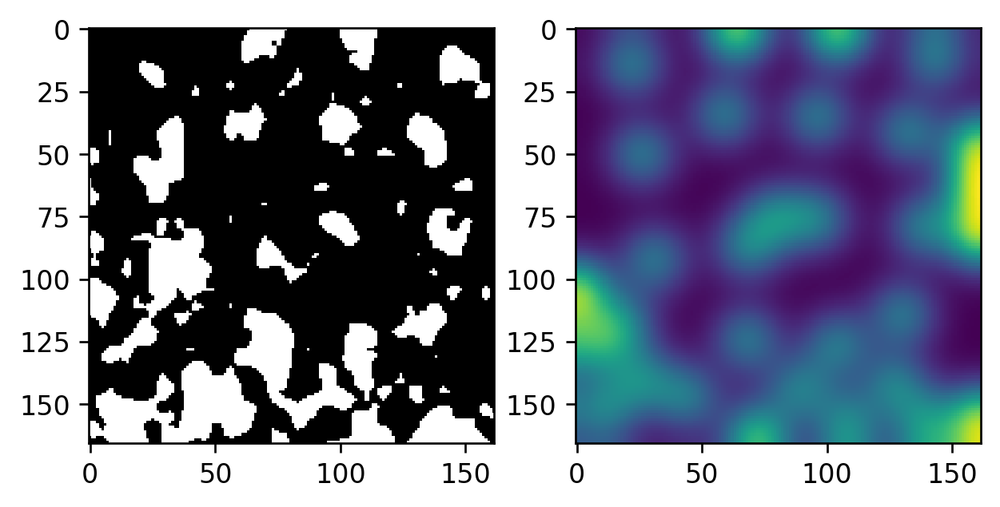

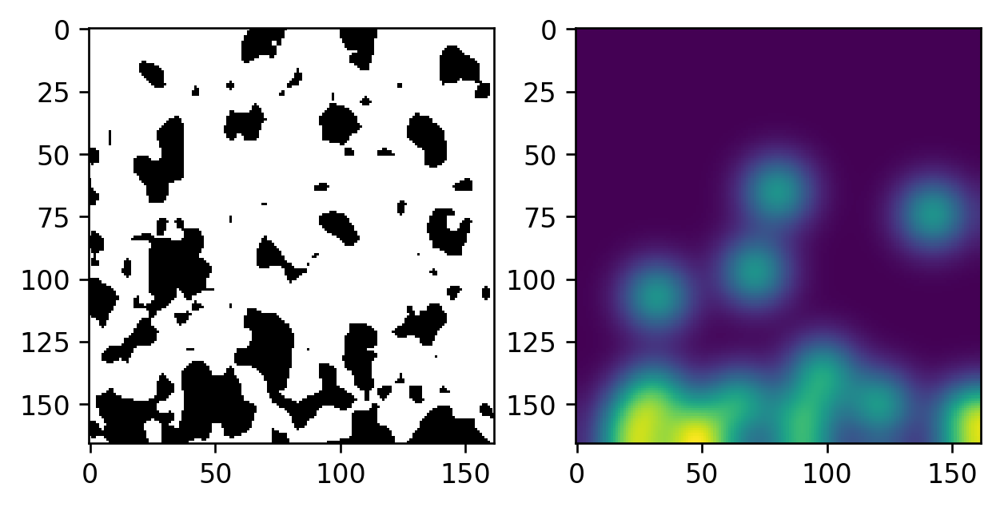

SCALE NUM [2, 8.0]
Average Size 8.0
CENTROID NUM 2
[[25.92576419 25.43886463]
 [51.5        46.5       ]]
SCALE NUM [13, 60.166666666666664]
Average Size 60.166666666666664
CENTROID NUM 13
[[27.05998033 25.02654867]
 [ 4.65517241  3.91954023]
 [36.36363636  0.90909091]
 [29.          4.5       ]
 [46.5         6.        ]
 [49.27027027 14.10810811]
 [33.4        15.4       ]
 [44.69590643 30.30409357]
 [ 6.53216374 27.90643275]
 [26.19642857 28.03571429]
 [15.89705882 43.47794118]
 [ 1.5        50.5       ]
 [30.         50.5       ]]
2
13


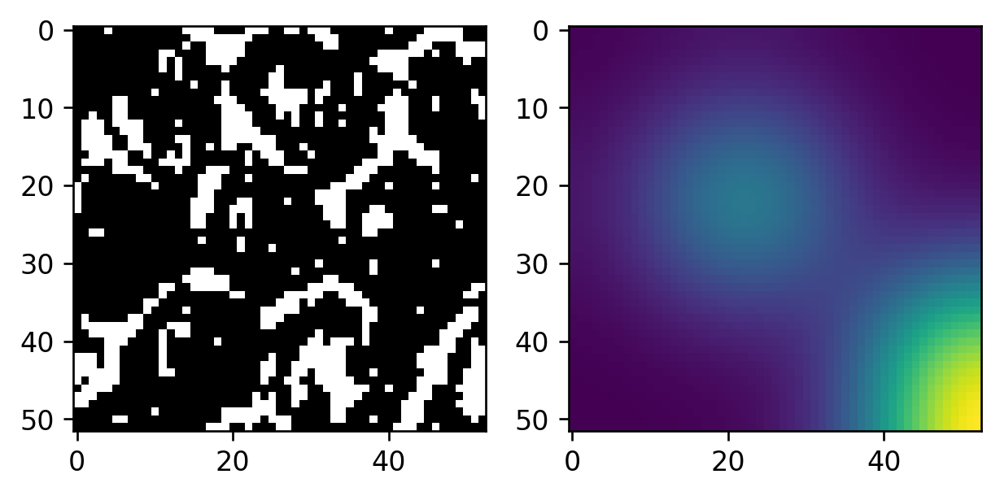

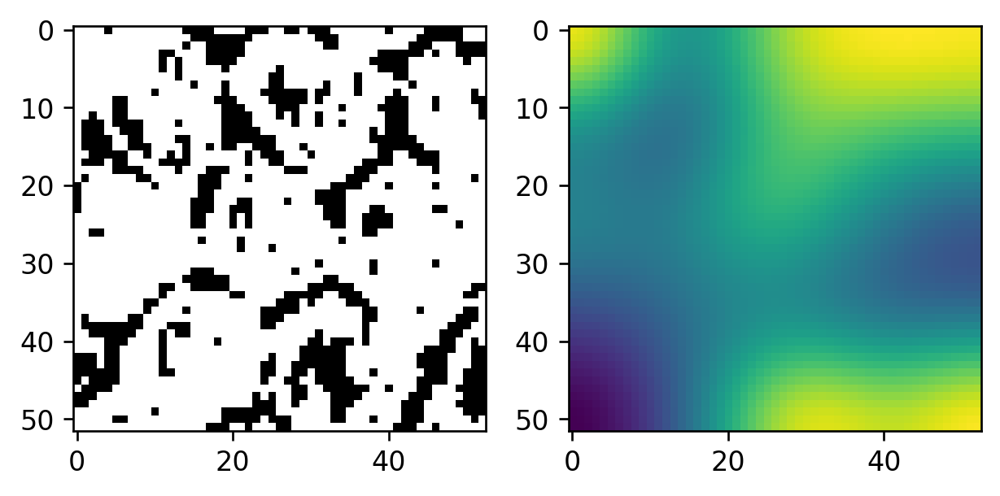

SCALE NUM [34, 101.66666666666667]
Average Size 101.66666666666667
CENTROID NUM 34
[[ 86.9745163   88.25752135]
 [ 97.80952381   1.33333333]
 [133.88636364   2.5       ]
 [ 66.18918919   9.14864865]
 [172.60606061  10.57575758]
 [150.31617647  26.83088235]
 [ 35.40909091  37.10227273]
 [ 77.53333333  43.6       ]
 [ 64.          40.        ]
 [176.5         41.        ]
 [151.89655172  54.57758621]
 [112.57142857  61.2481203 ]
 [ 10.40174672  68.18340611]
 [ 63.68181818  72.86363636]
 [172.31372549  74.78431373]
 [ 47.          75.        ]
 [ 79.5         81.5       ]
 [ 98.04824561  87.3377193 ]
 [138.17721519  93.3164557 ]
 [174.07317073  86.87804878]
 [  0.95       103.85      ]
 [ 42.46212121 110.03030303]
 [117.8375     109.4       ]
 [ 77.8839779  117.17127072]
 [153.5        110.        ]
 [165.84913793 117.94396552]
 [121.40909091 139.34545455]
 [ 67.42975207 149.76033058]
 [ 20.03355705 149.24161074]
 [ 47.71428571 144.28571429]
 [108.80836237 161.16724739]
 [169.72847682 157

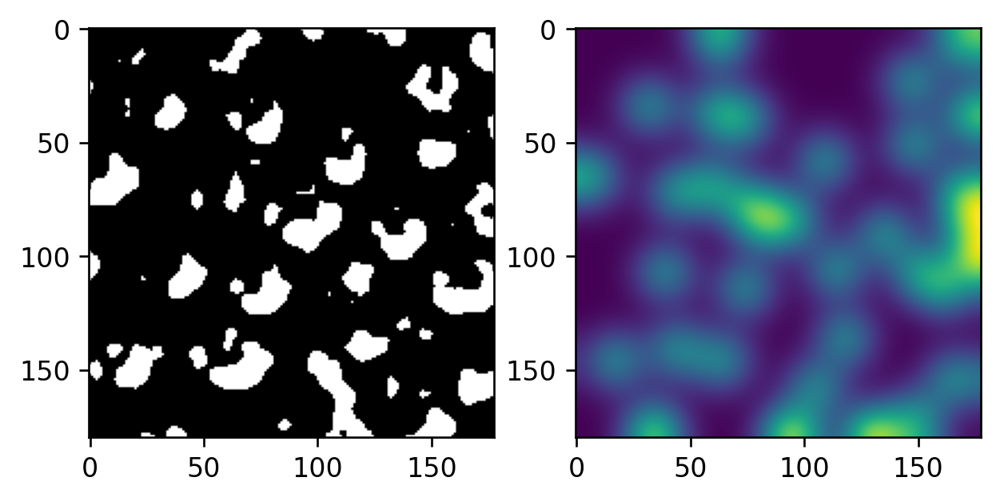

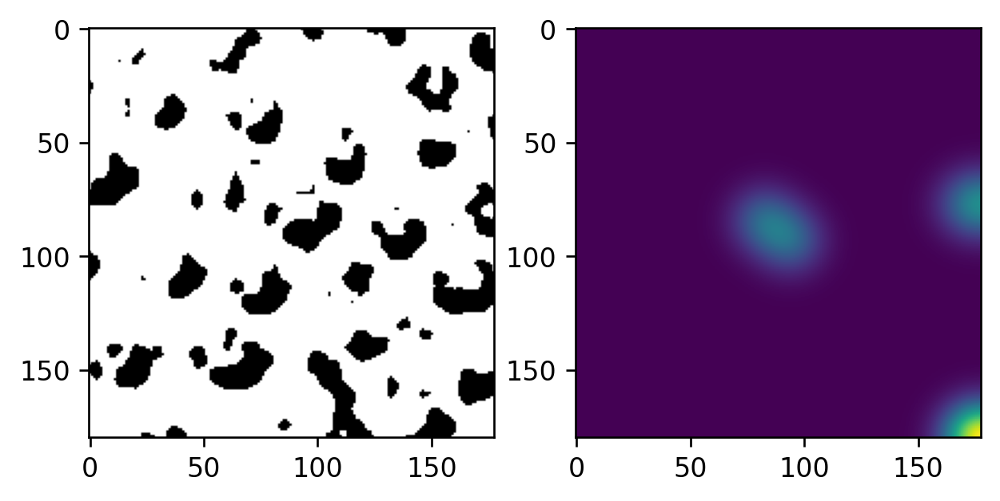

SCALE NUM [16, 52.8]
Average Size 52.8
CENTROID NUM 16
[[26.97939068 26.2983871 ]
 [34.          0.5       ]
 [51.92        3.38      ]
 [ 5.86956522  6.17391304]
 [22.37804878 11.04878049]
 [40.84313725 15.85294118]
 [ 5.43076923 17.56923077]
 [53.71428571 19.28571429]
 [25.94160584 28.57664234]
 [17.4        31.4       ]
 [43.9125     35.2875    ]
 [ 4.7826087  34.34782609]
 [12.37777778 45.31111111]
 [33.02702703 48.95945946]
 [51.46153846 48.23076923]
 [ 2.63333333 50.4       ]]
SCALE NUM [8, 19.571428571428573]
Average Size 19.571428571428573
CENTROID NUM 8
[[27.33391063 26.48008313]
 [24.          0.5       ]
 [12.68        5.16      ]
 [36.         28.5       ]
 [53.94736842 35.31578947]
 [11.96296296 36.18518519]
 [33.         37.        ]
 [41.         46.5       ]]
16
8


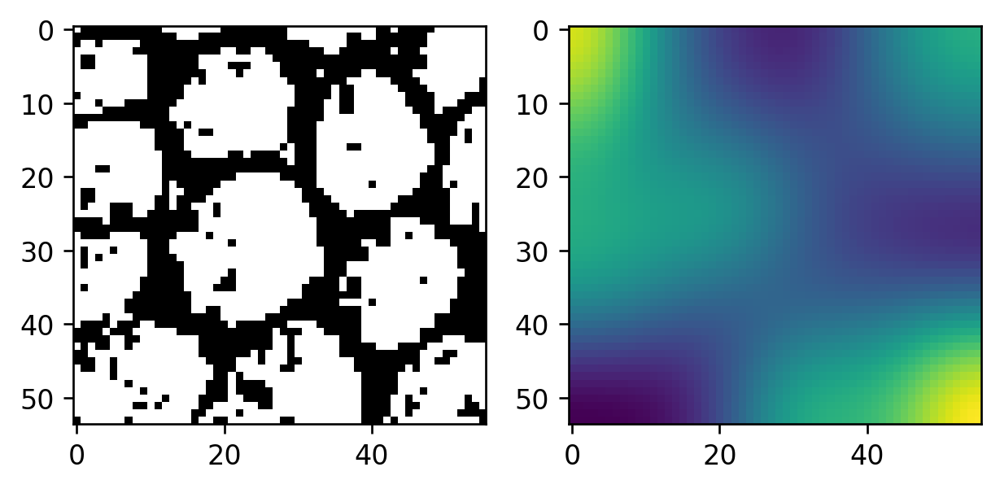

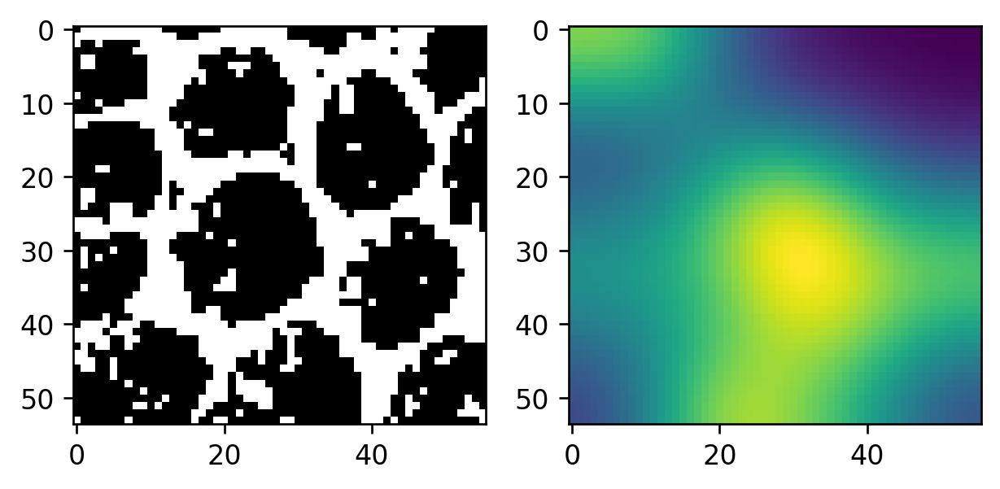

SCALE NUM [24, 160.2608695652174]
Average Size 160.2608695652174
CENTROID NUM 24
[[ 95.68184761  86.93801385]
 [ 44.98236776 135.17800168]
 [112.93193717  38.29842932]
 [ 29.42553191  31.0212766 ]
 [ 83.          41.5       ]
 [176.87272727  41.10909091]
 [ 73.11956522  52.18478261]
 [186.78823529  69.57647059]
 [ 34.15662651  79.31325301]
 [ 87.82568807  87.1559633 ]
 [131.35945946 105.34054054]
 [171.08333333  89.91666667]
 [159.5         96.5       ]
 [ 24.20121951 108.40243902]
 [ 71.0797546  108.95705521]
 [163.30208333 120.15625   ]
 [ 50.84810127 141.38607595]
 [ 96.5034965  143.33566434]
 [182.96296296 145.36111111]
 [144.84227129 166.24921136]
 [ 33.31443299 167.9742268 ]
 [ 69.         165.        ]
 [163.09090909 170.09090909]
 [175.71428571 171.42857143]]
SCALE NUM [3, 12687.5]
Average Size 12687.5
CENTROID NUM 3
[[ 88.27072243 111.08712656]
 [ 96.71344061  82.9626124 ]
 [158.52631579 175.42105263]]
24
3


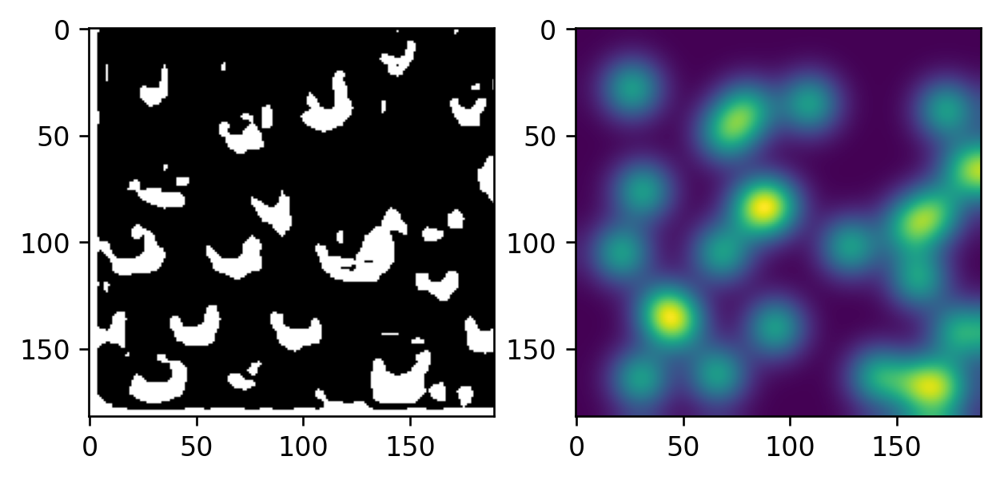

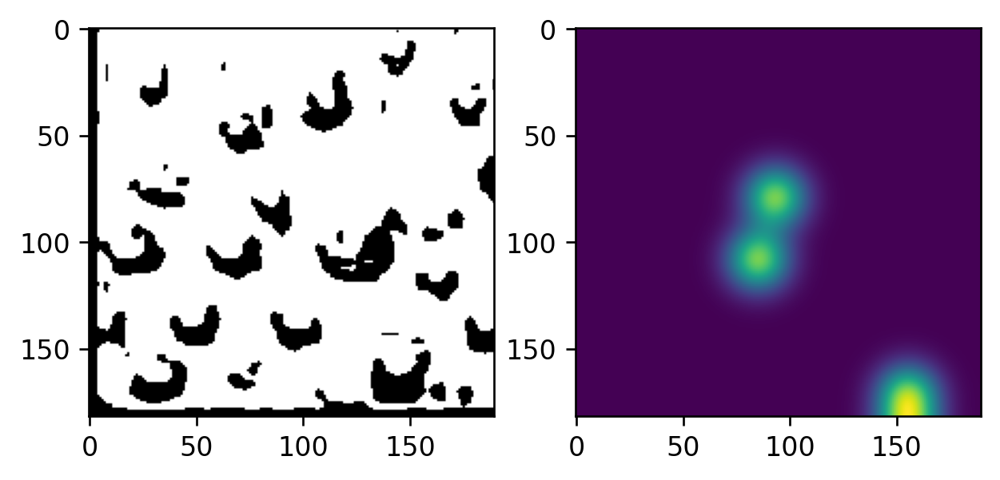

SCALE NUM [29, 117.92857142857143]
Average Size 117.92857142857143
CENTROID NUM 29
[[ 76.38670759  71.66313896]
 [ 98.13461538   5.65384615]
 [117.15625      1.21875   ]
 [146.09090909   8.36363636]
 [  7.          11.        ]
 [ 70.09039548  20.94915254]
 [ 37.09090909  21.09090909]
 [145.0212766   25.53191489]
 [  5.42105263  28.89473684]
 [ 78.05882353  33.41176471]
 [ 31.          35.5       ]
 [123.17977528  40.47191011]
 [ 40.72307692  45.28461538]
 [ 15.03243243  50.6972973 ]
 [ 97.6         50.4       ]
 [ 32.          56.        ]
 [ 30.20039683  83.41666667]
 [  4.          70.        ]
 [ 55.56060606  78.66666667]
 [133.89285714  83.89285714]
 [137.89705882  97.41176471]
 [  5.28148148 104.67407407]
 [ 74.80985915 107.58450704]
 [ 36.7054429  132.64674493]
 [ 96.5        111.        ]
 [102.46489104 126.16707022]
 [146.5        120.        ]
 [ 71.72222222 143.61111111]
 [  5.         148.5       ]]
SCALE NUM [7, 2376.8333333333335]
Average Size 2376.8333333333335
CENTROID 

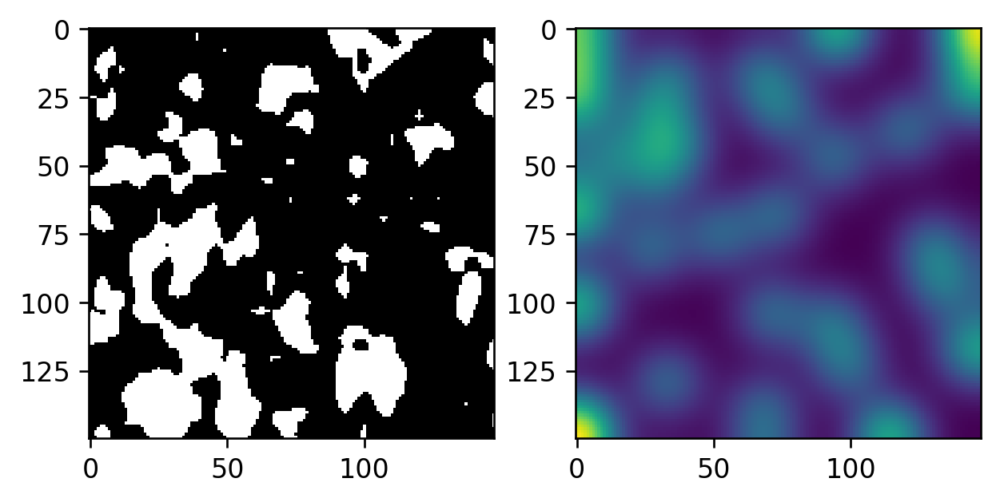

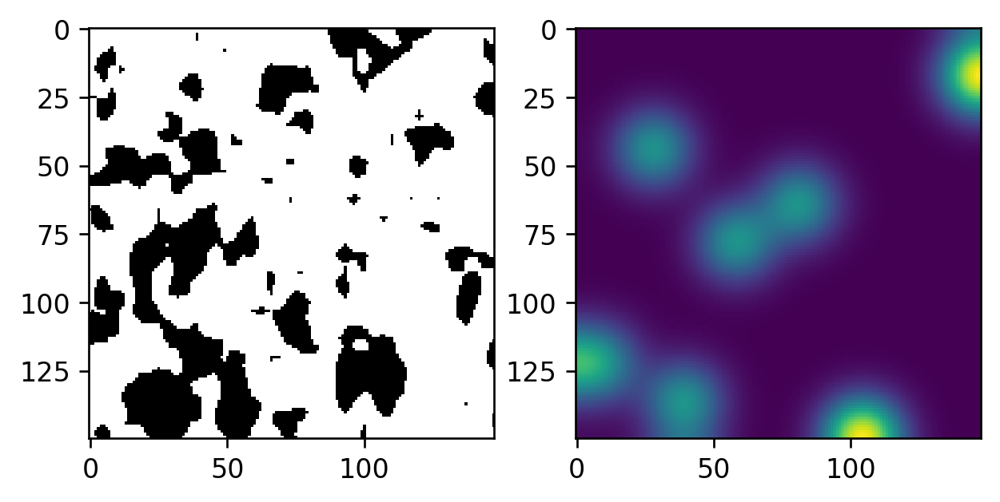

SCALE NUM [6, 34.4]
Average Size 34.4
CENTROID NUM 6
[[27.15577717 28.57702889]
 [18.88333333  6.7       ]
 [35.97101449  4.28985507]
 [ 1.         13.        ]
 [25.36363636 23.31818182]
 [ 0.5        32.        ]]
SCALE NUM [13, 49.5]
Average Size 49.5
CENTROID NUM 13
[[27.47465809 25.97304907]
 [44.57894737  7.10526316]
 [51.59459459 12.27027027]
 [ 3.796875   20.046875  ]
 [14.5        20.5       ]
 [40.         23.        ]
 [38.80487805 31.3902439 ]
 [14.07954545 35.76136364]
 [10.25242718 48.87378641]
 [34.6        44.6       ]
 [26.15254237 50.50847458]
 [53.5        45.5       ]
 [ 0.5        54.5       ]]
6
13


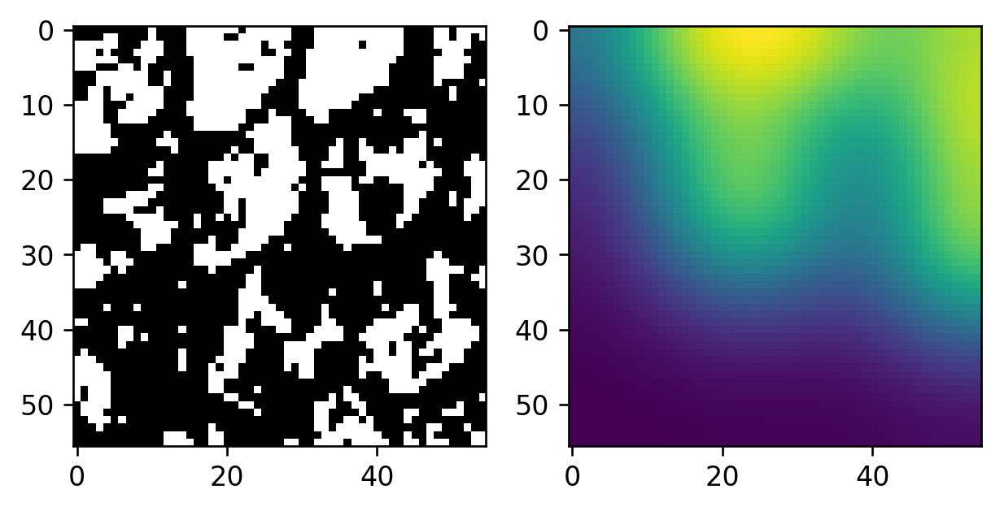

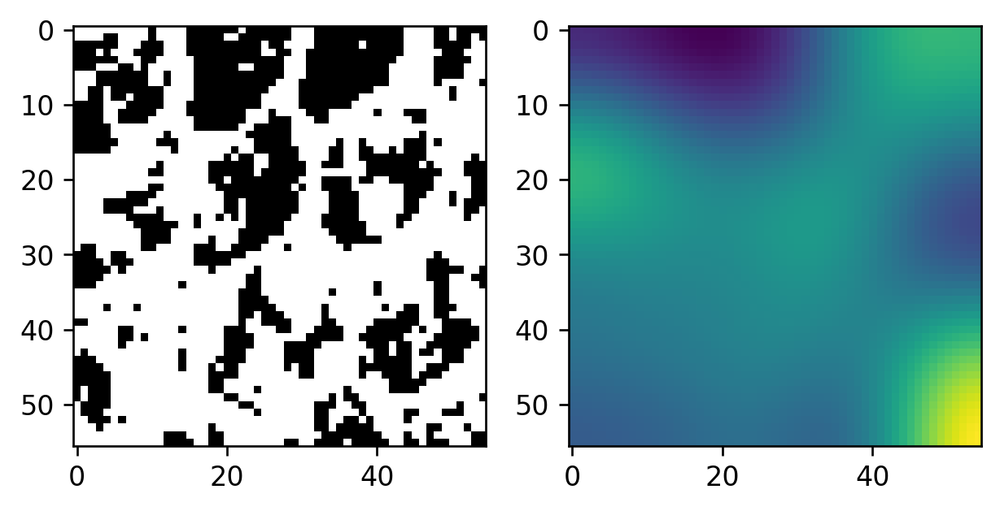

SCALE NUM [2, 27.0]
Average Size 27.0
CENTROID NUM 2
[[25.73323562 26.15976548]
 [ 1.92592593  9.85185185]]
SCALE NUM [9, 19.625]
Average Size 19.625
CENTROID NUM 9
[[25.05771451 26.77029627]
 [15.25        0.875     ]
 [30.93103448  2.4137931 ]
 [44.5         1.        ]
 [16.          7.        ]
 [47.10638298  9.34042553]
 [29.         20.        ]
 [40.         34.85714286]
 [ 1.35714286 40.71428571]]
2
9


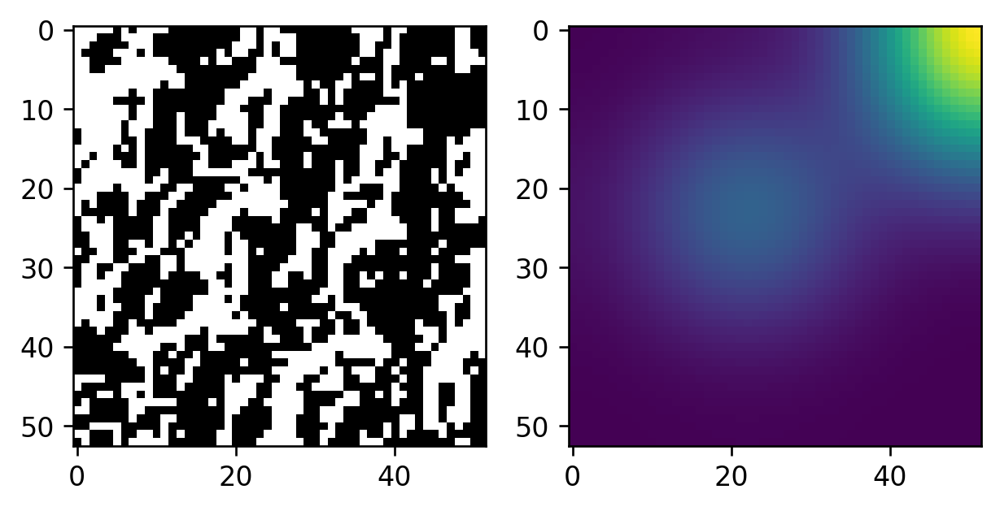

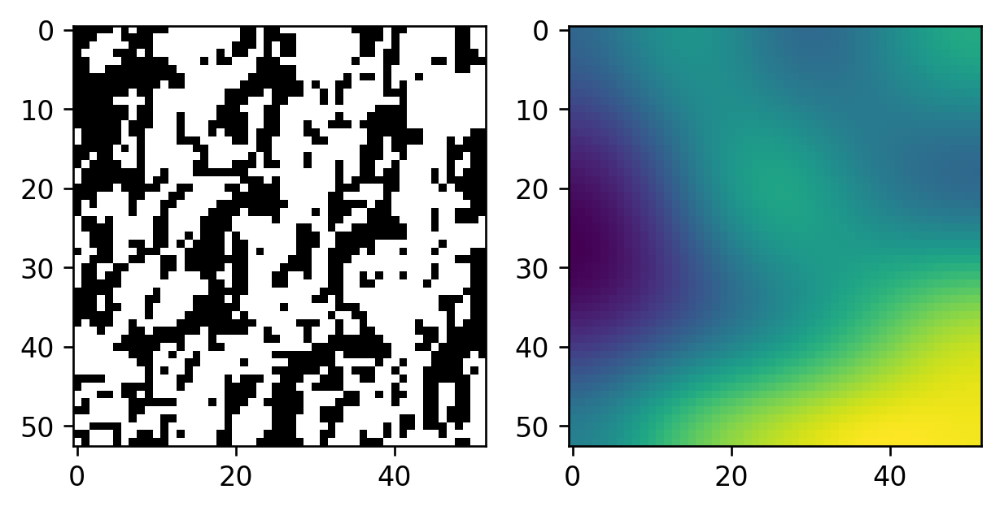

SCALE NUM [16, 35.06666666666667]
Average Size 35.06666666666667
CENTROID NUM 16
[[29.15251799 28.39028777]
 [41.13043478  3.23913043]
 [ 2.43421053  8.73684211]
 [14.         13.        ]
 [22.86538462 13.36538462]
 [56.5        11.        ]
 [45.         21.66666667]
 [ 9.41304348 23.65217391]
 [56.09090909 26.63636364]
 [27.78378378 32.41891892]
 [46.84210526 36.8245614 ]
 [56.5        34.5       ]
 [14.         39.        ]
 [14.5        45.        ]
 [30.47727273 47.97727273]
 [ 1.33333333 51.12820513]]
SCALE NUM [18, 23.294117647058822]
Average Size 23.294117647058822
CENTROID NUM 18
[[29.32852234 28.2185567 ]
 [14.18461538  3.27692308]
 [25.36363636  2.95454545]
 [48.71428571  1.35714286]
 [30.6875     15.0625    ]
 [45.         11.5       ]
 [ 1.         30.43478261]
 [52.         22.        ]
 [17.         23.        ]
 [34.         23.5       ]
 [ 7.         32.        ]
 [16.         31.5       ]
 [34.         41.        ]
 [ 8.13793103 47.89655172]
 [19.91666667 48.91666667

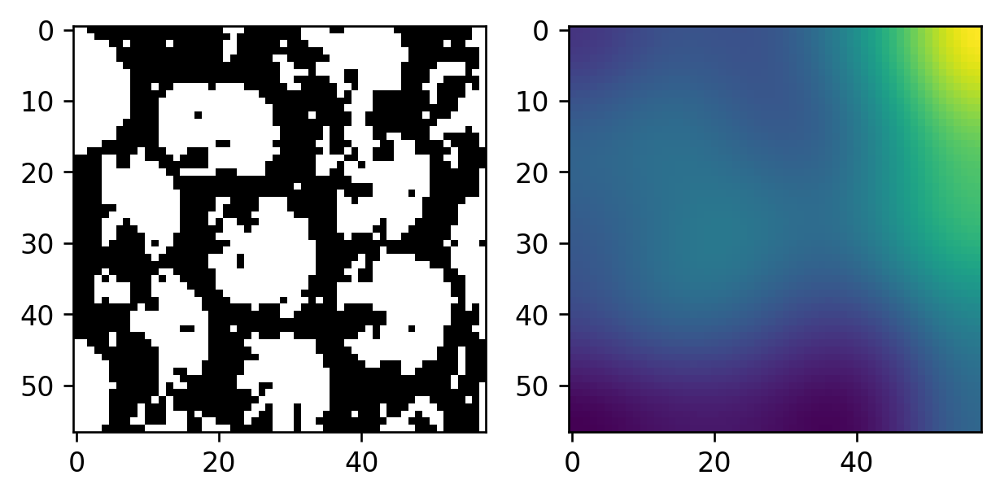

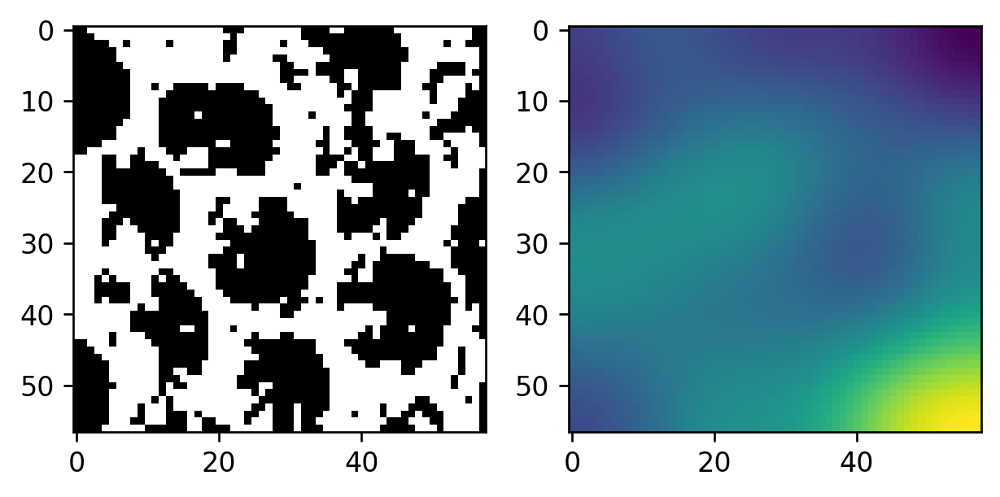

SCALE NUM [30, 190.41379310344828]
Average Size 190.41379310344828
CENTROID NUM 30
[[ 77.3321108   81.13203359]
 [ 91.54850746   5.89552239]
 [130.82142857   2.85714286]
 [158.0746888   20.98755187]
 [ 40.59555556  13.48888889]
 [  2.8         17.75714286]
 [127.63043478  20.4673913 ]
 [135.31950207  37.18257261]
 [ 81.47285464  46.25043783]
 [ 43.54810496  60.64723032]
 [135.          57.        ]
 [150.99618321  66.36259542]
 [  7.1965812   78.51709402]
 [116.22745098  76.08627451]
 [ 85.75063613  89.86513995]
 [157.48412698  89.11904762]
 [125.29090909  90.43636364]
 [ 50.22427441 101.20844327]
 [ 23.07142857  95.03571429]
 [110.35294118  98.61764706]
 [152.05514706 124.4877451 ]
 [ 13.31220657 122.72300469]
 [122.78531073 121.31638418]
 [ 84.81538462 138.34615385]
 [ 38.575      142.525     ]
 [ 45.         148.        ]
 [138.58823529 152.94117647]
 [103.         159.5       ]
 [151.23076923 160.15384615]
 [ 49.         160.5       ]]
SCALE NUM [8, 2048.8571428571427]
Average Size

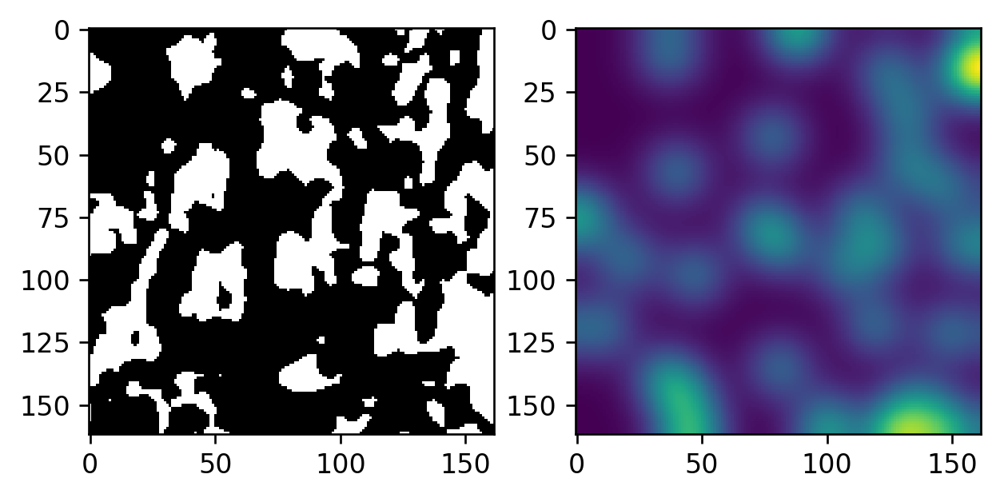

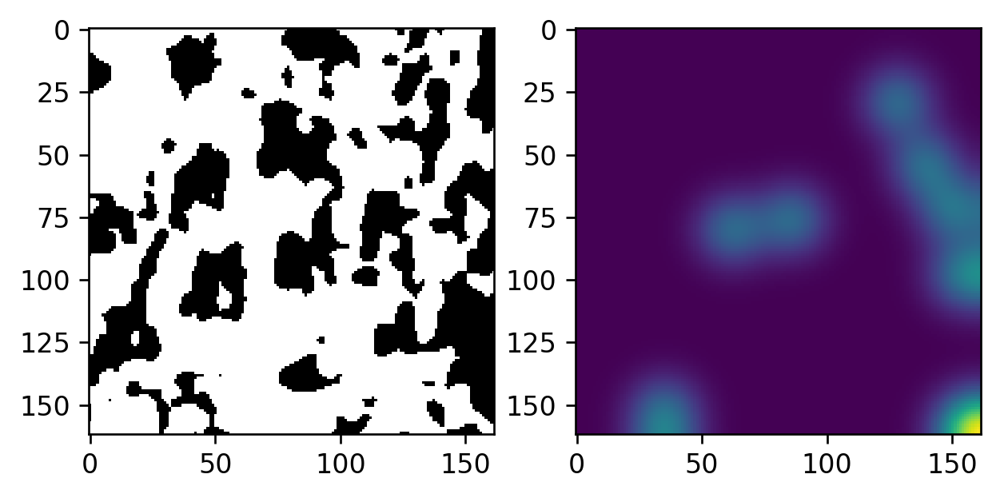

SCALE NUM [21, 390.7]
Average Size 390.7
CENTROID NUM 21
[[ 73.86342172  84.84483594]
 [  7.71115538  13.62749004]
 [ 43.12981298  18.22112211]
 [110.89640769  40.40406572]
 [150.5         27.        ]
 [  0.5         49.5       ]
 [149.54415954  89.88746439]
 [ 32.63043478  71.13043478]
 [  8.30606061  76.1030303 ]
 [ 60.28384279  88.13682678]
 [ 91.9826087  108.93913043]
 [ 20.         108.55813953]
 [ 69.         107.5       ]
 [ 50.05309735 130.48672566]
 [ 63.06060606 132.72727273]
 [141.64485981 145.59345794]
 [ 32.68       141.08      ]
 [ 13.2345679  144.34567901]
 [  0.5        148.5       ]
 [ 96.5        151.        ]
 [ 42.         152.5       ]]
SCALE NUM [12, 979.0909090909091]
Average Size 979.0909090909091
CENTROID NUM 12
[[ 84.10898098  66.16369267]
 [ 23.5          1.        ]
 [ 61.43589744   2.20512821]
 [ 98.           0.5       ]
 [109.           0.5       ]
 [ 50.5          8.        ]
 [ 69.80230085  92.08942382]
 [119.5         12.5       ]
 [145.90909091  17.6

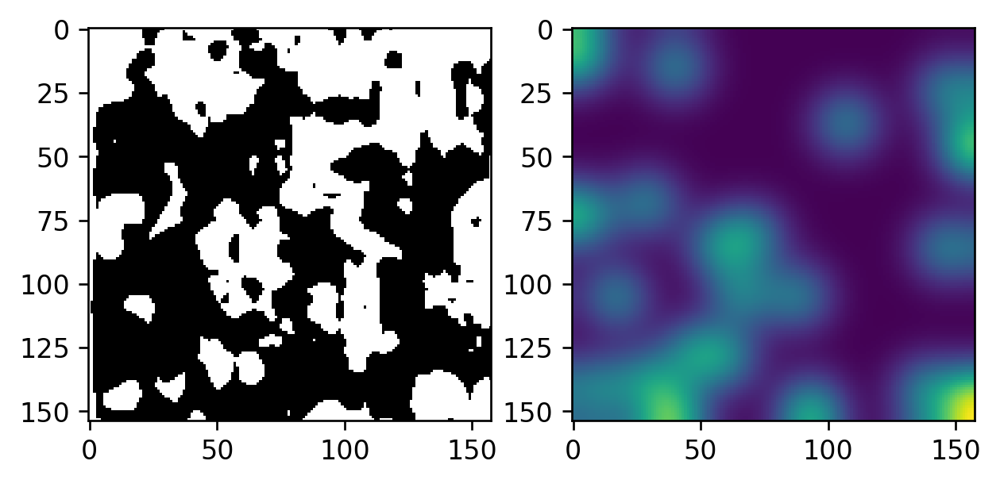

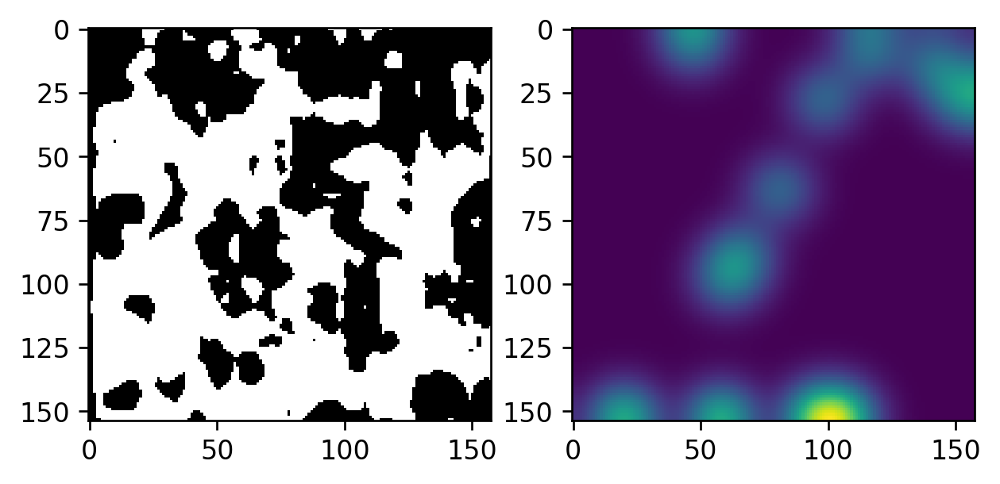

SCALE NUM [32, 169.25806451612902]
Average Size 169.25806451612902
CENTROID NUM 32
[[ 98.50880967  92.15537912]
 [  2.79662803 103.78925184]
 [114.94042553  12.50638298]
 [ 15.28571429  10.71428571]
 [ 80.46808511  29.62765957]
 [ 49.35294118  33.82352941]
 [153.485       46.33      ]
 [ 17.48387097  51.51612903]
 [191.39534884  51.18604651]
 [125.74025974  56.03896104]
 [ 95.86176471  74.30294118]
 [131.96097561  72.7804878 ]
 [186.73451327  86.19026549]
 [ 64.38235294  87.89411765]
 [180.0209205  108.20920502]
 [ 27.04867257 112.5840708 ]
 [141.30275229 115.71559633]
 [116.02205882 129.63235294]
 [103.84615385 129.18461538]
 [ 78.76       129.68      ]
 [ 79.63048499 152.3556582 ]
 [ 43.97091723 164.46756152]
 [172.22891566 157.97590361]
 [190.77777778 161.40277778]
 [160.66666667 162.        ]
 [170.2231405  174.33884298]
 [ 28.84782609 179.9       ]
 [130.5        177.81818182]
 [151.         176.5       ]
 [ 88.3        188.2       ]
 [135.70588235 187.70588235]
 [117.         188

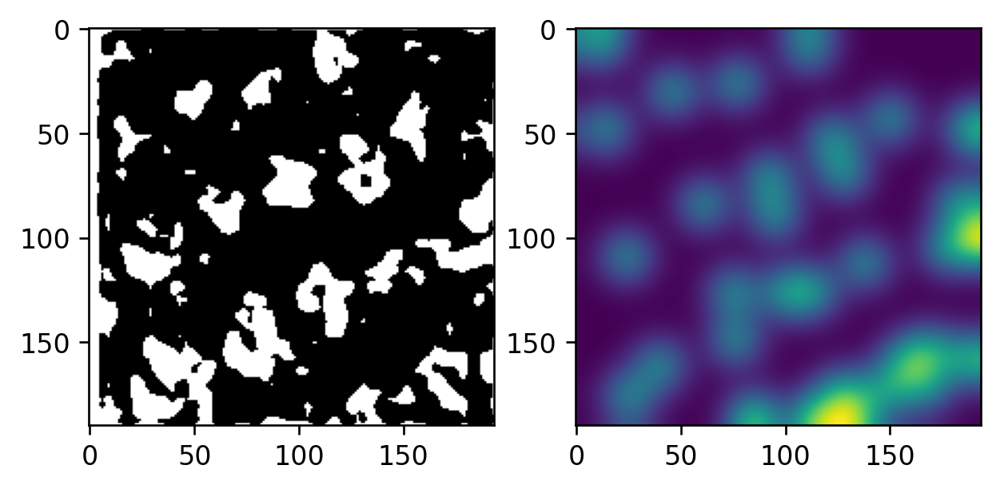

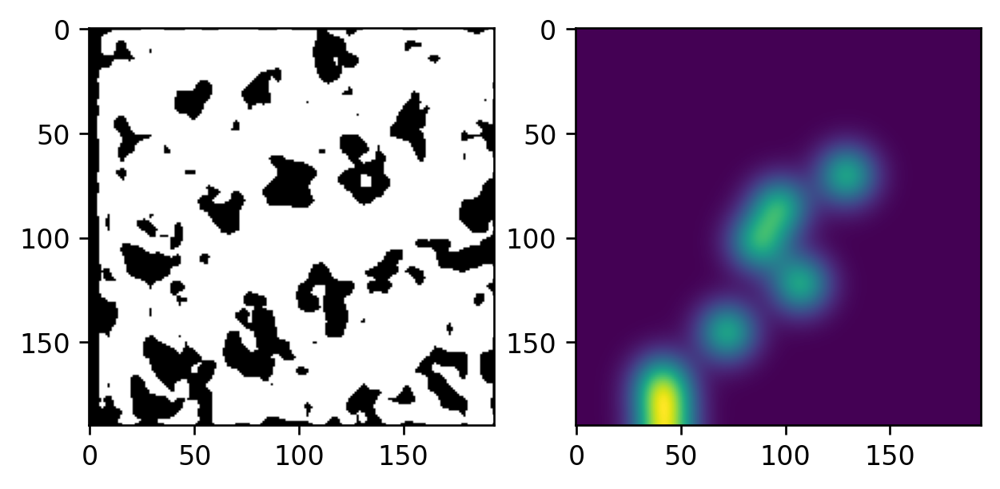

SCALE NUM [10, 19.11111111111111]
Average Size 19.11111111111111
CENTROID NUM 10
[[26.6466877  27.148966  ]
 [41.          0.5       ]
 [47.93103448  9.5862069 ]
 [53.         14.5       ]
 [ 0.89473684 17.        ]
 [19.86666667 18.43333333]
 [ 7.         27.        ]
 [51.25       34.75      ]
 [39.5        44.        ]
 [35.6        52.6       ]]
SCALE NUM [13, 45.166666666666664]
Average Size 45.166666666666664
CENTROID NUM 13
[[27.16794201 26.59726138]
 [ 0.875       0.875     ]
 [16.64835165 10.26923077]
 [34.34782609 21.        ]
 [27.         23.        ]
 [43.70886076 30.78481013]
 [17.71428571 27.28571429]
 [16.         35.5       ]
 [ 5.12       44.34      ]
 [27.07142857 42.10714286]
 [50.975      48.        ]
 [26.73333333 51.56666667]
 [ 5.5        53.5       ]]
10
13


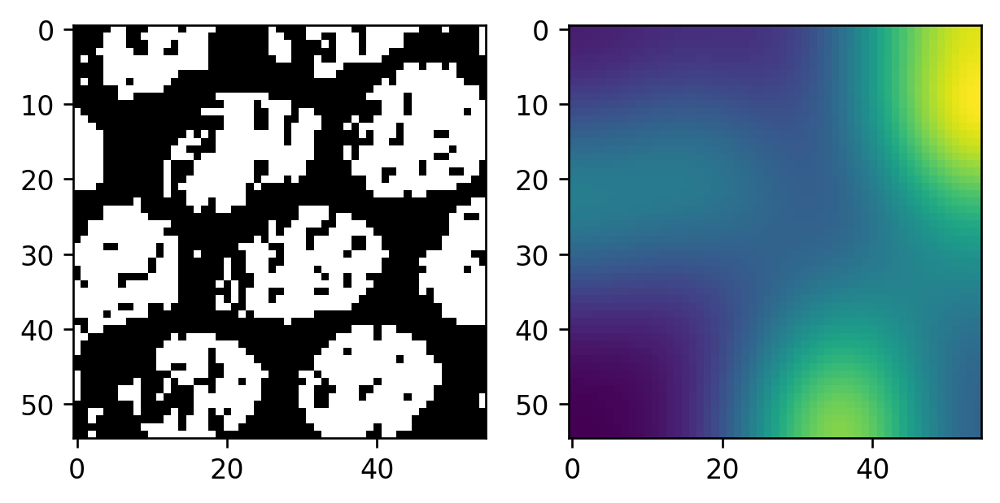

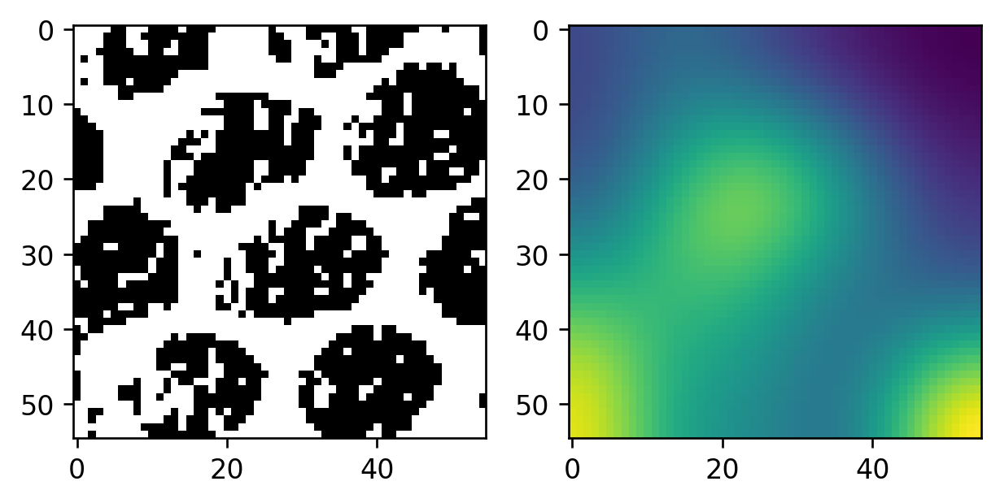

SCALE NUM [20, 18.526315789473685]
Average Size 18.526315789473685
CENTROID NUM 20
[[27.03739003 26.94648094]
 [ 2.5         0.5       ]
 [21.14285714  0.92857143]
 [29.17391304  1.86956522]
 [52.          2.5       ]
 [42.89473684  4.57894737]
 [ 0.5         9.        ]
 [32.         14.5       ]
 [ 0.5        18.5       ]
 [52.89285714 21.10714286]
 [36.85416667 22.875     ]
 [ 0.5        36.        ]
 [46.86206897 39.10344828]
 [28.68965517 41.4137931 ]
 [54.5        41.        ]
 [11.         41.        ]
 [ 1.07692308 49.57692308]
 [19.16       51.48      ]
 [32.5        53.5       ]
 [52.         53.5       ]]
SCALE NUM [10, 12.11111111111111]
Average Size 12.11111111111111
CENTROID NUM 10
[[27.70414002 27.01480983]
 [15.          0.5       ]
 [36.          5.        ]
 [ 5.         12.        ]
 [25.44       11.68      ]
 [ 5.         33.        ]
 [20.         42.        ]
 [11.         48.        ]
 [11.         53.5       ]
 [44.         53.        ]]
20
10


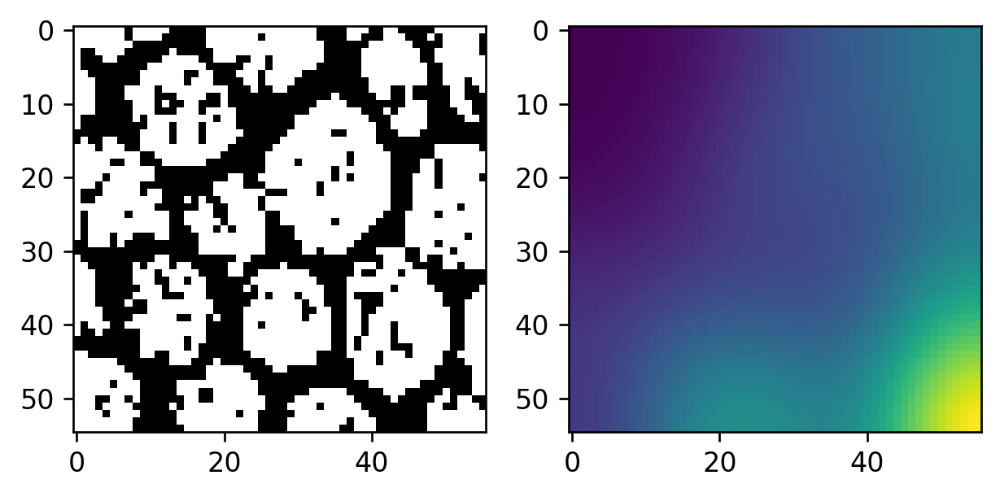

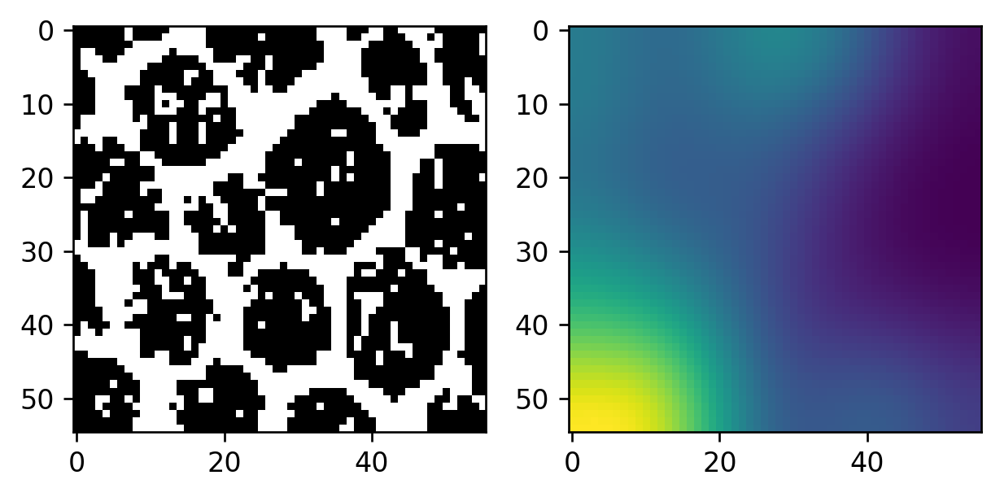

SCALE NUM [32, 105.41935483870968]
Average Size 105.41935483870968
CENTROID NUM 32
[[ 78.36335976  76.60874977]
 [  5.85074627   8.94029851]
 [ 49.56521739   2.79347826]
 [125.49305556  22.97222222]
 [150.99319728  22.27210884]
 [  1.05357143  30.80357143]
 [ 31.54862843  42.30922693]
 [103.89473684  35.42105263]
 [146.24778761  47.80530973]
 [108.37142857  61.23333333]
 [148.47826087  64.56521739]
 [  0.5         71.        ]
 [140.8         73.375     ]
 [ 39.92424242  79.25757576]
 [ 88.40350877  86.15789474]
 [157.7826087   86.23913043]
 [ 47.44444444  92.22222222]
 [  0.5         94.        ]
 [132.20357143 104.10714286]
 [157.66666667 111.01234568]
 [  5.23076923 112.        ]
 [ 55.31791908 117.56069364]
 [ 23.03333333 116.1       ]
 [107.97807018 133.03947368]
 [ 39.85840708 142.10176991]
 [158.5        129.5       ]
 [  3.92622951 143.06557377]
 [ 22.4        131.4       ]
 [152.08675799 146.07762557]
 [ 85.3        137.76666667]
 [130.16666667 153.22222222]
 [113.         154

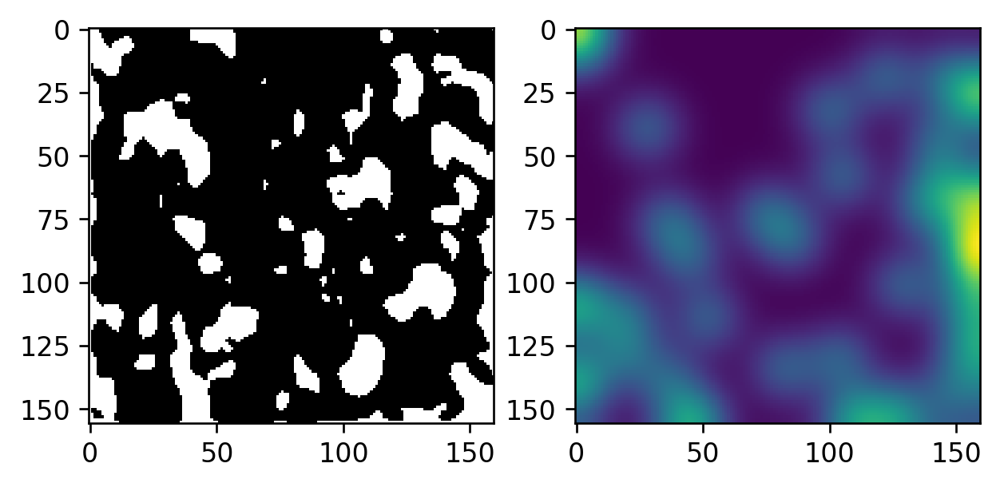

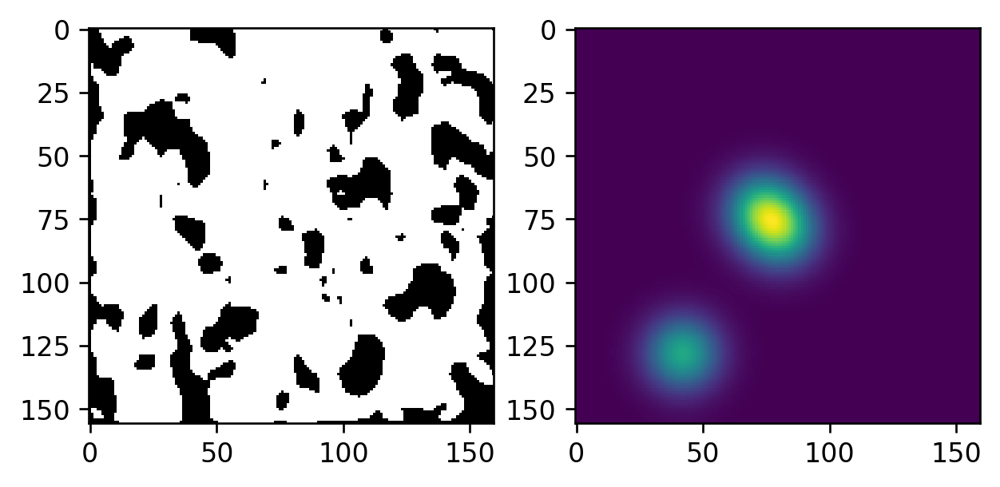

SCALE NUM [16, 27.066666666666666]
Average Size 27.066666666666666
CENTROID NUM 16
[[29.06448276 27.34034483]
 [27.5         0.5       ]
 [39.94736842  1.21052632]
 [55.5         0.5       ]
 [ 1.42105263 13.10526316]
 [ 8.5        12.        ]
 [36.         11.        ]
 [43.16       13.08      ]
 [ 5.         21.        ]
 [27.23076923 25.5       ]
 [17.47826087 27.54347826]
 [ 3.38888889 36.66666667]
 [46.         36.        ]
 [23.6        46.59130435]
 [ 7.19047619 54.23809524]
 [45.90625    54.34375   ]]
SCALE NUM [10, 14.88888888888889]
Average Size 14.88888888888889
CENTROID NUM 10
[[28.75409836 28.2370744 ]
 [ 7.36538462  1.78846154]
 [33.          3.        ]
 [48.          7.        ]
 [10.         26.        ]
 [30.         38.5       ]
 [10.         47.        ]
 [34.         48.        ]
 [51.42105263 49.10526316]
 [13.         55.5       ]]
16
10


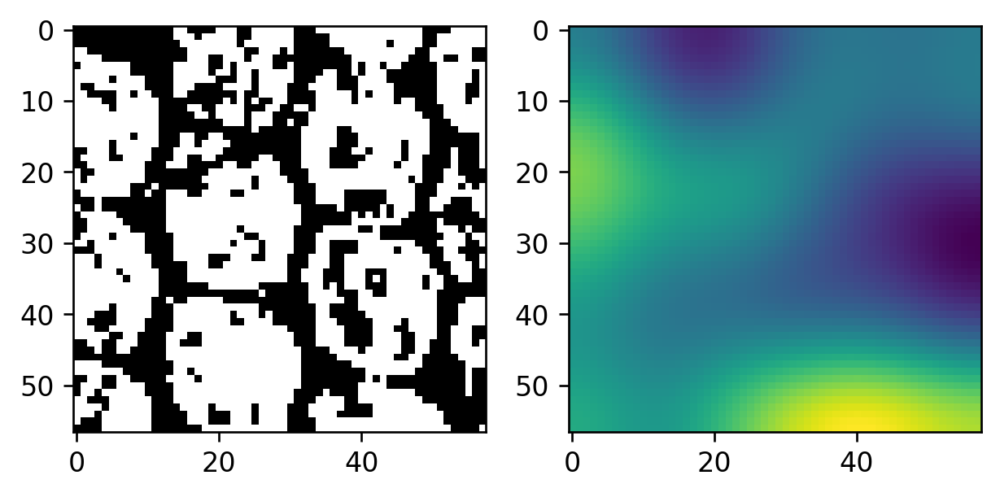

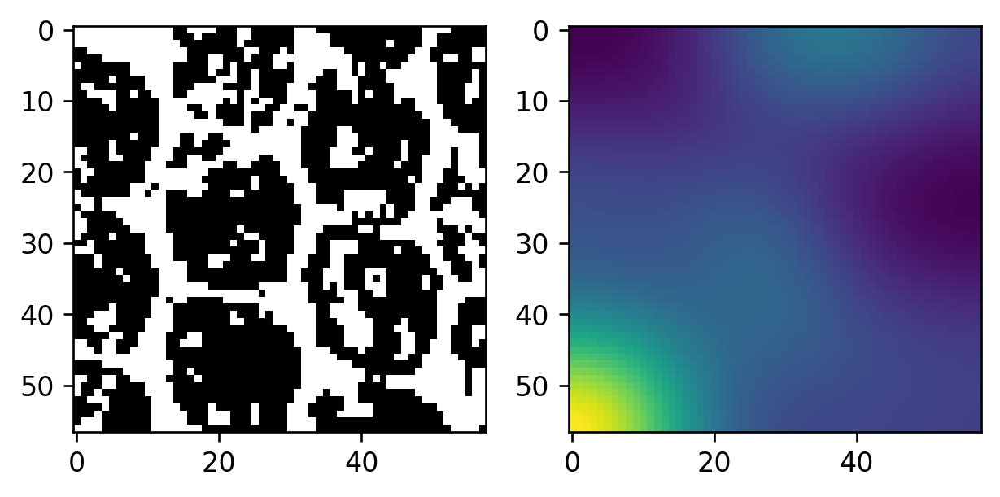

SCALE NUM [7, 40.666666666666664]
Average Size 40.666666666666664
CENTROID NUM 7
[[26.97642276 26.59390244]
 [ 3.20634921 11.13492063]
 [20.5         0.5       ]
 [13.57142857  9.04761905]
 [29.89473684  9.84210526]
 [18.70689655 22.56896552]
 [ 7.         36.5       ]]
SCALE NUM [10, 66.66666666666667]
Average Size 66.66666666666667
CENTROID NUM 10
[[22.08174905 23.07414449]
 [36.07692308  1.19230769]
 [46.24528302  4.88679245]
 [49.64102564 19.66666667]
 [26.         17.        ]
 [36.         17.5       ]
 [31.09302326 29.11627907]
 [40.96363636 41.95151515]
 [17.17391304 31.86956522]
 [19.24615385 48.53846154]]
7
10


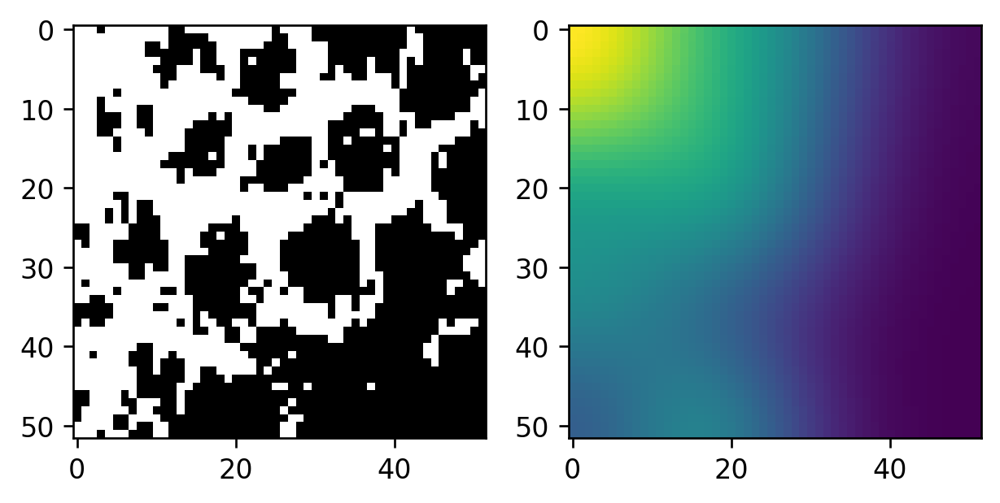

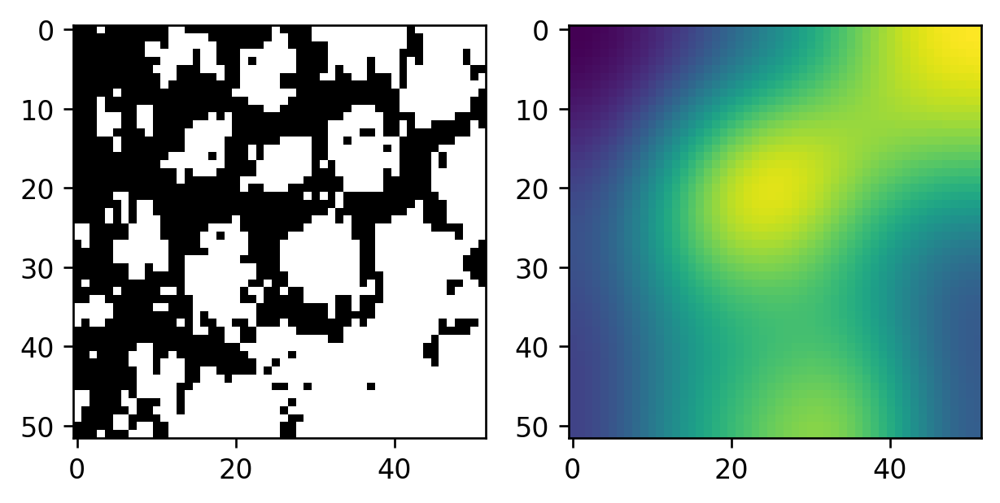

SCALE NUM [16, 763.8]
Average Size 763.8
CENTROID NUM 16
[[ 75.60833936  76.55394874]
 [ 19.05602007  15.06521739]
 [114.04892086   7.91654676]
 [142.03846154  21.15384615]
 [ 66.50597565 104.45392606]
 [  4.5         38.5       ]
 [142.15384615  40.23076923]
 [ 44.          42.        ]
 [ 50.          47.        ]
 [142.23529412  51.17647059]
 [ 57.01149425  65.48275862]
 [ 71.65714286  83.8       ]
 [137.81553398 102.77669903]
 [ 71.5         97.5       ]
 [138.39285714 137.38392857]
 [139.46153846 160.43076923]]
SCALE NUM [21, 353.6]
Average Size 353.6
CENTROID NUM 21
[[ 68.88735741  86.30893536]
 [ 51.52966102  31.08709981]
 [127.53820034  74.93803056]
 [  1.43478261  30.60869565]
 [ 81.          38.5       ]
 [  0.84615385  44.        ]
 [ 71.125       71.11931818]
 [108.43478261  68.39130435]
 [  2.40425532  75.74468085]
 [ 51.40788623 109.09631545]
 [ 94.76388889  79.27777778]
 [ 79.38888889  91.42222222]
 [102.27906977 101.13953488]
 [ 75.56       103.92      ]
 [141.0776699  

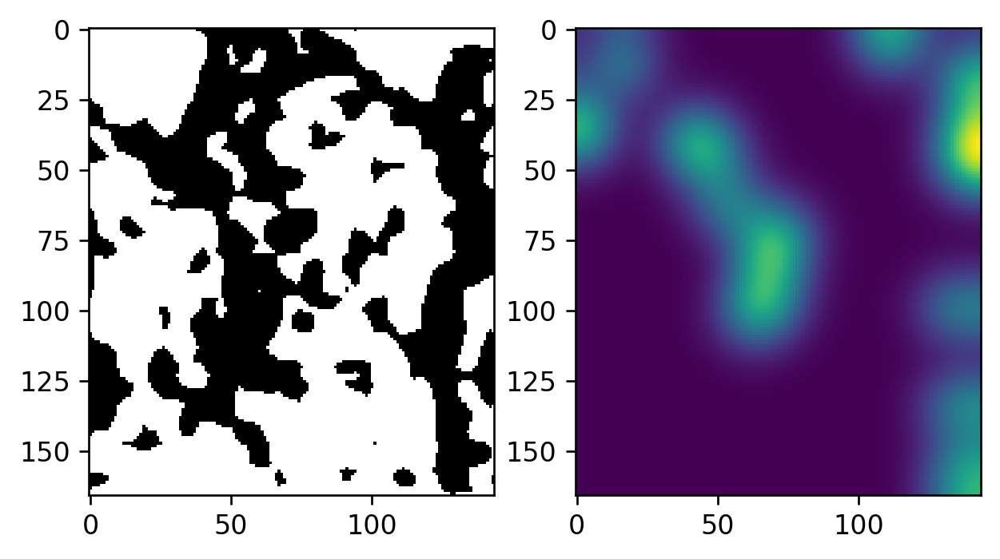

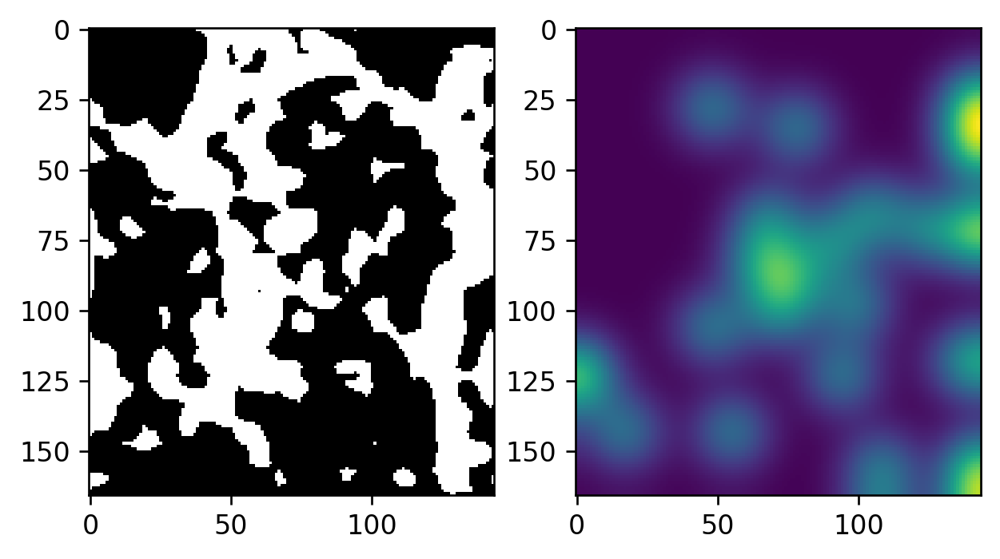

SCALE NUM [2, 9.0]
Average Size 9.0
CENTROID NUM 2
[[25.99035714 26.0225    ]
 [29.         19.        ]]
SCALE NUM [9, 19.125]
Average Size 19.125
CENTROID NUM 9
[[25.80384036 26.57454819]
 [32.5         1.5       ]
 [45.7037037   3.35185185]
 [37.5         5.5       ]
 [ 0.5        13.        ]
 [51.5        16.        ]
 [ 1.91891892 33.78378378]
 [24.         35.5       ]
 [40.         51.5       ]]
2
9


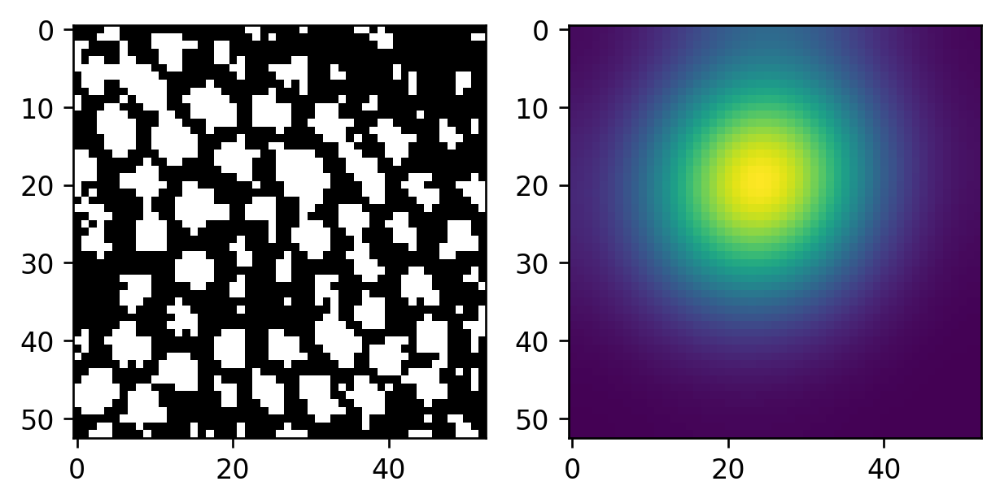

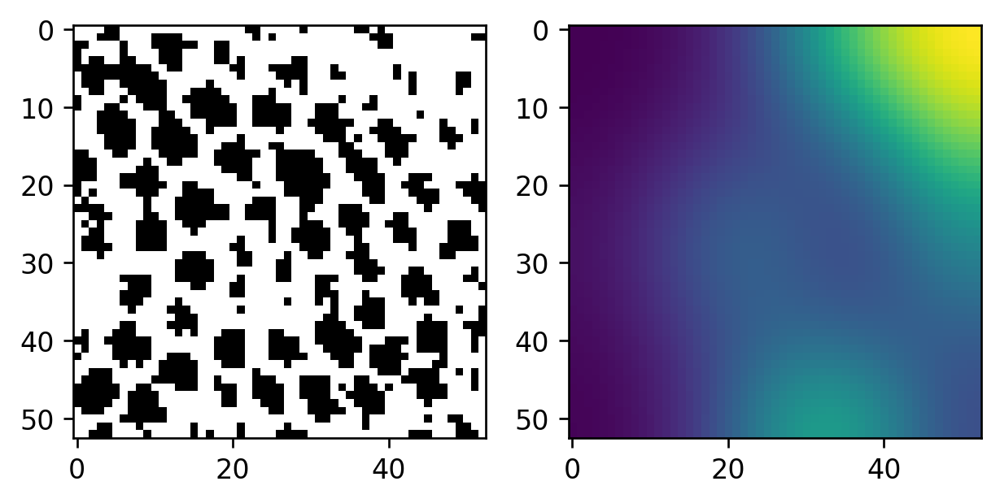

SCALE NUM [7, 9.0]
Average Size 9.0
CENTROID NUM 7
[[26.74358974 26.1292735 ]
 [ 7.         12.        ]
 [16.6        13.4       ]
 [ 1.         18.        ]
 [52.5        24.        ]
 [12.         26.        ]
 [ 0.5        32.        ]]
SCALE NUM [11, 16.7]
Average Size 16.7
CENTROID NUM 11
[[26.33729128 26.13209647]
 [ 9.          0.5       ]
 [29.65        3.95      ]
 [52.5         4.5       ]
 [43.          7.        ]
 [49.         11.        ]
 [ 7.         42.        ]
 [22.16216216 48.59459459]
 [46.         47.        ]
 [52.5        48.5       ]
 [ 4.         51.5       ]]
7
11


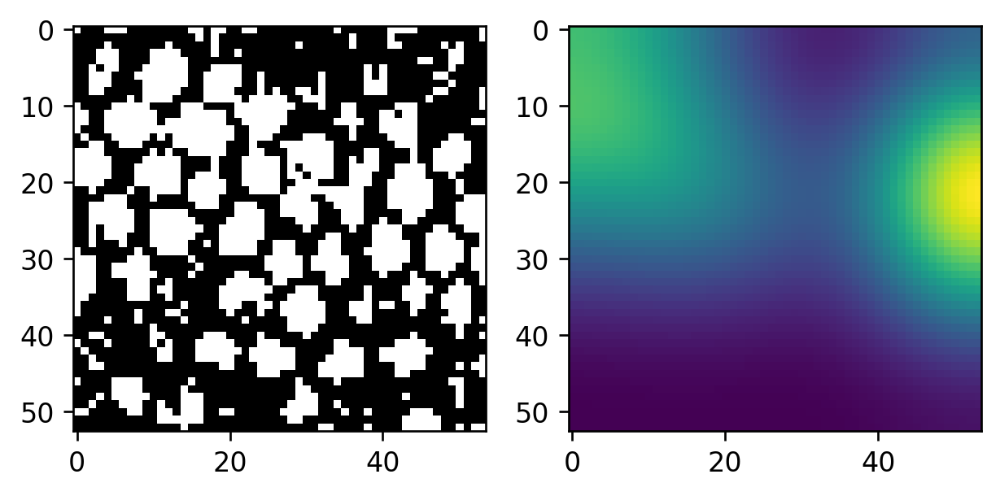

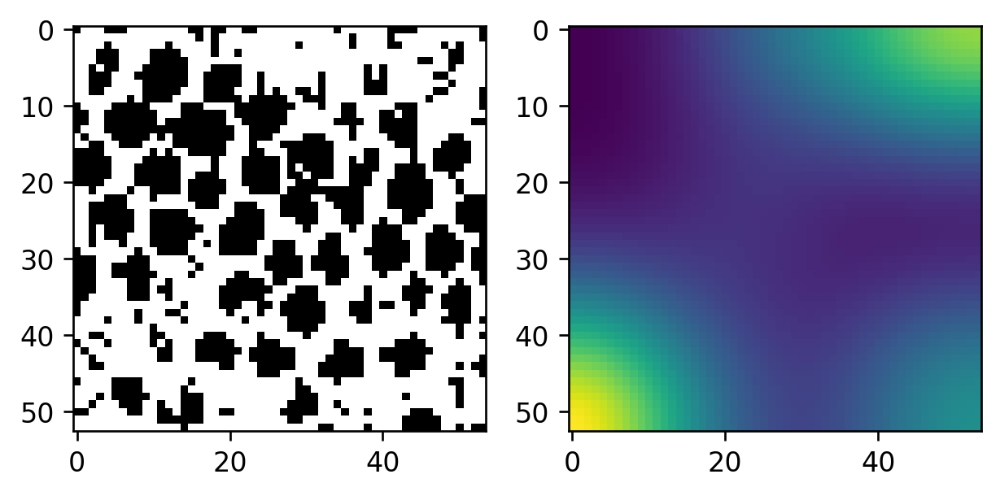

SCALE NUM [11, 1520.0]
Average Size 1520.0
CENTROID NUM 11
[[ 82.05362493  83.66387058]
 [ 85.77341633  84.77773709]
 [157.5         40.        ]
 [154.63125     52.0875    ]
 [159.13253012  75.3815261 ]
 [  8.69166667  77.925     ]
 [149.5         98.5       ]
 [164.5         98.        ]
 [  8.29555556 129.22777778]
 [162.6969697  114.6969697 ]
 [ 89.11428571 168.8       ]]
SCALE NUM [22, 385.04761904761904]
Average Size 385.04761904761904
CENTROID NUM 22
[[ 81.92739177  87.96188801]
 [ 30.48021264  79.10307147]
 [138.00058893  62.20170789]
 [ 60.71428571  10.28571429]
 [  7.          41.        ]
 [ 94.95384615  58.3       ]
 [108.5         53.5       ]
 [ 15.63636364  56.68181818]
 [ 74.26470588  56.67647059]
 [  2.4         71.96      ]
 [ 48.          74.5       ]
 [156.8         79.44      ]
 [ 67.6         81.4       ]
 [  0.5         84.5       ]
 [ 48.89333333 103.74666667]
 [ 40.5        121.5       ]
 [137.5        122.5       ]
 [123.23469388 129.86734694]
 [ 56.5        1

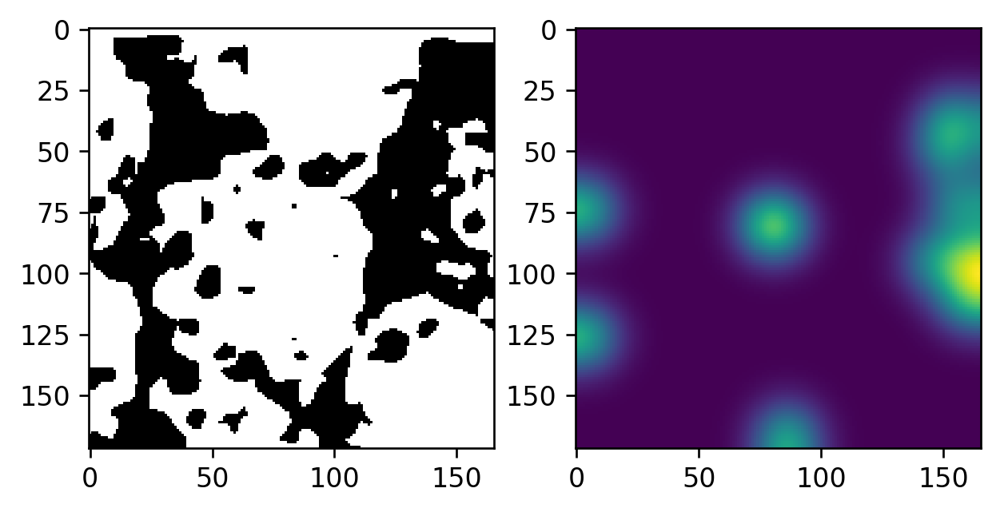

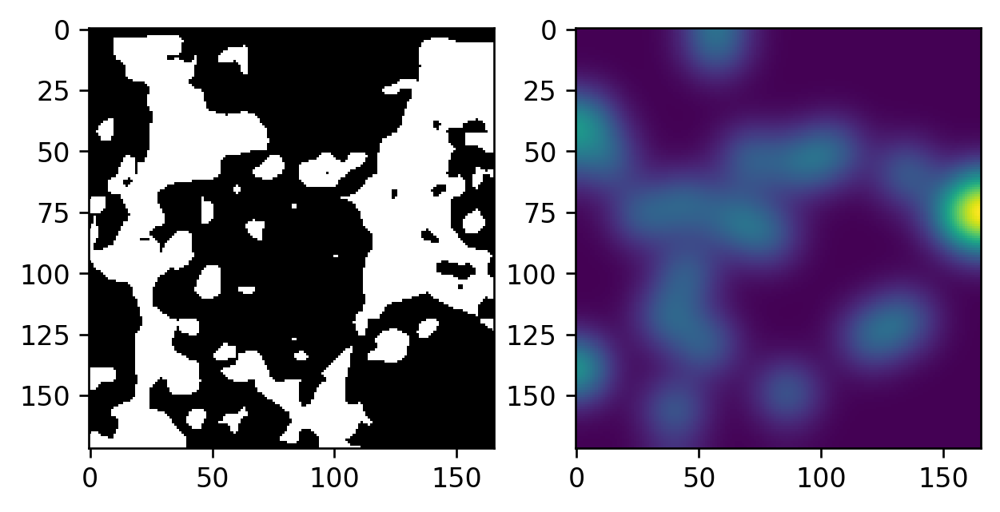

SCALE NUM [7, 9.5]
Average Size 9.5
CENTROID NUM 7
[[26.23636364 26.1315508 ]
 [36.         11.        ]
 [44.         12.        ]
 [ 7.         16.        ]
 [51.5        16.        ]
 [44.5        22.        ]
 [52.5        51.        ]]
SCALE NUM [9, 16.875]
Average Size 16.875
CENTROID NUM 9
[[26.79024569 25.94719472]
 [19.47368421  1.68421053]
 [42.          0.5       ]
 [48.          2.        ]
 [10.         33.        ]
 [ 4.         36.        ]
 [ 2.14634146 45.3902439 ]
 [43.         46.5       ]
 [19.         51.5       ]]
7
9


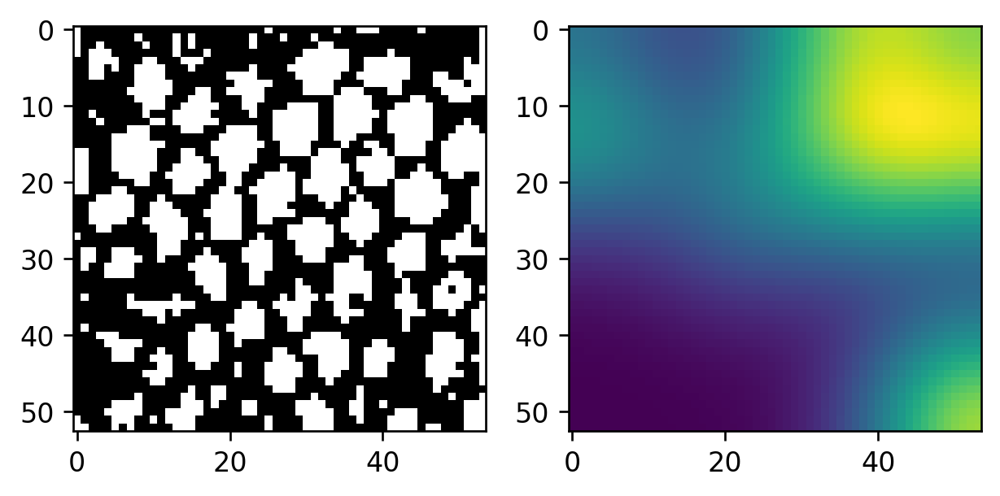

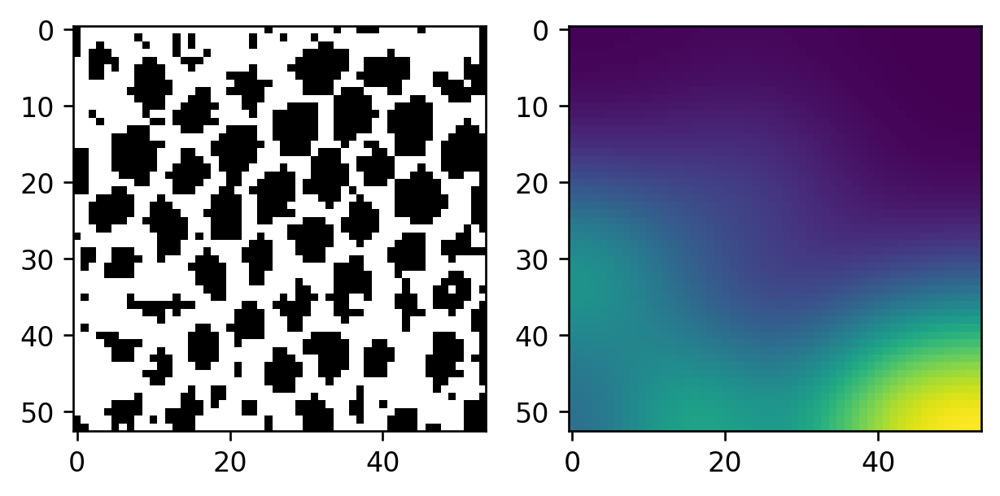

SCALE NUM [16, 699.6666666666666]
Average Size 699.6666666666666
CENTROID NUM 16
[[ 84.82257179  88.42162063]
 [ 23.5064711   14.08886972]
 [ 99.20613882  29.07987443]
 [161.80769231  20.19230769]
 [139.06122449  41.        ]
 [153.62569832  49.11731844]
 [ 29.72689271  79.33859731]
 [160.83333333  55.41666667]
 [ 98.40906344 105.44984894]
 [  0.5        100.        ]
 [162.5        108.        ]
 [ 31.22727273 138.22727273]
 [143.68488746 149.43729904]
 [ 24.46385542 155.20783133]
 [  0.5        148.        ]
 [ 52.35135135 151.24324324]]
SCALE NUM [20, 547.3157894736842]
Average Size 547.3157894736842
CENTROID NUM 20
[[ 76.94562648  76.7083106 ]
 [ 41.70404984  31.54517134]
 [ 98.81632653   1.7755102 ]
 [127.42553191   2.44680851]
 [104.01937208 103.02912492]
 [  2.26388889   7.45833333]
 [ 71.5         39.        ]
 [158.          50.        ]
 [106.07407407  72.44444444]
 [ 84.97321429  81.79464286]
 [122.5         73.        ]
 [  4.1291866   98.67464115]
 [ 35.77083333  87.770833

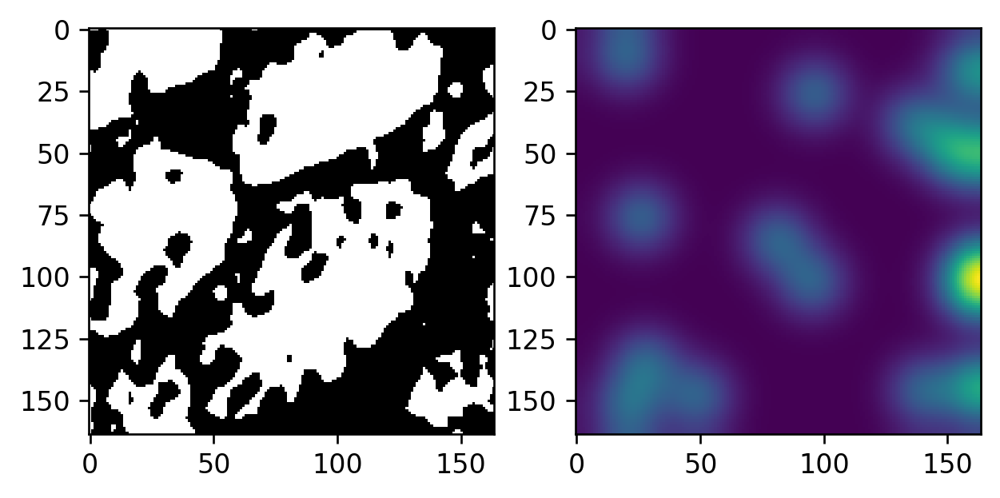

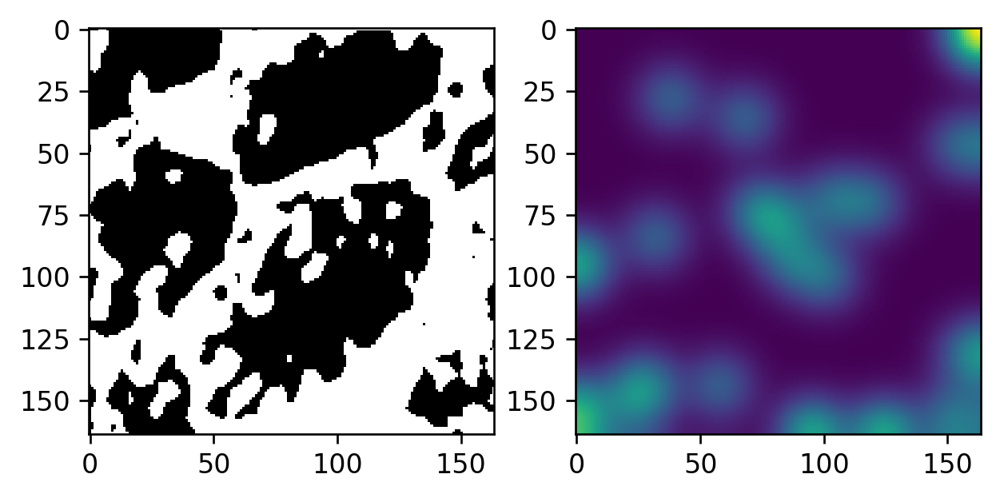

SCALE NUM [10, 642.7777777777778]
Average Size 642.7777777777778
CENTROID NUM 10
[[ 70.66434826  77.98869776]
 [ 16.72580645  11.17990074]
 [118.65625     23.49625   ]
 [ 85.76923077  34.84615385]
 [ 17.25925926  52.36831276]
 [121.49206349  77.02597403]
 [ 29.78776978  94.72661871]
 [128.69421488 126.36983471]
 [ 44.82479784 138.0359389 ]
 [  9.57142857 137.42857143]]
SCALE NUM [3, 6805.5]
Average Size 6805.5
CENTROID NUM 3
[[ 74.1784463   69.36039628]
 [ 69.3564503   79.77736659]
 [139.42         5.76      ]]
10
3


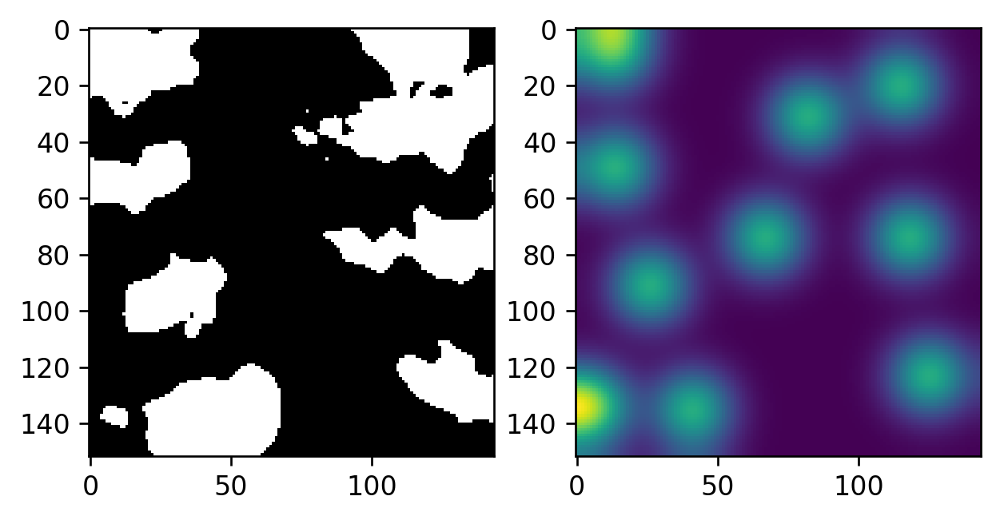

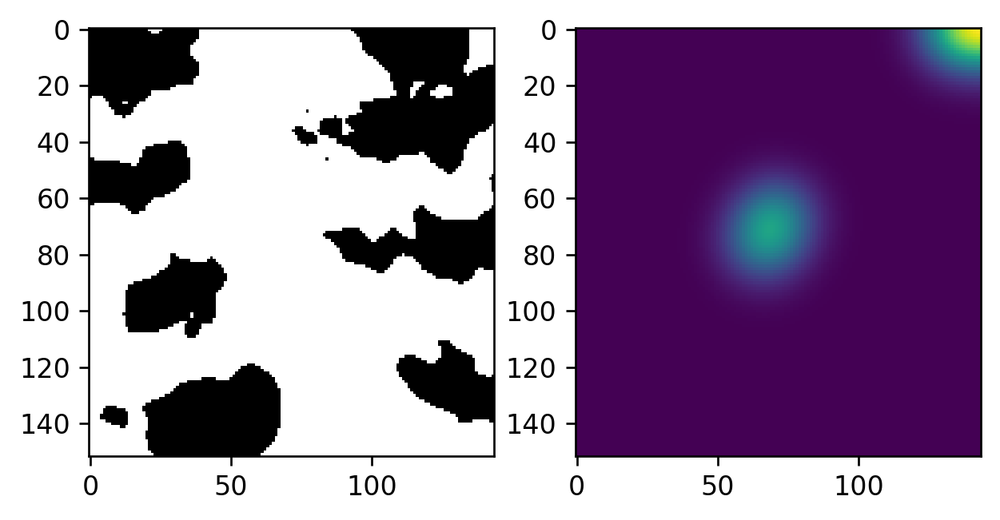

SCALE NUM [6, 56.4]
Average Size 56.4
CENTROID NUM 6
[[26.46535376 25.12290299]
 [30.5         0.5       ]
 [41.54054054 12.48648649]
 [47.36842105 31.97368421]
 [27.3740458  47.13740458]
 [50.36764706 49.89705882]]
SCALE NUM [7, 149.66666666666666]
Average Size 149.66666666666666
CENTROID NUM 7
[[30.27281279 28.49670743]
 [ 4.71034483  8.33793103]
 [52.21428571  6.84693878]
 [25.24663677 12.80269058]
 [11.26300578 35.26300578]
 [38.86792453 22.98113208]
 [42.81818182 42.36363636]]
6
7


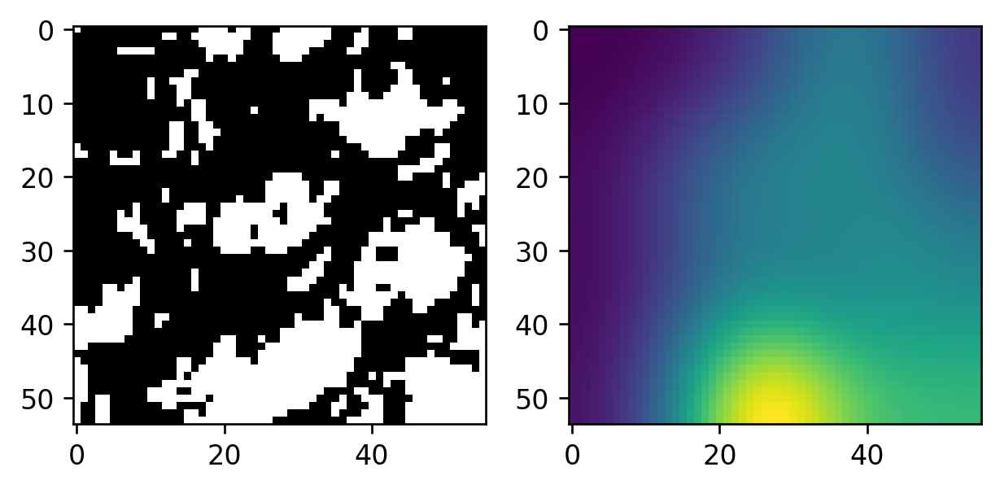

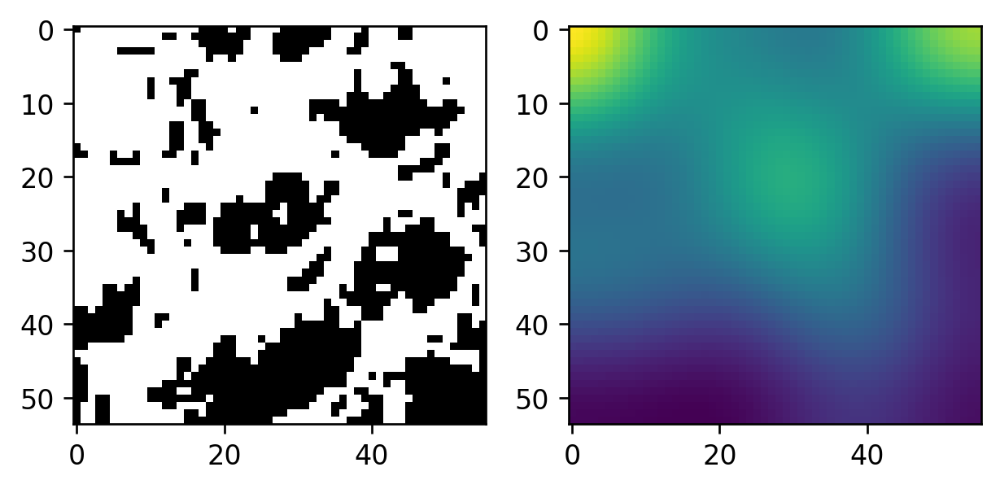

SCALE NUM [8, 161.14285714285714]
Average Size 161.14285714285714
CENTROID NUM 8
[[29.42616034 23.32594937]
 [29.83783784  1.40540541]
 [ 9.02631579  7.75      ]
 [ 1.62264151 18.        ]
 [22.20555556 26.7       ]
 [48.27826087 30.85217391]
 [ 8.23876404 40.80617978]
 [32.10932476 46.48874598]]
SCALE NUM [6, 134.8]
Average Size 134.8
CENTROID NUM 6
[[23.47489362 30.96382979]
 [37.06641366  9.37381404]
 [ 9.5        18.        ]
 [36.35       28.75      ]
 [48.24615385 46.21538462]
 [ 0.5        51.        ]]
8
6


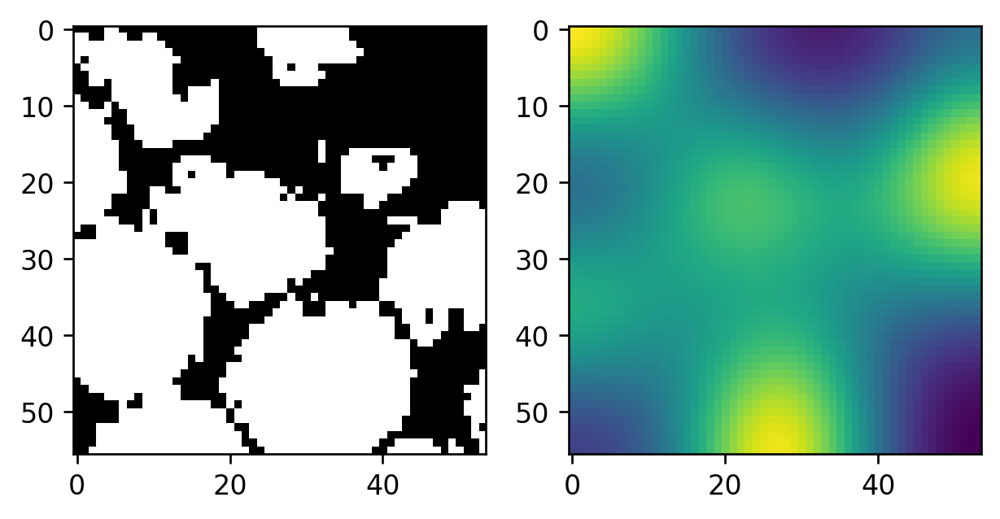

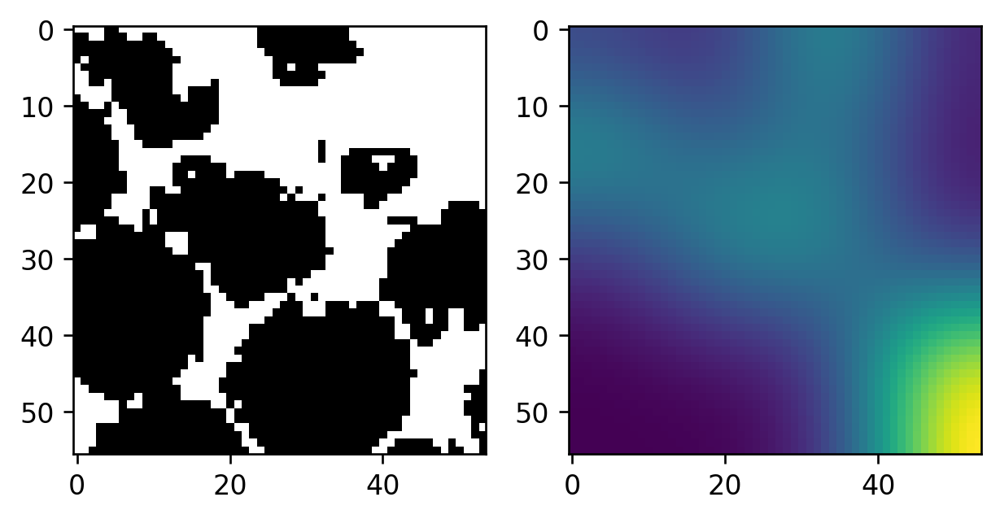

SCALE NUM [7, 1769.8333333333333]
Average Size 1769.8333333333333
CENTROID NUM 7
[[ 73.95143578  69.54368733]
 [  6.70179136  42.36670179]
 [ 76.00499584  19.84929226]
 [144.91384615  19.68512821]
 [137.40319584 109.64176886]
 [ 59.73320659 127.11237854]
 [127.76811594 147.04347826]]
SCALE NUM [8, 1619.2857142857142]
Average Size 1619.2857142857142
CENTROID NUM 8
[[ 83.1115095   90.84331302]
 [ 70.41177019  63.95056892]
 [149.93488372  69.93023256]
 [  5.25663717 148.55752212]
 [ 50.51612903 149.77419355]
 [ 60.33333333 146.16666667]
 [135.         145.        ]
 [133.5        153.        ]]
7
8


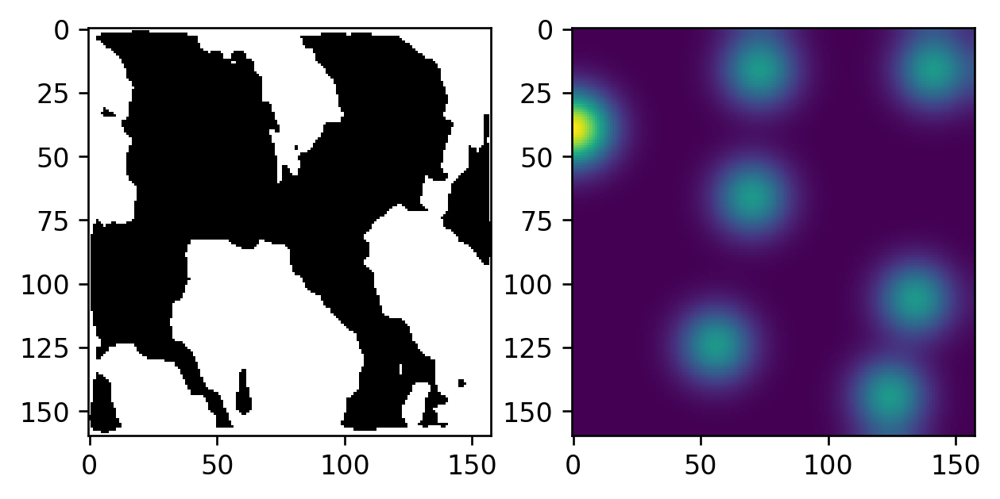

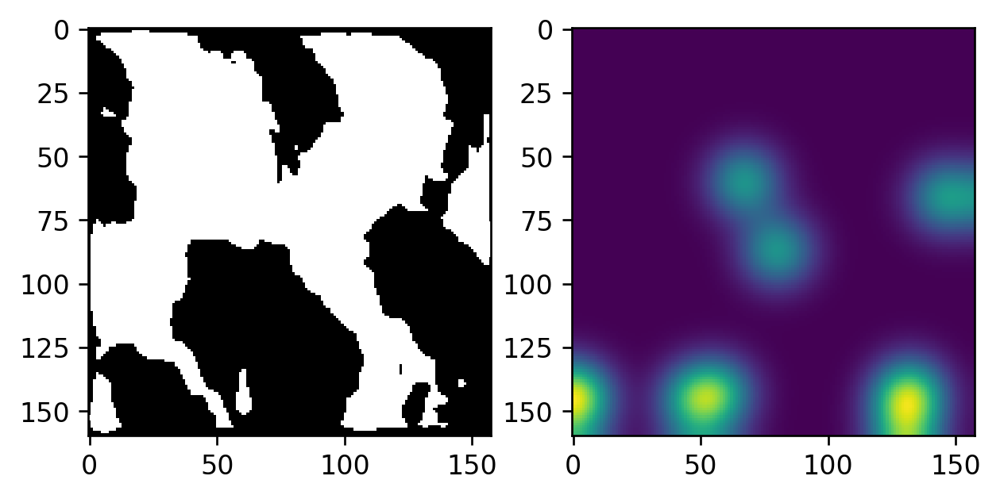

SCALE NUM [11, 37.0]
Average Size 37.0
CENTROID NUM 11
[[27.92804428 26.49225092]
 [19.77777778  2.66666667]
 [ 2.31111111  9.57777778]
 [21.         14.        ]
 [ 3.1875     19.8125    ]
 [19.5        29.        ]
 [38.85454545 29.69090909]
 [22.10869565 40.29347826]
 [ 1.5        46.        ]
 [50.66129032 51.12903226]
 [26.         53.5       ]]
SCALE NUM [11, 49.2]
Average Size 49.2
CENTROID NUM 11
[[25.65262751 28.27666151]
 [29.69230769  5.6043956 ]
 [41.5         0.5       ]
 [51.71428571  6.86554622]
 [10.         12.5       ]
 [50.1125     24.1875    ]
 [35.26923077 20.76923077]
 [22.27272727 22.61818182]
 [ 8.89473684 43.42105263]
 [34.68918919 47.66216216]
 [14.5        53.5       ]]
11
11


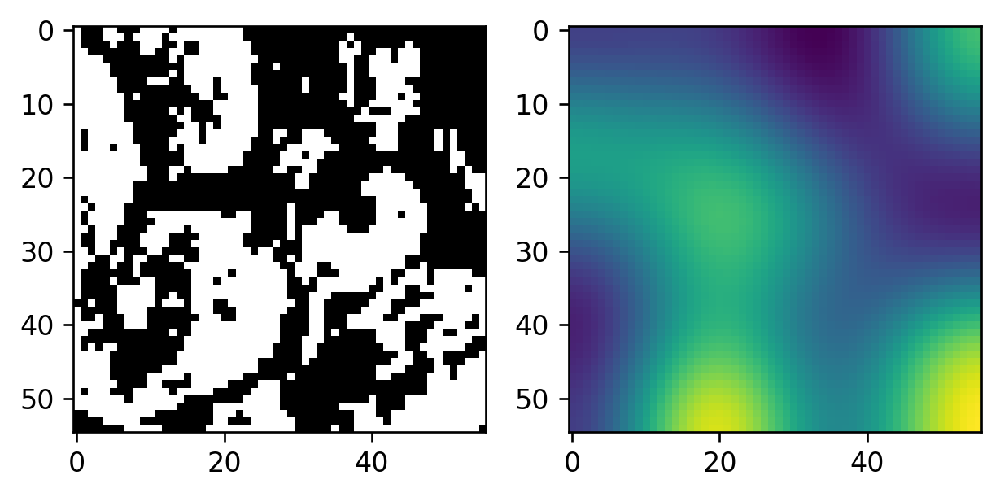

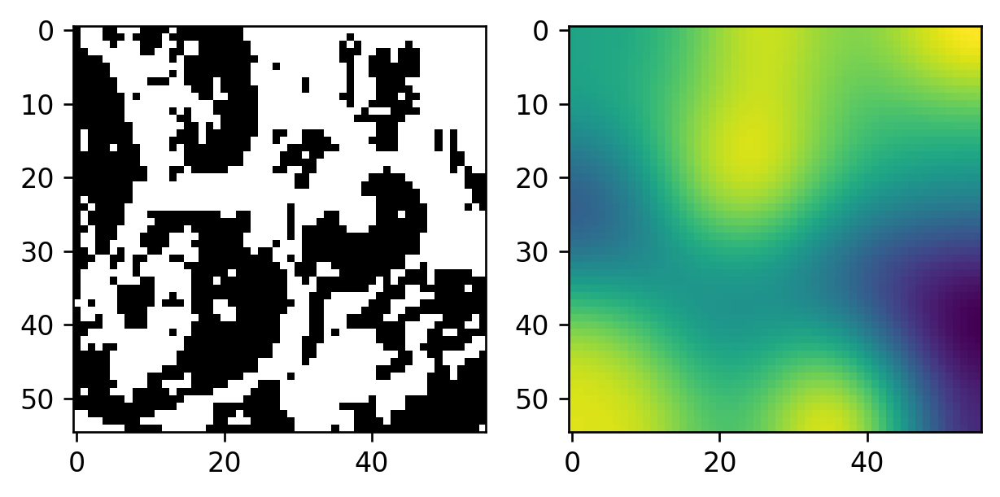

SCALE NUM [11, 235.7]
Average Size 235.7
CENTROID NUM 11
[[52.02041114 40.58025951]
 [89.79411765 13.61764706]
 [27.1315261  66.95180723]
 [34.54545455 31.09090909]
 [87.         34.        ]
 [64.78205128 72.30769231]
 [90.85714286 76.64285714]
 [75.         78.        ]
 [89.125      89.03409091]
 [57.97560976 92.82926829]
 [76.4        91.73333333]]
SCALE NUM [11, 410.9]
Average Size 410.9
CENTROID NUM 11
[[44.2490699  59.90033288]
 [53.69517972 27.70186682]
 [92.09259259 23.87037037]
 [ 5.02040816 51.2122449 ]
 [53.06666667 77.02857143]
 [61.         81.        ]
 [94.5        86.        ]
 [68.40350877 90.10526316]
 [83.66666667 93.16666667]
 [47.         93.75      ]
 [ 2.         94.5       ]]
11
11


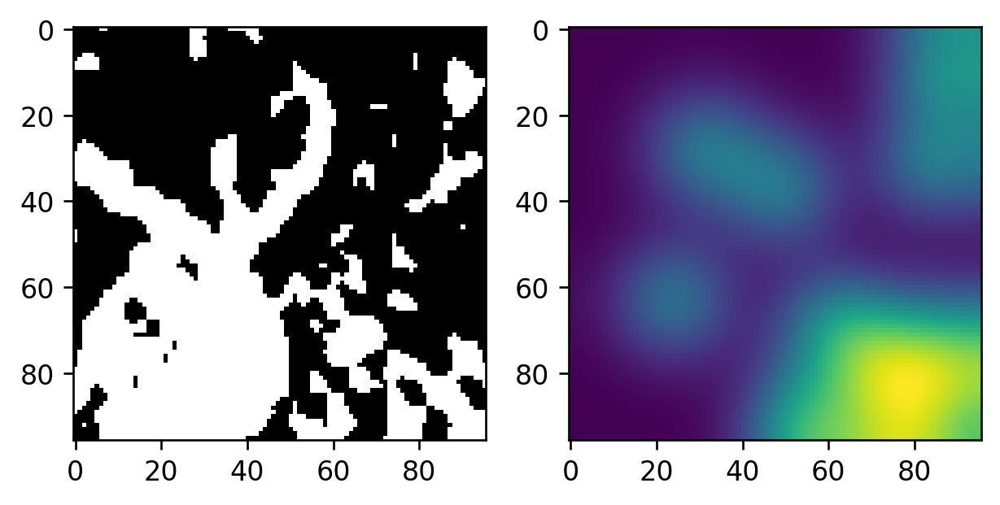

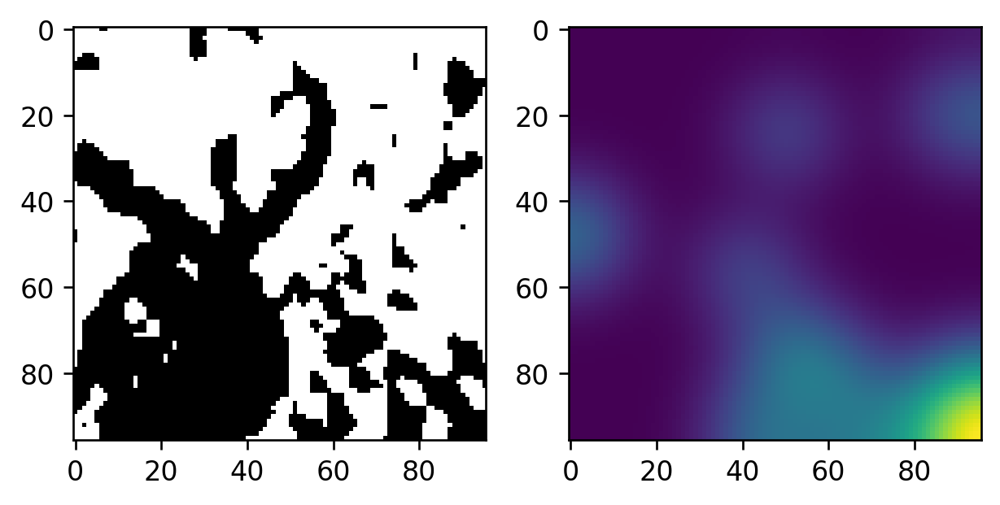

SCALE NUM [12, 1212.4545454545455]
Average Size 1212.4545454545455
CENTROID NUM 12
[[101.32025451  81.53446448]
 [ 53.63089087  78.01236887]
 [154.70238095  44.94047619]
 [150.89583333  87.6875    ]
 [140.44329897 105.55670103]
 [136.2195122  122.58536585]
 [153.6442953  135.65100671]
 [142.29508197 136.70491803]
 [108.85714286 133.14285714]
 [139.5483871  158.41935484]
 [156.04347826 157.65217391]
 [112.5        160.5       ]]
SCALE NUM [19, 396.72222222222223]
Average Size 396.72222222222223
CENTROID NUM 19
[[ 67.76981848  81.15144947]
 [ 87.58181818  10.83636364]
 [107.50847458   4.86440678]
 [128.376        3.52      ]
 [ 26.75        15.38235294]
 [130.99615089  79.85527329]
 [154.36486486  28.37837838]
 [ 37.00573066  50.53008596]
 [ 80.98290598  58.17777778]
 [ 47.34810127  86.16455696]
 [ 88.3326226  100.56929638]
 [ 63.88888889  95.        ]
 [ 35.54       116.62      ]
 [ 63.10869565 128.04782609]
 [ 21.32258065 124.16129032]
 [ 96.66395664 137.09214092]
 [148.625      135.12

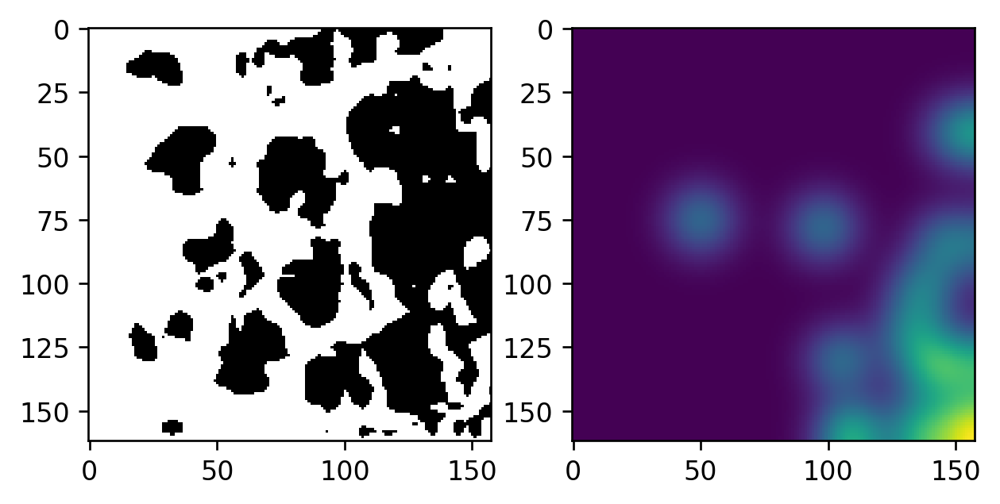

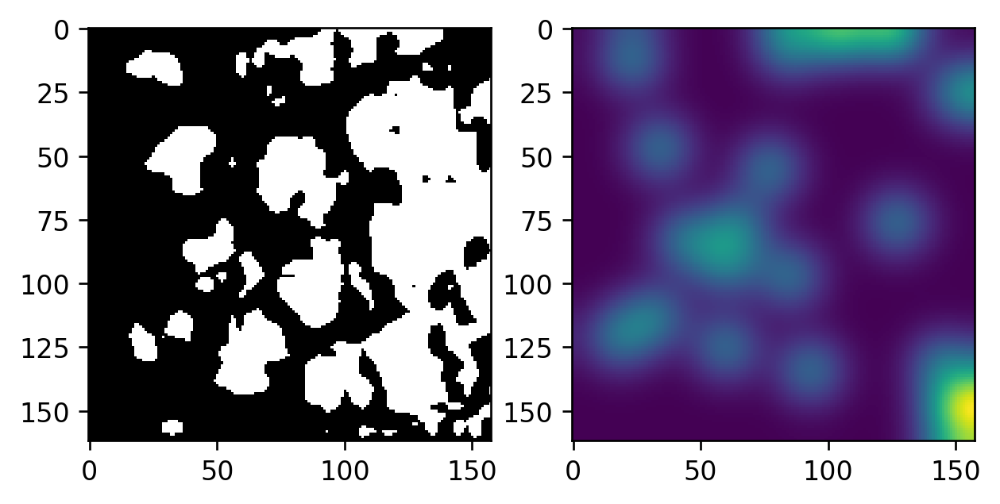

SCALE NUM [12, 206.54545454545453]
Average Size 206.54545454545453
CENTROID NUM 12
[[ 84.30779242  78.75028469]
 [ 13.27019499  16.51253482]
 [ 89.95437262  11.19771863]
 [160.66359447  21.25806452]
 [ 97.32258065  57.29032258]
 [155.5         56.        ]
 [160.          64.        ]
 [ 13.78823529  91.82352941]
 [153.86065574 112.83401639]
 [ 79.31620553 103.03952569]
 [ 94.3440367  146.83027523]
 [ 11.99009901 152.03960396]]
SCALE NUM [3, 10926.0]
Average Size 10926.0
CENTROID NUM 3
[[ 94.92292332  76.68570288]
 [ 80.04140456  78.0073702 ]
 [162.28       114.1       ]]
12
3


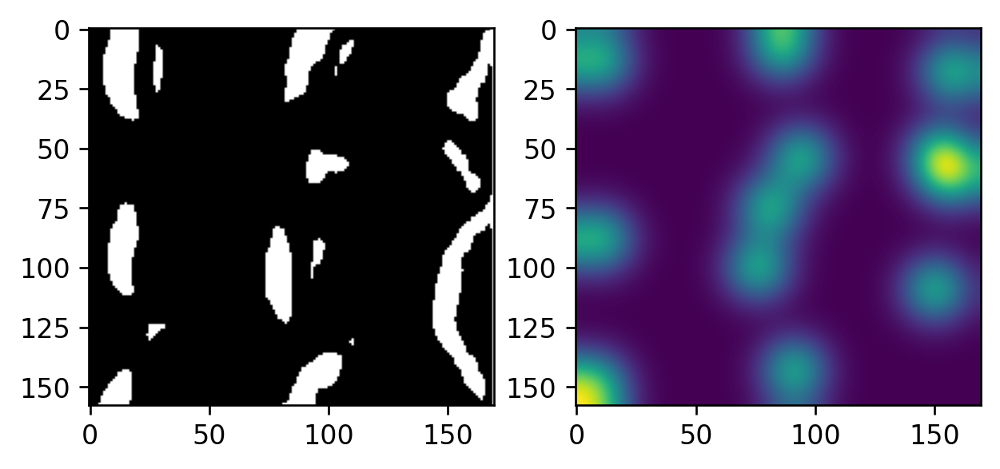

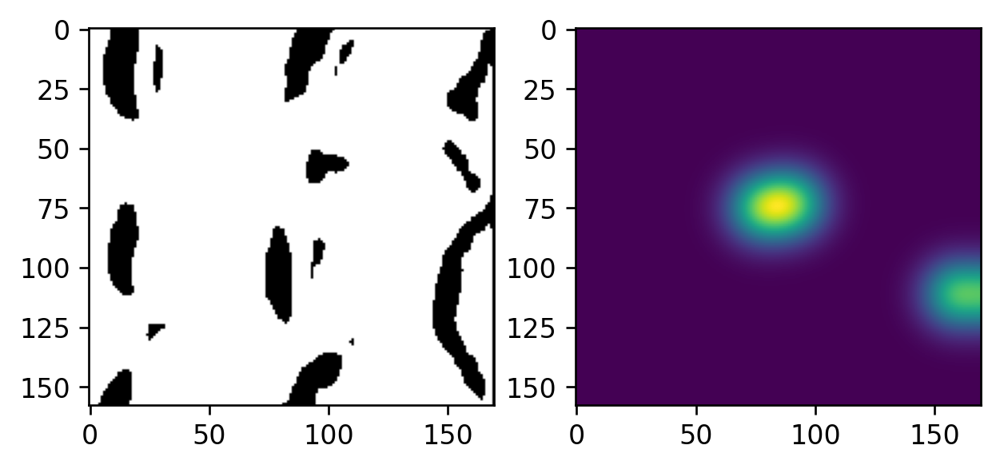

SCALE NUM [11, 1229.3]
Average Size 1229.3
CENTROID NUM 11
[[ 65.22245322  69.54338954]
 [ 95.42793315  88.17830548]
 [137.           0.5       ]
 [137.5          7.        ]
 [ 14.          17.        ]
 [ 87.65306122  28.28571429]
 [ 13.          46.5       ]
 [ 12.          64.5       ]
 [ 11.         107.        ]
 [ 14.28571429 117.87142857]
 [ 26.         154.5       ]]
SCALE NUM [25, 304.1666666666667]
Average Size 304.1666666666667
CENTROID NUM 25
[[ 89.01395996  82.11818687]
 [ 13.92113466  81.07512469]
 [125.79775281   7.66853933]
 [148.36690647   6.57553957]
 [ 62.67473118  13.4516129 ]
 [ 91.87360595  14.78066914]
 [143.92910448  35.33208955]
 [ 78.40901503  54.50083472]
 [110.98958333  37.64583333]
 [ 55.98113208  41.6163522 ]
 [ 46.09230769  61.62051282]
 [102.67680608  63.31178707]
 [138.88435374  62.71428571]
 [156.25742574  81.36633663]
 [ 52.41717791  81.95092025]
 [ 89.88702929  92.24686192]
 [118.42857143  94.81632653]
 [ 22.92672414 104.81034483]
 [ 62.51269036 105

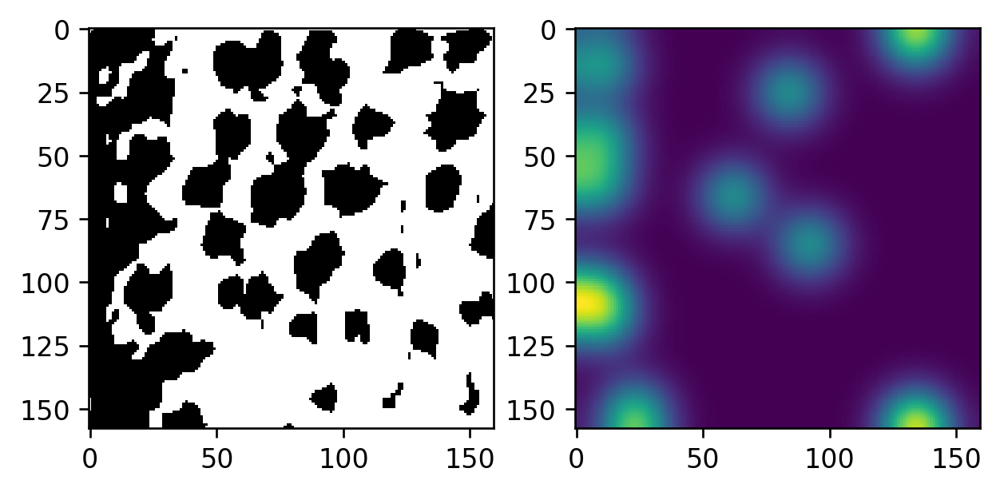

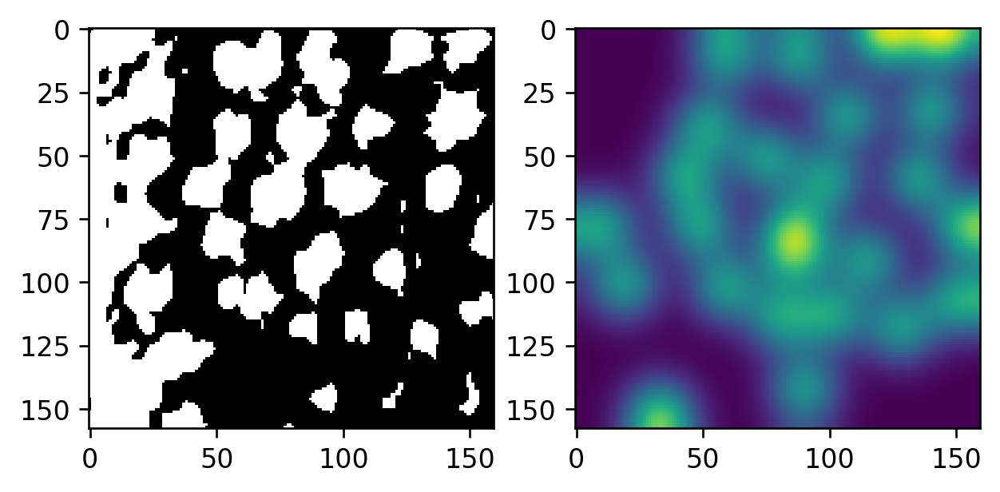

In [36]:
#access img directory
dirname = 'Anolis_cristatellus_images/'

from scipy.ndimage.filters import gaussian_filter

centers = []
inverted_centers = []
thr_images = []
inverted_thr_images = []
average_sizes = []
inverted_average_sizes = []
size_stds = []
inverted_size_stds = []
        
        
#create an iterator object for img directory
directory = os.scandir(dirname)
for img in directory:
    img_name = img.name
    if (img_name != '.ipynb_checkpoints'):
        average_size = 0
        inverted_average_size = 0
        size_std = []
        inverted_size_std = []
        
        orig_img = cv2.imread(dirname + img_name)
        inverted_img = invert(orig_img)
        
        gray = cv2.cvtColor(orig_img, cv2.COLOR_BGR2GRAY)
        img = gray
        inverted_img = cv2.cvtColor(inverted_img, cv2.COLOR_BGR2GRAY)

        ret, thresh = cv2.threshold(img, 0 , 255, cv2.THRESH_BINARY+cv2.THRESH_OTSU)
        kernel = np.ones((3,3),np.uint8)
        
        inverted_ret, inverted_thresh = cv2.threshold(inverted_img, 0 , 255, cv2.THRESH_BINARY+cv2.THRESH_OTSU)
        kernel = np.ones((3,3),np.uint8)
        

        #if the customized iteration number has not yet been determined this if statement will run

        opening = cv2.morphologyEx(thresh,cv2.MORPH_OPEN,kernel, iterations = 2)
        inverted_opening = cv2.morphologyEx(inverted_thresh,cv2.MORPH_OPEN,kernel, iterations = 2)


        # sure background area
        sure_bg = cv2.dilate(opening,kernel,iterations=1)
        inverted_sure_bg = cv2.dilate(inverted_opening,kernel,iterations=1)


        dist_transform = cv2.distanceTransform(opening,cv2.DIST_L2,5)
        ret, sure_fg = cv2.threshold(dist_transform, 1.5, 255, 0) 
        inverted_dist_transform = cv2.distanceTransform(inverted_opening,cv2.DIST_L2,5)
        inverted_ret, inverted_sure_fg = cv2.threshold(inverted_dist_transform, 1.5, 255, 0) 

        # Finding unknown region
        sure_fg = np.uint8(sure_fg)
        unknown = cv2.subtract(sure_bg,sure_fg)
        inverted_sure_fg = np.uint8(inverted_sure_fg)
        inverted_unknown = cv2.subtract(inverted_sure_bg,inverted_sure_fg)

        average_size, c, size_std = centroids(sure_fg, average_size, size_std)
        inverted_average_size, inverted_c, inverted_size_std = centroids(inverted_sure_fg, inverted_average_size, inverted_size_std)
        average_sizes.append(average_size)
        inverted_average_sizes.append(inverted_average_size)
        size_stds.append(np.std(size_stds))
        inverted_size_stds.append(np.std(inverted_size_stds))

       
        
        hm = heat_map(sure_fg, c)
        inverted_hm = heat_map(inverted_sure_fg, inverted_c)

        
        thr_images.append(thresh)
        inverted_thr_images.append(inverted_thresh)
        
        plt.subplot(1,2,1), plt.imshow(thresh, 'gray')

        hm = gaussian_filter(hm, (10, 10))
        inverted_hm = gaussian_filter(inverted_hm, (10, 10))
        plt.subplot(1,2,2), plt.imshow(hm)
        plt.show()
        plt.subplot(1,2,1), plt.imshow(inverted_thresh, 'gray')
        plt.subplot(1,2,2), plt.imshow(inverted_hm)
        
        centers.append(c)
        inverted_centers.append(inverted_c)
        plt.show()
            
            
            


In [37]:
#to see uniformity can look at the distribution of the surrounding points

In [28]:
#ideas?

#split an image until it is uniform??
#Then use that to determine block size?

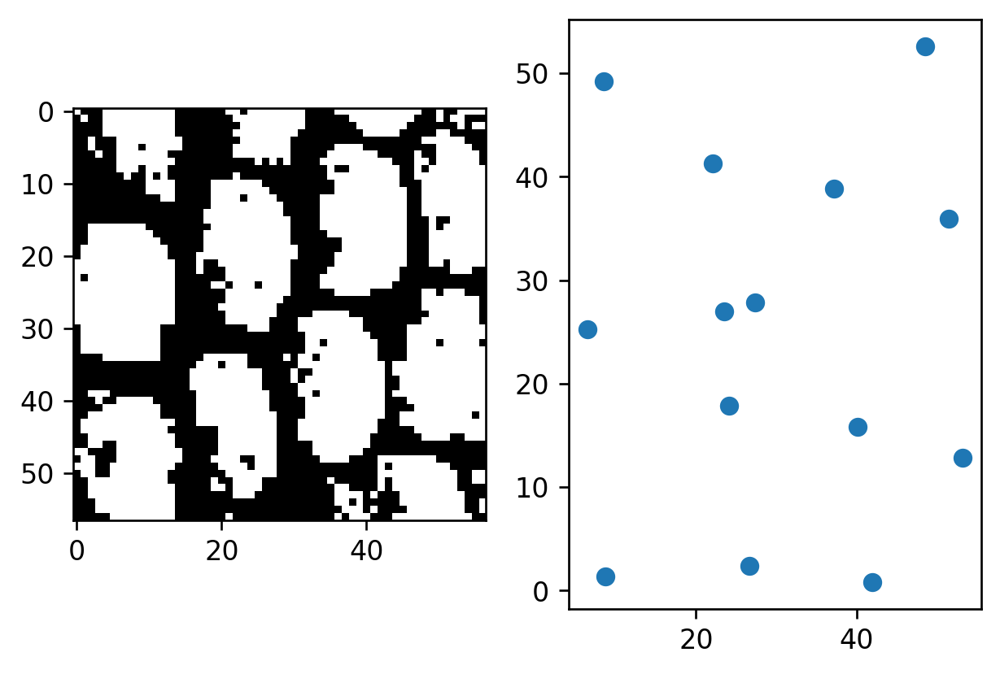

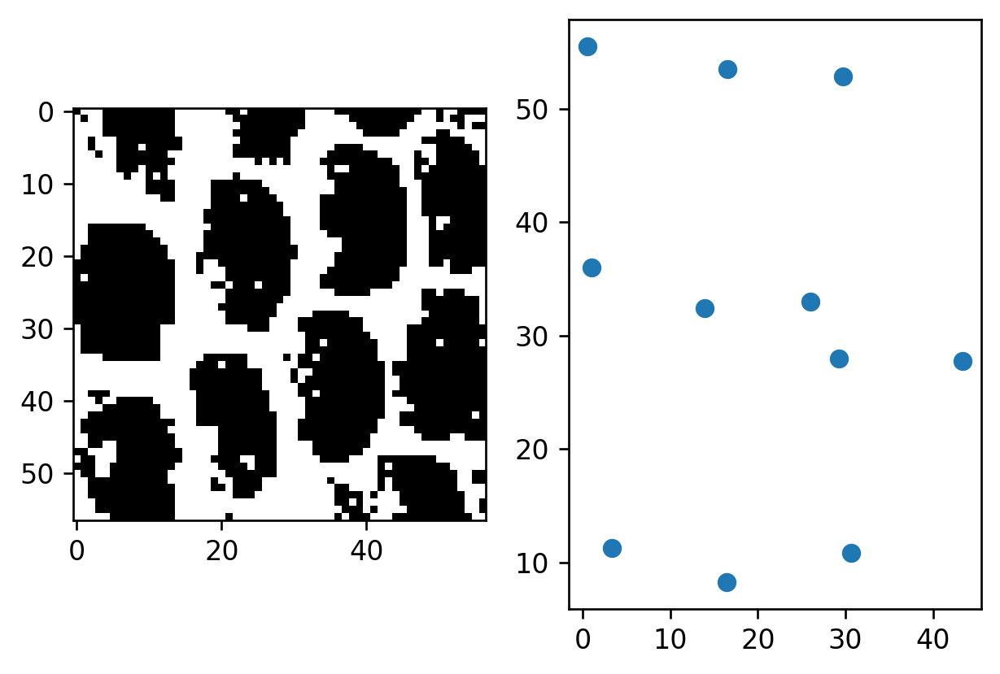

4.316554146291316
[13.247185549746275]
[9.570454660866675]


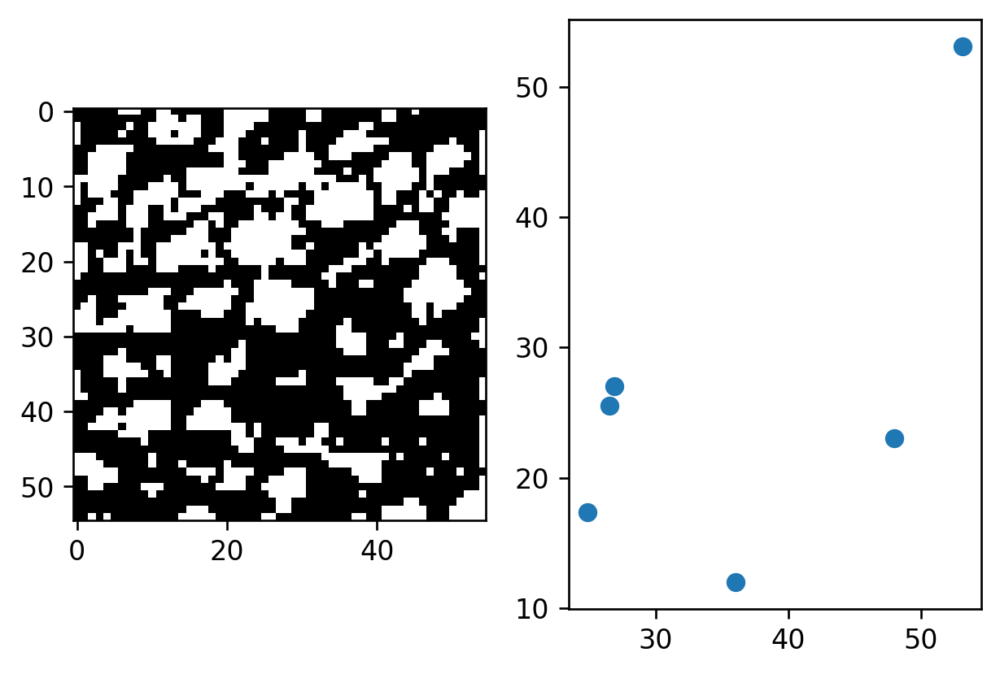

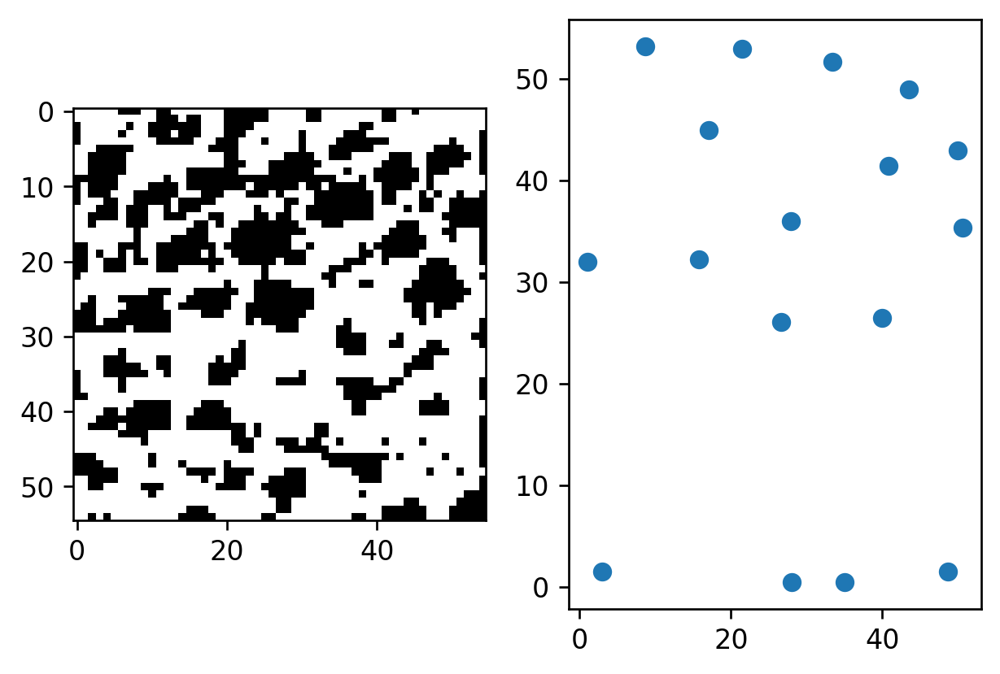

9.938371901100407
[13.247185549746275, 11.788686357456456]
[9.570454660866675, 16.196749921268434]


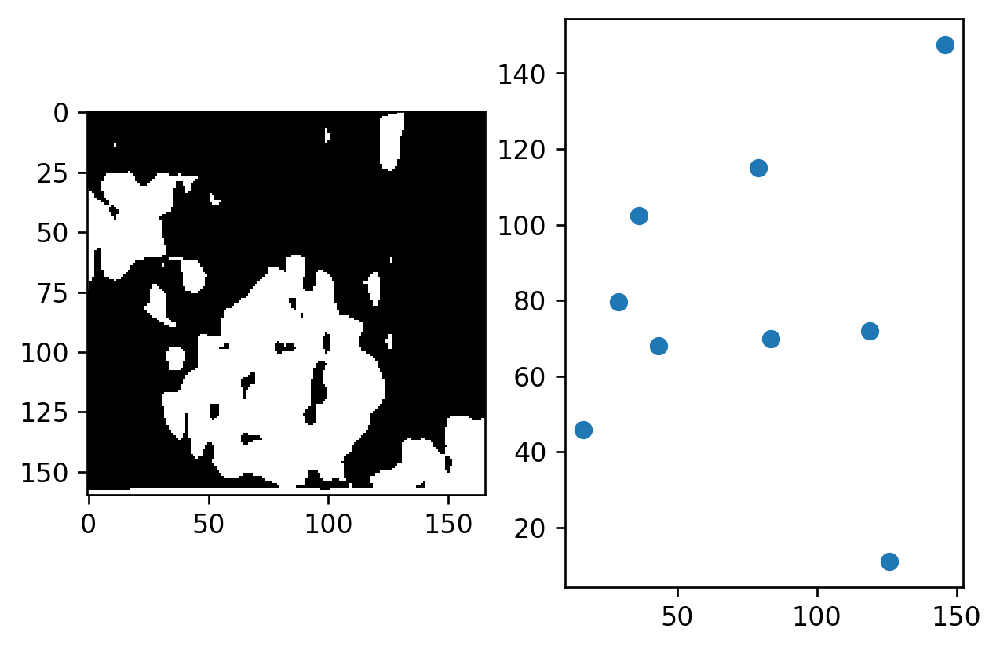

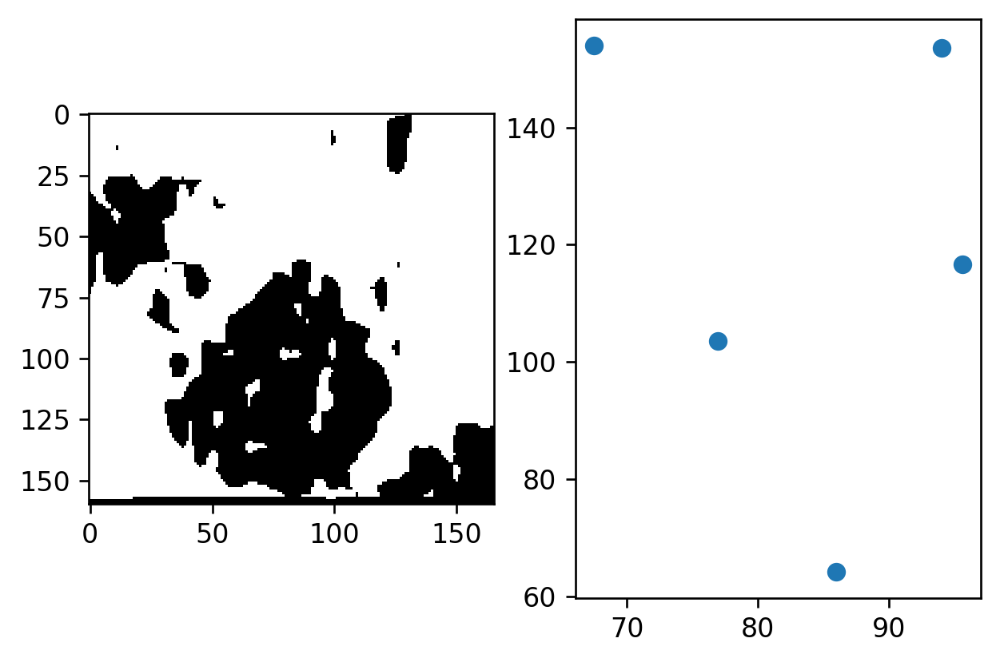

17.849297487930706
[13.247185549746275, 11.788686357456456, 38.59394849705544]
[9.570454660866675, 16.196749921268434, 23.24440056960923]


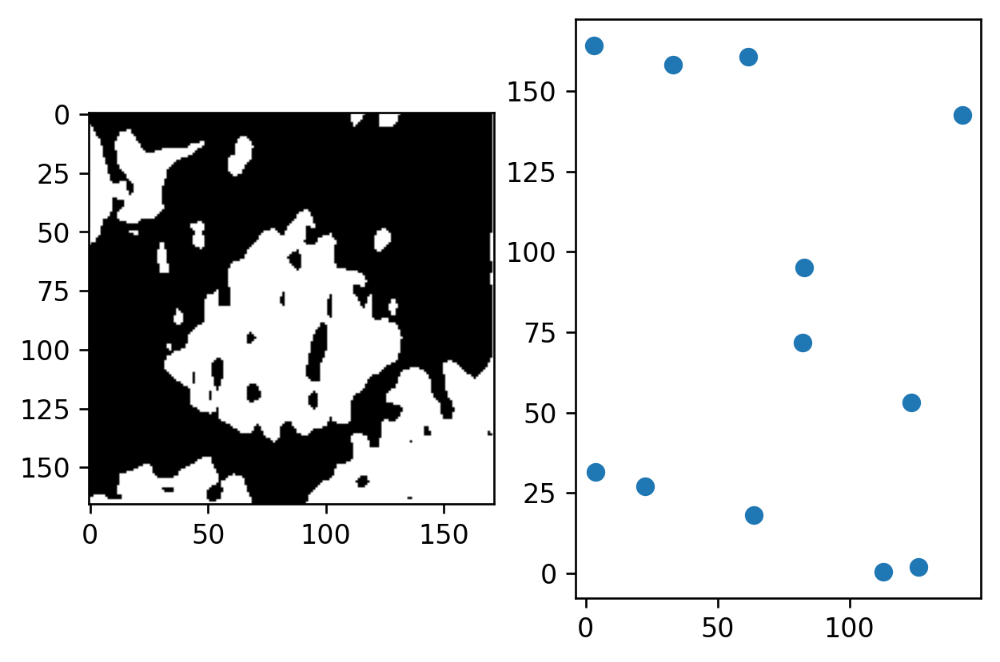

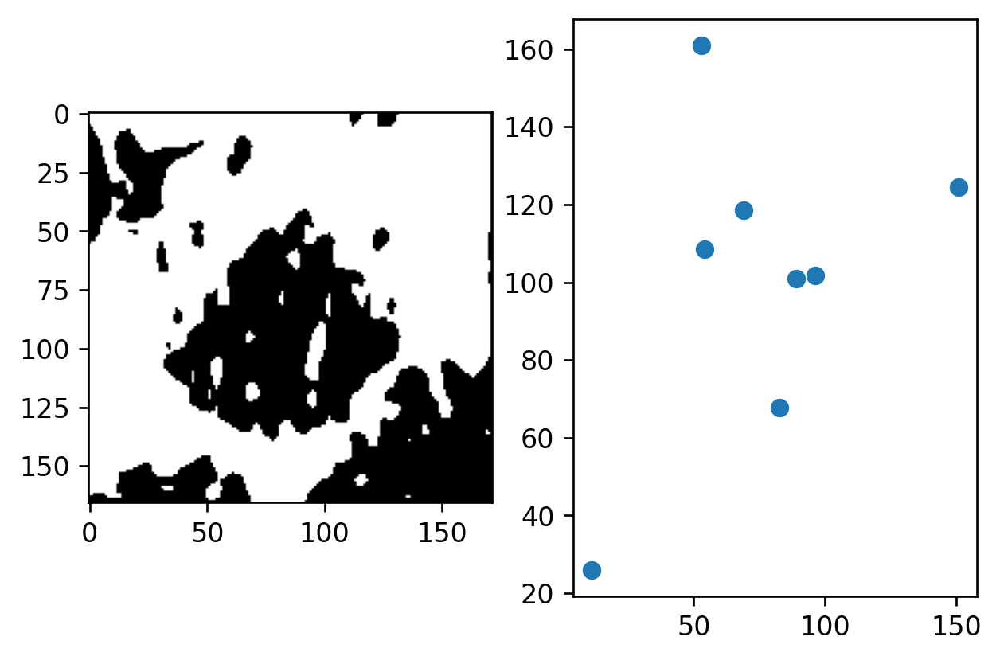

16.858605757152873
[13.247185549746275, 11.788686357456456, 38.59394849705544, 30.32330894793679]
[9.570454660866675, 16.196749921268434, 23.24440056960923, 15.479265932507946]


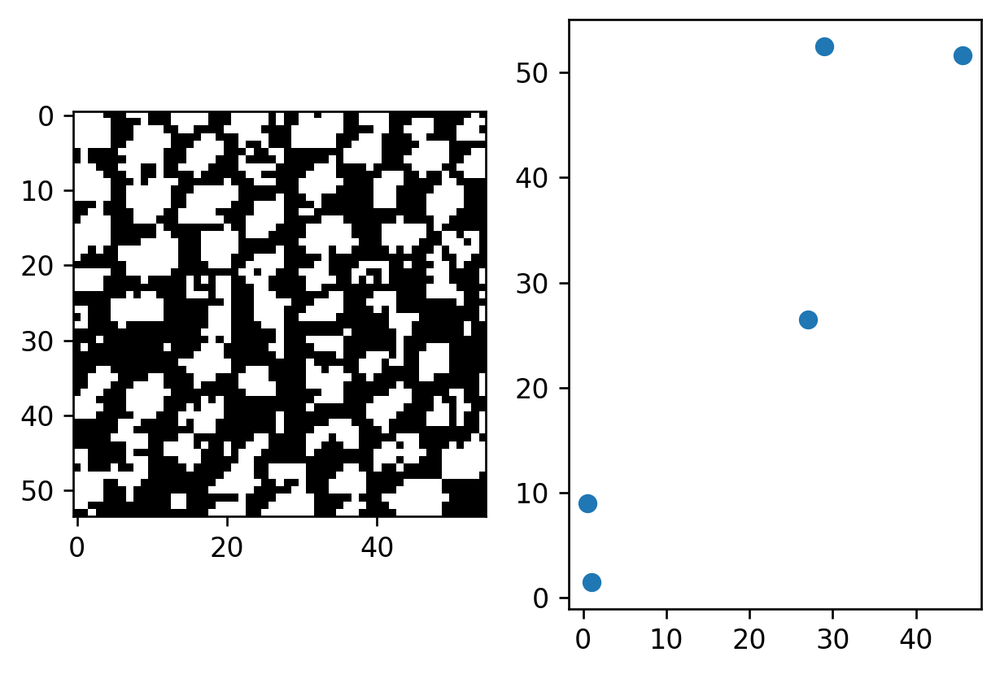

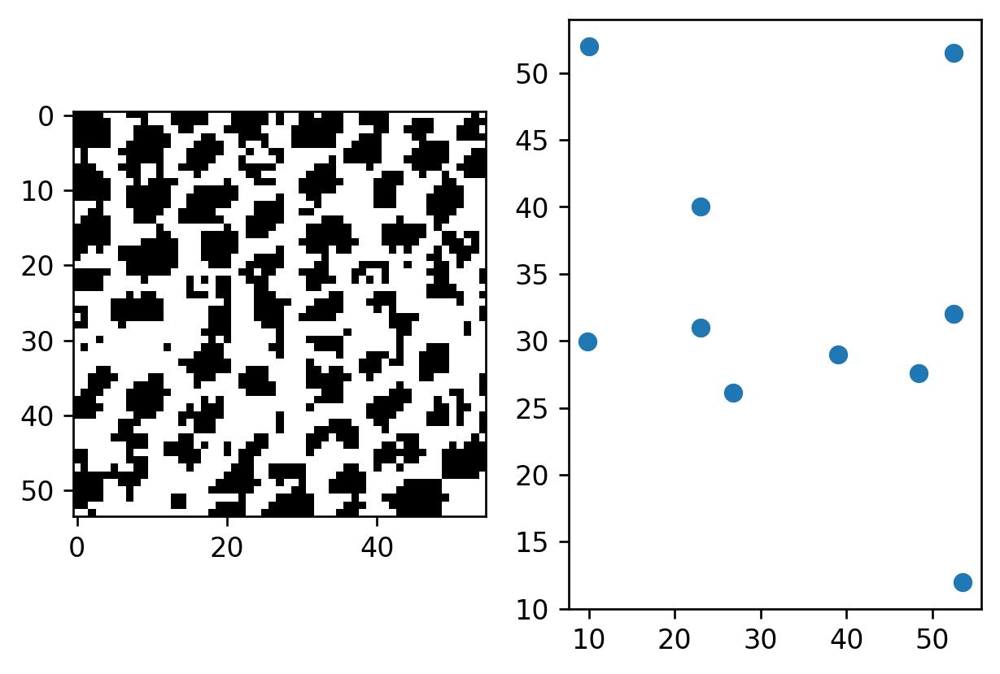

6.9391821069306285
[13.247185549746275, 11.788686357456456, 38.59394849705544, 30.32330894793679, 14.87952149019338]
[9.570454660866675, 16.196749921268434, 23.24440056960923, 15.479265932507946, 14.831722694940897]


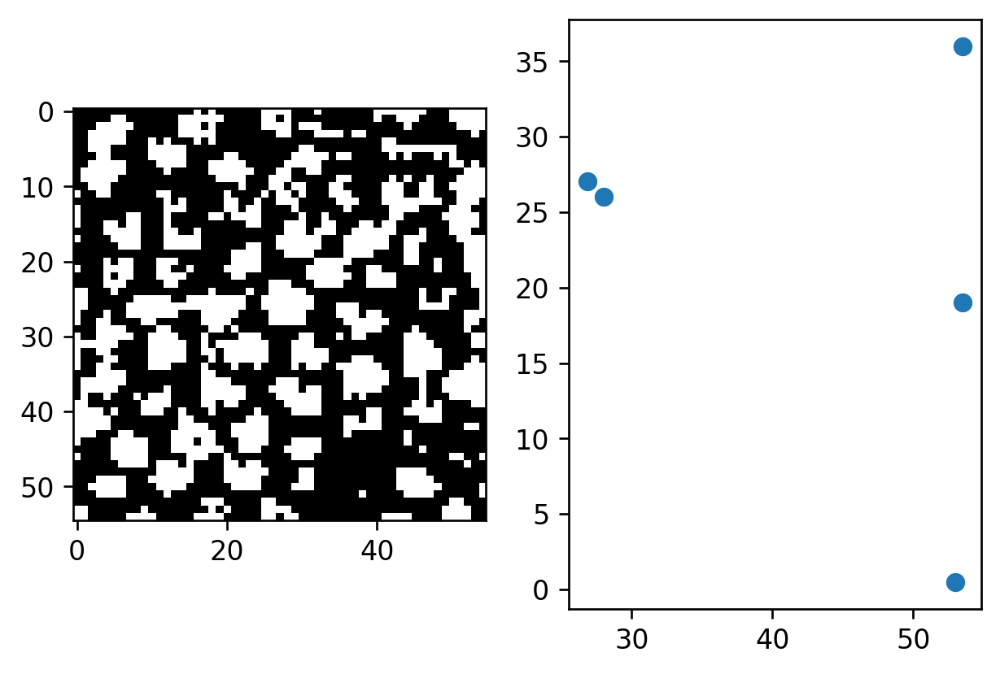

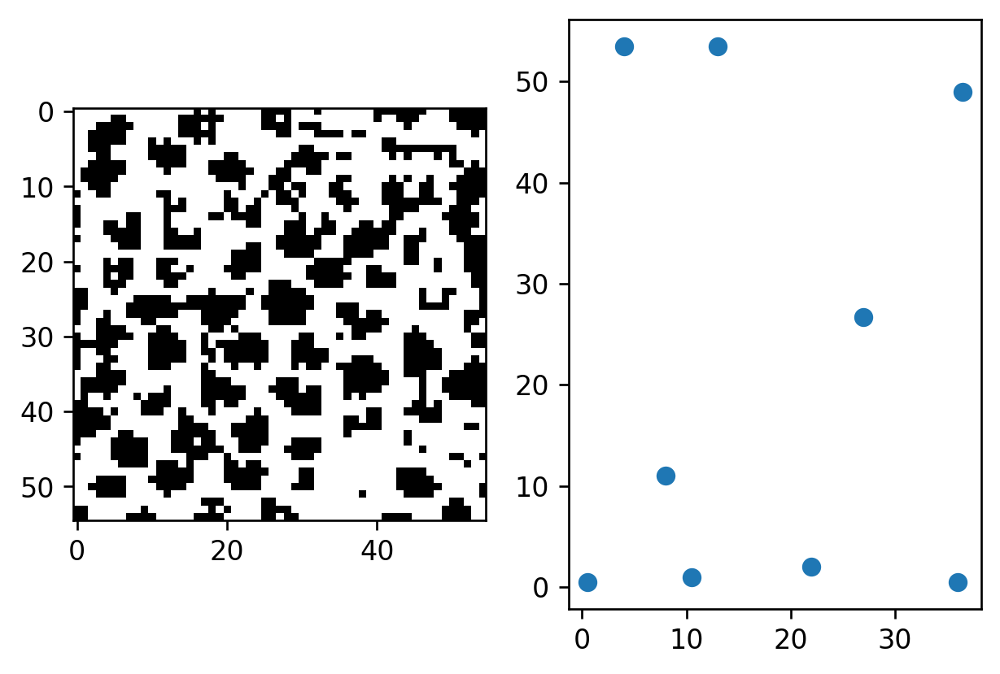

10.27446590550929
[13.247185549746275, 11.788686357456456, 38.59394849705544, 30.32330894793679, 14.87952149019338, 13.508109242037392]
[9.570454660866675, 16.196749921268434, 23.24440056960923, 15.479265932507946, 14.831722694940897, 25.49536730450329]


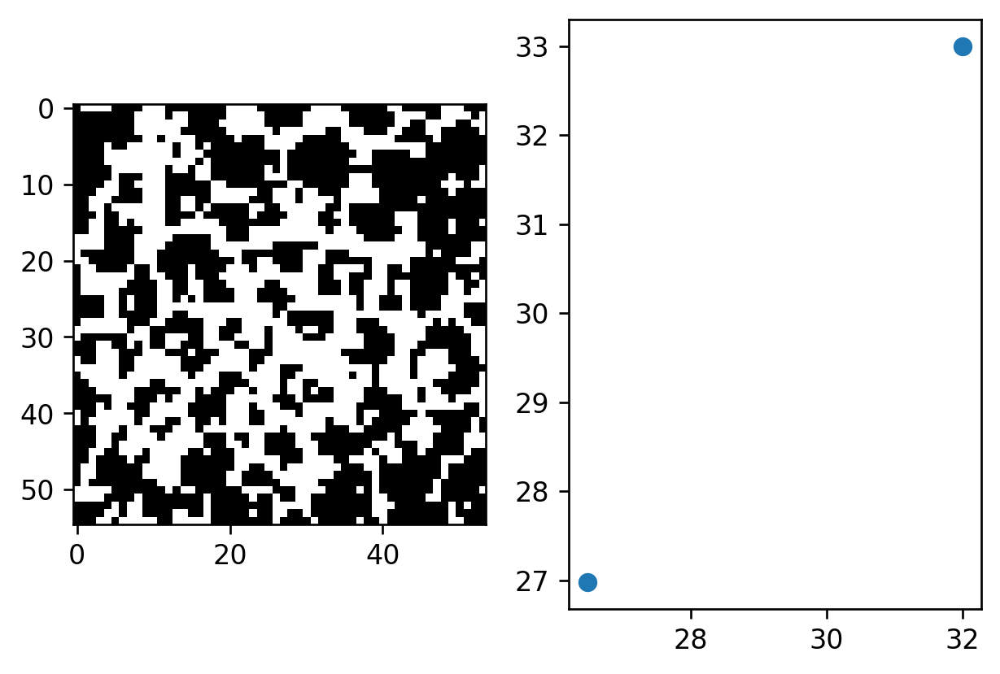

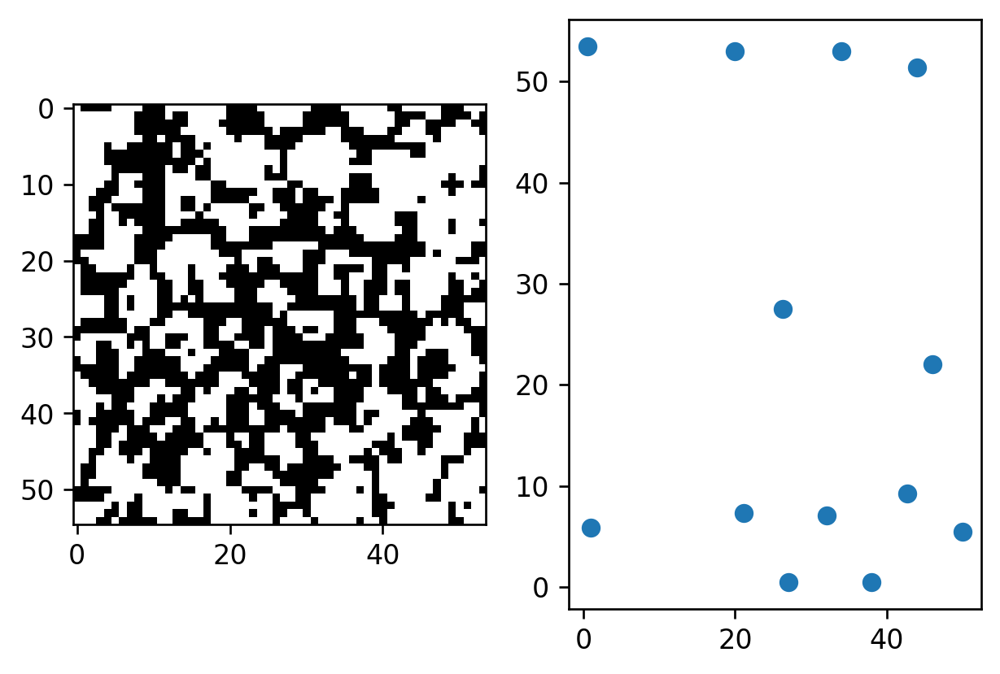

0.0
[13.247185549746275, 11.788686357456456, 38.59394849705544, 30.32330894793679, 14.87952149019338, 13.508109242037392, 8.164150146980093]
[9.570454660866675, 16.196749921268434, 23.24440056960923, 15.479265932507946, 14.831722694940897, 25.49536730450329, 23.554841027078226]


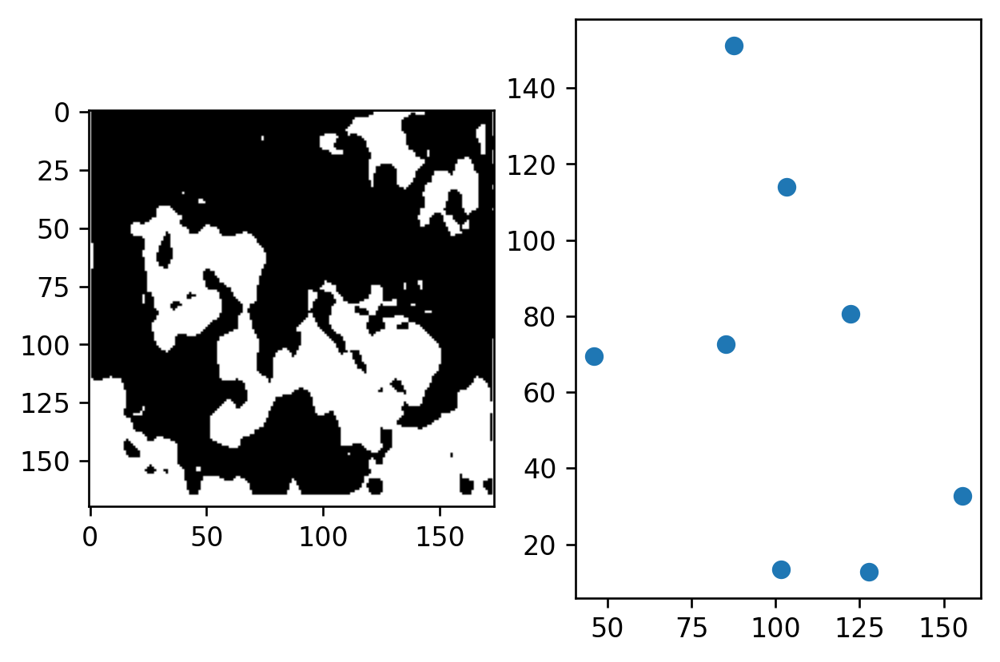

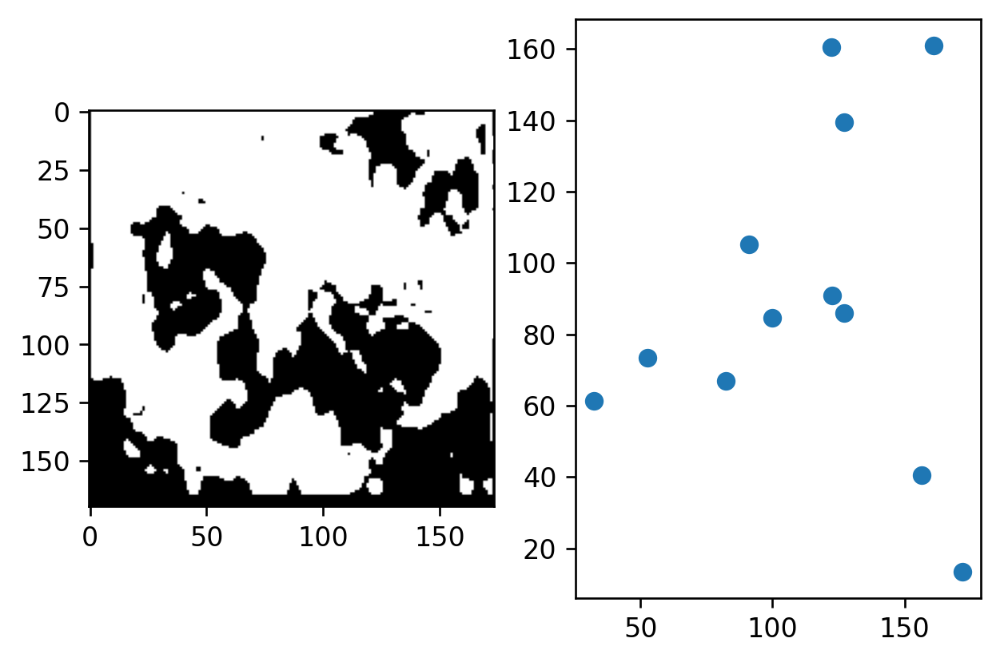

5.339567457898592
[13.247185549746275, 11.788686357456456, 38.59394849705544, 30.32330894793679, 14.87952149019338, 13.508109242037392, 8.164150146980093, 35.05771201458113]
[9.570454660866675, 16.196749921268434, 23.24440056960923, 15.479265932507946, 14.831722694940897, 25.49536730450329, 23.554841027078226, 21.616839337764663]


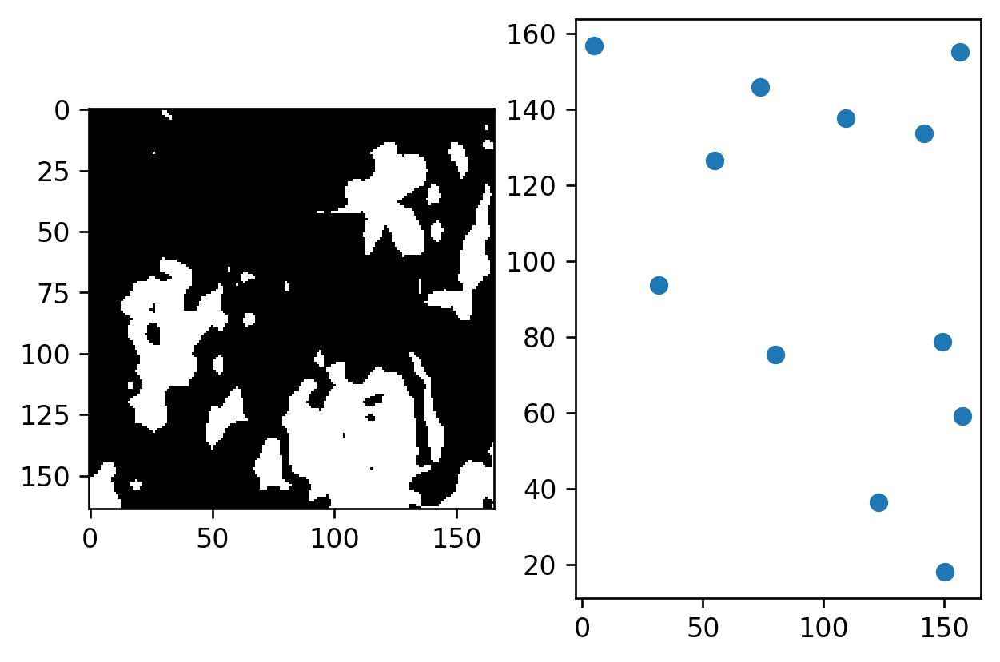

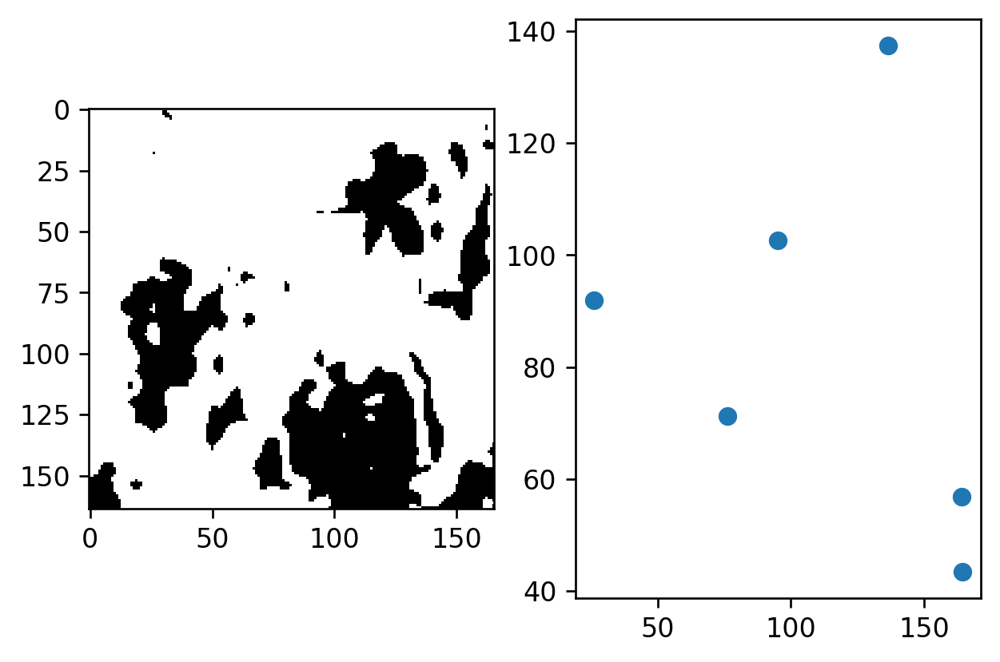

11.106955174014542
[13.247185549746275, 11.788686357456456, 38.59394849705544, 30.32330894793679, 14.87952149019338, 13.508109242037392, 8.164150146980093, 35.05771201458113, 33.18403487060513]
[9.570454660866675, 16.196749921268434, 23.24440056960923, 15.479265932507946, 14.831722694940897, 25.49536730450329, 23.554841027078226, 21.616839337764663, 12.20117720669208]


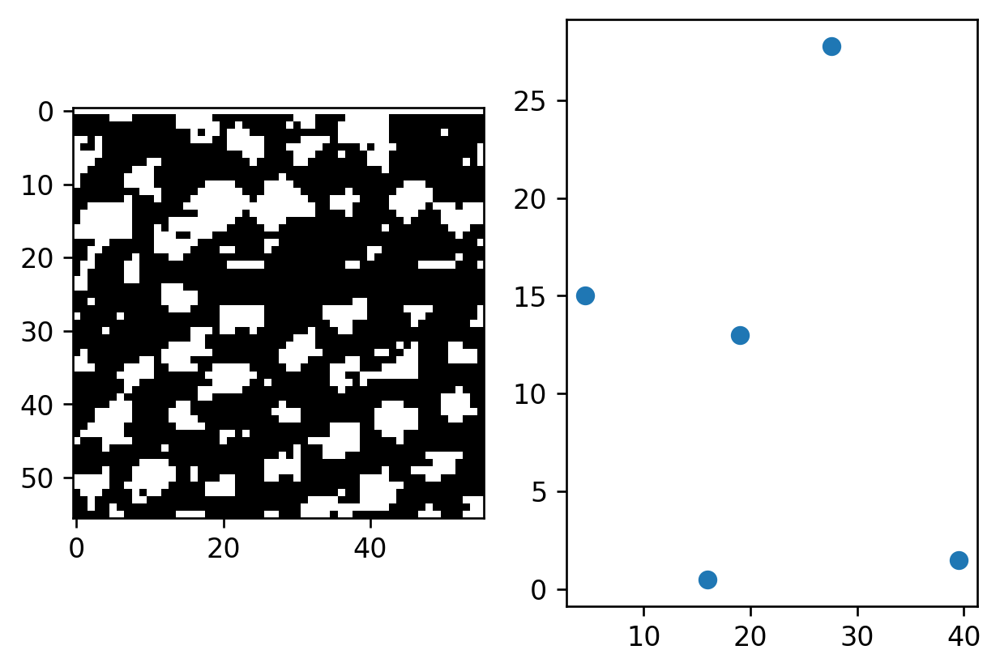

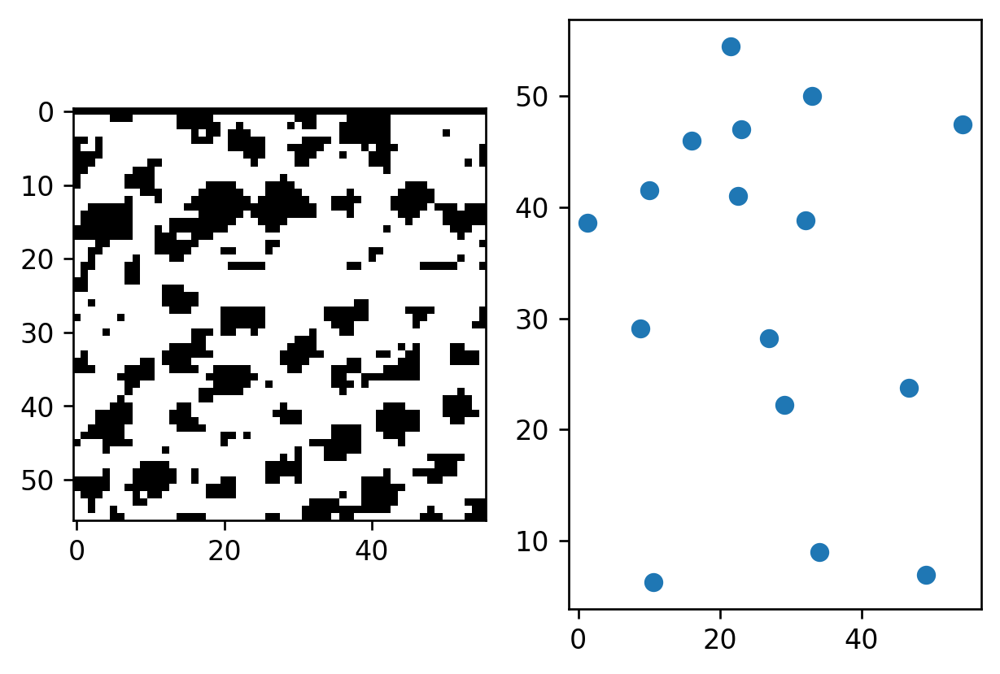

3.9741813747814057
[13.247185549746275, 11.788686357456456, 38.59394849705544, 30.32330894793679, 14.87952149019338, 13.508109242037392, 8.164150146980093, 35.05771201458113, 33.18403487060513, 16.18748071809025]
[9.570454660866675, 16.196749921268434, 23.24440056960923, 15.479265932507946, 14.831722694940897, 25.49536730450329, 23.554841027078226, 21.616839337764663, 12.20117720669208, 16.62520539350658]


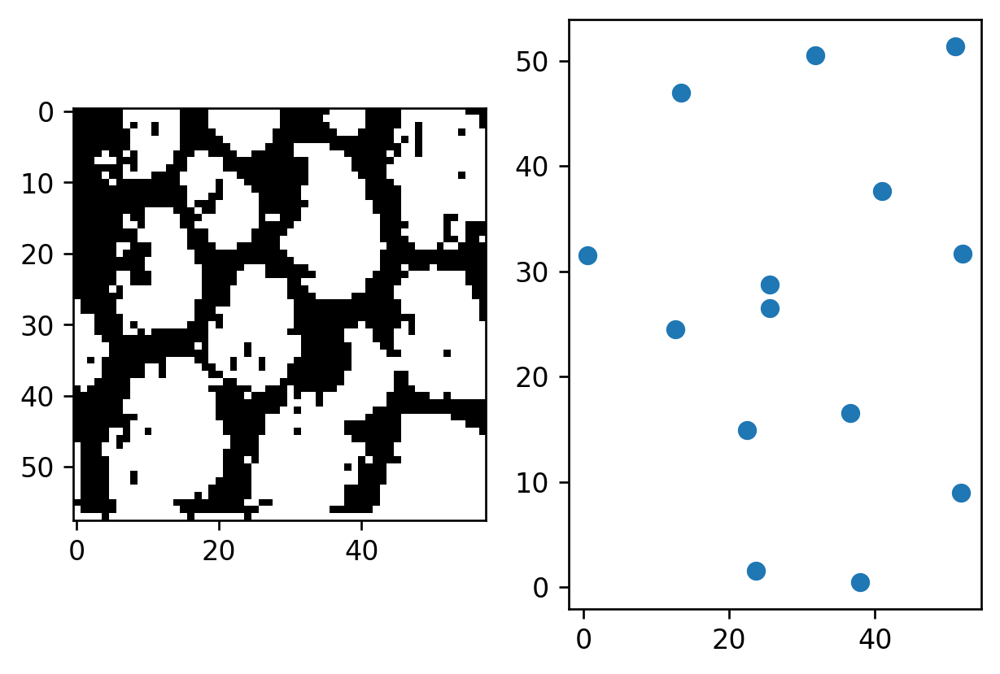

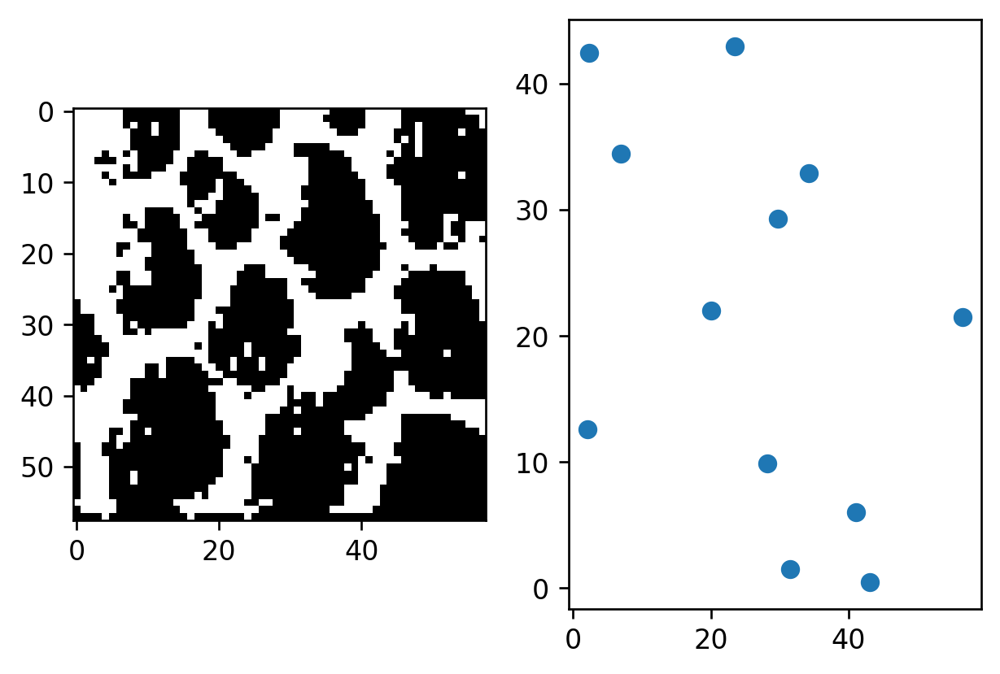

4.674485438216565
[13.247185549746275, 11.788686357456456, 38.59394849705544, 30.32330894793679, 14.87952149019338, 13.508109242037392, 8.164150146980093, 35.05771201458113, 33.18403487060513, 16.18748071809025, 12.746441756514944]
[9.570454660866675, 16.196749921268434, 23.24440056960923, 15.479265932507946, 14.831722694940897, 25.49536730450329, 23.554841027078226, 21.616839337764663, 12.20117720669208, 16.62520539350658, 9.0517526458567]


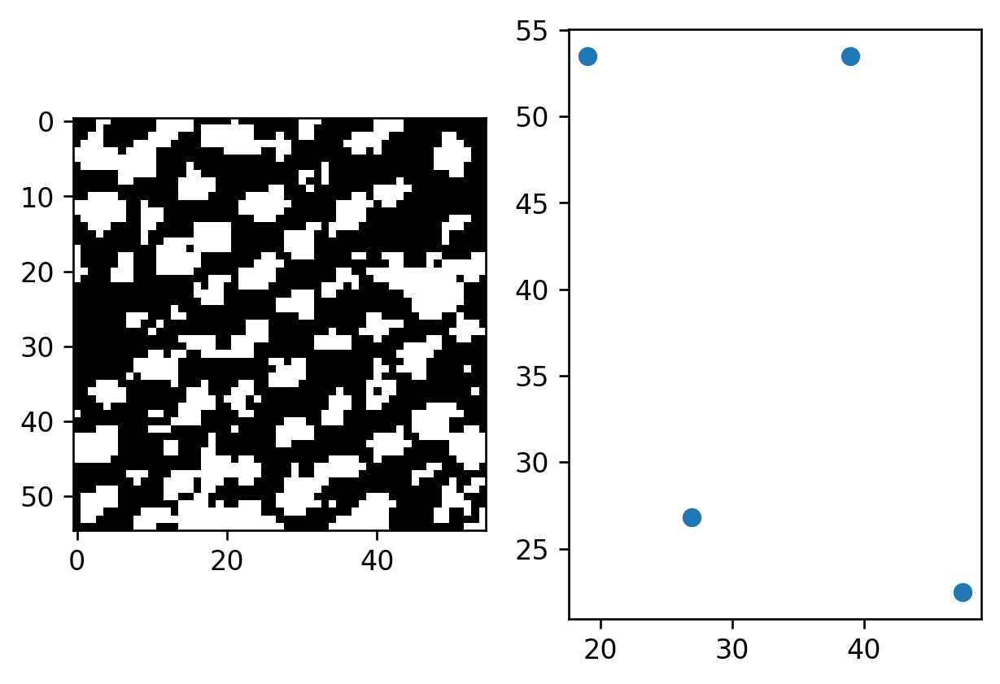

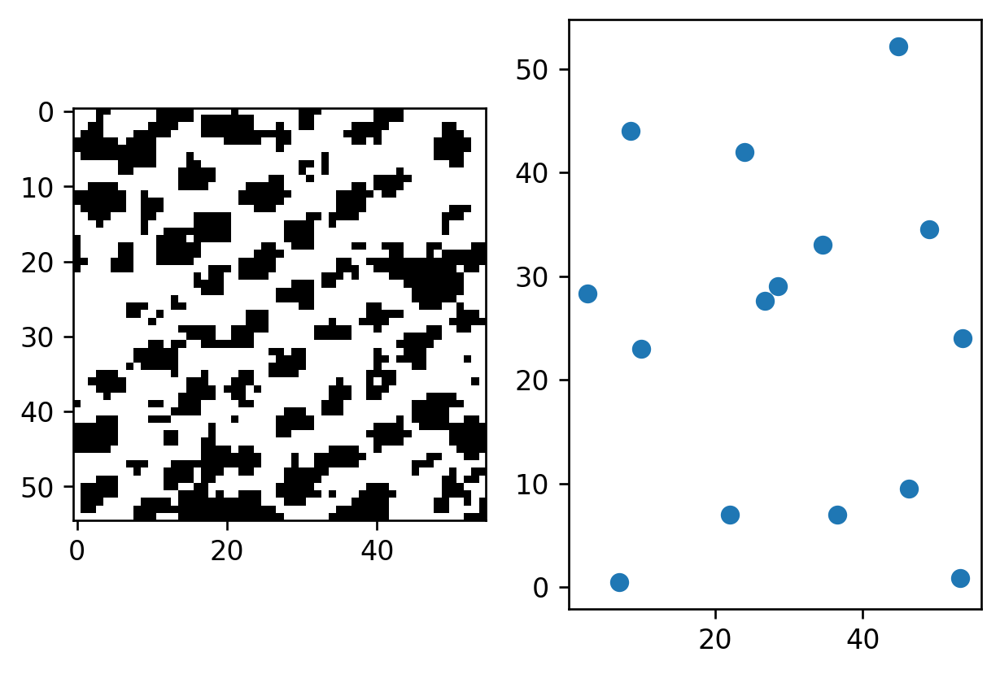

3.8029238202764826
[13.247185549746275, 11.788686357456456, 38.59394849705544, 30.32330894793679, 14.87952149019338, 13.508109242037392, 8.164150146980093, 35.05771201458113, 33.18403487060513, 16.18748071809025, 12.746441756514944, 24.80004552076293]
[9.570454660866675, 16.196749921268434, 23.24440056960923, 15.479265932507946, 14.831722694940897, 25.49536730450329, 23.554841027078226, 21.616839337764663, 12.20117720669208, 16.62520539350658, 9.0517526458567, 14.244174025625465]


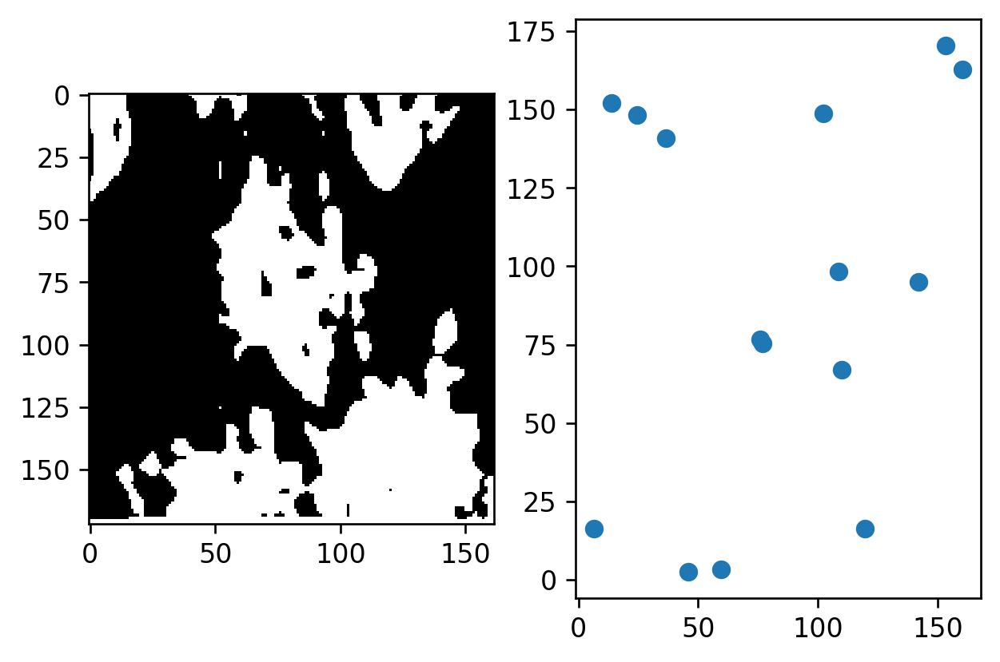

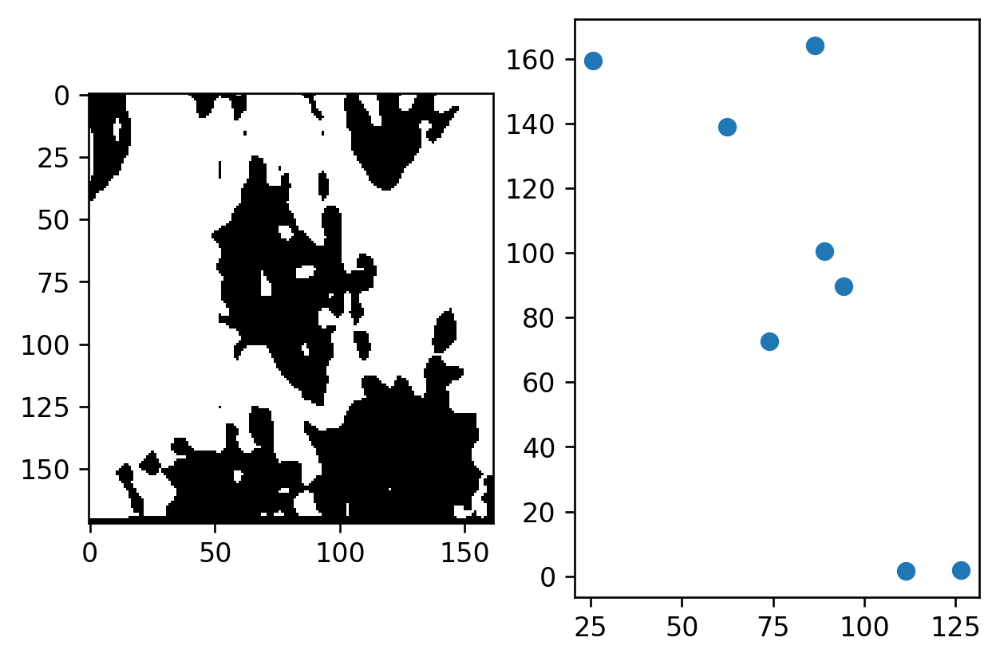

16.20491316395345
[13.247185549746275, 11.788686357456456, 38.59394849705544, 30.32330894793679, 14.87952149019338, 13.508109242037392, 8.164150146980093, 35.05771201458113, 33.18403487060513, 16.18748071809025, 12.746441756514944, 24.80004552076293, 21.877605217060104]
[9.570454660866675, 16.196749921268434, 23.24440056960923, 15.479265932507946, 14.831722694940897, 25.49536730450329, 23.554841027078226, 21.616839337764663, 12.20117720669208, 16.62520539350658, 9.0517526458567, 14.244174025625465, 16.530771415969816]


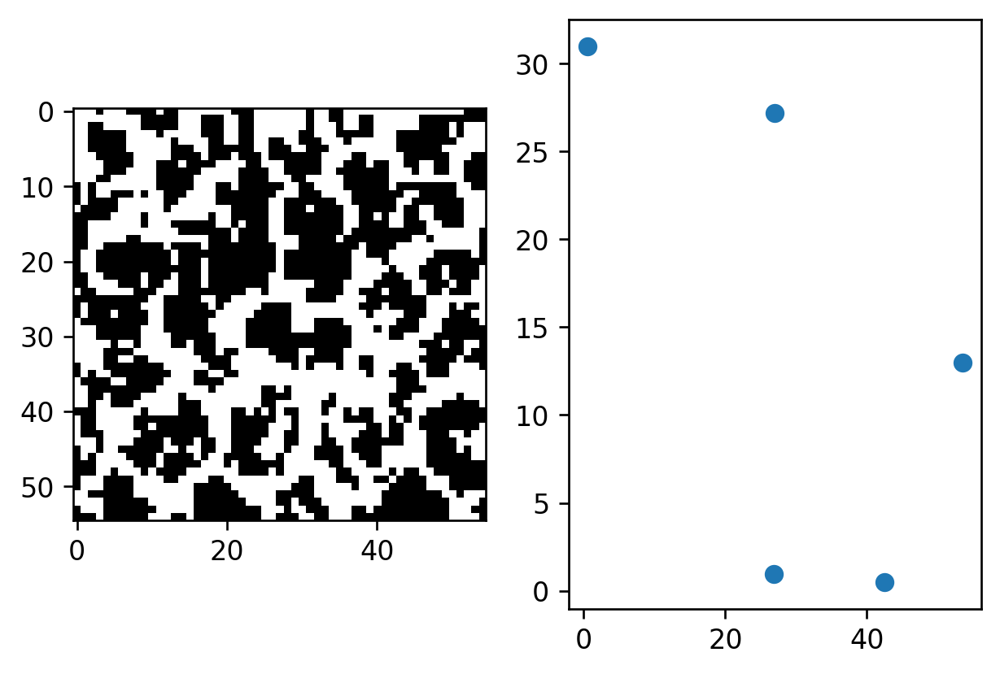

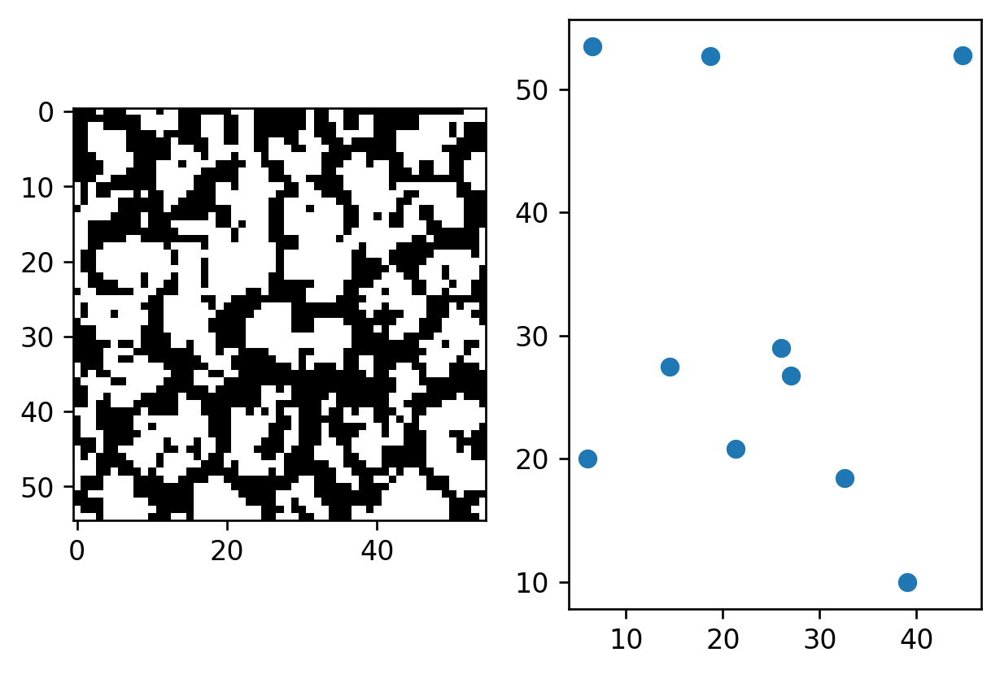

5.170546319600253
[13.247185549746275, 11.788686357456456, 38.59394849705544, 30.32330894793679, 14.87952149019338, 13.508109242037392, 8.164150146980093, 35.05771201458113, 33.18403487060513, 16.18748071809025, 12.746441756514944, 24.80004552076293, 21.877605217060104, 20.192345720523914]
[9.570454660866675, 16.196749921268434, 23.24440056960923, 15.479265932507946, 14.831722694940897, 25.49536730450329, 23.554841027078226, 21.616839337764663, 12.20117720669208, 16.62520539350658, 9.0517526458567, 14.244174025625465, 16.530771415969816, 13.753880842919452]


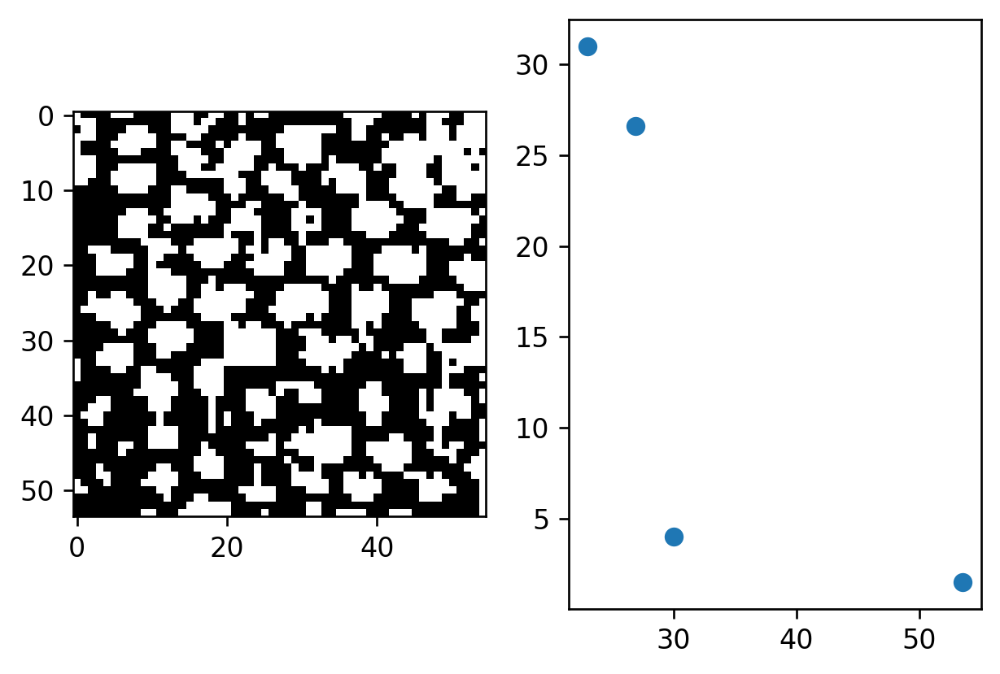

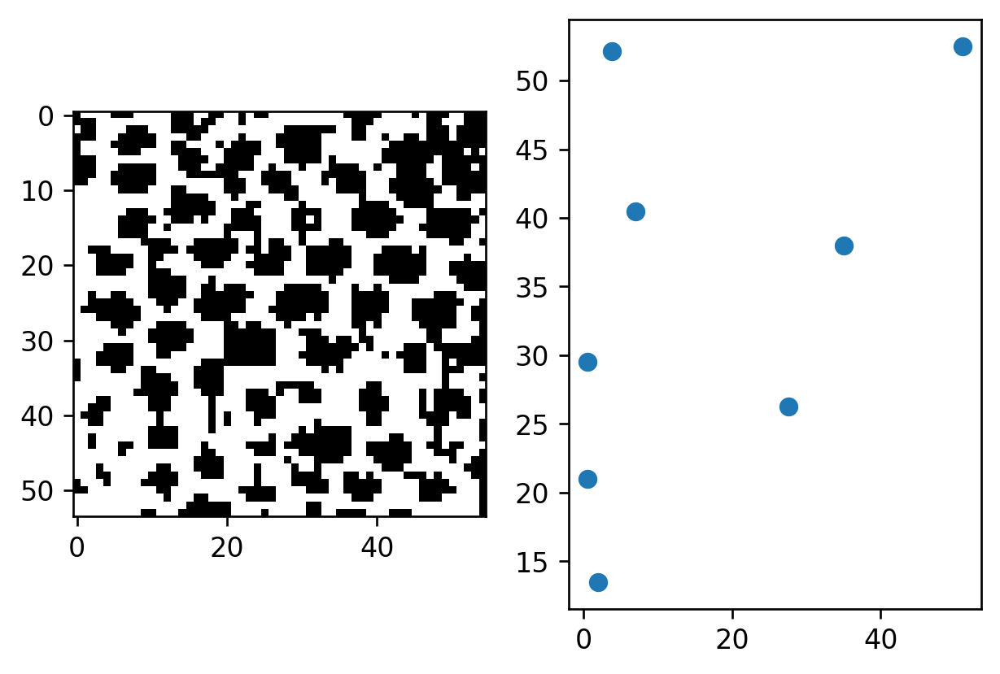

8.670381406564546
[13.247185549746275, 11.788686357456456, 38.59394849705544, 30.32330894793679, 14.87952149019338, 13.508109242037392, 8.164150146980093, 35.05771201458113, 33.18403487060513, 16.18748071809025, 12.746441756514944, 24.80004552076293, 21.877605217060104, 20.192345720523914, 14.560798841985976]
[9.570454660866675, 16.196749921268434, 23.24440056960923, 15.479265932507946, 14.831722694940897, 25.49536730450329, 23.554841027078226, 21.616839337764663, 12.20117720669208, 16.62520539350658, 9.0517526458567, 14.244174025625465, 16.530771415969816, 13.753880842919452, 21.441232874901562]


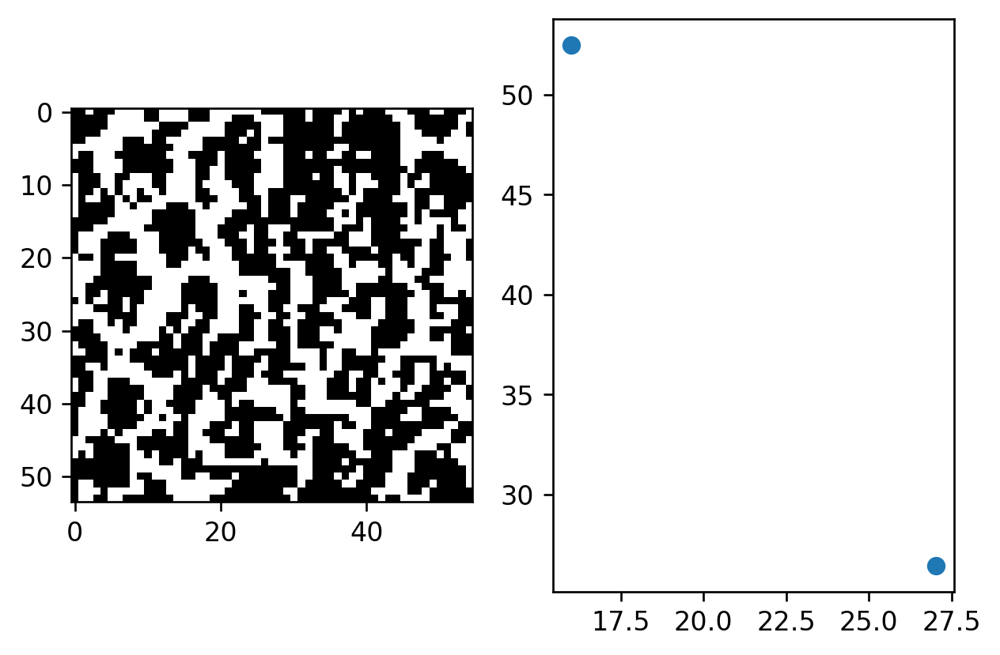

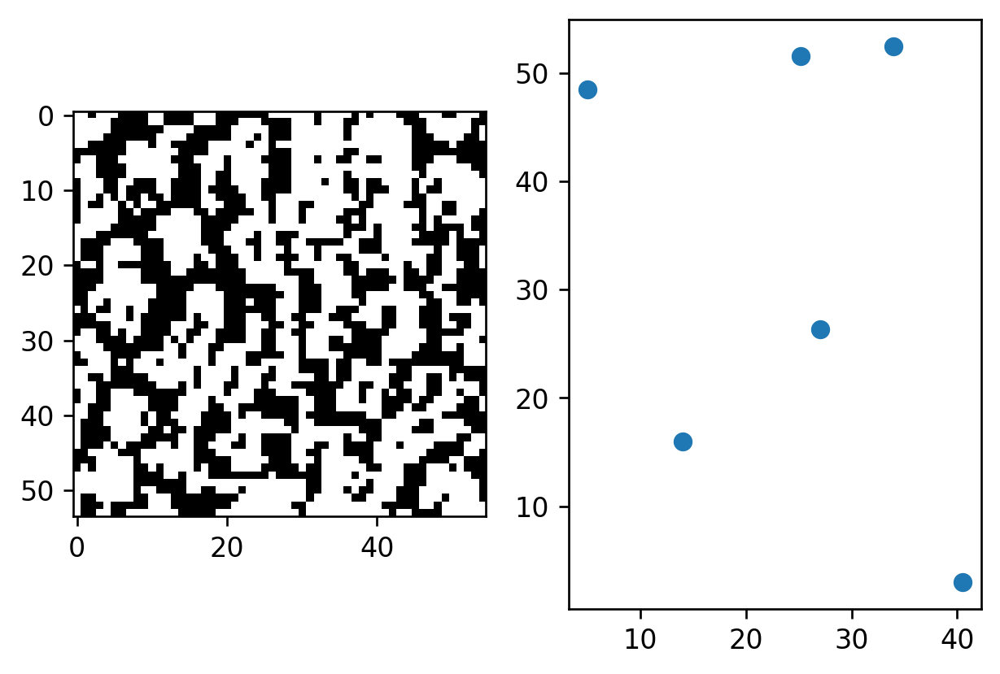

0.0
[13.247185549746275, 11.788686357456456, 38.59394849705544, 30.32330894793679, 14.87952149019338, 13.508109242037392, 8.164150146980093, 35.05771201458113, 33.18403487060513, 16.18748071809025, 12.746441756514944, 24.80004552076293, 21.877605217060104, 20.192345720523914, 14.560798841985976, 28.288336581696708]
[9.570454660866675, 16.196749921268434, 23.24440056960923, 15.479265932507946, 14.831722694940897, 25.49536730450329, 23.554841027078226, 21.616839337764663, 12.20117720669208, 16.62520539350658, 9.0517526458567, 14.244174025625465, 16.530771415969816, 13.753880842919452, 21.441232874901562, 15.301342464039854]


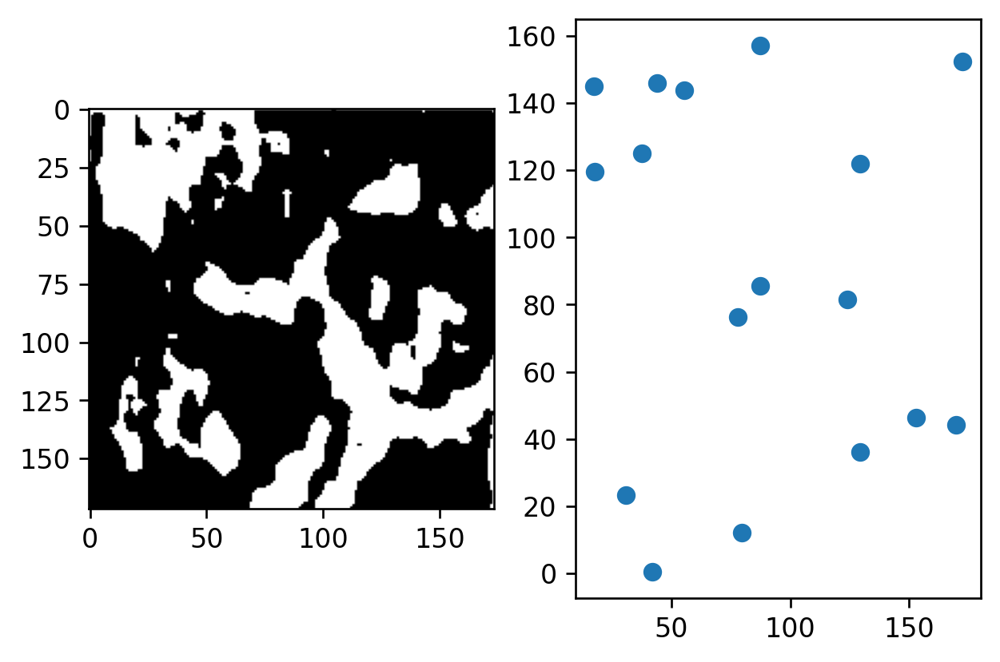

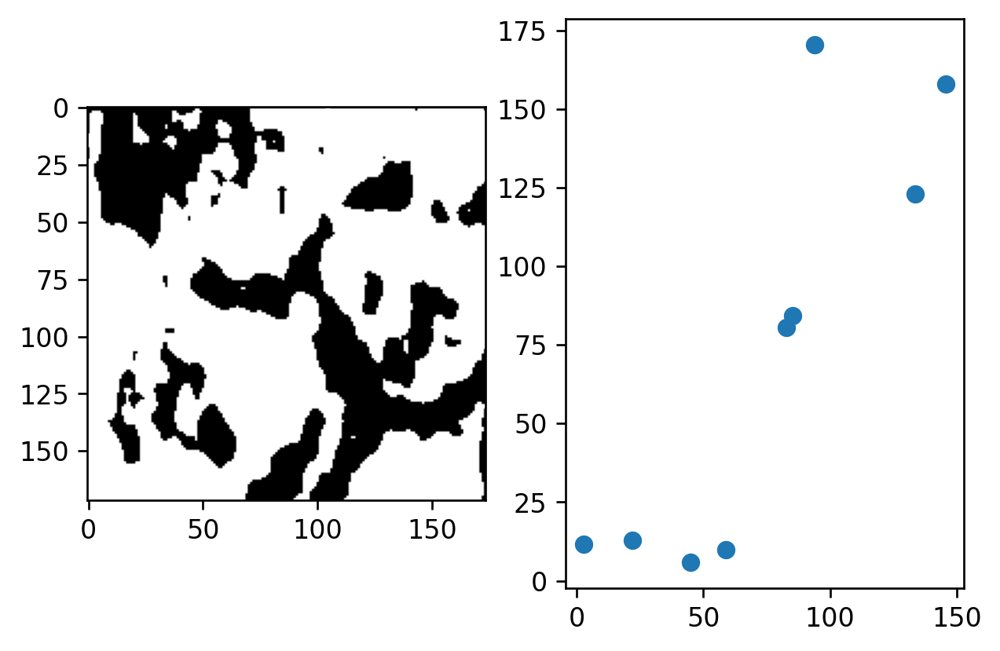

11.54842353019211
[13.247185549746275, 11.788686357456456, 38.59394849705544, 30.32330894793679, 14.87952149019338, 13.508109242037392, 8.164150146980093, 35.05771201458113, 33.18403487060513, 16.18748071809025, 12.746441756514944, 24.80004552076293, 21.877605217060104, 20.192345720523914, 14.560798841985976, 28.288336581696708, 25.431268876596498]
[9.570454660866675, 16.196749921268434, 23.24440056960923, 15.479265932507946, 14.831722694940897, 25.49536730450329, 23.554841027078226, 21.616839337764663, 12.20117720669208, 16.62520539350658, 9.0517526458567, 14.244174025625465, 16.530771415969816, 13.753880842919452, 21.441232874901562, 15.301342464039854, 13.890481232458962]


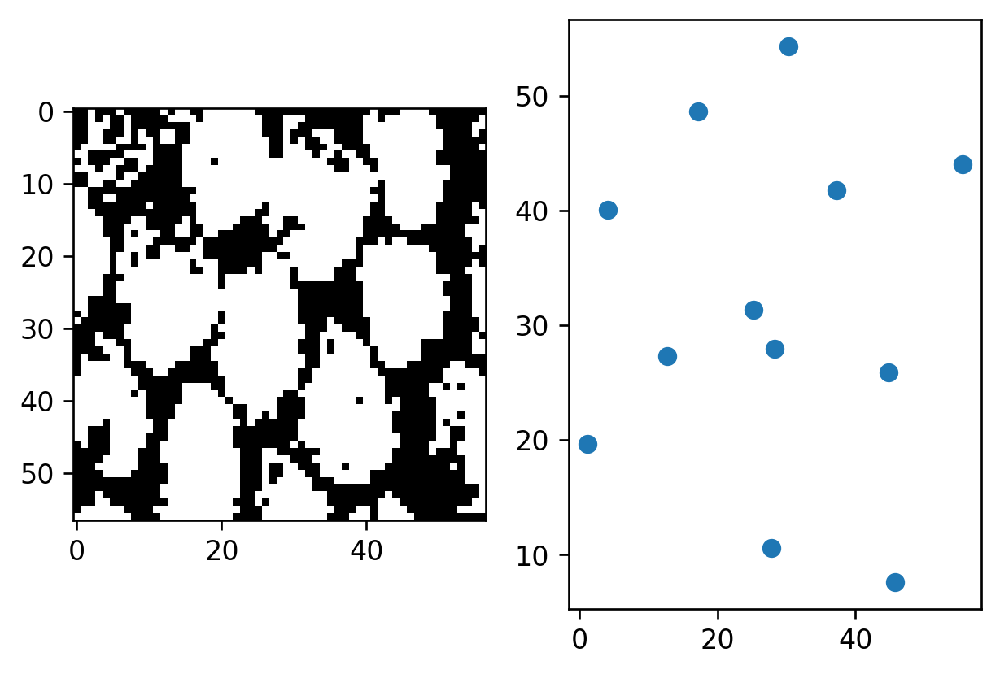

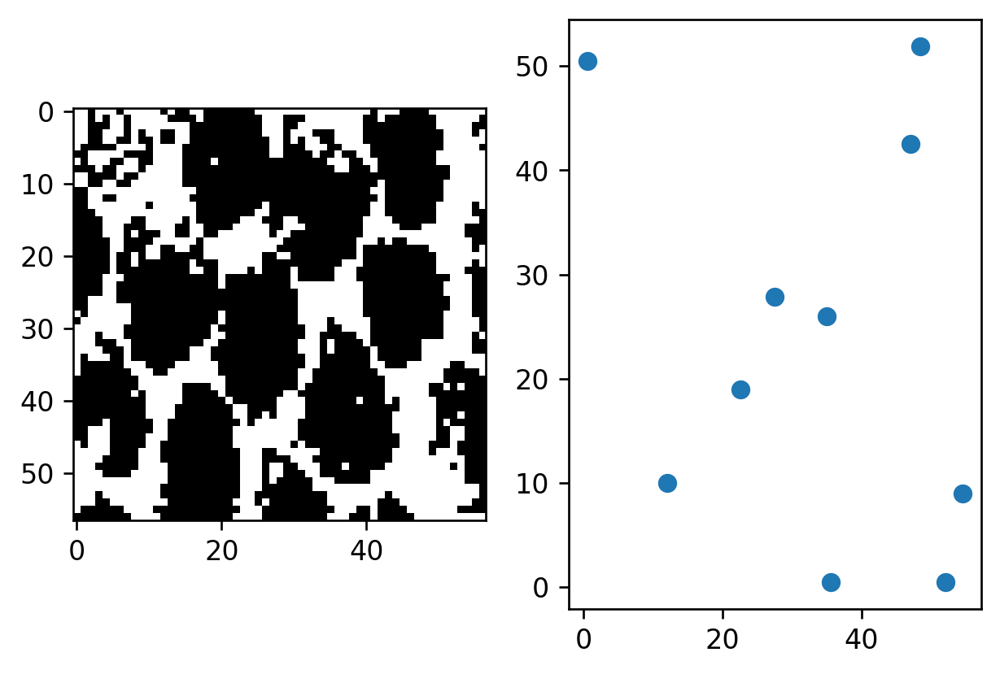

4.4713075404799705
[13.247185549746275, 11.788686357456456, 38.59394849705544, 30.32330894793679, 14.87952149019338, 13.508109242037392, 8.164150146980093, 35.05771201458113, 33.18403487060513, 16.18748071809025, 12.746441756514944, 24.80004552076293, 21.877605217060104, 20.192345720523914, 14.560798841985976, 28.288336581696708, 25.431268876596498, 13.746509506116112]
[9.570454660866675, 16.196749921268434, 23.24440056960923, 15.479265932507946, 14.831722694940897, 25.49536730450329, 23.554841027078226, 21.616839337764663, 12.20117720669208, 16.62520539350658, 9.0517526458567, 14.244174025625465, 16.530771415969816, 13.753880842919452, 21.441232874901562, 15.301342464039854, 13.890481232458962, 9.33960848226737]


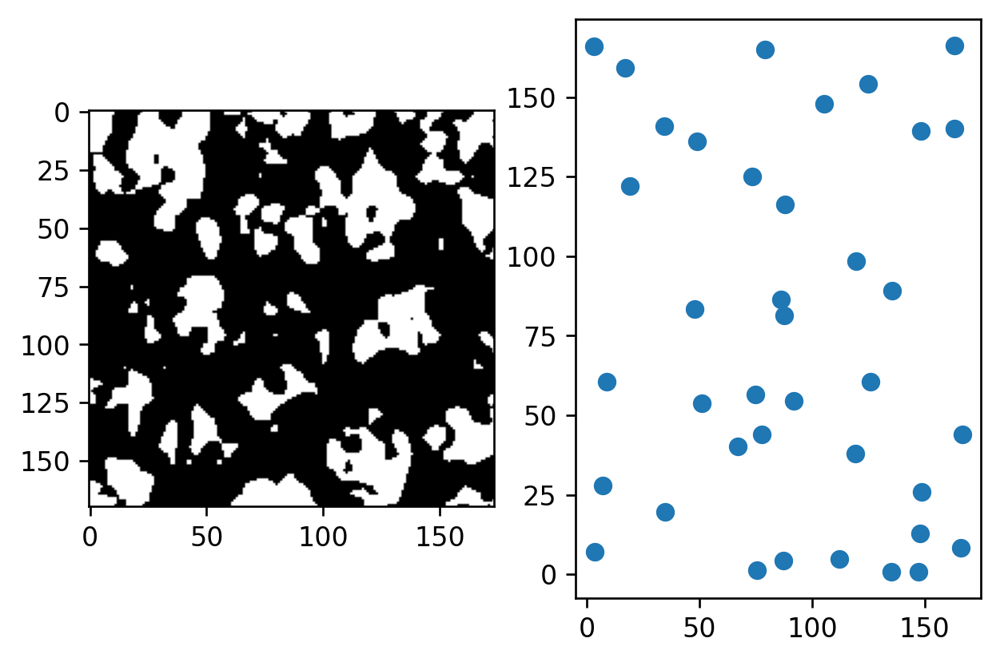

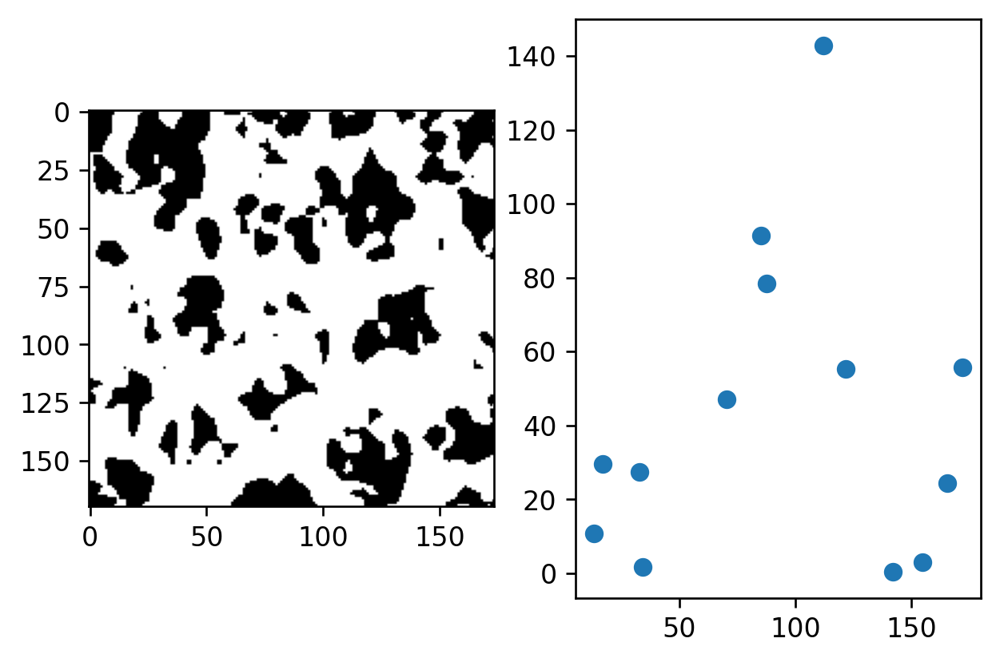

6.581999205916344
[13.247185549746275, 11.788686357456456, 38.59394849705544, 30.32330894793679, 14.87952149019338, 13.508109242037392, 8.164150146980093, 35.05771201458113, 33.18403487060513, 16.18748071809025, 12.746441756514944, 24.80004552076293, 21.877605217060104, 20.192345720523914, 14.560798841985976, 28.288336581696708, 25.431268876596498, 13.746509506116112, 18.16865025988747]
[9.570454660866675, 16.196749921268434, 23.24440056960923, 15.479265932507946, 14.831722694940897, 25.49536730450329, 23.554841027078226, 21.616839337764663, 12.20117720669208, 16.62520539350658, 9.0517526458567, 14.244174025625465, 16.530771415969816, 13.753880842919452, 21.441232874901562, 15.301342464039854, 13.890481232458962, 9.33960848226737, 9.149054860437795]


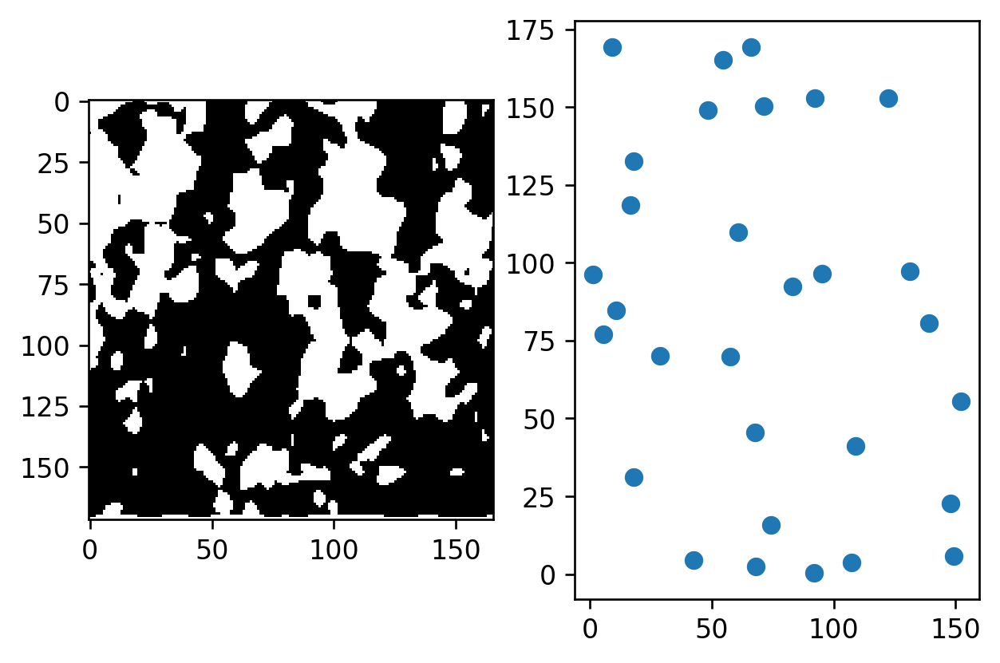

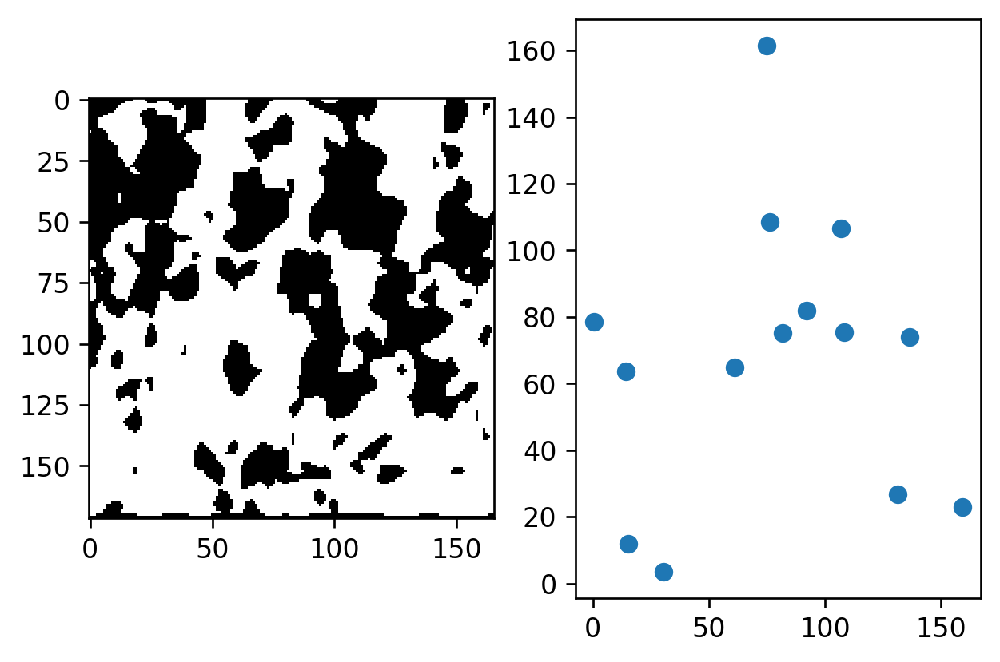

8.003708125482182
[13.247185549746275, 11.788686357456456, 38.59394849705544, 30.32330894793679, 14.87952149019338, 13.508109242037392, 8.164150146980093, 35.05771201458113, 33.18403487060513, 16.18748071809025, 12.746441756514944, 24.80004552076293, 21.877605217060104, 20.192345720523914, 14.560798841985976, 28.288336581696708, 25.431268876596498, 13.746509506116112, 18.16865025988747, 20.036766799060448]
[9.570454660866675, 16.196749921268434, 23.24440056960923, 15.479265932507946, 14.831722694940897, 25.49536730450329, 23.554841027078226, 21.616839337764663, 12.20117720669208, 16.62520539350658, 9.0517526458567, 14.244174025625465, 16.530771415969816, 13.753880842919452, 21.441232874901562, 15.301342464039854, 13.890481232458962, 9.33960848226737, 9.149054860437795, 13.667212499668725]


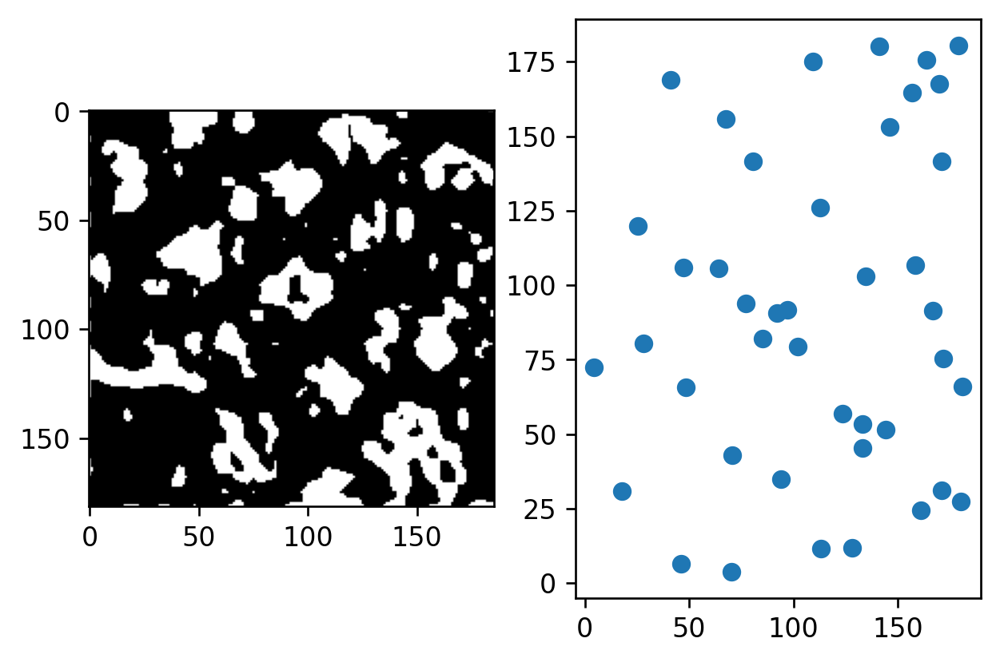

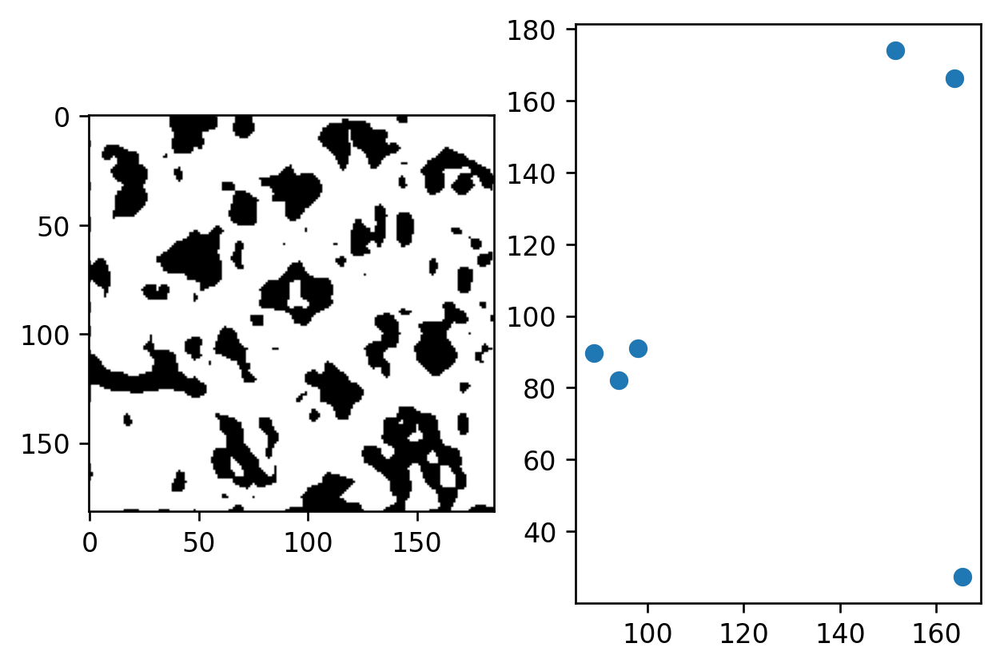

7.595813980486045
[13.247185549746275, 11.788686357456456, 38.59394849705544, 30.32330894793679, 14.87952149019338, 13.508109242037392, 8.164150146980093, 35.05771201458113, 33.18403487060513, 16.18748071809025, 12.746441756514944, 24.80004552076293, 21.877605217060104, 20.192345720523914, 14.560798841985976, 28.288336581696708, 25.431268876596498, 13.746509506116112, 18.16865025988747, 20.036766799060448, 17.991187607382184]
[9.570454660866675, 16.196749921268434, 23.24440056960923, 15.479265932507946, 14.831722694940897, 25.49536730450329, 23.554841027078226, 21.616839337764663, 12.20117720669208, 16.62520539350658, 9.0517526458567, 14.244174025625465, 16.530771415969816, 13.753880842919452, 21.441232874901562, 15.301342464039854, 13.890481232458962, 9.33960848226737, 9.149054860437795, 13.667212499668725, 5.907303354207741]


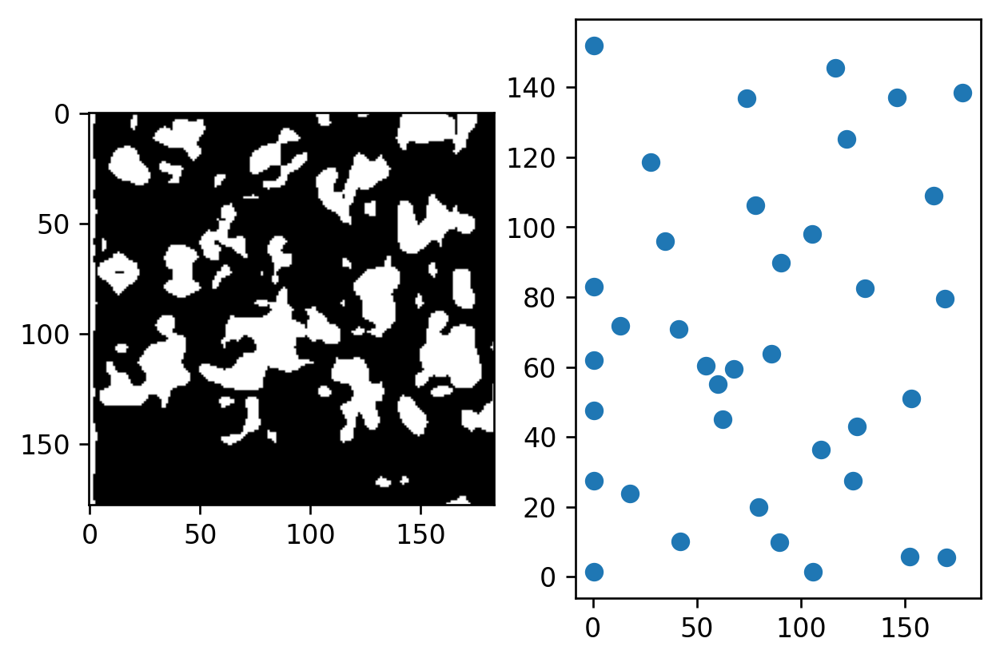

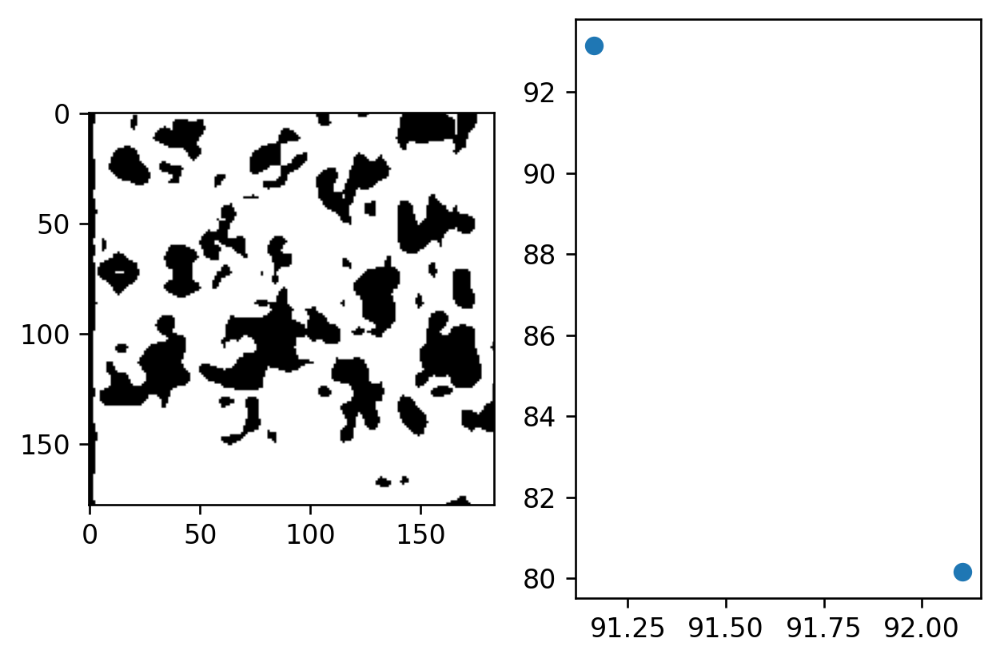

7.5851986022152555
[13.247185549746275, 11.788686357456456, 38.59394849705544, 30.32330894793679, 14.87952149019338, 13.508109242037392, 8.164150146980093, 35.05771201458113, 33.18403487060513, 16.18748071809025, 12.746441756514944, 24.80004552076293, 21.877605217060104, 20.192345720523914, 14.560798841985976, 28.288336581696708, 25.431268876596498, 13.746509506116112, 18.16865025988747, 20.036766799060448, 17.991187607382184, 20.61919199254177]
[9.570454660866675, 16.196749921268434, 23.24440056960923, 15.479265932507946, 14.831722694940897, 25.49536730450329, 23.554841027078226, 21.616839337764663, 12.20117720669208, 16.62520539350658, 9.0517526458567, 14.244174025625465, 16.530771415969816, 13.753880842919452, 21.441232874901562, 15.301342464039854, 13.890481232458962, 9.33960848226737, 9.149054860437795, 13.667212499668725, 5.907303354207741, 6.599911834571375]


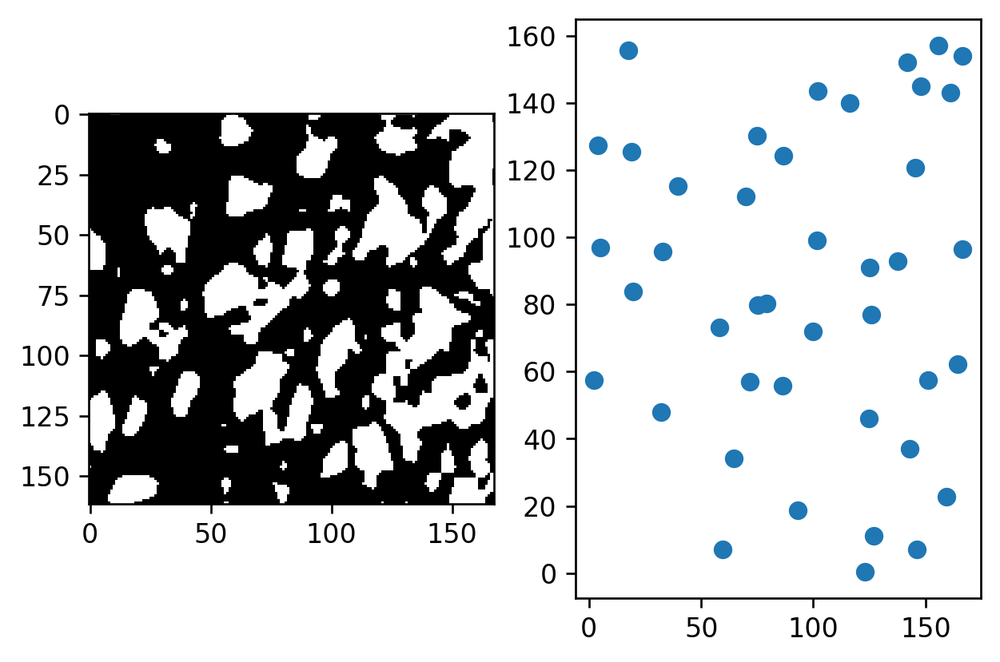

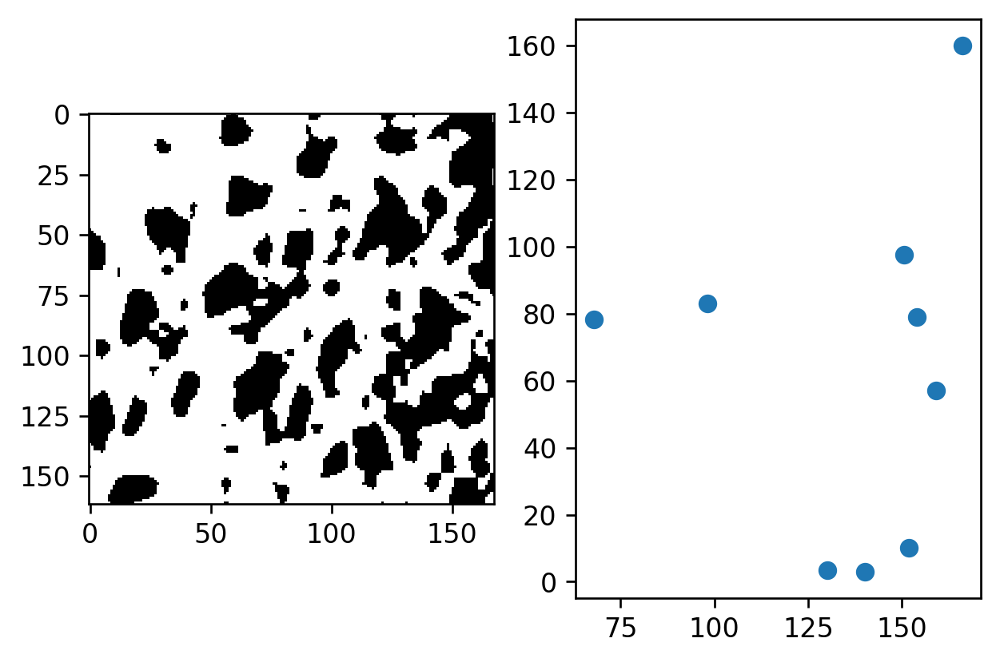

7.032229388638562
[13.247185549746275, 11.788686357456456, 38.59394849705544, 30.32330894793679, 14.87952149019338, 13.508109242037392, 8.164150146980093, 35.05771201458113, 33.18403487060513, 16.18748071809025, 12.746441756514944, 24.80004552076293, 21.877605217060104, 20.192345720523914, 14.560798841985976, 28.288336581696708, 25.431268876596498, 13.746509506116112, 18.16865025988747, 20.036766799060448, 17.991187607382184, 20.61919199254177, 17.52946404688742]
[9.570454660866675, 16.196749921268434, 23.24440056960923, 15.479265932507946, 14.831722694940897, 25.49536730450329, 23.554841027078226, 21.616839337764663, 12.20117720669208, 16.62520539350658, 9.0517526458567, 14.244174025625465, 16.530771415969816, 13.753880842919452, 21.441232874901562, 15.301342464039854, 13.890481232458962, 9.33960848226737, 9.149054860437795, 13.667212499668725, 5.907303354207741, 6.599911834571375, 9.703496852612345]


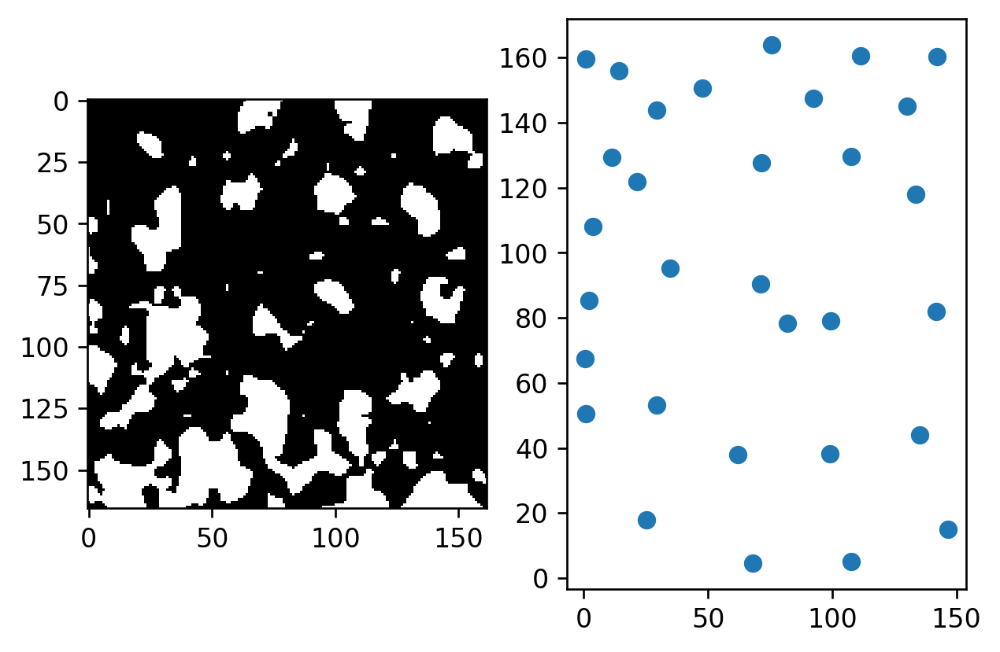

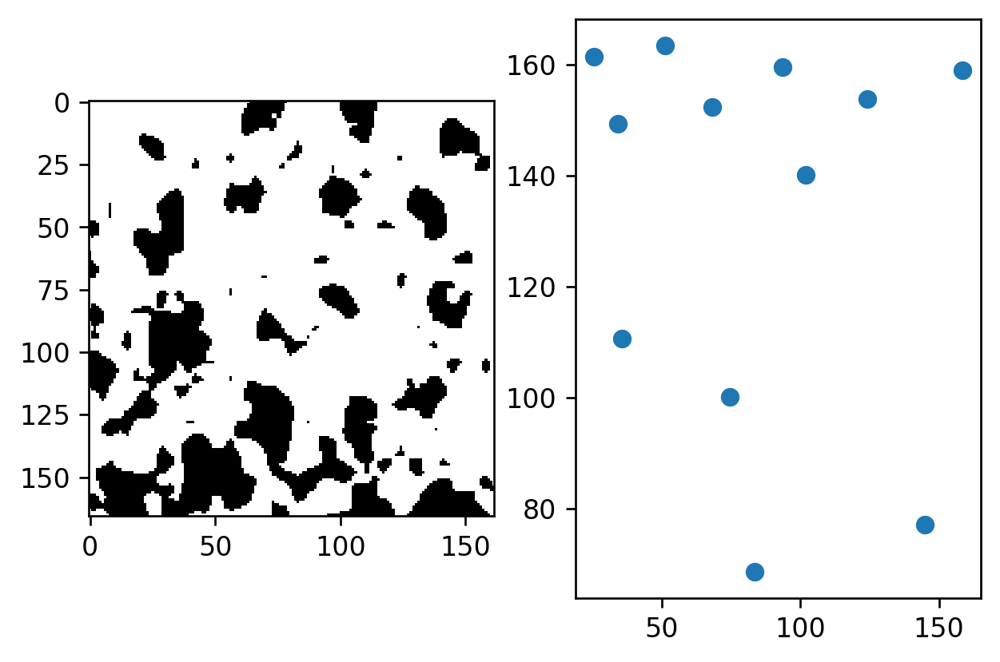

7.521037537781752
[13.247185549746275, 11.788686357456456, 38.59394849705544, 30.32330894793679, 14.87952149019338, 13.508109242037392, 8.164150146980093, 35.05771201458113, 33.18403487060513, 16.18748071809025, 12.746441756514944, 24.80004552076293, 21.877605217060104, 20.192345720523914, 14.560798841985976, 28.288336581696708, 25.431268876596498, 13.746509506116112, 18.16865025988747, 20.036766799060448, 17.991187607382184, 20.61919199254177, 17.52946404688742, 23.650964529758063]
[9.570454660866675, 16.196749921268434, 23.24440056960923, 15.479265932507946, 14.831722694940897, 25.49536730450329, 23.554841027078226, 21.616839337764663, 12.20117720669208, 16.62520539350658, 9.0517526458567, 14.244174025625465, 16.530771415969816, 13.753880842919452, 21.441232874901562, 15.301342464039854, 13.890481232458962, 9.33960848226737, 9.149054860437795, 13.667212499668725, 5.907303354207741, 6.599911834571375, 9.703496852612345, 11.591805219270285]


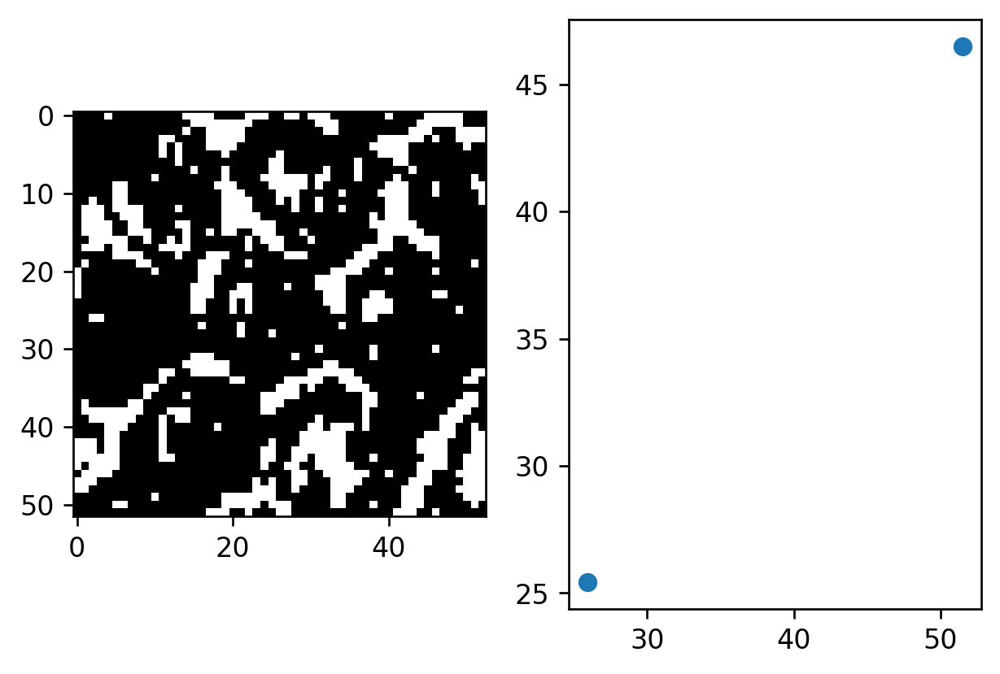

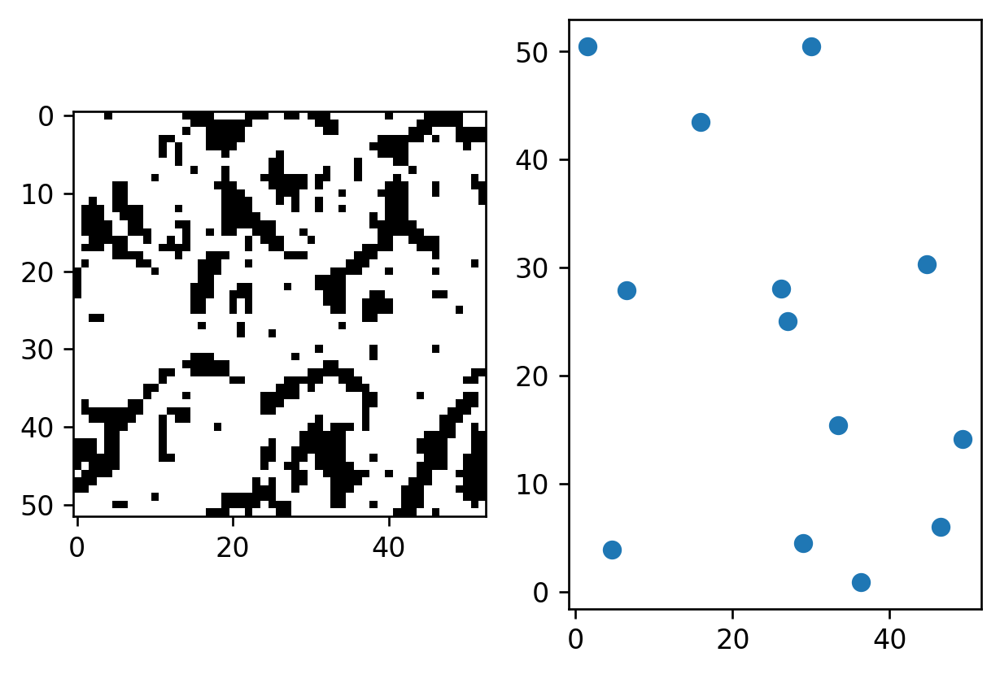

0.0
[13.247185549746275, 11.788686357456456, 38.59394849705544, 30.32330894793679, 14.87952149019338, 13.508109242037392, 8.164150146980093, 35.05771201458113, 33.18403487060513, 16.18748071809025, 12.746441756514944, 24.80004552076293, 21.877605217060104, 20.192345720523914, 14.560798841985976, 28.288336581696708, 25.431268876596498, 13.746509506116112, 18.16865025988747, 20.036766799060448, 17.991187607382184, 20.61919199254177, 17.52946404688742, 23.650964529758063, 33.13024238183553]
[9.570454660866675, 16.196749921268434, 23.24440056960923, 15.479265932507946, 14.831722694940897, 25.49536730450329, 23.554841027078226, 21.616839337764663, 12.20117720669208, 16.62520539350658, 9.0517526458567, 14.244174025625465, 16.530771415969816, 13.753880842919452, 21.441232874901562, 15.301342464039854, 13.890481232458962, 9.33960848226737, 9.149054860437795, 13.667212499668725, 5.907303354207741, 6.599911834571375, 9.703496852612345, 11.591805219270285, 20.252864626743374]


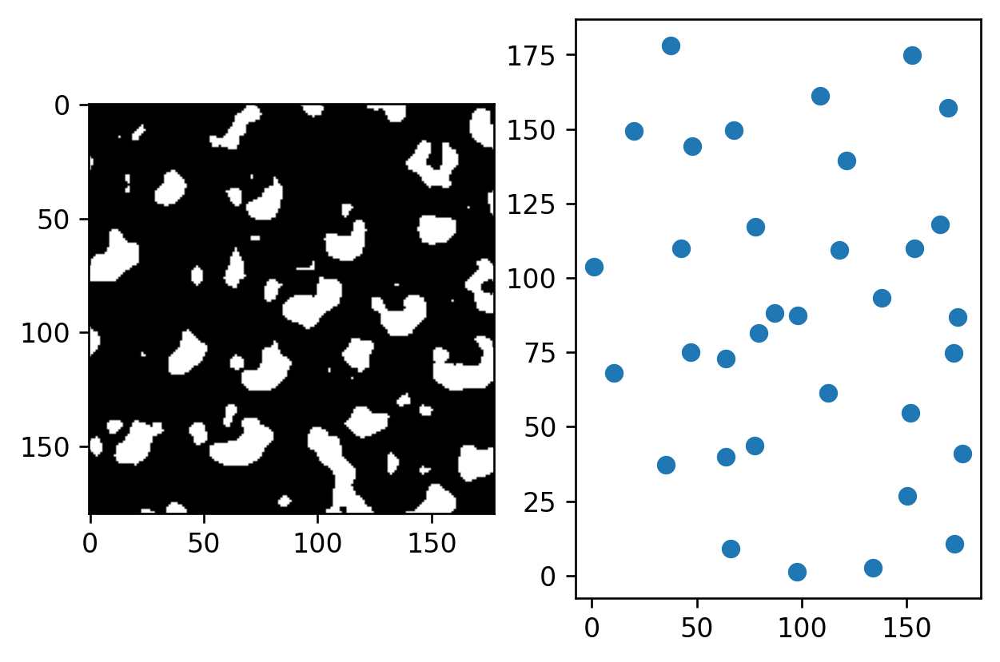

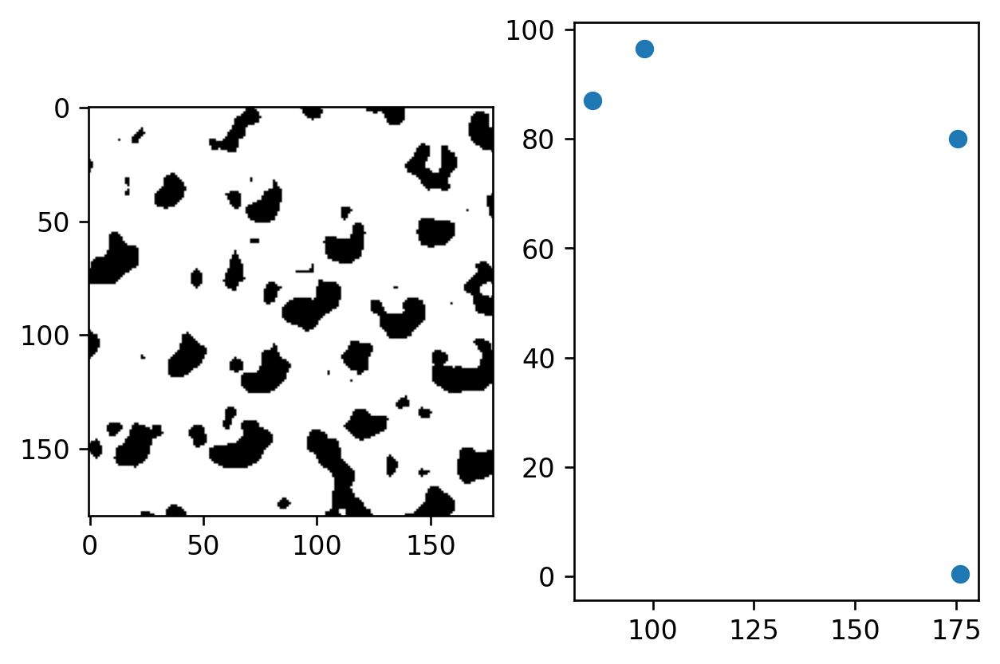

8.038109555716424
[13.247185549746275, 11.788686357456456, 38.59394849705544, 30.32330894793679, 14.87952149019338, 13.508109242037392, 8.164150146980093, 35.05771201458113, 33.18403487060513, 16.18748071809025, 12.746441756514944, 24.80004552076293, 21.877605217060104, 20.192345720523914, 14.560798841985976, 28.288336581696708, 25.431268876596498, 13.746509506116112, 18.16865025988747, 20.036766799060448, 17.991187607382184, 20.61919199254177, 17.52946404688742, 23.650964529758063, 33.13024238183553, 23.512965005384242]
[9.570454660866675, 16.196749921268434, 23.24440056960923, 15.479265932507946, 14.831722694940897, 25.49536730450329, 23.554841027078226, 21.616839337764663, 12.20117720669208, 16.62520539350658, 9.0517526458567, 14.244174025625465, 16.530771415969816, 13.753880842919452, 21.441232874901562, 15.301342464039854, 13.890481232458962, 9.33960848226737, 9.149054860437795, 13.667212499668725, 5.907303354207741, 6.599911834571375, 9.703496852612345, 11.591805219270285, 20.252

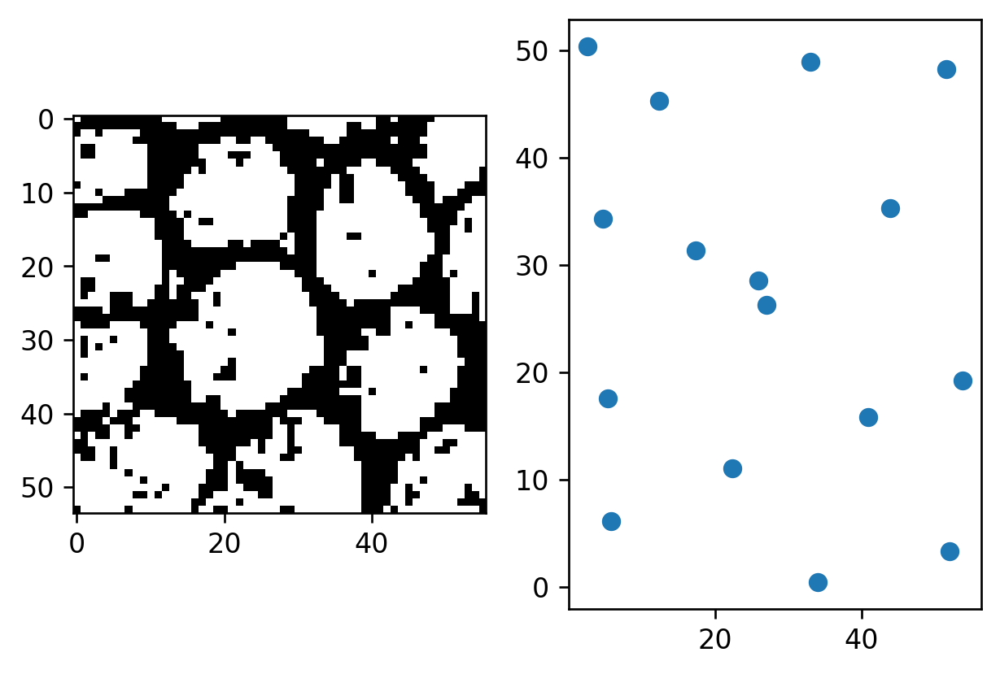

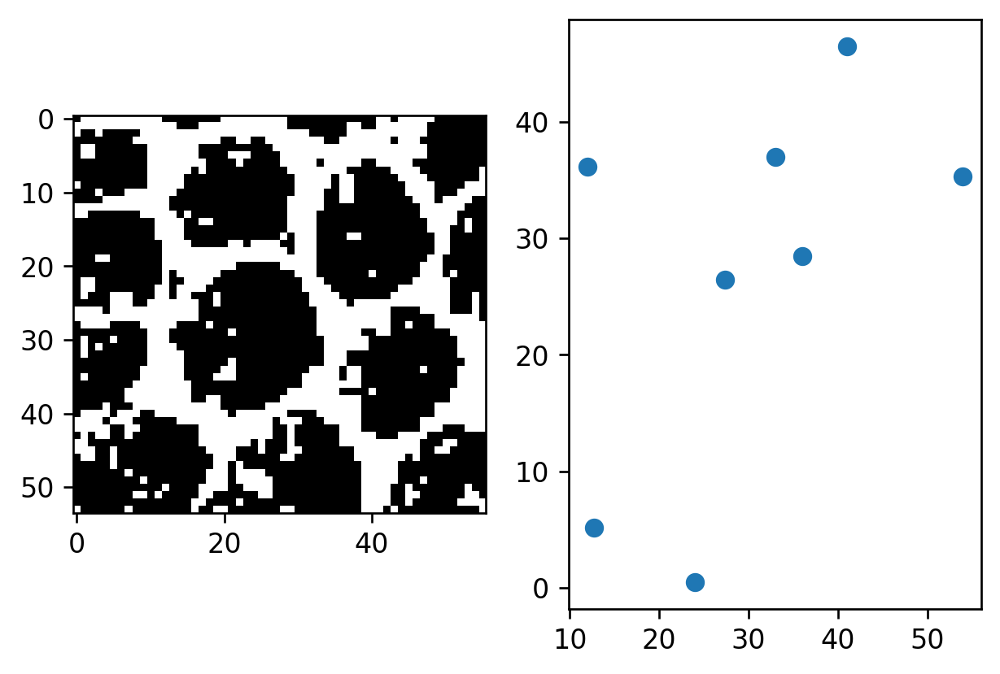

4.239694483842127
[13.247185549746275, 11.788686357456456, 38.59394849705544, 30.32330894793679, 14.87952149019338, 13.508109242037392, 8.164150146980093, 35.05771201458113, 33.18403487060513, 16.18748071809025, 12.746441756514944, 24.80004552076293, 21.877605217060104, 20.192345720523914, 14.560798841985976, 28.288336581696708, 25.431268876596498, 13.746509506116112, 18.16865025988747, 20.036766799060448, 17.991187607382184, 20.61919199254177, 17.52946404688742, 23.650964529758063, 33.13024238183553, 23.512965005384242, 12.077355838693652]
[9.570454660866675, 16.196749921268434, 23.24440056960923, 15.479265932507946, 14.831722694940897, 25.49536730450329, 23.554841027078226, 21.616839337764663, 12.20117720669208, 16.62520539350658, 9.0517526458567, 14.244174025625465, 16.530771415969816, 13.753880842919452, 21.441232874901562, 15.301342464039854, 13.890481232458962, 9.33960848226737, 9.149054860437795, 13.667212499668725, 5.907303354207741, 6.599911834571375, 9.703496852612345, 11.591

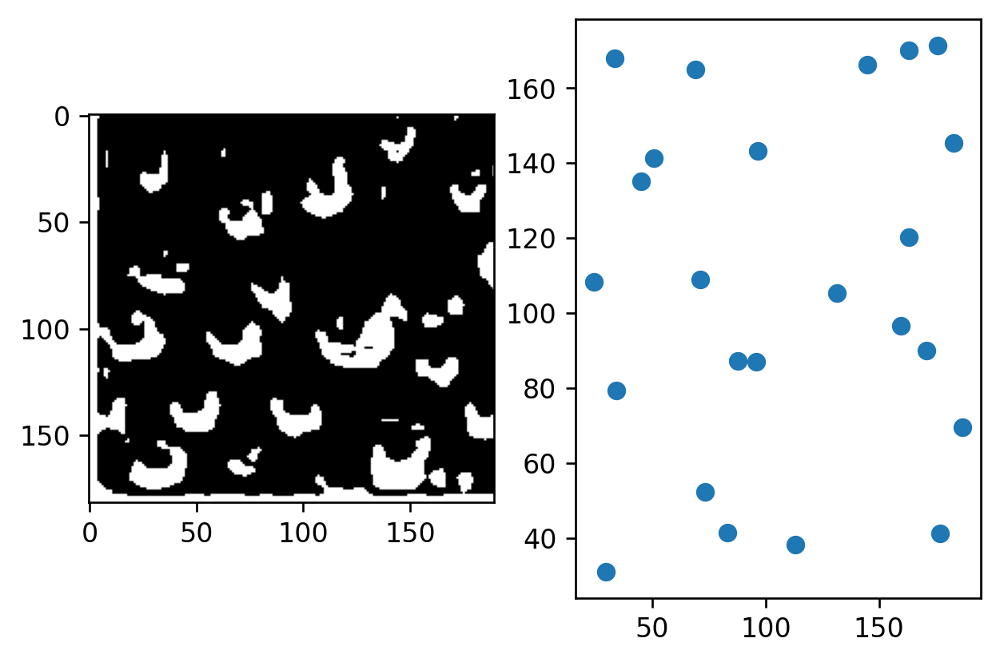

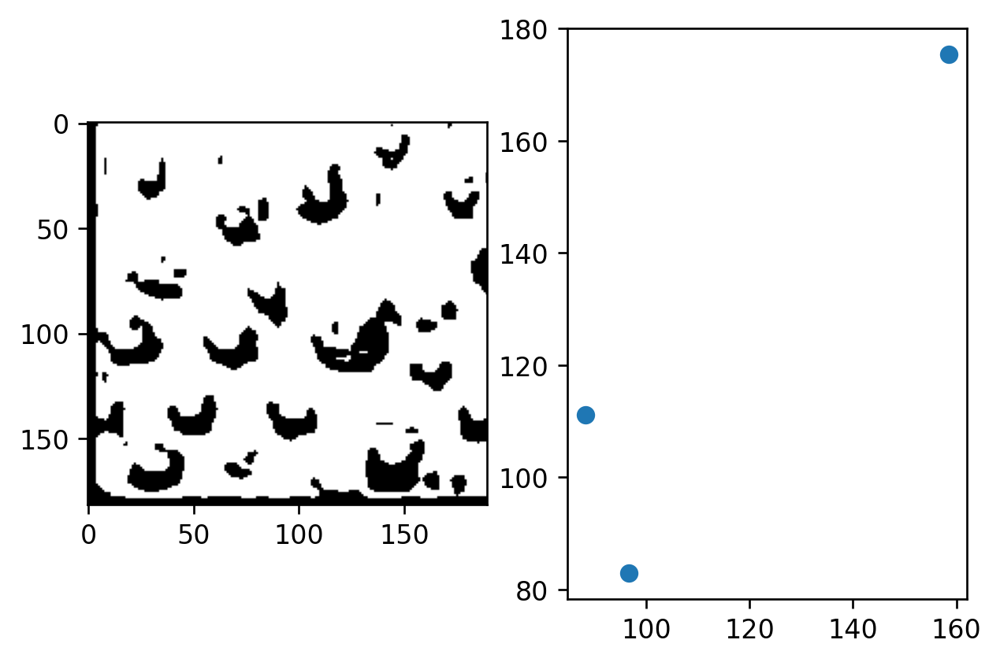

10.511433148146125
[13.247185549746275, 11.788686357456456, 38.59394849705544, 30.32330894793679, 14.87952149019338, 13.508109242037392, 8.164150146980093, 35.05771201458113, 33.18403487060513, 16.18748071809025, 12.746441756514944, 24.80004552076293, 21.877605217060104, 20.192345720523914, 14.560798841985976, 28.288336581696708, 25.431268876596498, 13.746509506116112, 18.16865025988747, 20.036766799060448, 17.991187607382184, 20.61919199254177, 17.52946404688742, 23.650964529758063, 33.13024238183553, 23.512965005384242, 12.077355838693652, 22.216533423607974]
[9.570454660866675, 16.196749921268434, 23.24440056960923, 15.479265932507946, 14.831722694940897, 25.49536730450329, 23.554841027078226, 21.616839337764663, 12.20117720669208, 16.62520539350658, 9.0517526458567, 14.244174025625465, 16.530771415969816, 13.753880842919452, 21.441232874901562, 15.301342464039854, 13.890481232458962, 9.33960848226737, 9.149054860437795, 13.667212499668725, 5.907303354207741, 6.599911834571375, 9.70

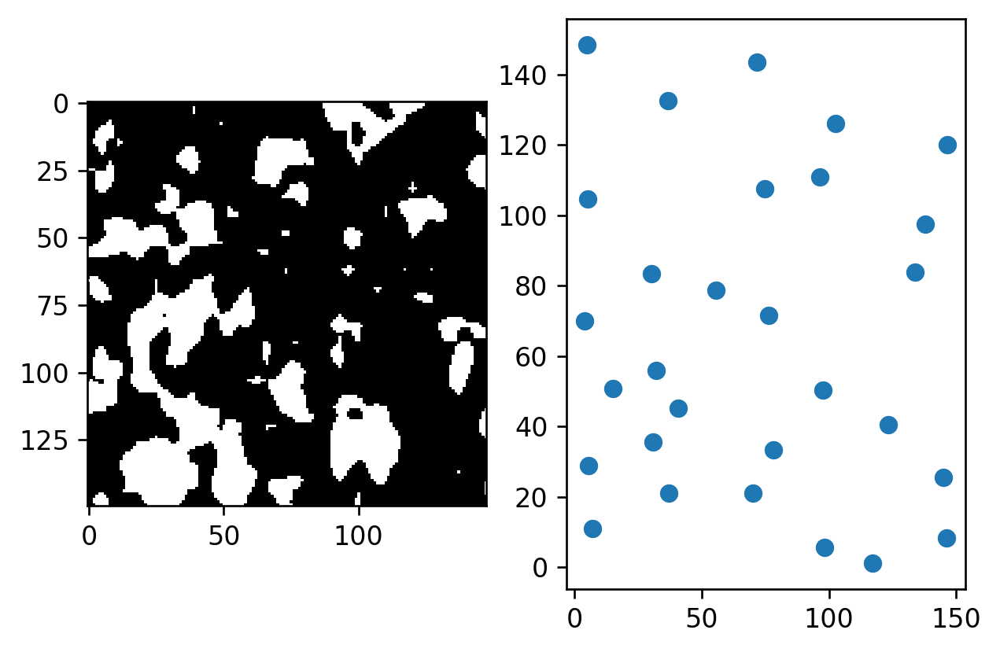

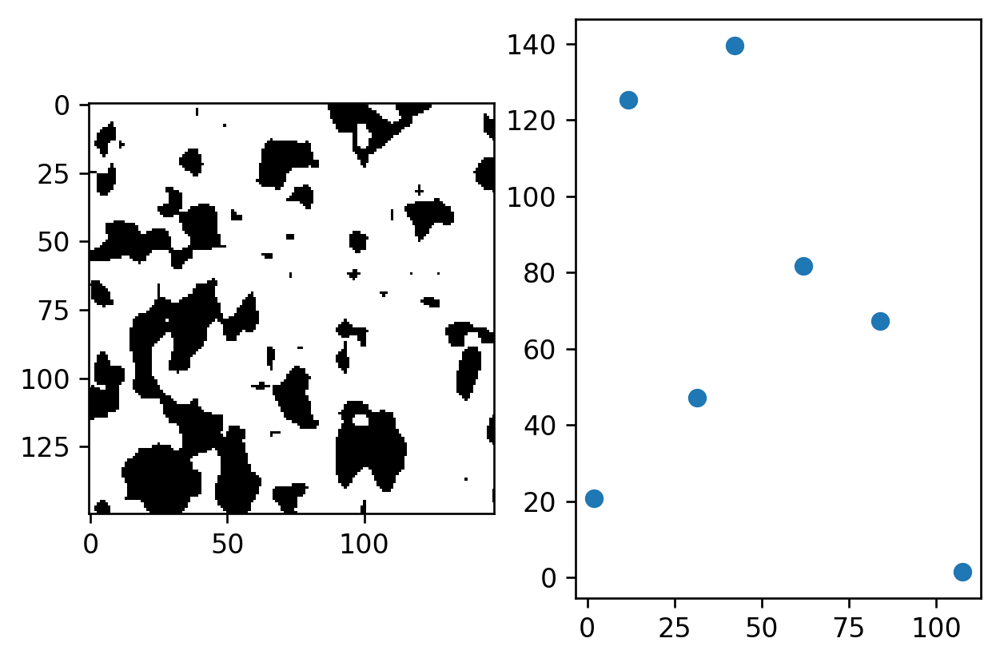

6.732590447445098
[13.247185549746275, 11.788686357456456, 38.59394849705544, 30.32330894793679, 14.87952149019338, 13.508109242037392, 8.164150146980093, 35.05771201458113, 33.18403487060513, 16.18748071809025, 12.746441756514944, 24.80004552076293, 21.877605217060104, 20.192345720523914, 14.560798841985976, 28.288336581696708, 25.431268876596498, 13.746509506116112, 18.16865025988747, 20.036766799060448, 17.991187607382184, 20.61919199254177, 17.52946404688742, 23.650964529758063, 33.13024238183553, 23.512965005384242, 12.077355838693652, 22.216533423607974, 20.829649449359014]
[9.570454660866675, 16.196749921268434, 23.24440056960923, 15.479265932507946, 14.831722694940897, 25.49536730450329, 23.554841027078226, 21.616839337764663, 12.20117720669208, 16.62520539350658, 9.0517526458567, 14.244174025625465, 16.530771415969816, 13.753880842919452, 21.441232874901562, 15.301342464039854, 13.890481232458962, 9.33960848226737, 9.149054860437795, 13.667212499668725, 5.907303354207741, 6.59

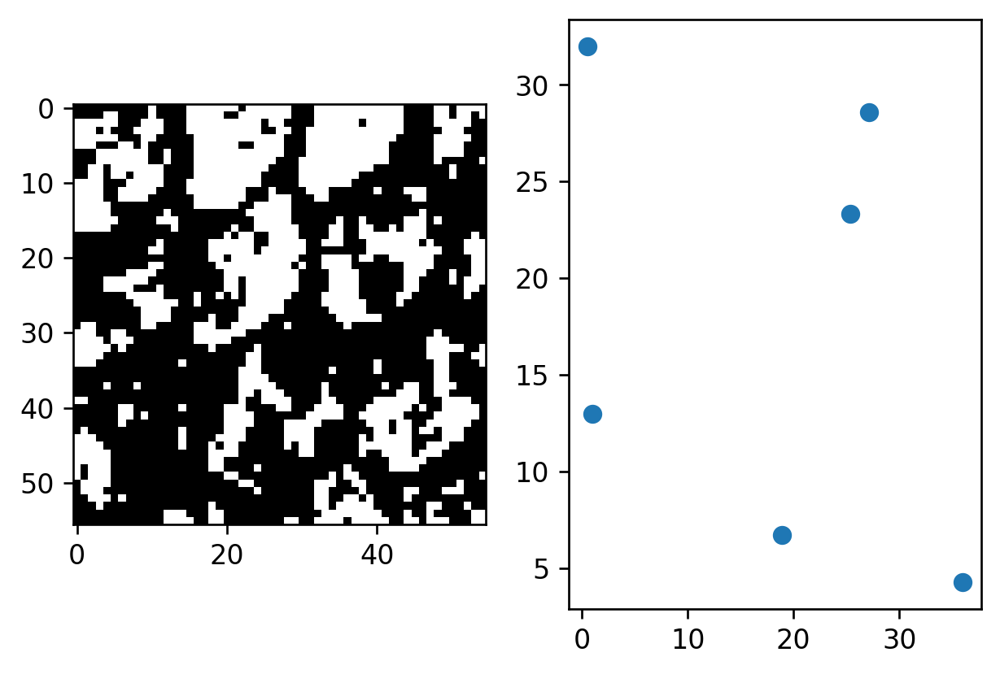

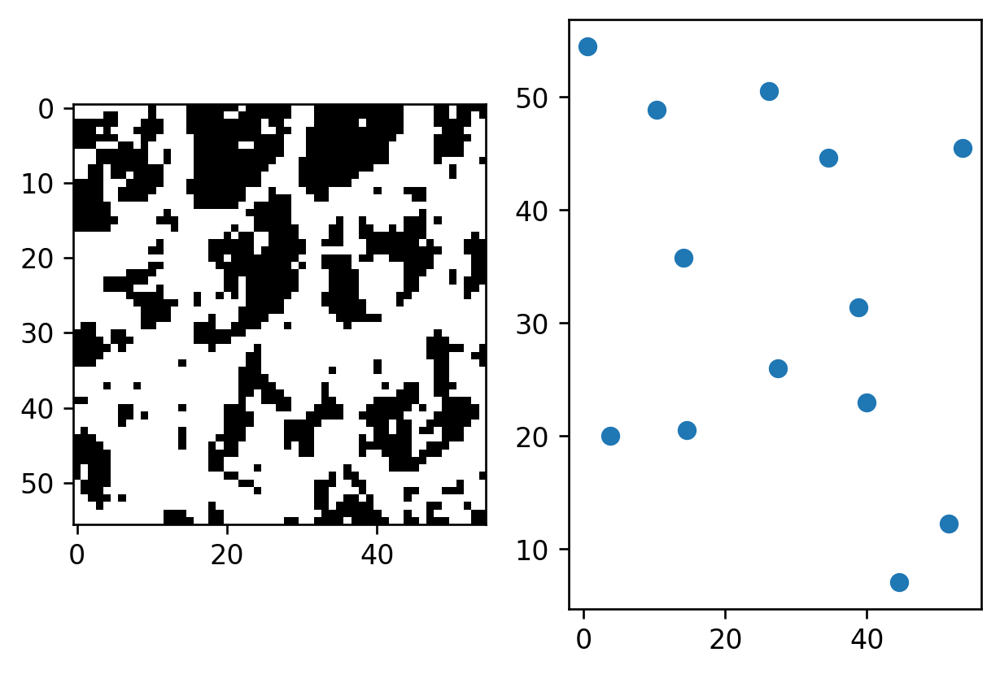

5.964718620080735
[13.247185549746275, 11.788686357456456, 38.59394849705544, 30.32330894793679, 14.87952149019338, 13.508109242037392, 8.164150146980093, 35.05771201458113, 33.18403487060513, 16.18748071809025, 12.746441756514944, 24.80004552076293, 21.877605217060104, 20.192345720523914, 14.560798841985976, 28.288336581696708, 25.431268876596498, 13.746509506116112, 18.16865025988747, 20.036766799060448, 17.991187607382184, 20.61919199254177, 17.52946404688742, 23.650964529758063, 33.13024238183553, 23.512965005384242, 12.077355838693652, 22.216533423607974, 20.829649449359014, 13.932074361236582]
[9.570454660866675, 16.196749921268434, 23.24440056960923, 15.479265932507946, 14.831722694940897, 25.49536730450329, 23.554841027078226, 21.616839337764663, 12.20117720669208, 16.62520539350658, 9.0517526458567, 14.244174025625465, 16.530771415969816, 13.753880842919452, 21.441232874901562, 15.301342464039854, 13.890481232458962, 9.33960848226737, 9.149054860437795, 13.667212499668725, 5.9

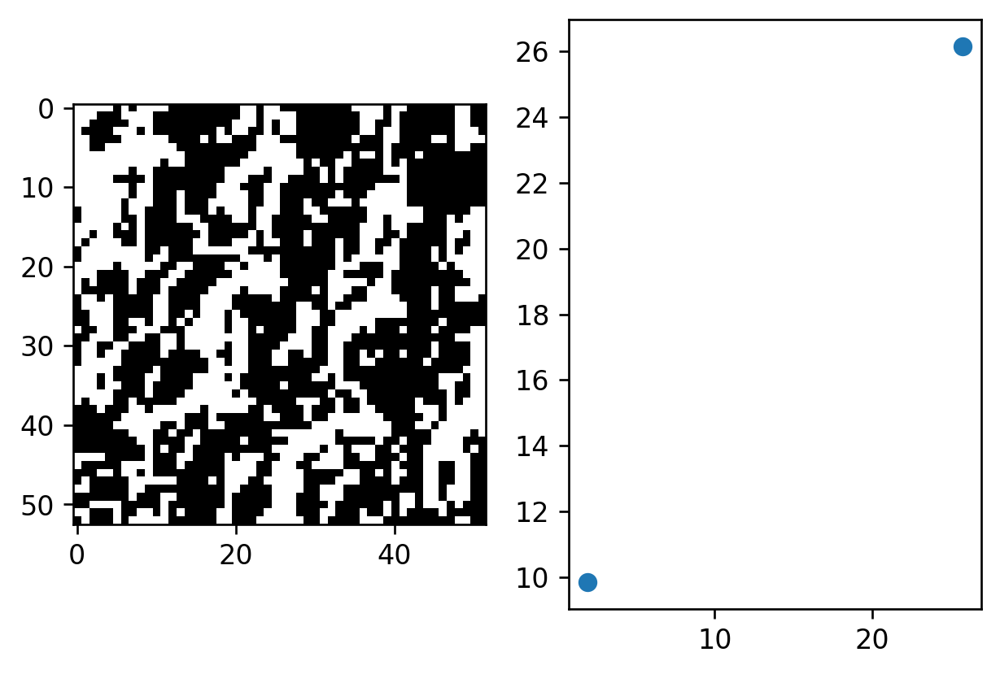

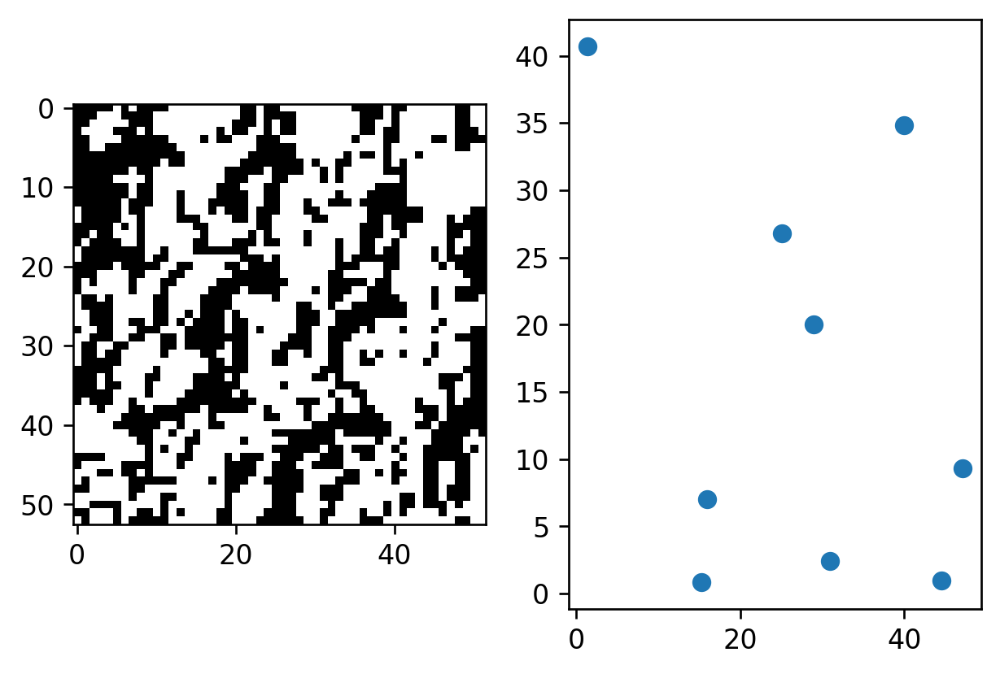

0.0
[13.247185549746275, 11.788686357456456, 38.59394849705544, 30.32330894793679, 14.87952149019338, 13.508109242037392, 8.164150146980093, 35.05771201458113, 33.18403487060513, 16.18748071809025, 12.746441756514944, 24.80004552076293, 21.877605217060104, 20.192345720523914, 14.560798841985976, 28.288336581696708, 25.431268876596498, 13.746509506116112, 18.16865025988747, 20.036766799060448, 17.991187607382184, 20.61919199254177, 17.52946404688742, 23.650964529758063, 33.13024238183553, 23.512965005384242, 12.077355838693652, 22.216533423607974, 20.829649449359014, 13.932074361236582, 28.857166210694057]
[9.570454660866675, 16.196749921268434, 23.24440056960923, 15.479265932507946, 14.831722694940897, 25.49536730450329, 23.554841027078226, 21.616839337764663, 12.20117720669208, 16.62520539350658, 9.0517526458567, 14.244174025625465, 16.530771415969816, 13.753880842919452, 21.441232874901562, 15.301342464039854, 13.890481232458962, 9.33960848226737, 9.149054860437795, 13.66721249966872

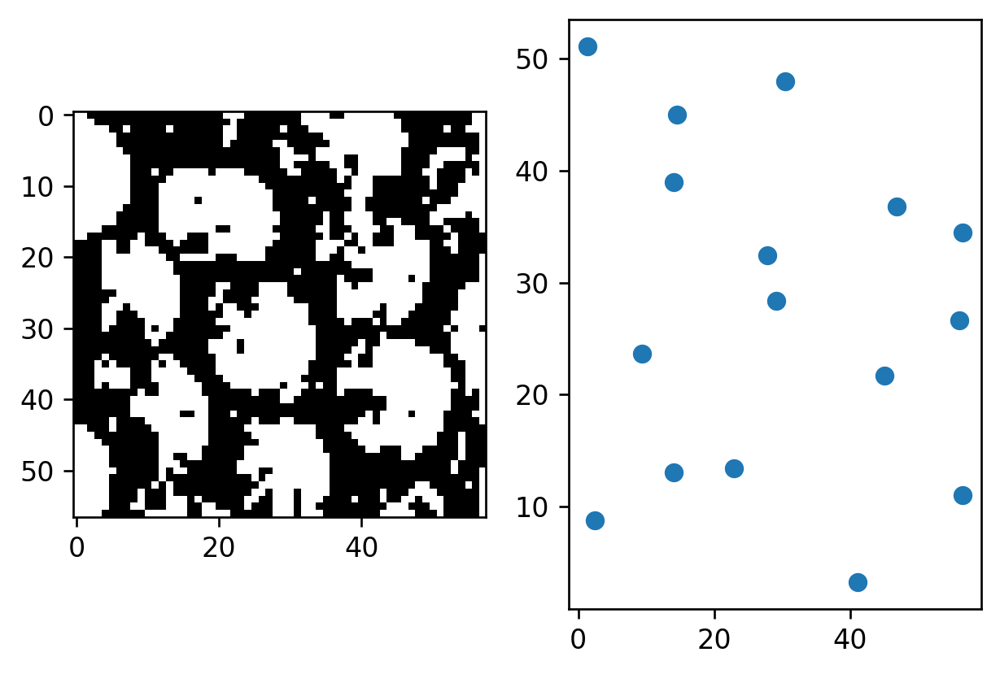

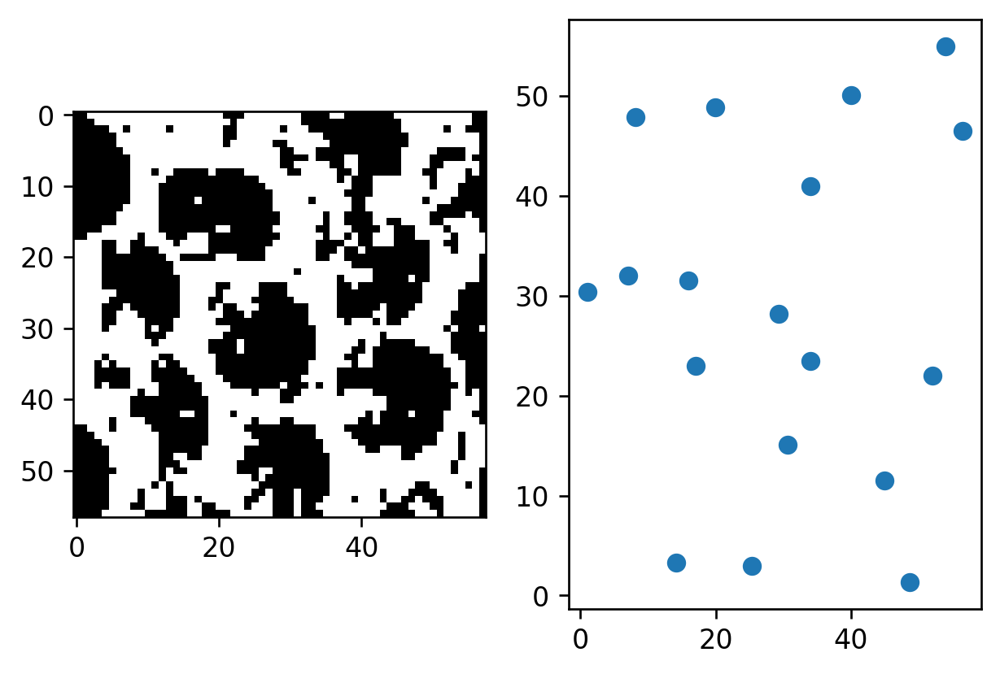

4.024311891383629
[13.247185549746275, 11.788686357456456, 38.59394849705544, 30.32330894793679, 14.87952149019338, 13.508109242037392, 8.164150146980093, 35.05771201458113, 33.18403487060513, 16.18748071809025, 12.746441756514944, 24.80004552076293, 21.877605217060104, 20.192345720523914, 14.560798841985976, 28.288336581696708, 25.431268876596498, 13.746509506116112, 18.16865025988747, 20.036766799060448, 17.991187607382184, 20.61919199254177, 17.52946404688742, 23.650964529758063, 33.13024238183553, 23.512965005384242, 12.077355838693652, 22.216533423607974, 20.829649449359014, 13.932074361236582, 28.857166210694057, 10.20182998137205]
[9.570454660866675, 16.196749921268434, 23.24440056960923, 15.479265932507946, 14.831722694940897, 25.49536730450329, 23.554841027078226, 21.616839337764663, 12.20117720669208, 16.62520539350658, 9.0517526458567, 14.244174025625465, 16.530771415969816, 13.753880842919452, 21.441232874901562, 15.301342464039854, 13.890481232458962, 9.33960848226737, 9.1

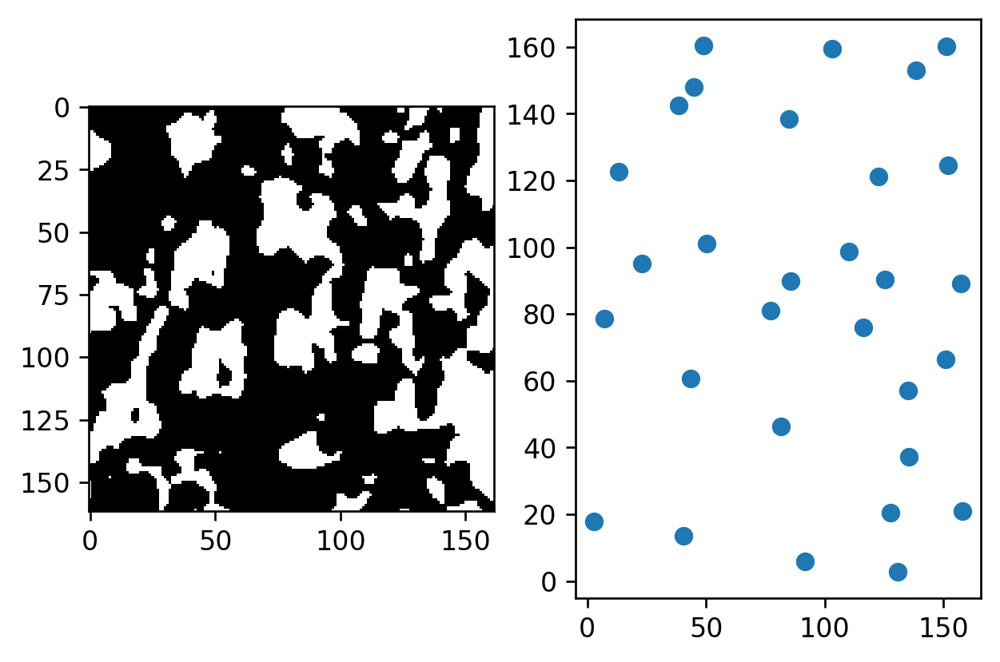

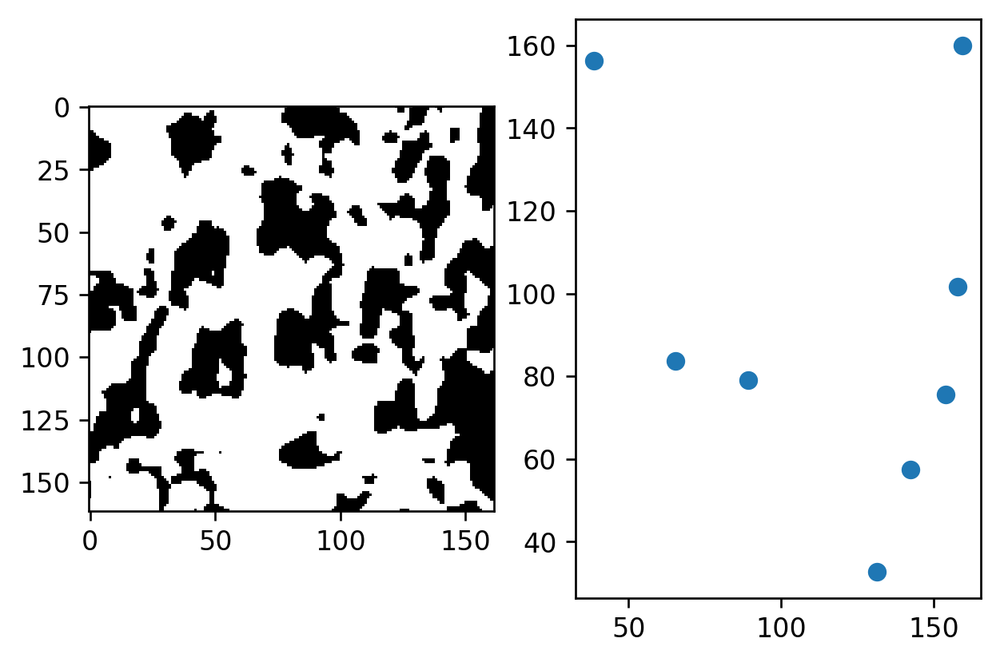

9.00078461189411
[13.247185549746275, 11.788686357456456, 38.59394849705544, 30.32330894793679, 14.87952149019338, 13.508109242037392, 8.164150146980093, 35.05771201458113, 33.18403487060513, 16.18748071809025, 12.746441756514944, 24.80004552076293, 21.877605217060104, 20.192345720523914, 14.560798841985976, 28.288336581696708, 25.431268876596498, 13.746509506116112, 18.16865025988747, 20.036766799060448, 17.991187607382184, 20.61919199254177, 17.52946404688742, 23.650964529758063, 33.13024238183553, 23.512965005384242, 12.077355838693652, 22.216533423607974, 20.829649449359014, 13.932074361236582, 28.857166210694057, 10.20182998137205, 22.69888857400598]
[9.570454660866675, 16.196749921268434, 23.24440056960923, 15.479265932507946, 14.831722694940897, 25.49536730450329, 23.554841027078226, 21.616839337764663, 12.20117720669208, 16.62520539350658, 9.0517526458567, 14.244174025625465, 16.530771415969816, 13.753880842919452, 21.441232874901562, 15.301342464039854, 13.890481232458962, 9.3

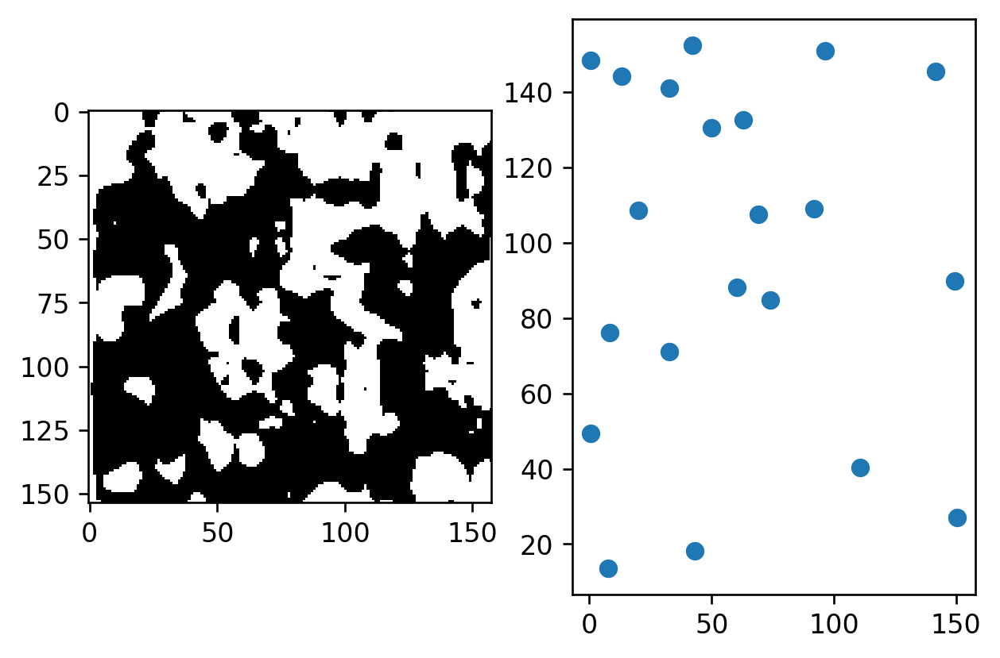

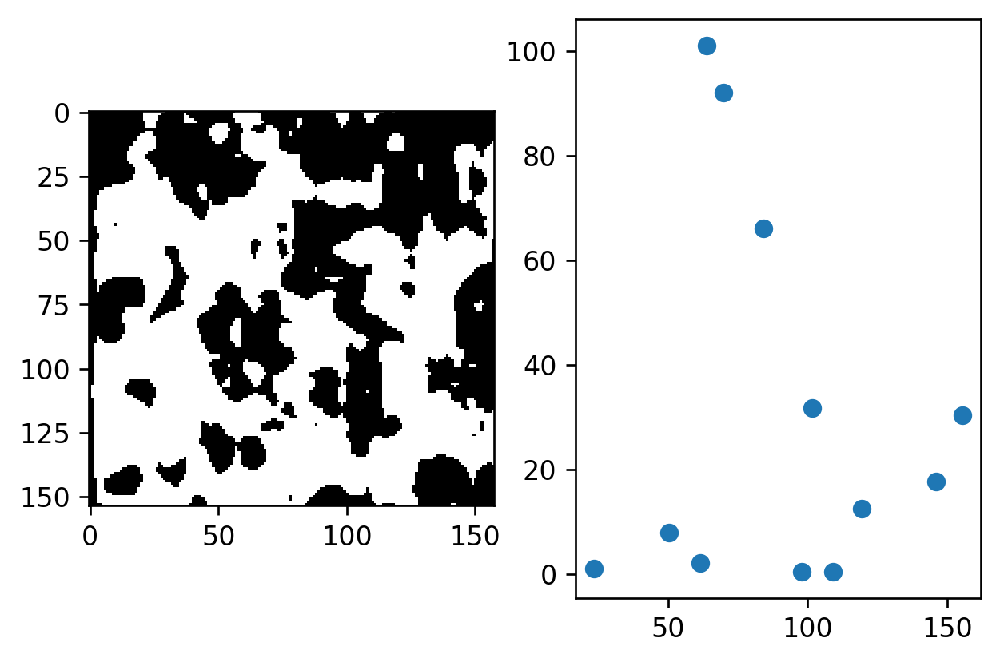

12.754656378436701
[13.247185549746275, 11.788686357456456, 38.59394849705544, 30.32330894793679, 14.87952149019338, 13.508109242037392, 8.164150146980093, 35.05771201458113, 33.18403487060513, 16.18748071809025, 12.746441756514944, 24.80004552076293, 21.877605217060104, 20.192345720523914, 14.560798841985976, 28.288336581696708, 25.431268876596498, 13.746509506116112, 18.16865025988747, 20.036766799060448, 17.991187607382184, 20.61919199254177, 17.52946404688742, 23.650964529758063, 33.13024238183553, 23.512965005384242, 12.077355838693652, 22.216533423607974, 20.829649449359014, 13.932074361236582, 28.857166210694057, 10.20182998137205, 22.69888857400598, 26.744881502769154]
[9.570454660866675, 16.196749921268434, 23.24440056960923, 15.479265932507946, 14.831722694940897, 25.49536730450329, 23.554841027078226, 21.616839337764663, 12.20117720669208, 16.62520539350658, 9.0517526458567, 14.244174025625465, 16.530771415969816, 13.753880842919452, 21.441232874901562, 15.301342464039854, 1

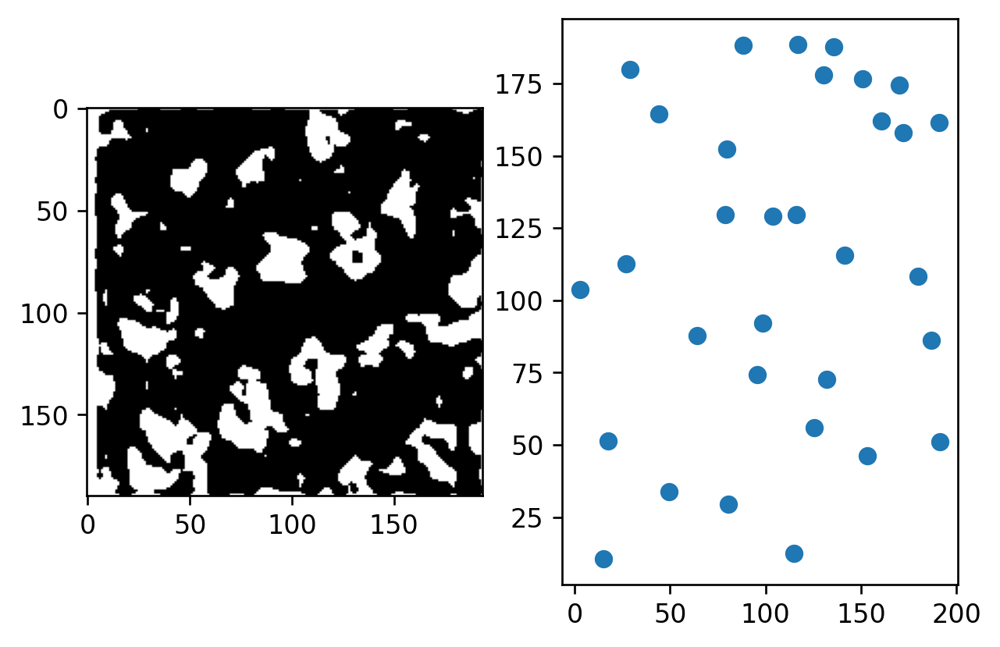

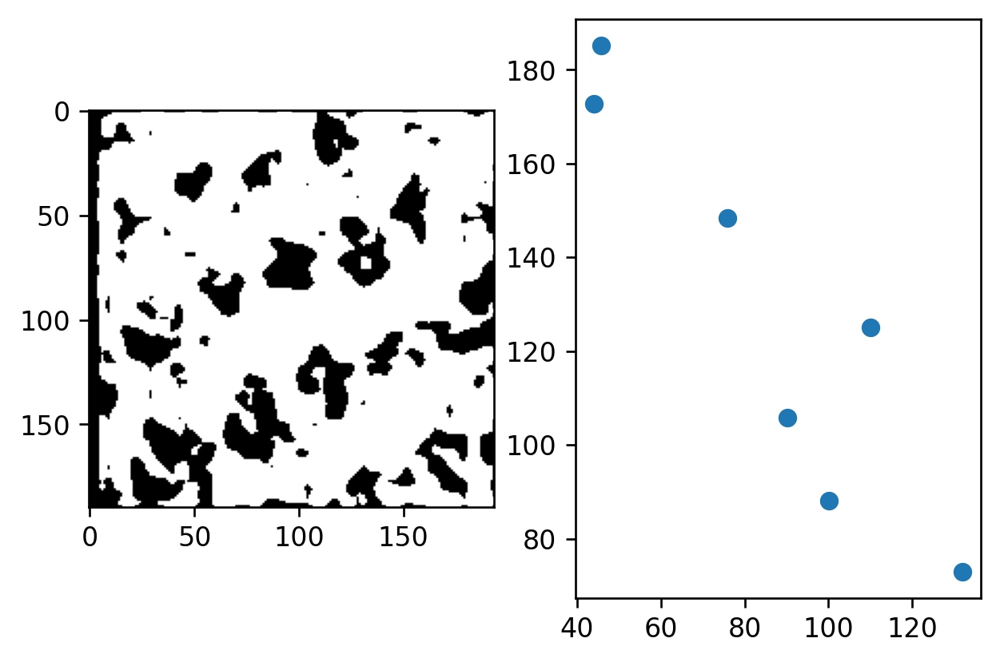

8.423312564400279
[13.247185549746275, 11.788686357456456, 38.59394849705544, 30.32330894793679, 14.87952149019338, 13.508109242037392, 8.164150146980093, 35.05771201458113, 33.18403487060513, 16.18748071809025, 12.746441756514944, 24.80004552076293, 21.877605217060104, 20.192345720523914, 14.560798841985976, 28.288336581696708, 25.431268876596498, 13.746509506116112, 18.16865025988747, 20.036766799060448, 17.991187607382184, 20.61919199254177, 17.52946404688742, 23.650964529758063, 33.13024238183553, 23.512965005384242, 12.077355838693652, 22.216533423607974, 20.829649449359014, 13.932074361236582, 28.857166210694057, 10.20182998137205, 22.69888857400598, 26.744881502769154, 22.922268368246108]
[9.570454660866675, 16.196749921268434, 23.24440056960923, 15.479265932507946, 14.831722694940897, 25.49536730450329, 23.554841027078226, 21.616839337764663, 12.20117720669208, 16.62520539350658, 9.0517526458567, 14.244174025625465, 16.530771415969816, 13.753880842919452, 21.441232874901562, 15

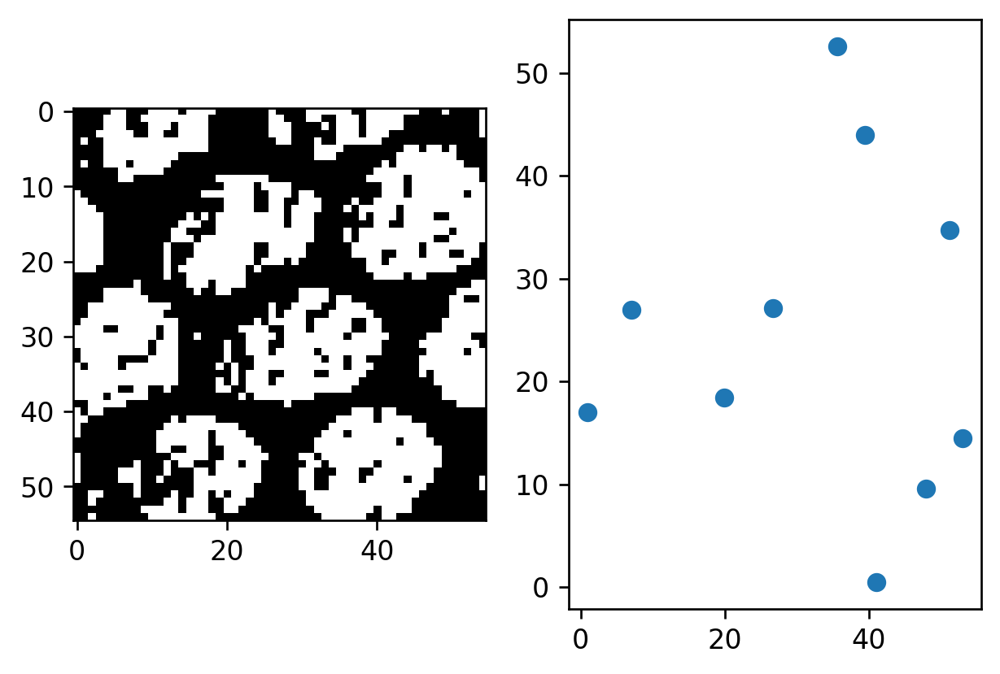

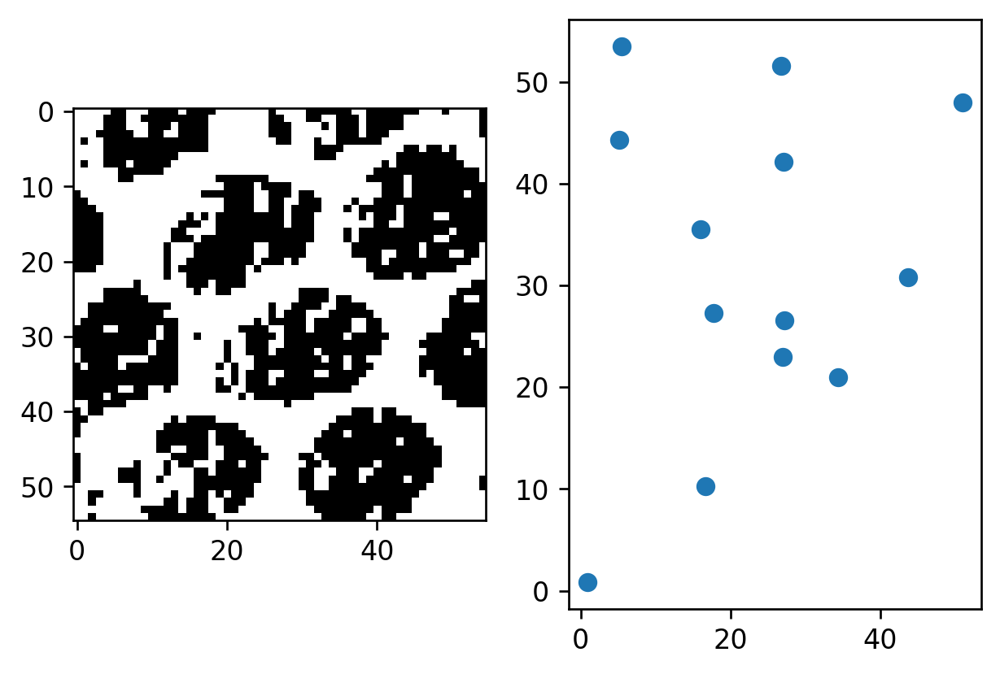

2.23946439962704
[13.247185549746275, 11.788686357456456, 38.59394849705544, 30.32330894793679, 14.87952149019338, 13.508109242037392, 8.164150146980093, 35.05771201458113, 33.18403487060513, 16.18748071809025, 12.746441756514944, 24.80004552076293, 21.877605217060104, 20.192345720523914, 14.560798841985976, 28.288336581696708, 25.431268876596498, 13.746509506116112, 18.16865025988747, 20.036766799060448, 17.991187607382184, 20.61919199254177, 17.52946404688742, 23.650964529758063, 33.13024238183553, 23.512965005384242, 12.077355838693652, 22.216533423607974, 20.829649449359014, 13.932074361236582, 28.857166210694057, 10.20182998137205, 22.69888857400598, 26.744881502769154, 22.922268368246108, 10.49047800312395]
[9.570454660866675, 16.196749921268434, 23.24440056960923, 15.479265932507946, 14.831722694940897, 25.49536730450329, 23.554841027078226, 21.616839337764663, 12.20117720669208, 16.62520539350658, 9.0517526458567, 14.244174025625465, 16.530771415969816, 13.753880842919452, 21.4

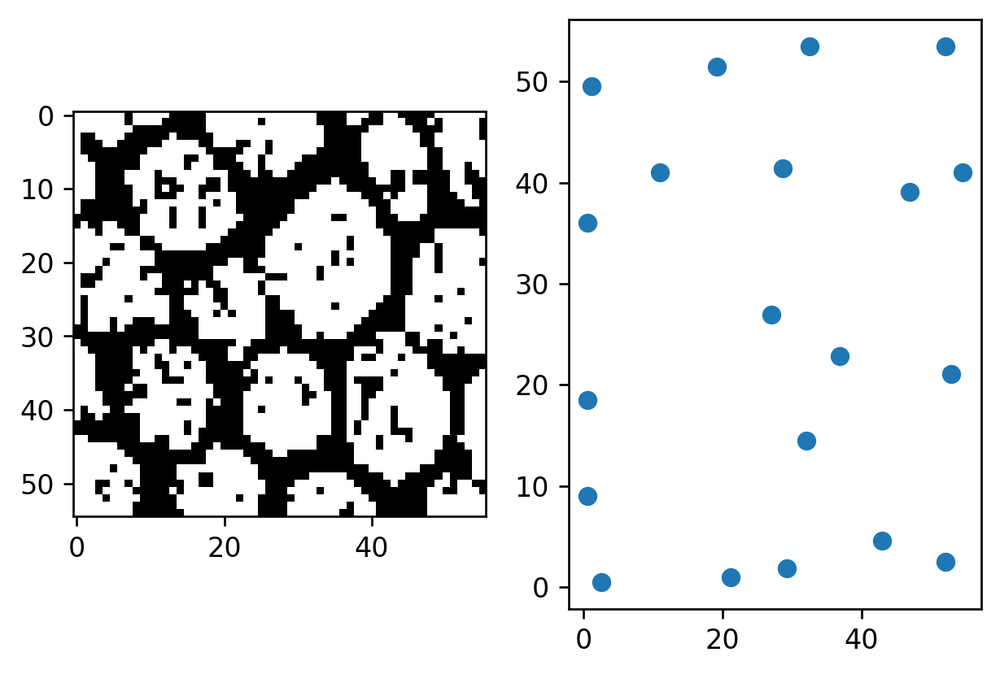

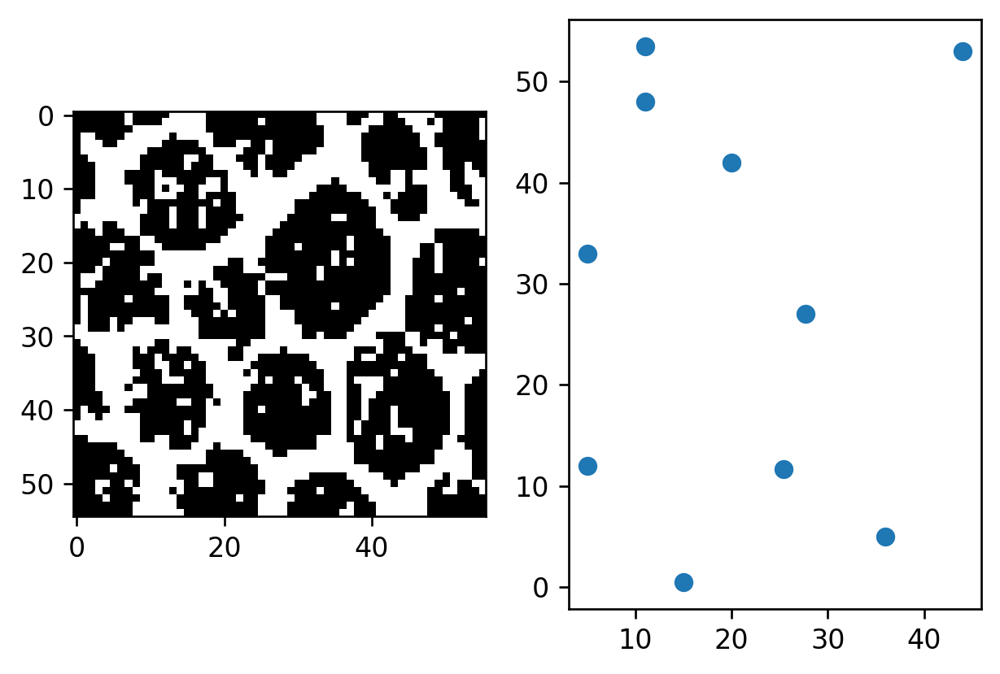

2.757442829542871
[13.247185549746275, 11.788686357456456, 38.59394849705544, 30.32330894793679, 14.87952149019338, 13.508109242037392, 8.164150146980093, 35.05771201458113, 33.18403487060513, 16.18748071809025, 12.746441756514944, 24.80004552076293, 21.877605217060104, 20.192345720523914, 14.560798841985976, 28.288336581696708, 25.431268876596498, 13.746509506116112, 18.16865025988747, 20.036766799060448, 17.991187607382184, 20.61919199254177, 17.52946404688742, 23.650964529758063, 33.13024238183553, 23.512965005384242, 12.077355838693652, 22.216533423607974, 20.829649449359014, 13.932074361236582, 28.857166210694057, 10.20182998137205, 22.69888857400598, 26.744881502769154, 22.922268368246108, 10.49047800312395, 11.00199463333826]
[9.570454660866675, 16.196749921268434, 23.24440056960923, 15.479265932507946, 14.831722694940897, 25.49536730450329, 23.554841027078226, 21.616839337764663, 12.20117720669208, 16.62520539350658, 9.0517526458567, 14.244174025625465, 16.530771415969816, 13.7

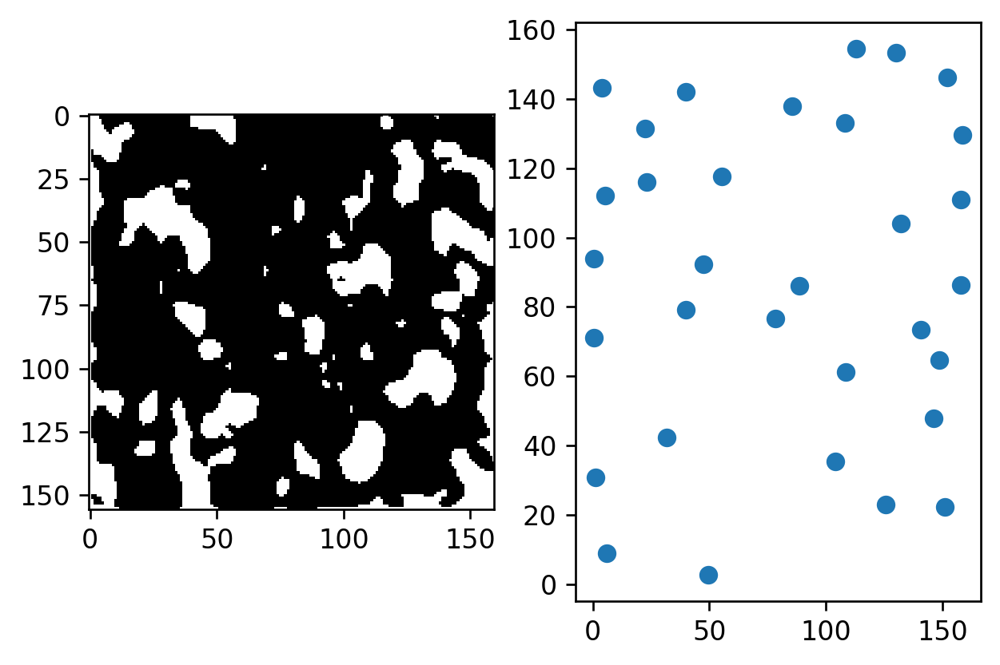

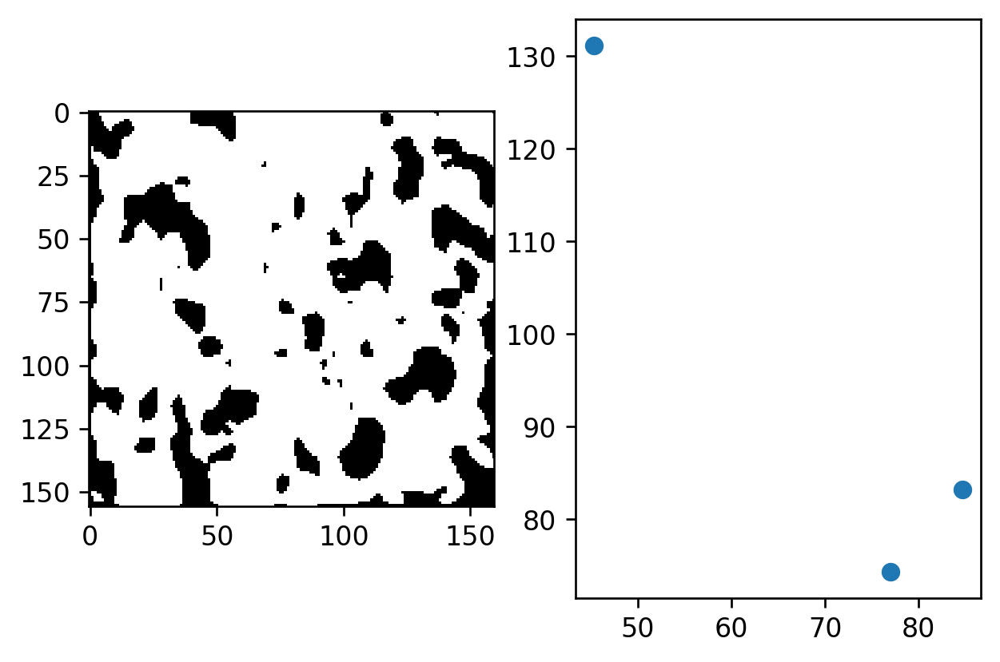

7.184056620428285
[13.247185549746275, 11.788686357456456, 38.59394849705544, 30.32330894793679, 14.87952149019338, 13.508109242037392, 8.164150146980093, 35.05771201458113, 33.18403487060513, 16.18748071809025, 12.746441756514944, 24.80004552076293, 21.877605217060104, 20.192345720523914, 14.560798841985976, 28.288336581696708, 25.431268876596498, 13.746509506116112, 18.16865025988747, 20.036766799060448, 17.991187607382184, 20.61919199254177, 17.52946404688742, 23.650964529758063, 33.13024238183553, 23.512965005384242, 12.077355838693652, 22.216533423607974, 20.829649449359014, 13.932074361236582, 28.857166210694057, 10.20182998137205, 22.69888857400598, 26.744881502769154, 22.922268368246108, 10.49047800312395, 11.00199463333826, 21.195836836180682]
[9.570454660866675, 16.196749921268434, 23.24440056960923, 15.479265932507946, 14.831722694940897, 25.49536730450329, 23.554841027078226, 21.616839337764663, 12.20117720669208, 16.62520539350658, 9.0517526458567, 14.244174025625465, 16.5

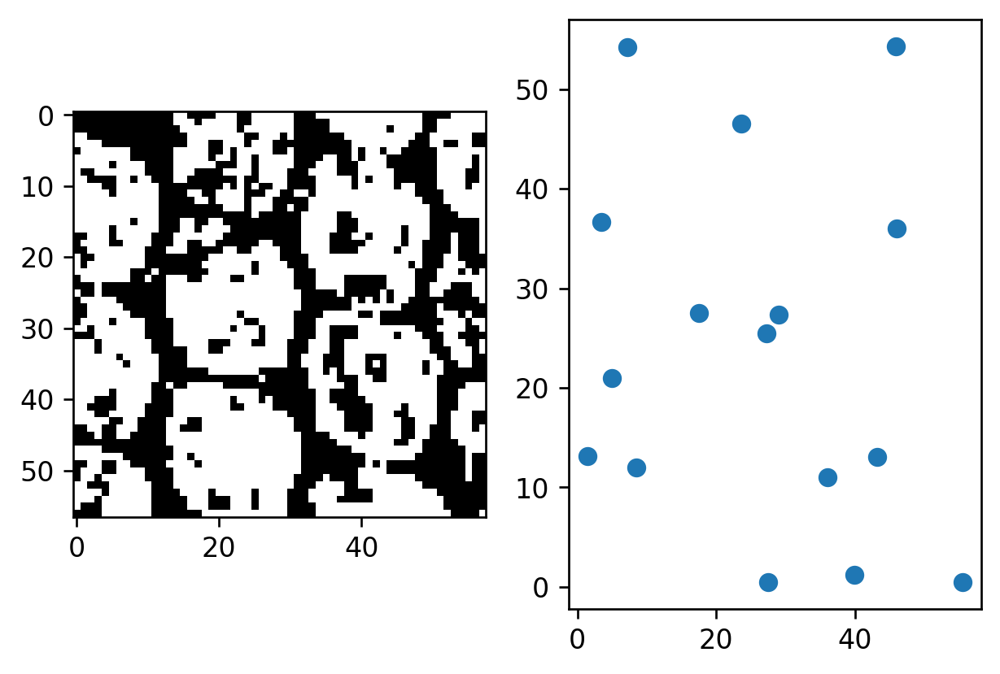

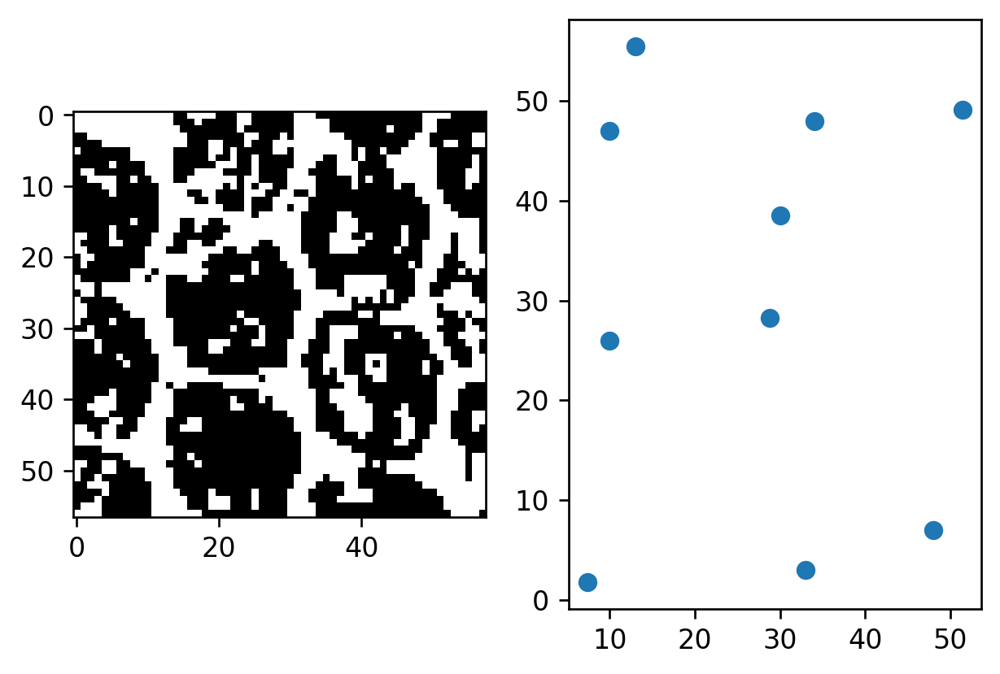

5.326531612081249
[13.247185549746275, 11.788686357456456, 38.59394849705544, 30.32330894793679, 14.87952149019338, 13.508109242037392, 8.164150146980093, 35.05771201458113, 33.18403487060513, 16.18748071809025, 12.746441756514944, 24.80004552076293, 21.877605217060104, 20.192345720523914, 14.560798841985976, 28.288336581696708, 25.431268876596498, 13.746509506116112, 18.16865025988747, 20.036766799060448, 17.991187607382184, 20.61919199254177, 17.52946404688742, 23.650964529758063, 33.13024238183553, 23.512965005384242, 12.077355838693652, 22.216533423607974, 20.829649449359014, 13.932074361236582, 28.857166210694057, 10.20182998137205, 22.69888857400598, 26.744881502769154, 22.922268368246108, 10.49047800312395, 11.00199463333826, 21.195836836180682, 11.261284629393991]
[9.570454660866675, 16.196749921268434, 23.24440056960923, 15.479265932507946, 14.831722694940897, 25.49536730450329, 23.554841027078226, 21.616839337764663, 12.20117720669208, 16.62520539350658, 9.0517526458567, 14.2

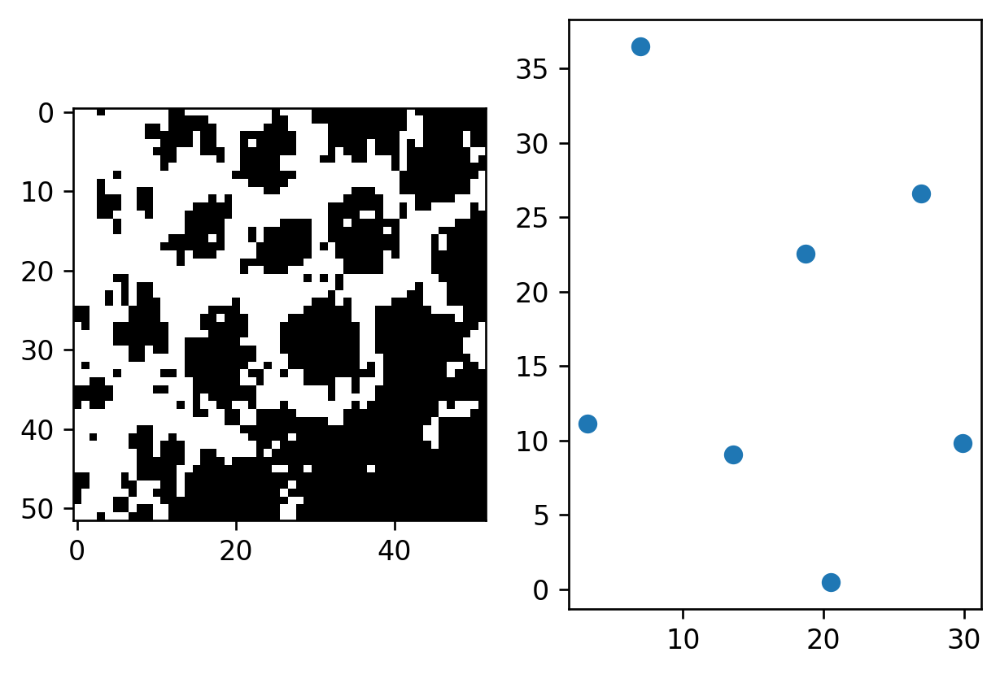

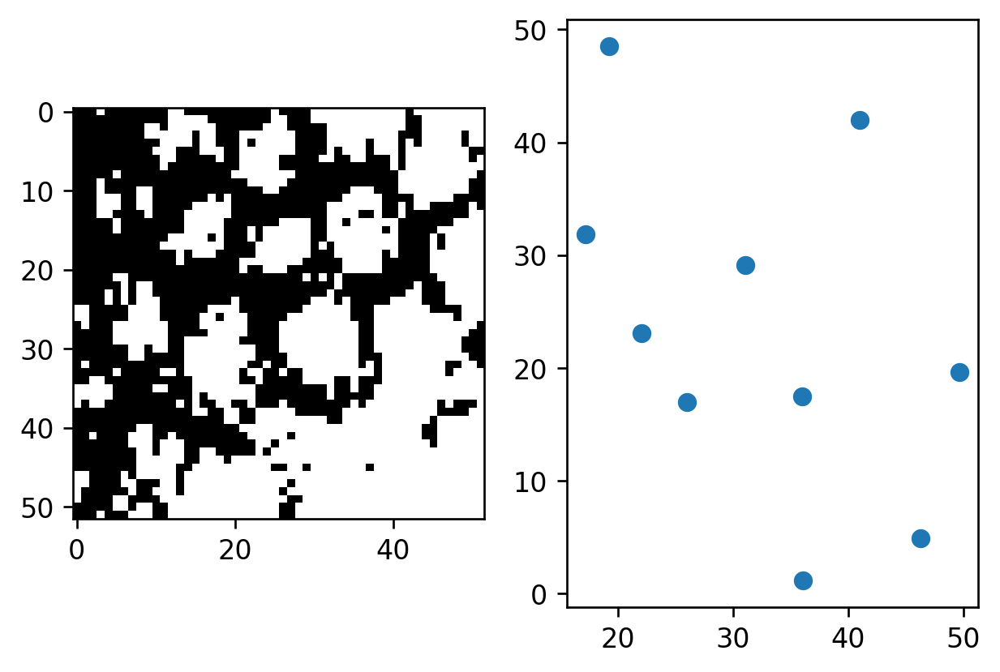

2.9316587392148237
[13.247185549746275, 11.788686357456456, 38.59394849705544, 30.32330894793679, 14.87952149019338, 13.508109242037392, 8.164150146980093, 35.05771201458113, 33.18403487060513, 16.18748071809025, 12.746441756514944, 24.80004552076293, 21.877605217060104, 20.192345720523914, 14.560798841985976, 28.288336581696708, 25.431268876596498, 13.746509506116112, 18.16865025988747, 20.036766799060448, 17.991187607382184, 20.61919199254177, 17.52946404688742, 23.650964529758063, 33.13024238183553, 23.512965005384242, 12.077355838693652, 22.216533423607974, 20.829649449359014, 13.932074361236582, 28.857166210694057, 10.20182998137205, 22.69888857400598, 26.744881502769154, 22.922268368246108, 10.49047800312395, 11.00199463333826, 21.195836836180682, 11.261284629393991, 11.712749163217508]
[9.570454660866675, 16.196749921268434, 23.24440056960923, 15.479265932507946, 14.831722694940897, 25.49536730450329, 23.554841027078226, 21.616839337764663, 12.20117720669208, 16.62520539350658, 

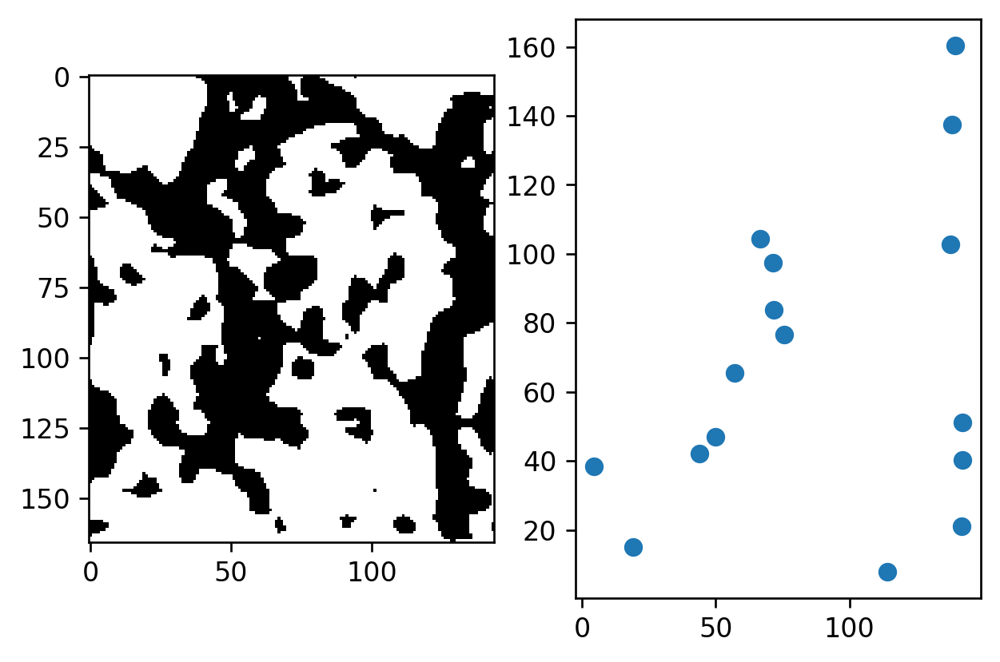

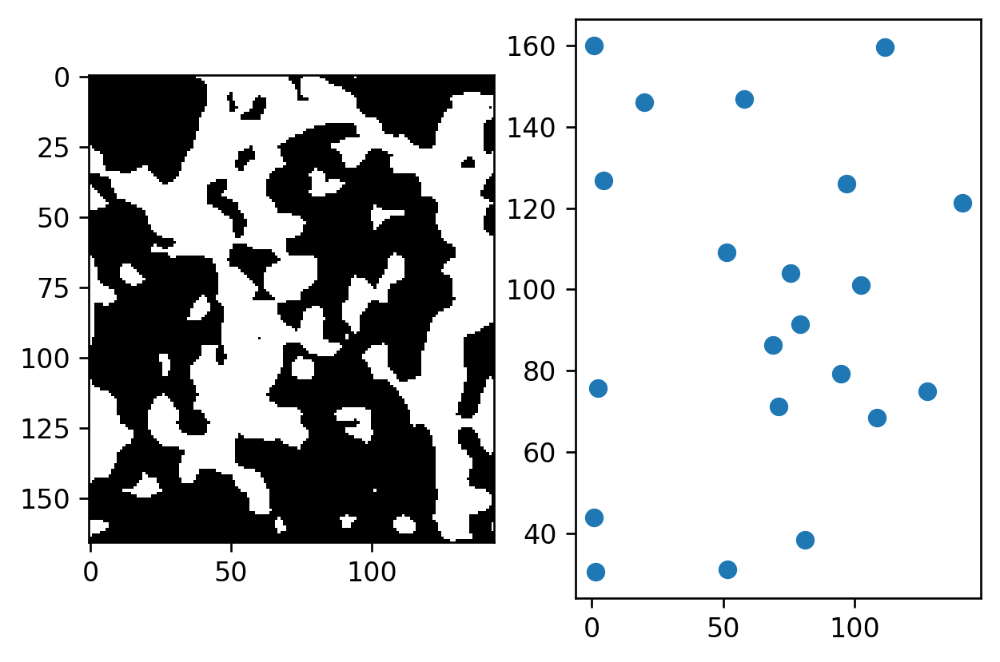

9.189527903744558
[13.247185549746275, 11.788686357456456, 38.59394849705544, 30.32330894793679, 14.87952149019338, 13.508109242037392, 8.164150146980093, 35.05771201458113, 33.18403487060513, 16.18748071809025, 12.746441756514944, 24.80004552076293, 21.877605217060104, 20.192345720523914, 14.560798841985976, 28.288336581696708, 25.431268876596498, 13.746509506116112, 18.16865025988747, 20.036766799060448, 17.991187607382184, 20.61919199254177, 17.52946404688742, 23.650964529758063, 33.13024238183553, 23.512965005384242, 12.077355838693652, 22.216533423607974, 20.829649449359014, 13.932074361236582, 28.857166210694057, 10.20182998137205, 22.69888857400598, 26.744881502769154, 22.922268368246108, 10.49047800312395, 11.00199463333826, 21.195836836180682, 11.261284629393991, 11.712749163217508, 17.304951712625304]
[9.570454660866675, 16.196749921268434, 23.24440056960923, 15.479265932507946, 14.831722694940897, 25.49536730450329, 23.554841027078226, 21.616839337764663, 12.20117720669208, 

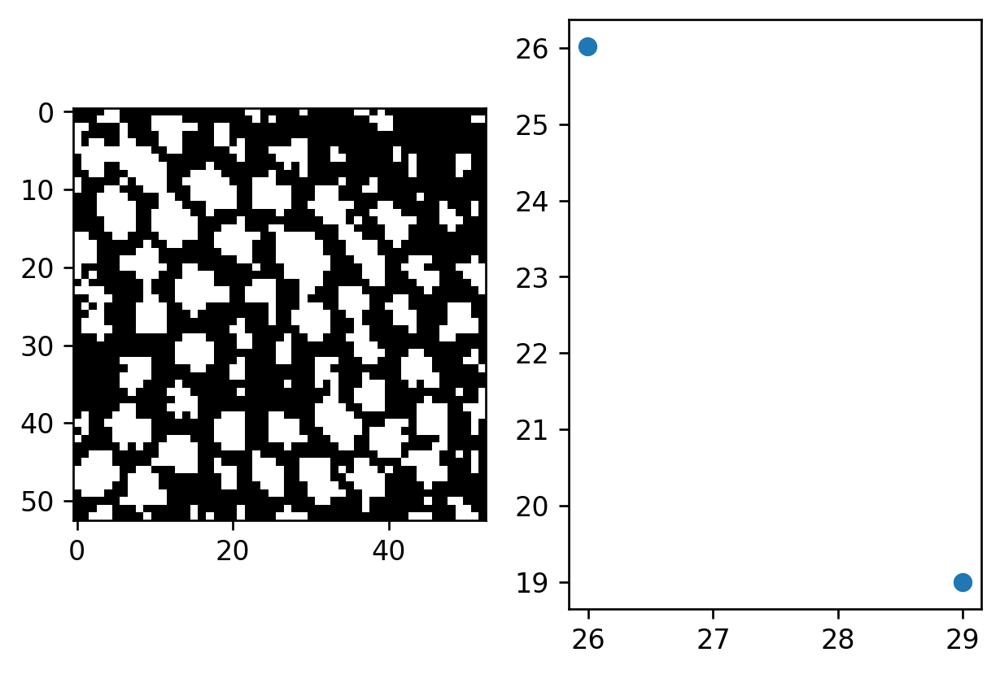

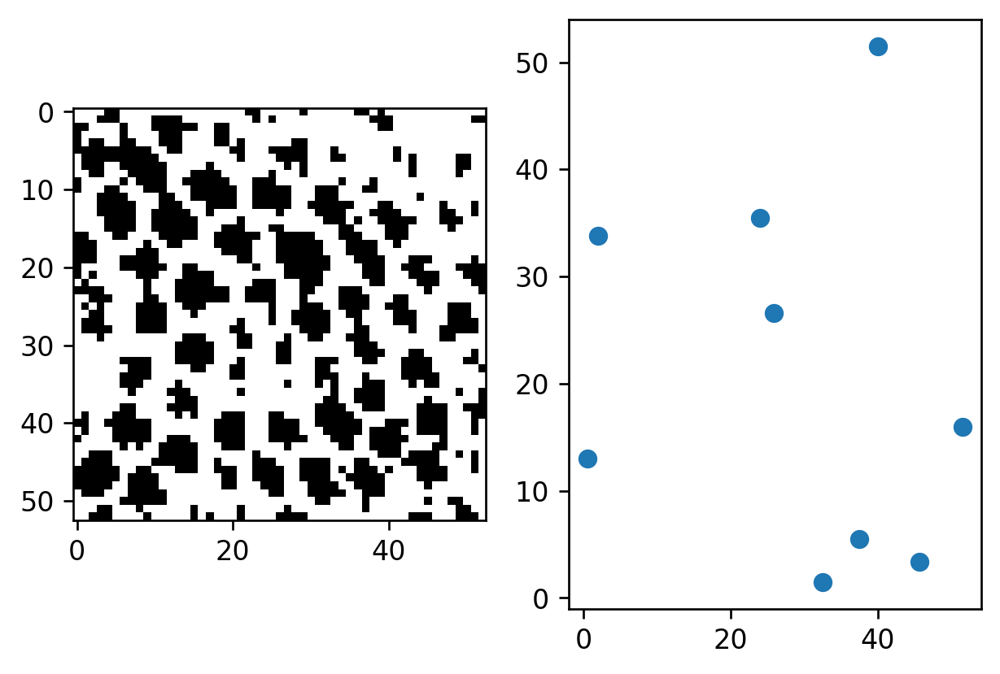

0.0
[13.247185549746275, 11.788686357456456, 38.59394849705544, 30.32330894793679, 14.87952149019338, 13.508109242037392, 8.164150146980093, 35.05771201458113, 33.18403487060513, 16.18748071809025, 12.746441756514944, 24.80004552076293, 21.877605217060104, 20.192345720523914, 14.560798841985976, 28.288336581696708, 25.431268876596498, 13.746509506116112, 18.16865025988747, 20.036766799060448, 17.991187607382184, 20.61919199254177, 17.52946404688742, 23.650964529758063, 33.13024238183553, 23.512965005384242, 12.077355838693652, 22.216533423607974, 20.829649449359014, 13.932074361236582, 28.857166210694057, 10.20182998137205, 22.69888857400598, 26.744881502769154, 22.922268368246108, 10.49047800312395, 11.00199463333826, 21.195836836180682, 11.261284629393991, 11.712749163217508, 17.304951712625304, 7.640252376561329]
[9.570454660866675, 16.196749921268434, 23.24440056960923, 15.479265932507946, 14.831722694940897, 25.49536730450329, 23.554841027078226, 21.616839337764663, 12.20117720669

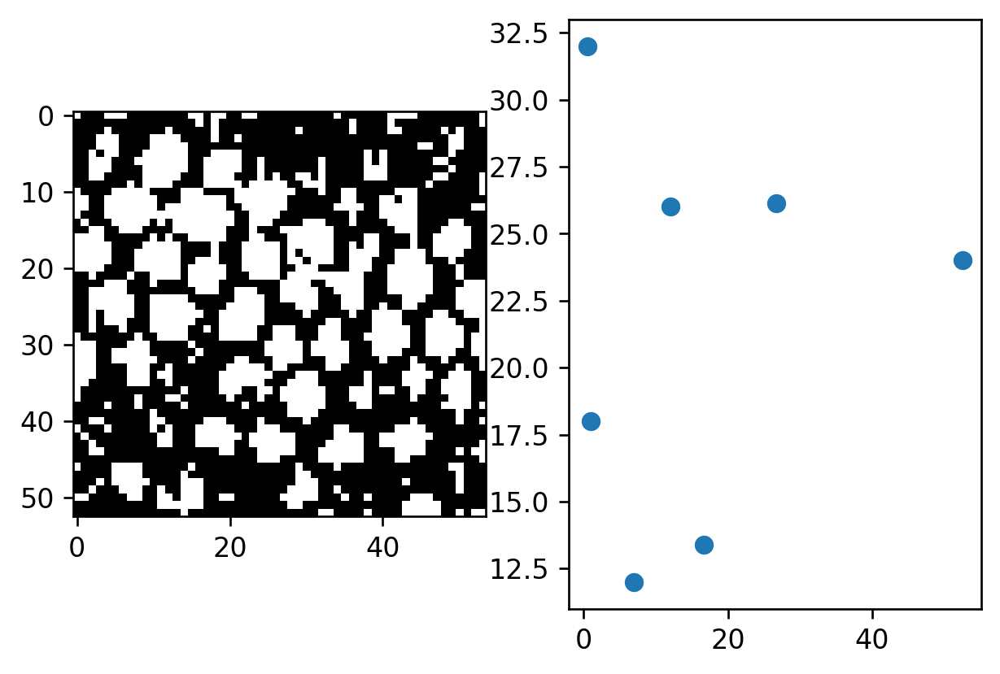

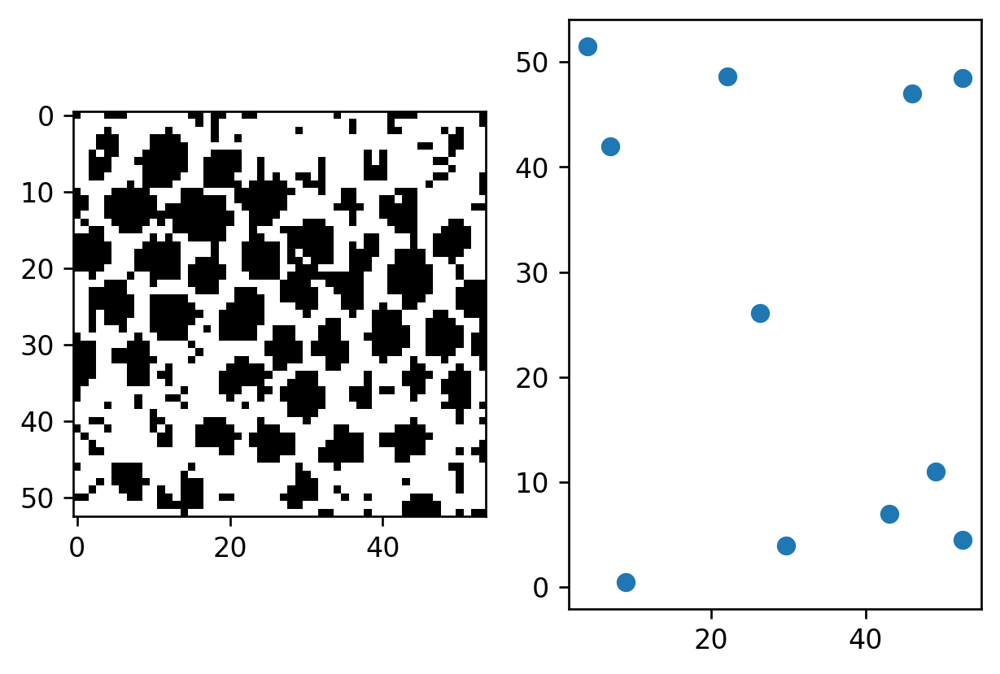

5.592994334595194
[13.247185549746275, 11.788686357456456, 38.59394849705544, 30.32330894793679, 14.87952149019338, 13.508109242037392, 8.164150146980093, 35.05771201458113, 33.18403487060513, 16.18748071809025, 12.746441756514944, 24.80004552076293, 21.877605217060104, 20.192345720523914, 14.560798841985976, 28.288336581696708, 25.431268876596498, 13.746509506116112, 18.16865025988747, 20.036766799060448, 17.991187607382184, 20.61919199254177, 17.52946404688742, 23.650964529758063, 33.13024238183553, 23.512965005384242, 12.077355838693652, 22.216533423607974, 20.829649449359014, 13.932074361236582, 28.857166210694057, 10.20182998137205, 22.69888857400598, 26.744881502769154, 22.922268368246108, 10.49047800312395, 11.00199463333826, 21.195836836180682, 11.261284629393991, 11.712749163217508, 17.304951712625304, 7.640252376561329, 13.314683225302222]
[9.570454660866675, 16.196749921268434, 23.24440056960923, 15.479265932507946, 14.831722694940897, 25.49536730450329, 23.554841027078226, 

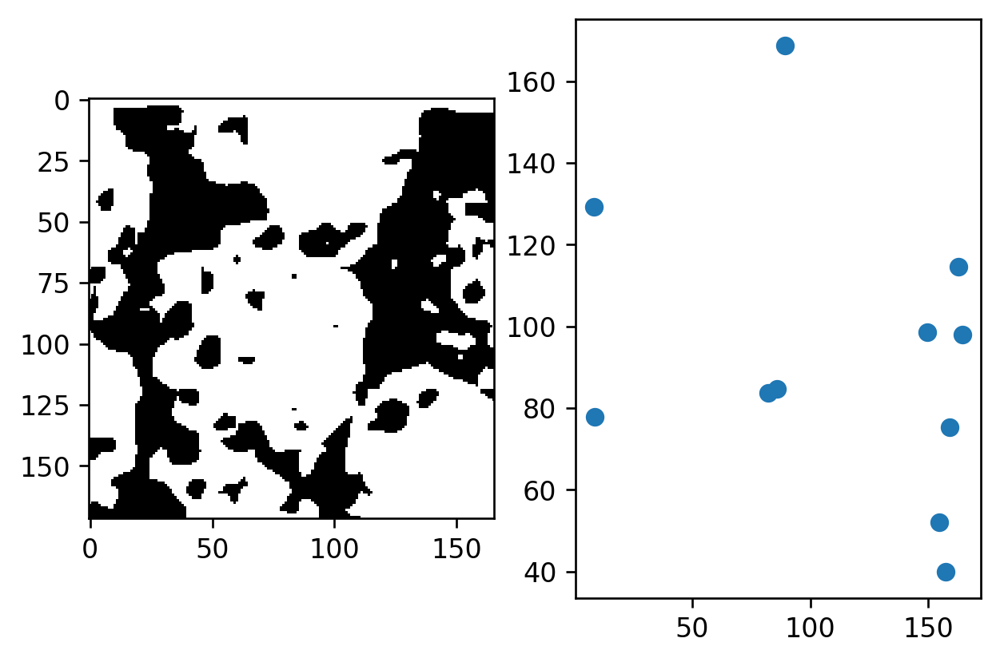

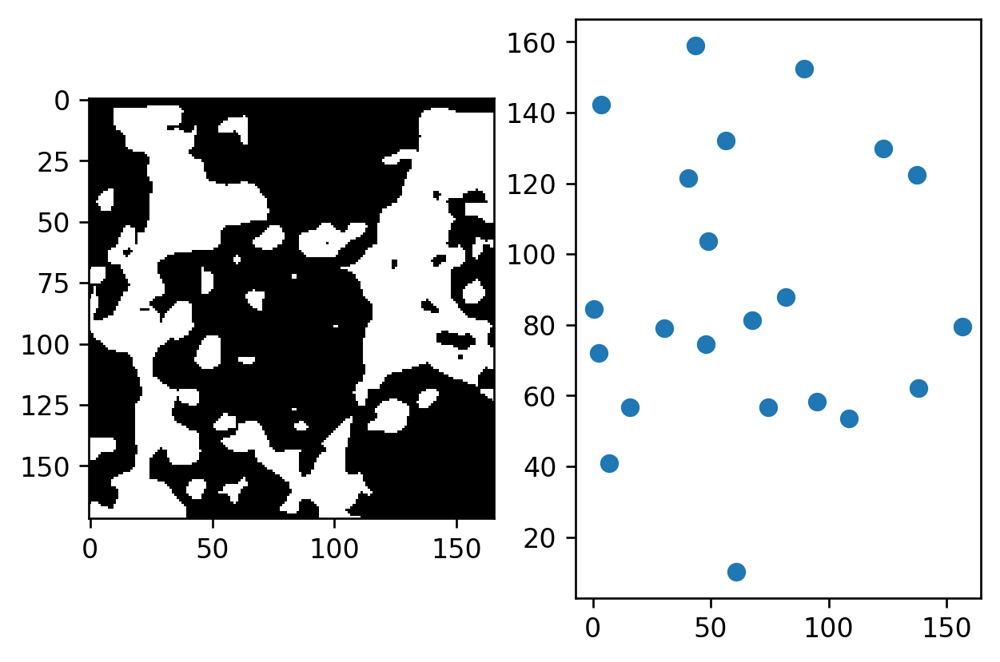

23.997769593224497
[13.247185549746275, 11.788686357456456, 38.59394849705544, 30.32330894793679, 14.87952149019338, 13.508109242037392, 8.164150146980093, 35.05771201458113, 33.18403487060513, 16.18748071809025, 12.746441756514944, 24.80004552076293, 21.877605217060104, 20.192345720523914, 14.560798841985976, 28.288336581696708, 25.431268876596498, 13.746509506116112, 18.16865025988747, 20.036766799060448, 17.991187607382184, 20.61919199254177, 17.52946404688742, 23.650964529758063, 33.13024238183553, 23.512965005384242, 12.077355838693652, 22.216533423607974, 20.829649449359014, 13.932074361236582, 28.857166210694057, 10.20182998137205, 22.69888857400598, 26.744881502769154, 22.922268368246108, 10.49047800312395, 11.00199463333826, 21.195836836180682, 11.261284629393991, 11.712749163217508, 17.304951712625304, 7.640252376561329, 13.314683225302222, 26.30609705419583]
[9.570454660866675, 16.196749921268434, 23.24440056960923, 15.479265932507946, 14.831722694940897, 25.49536730450329, 

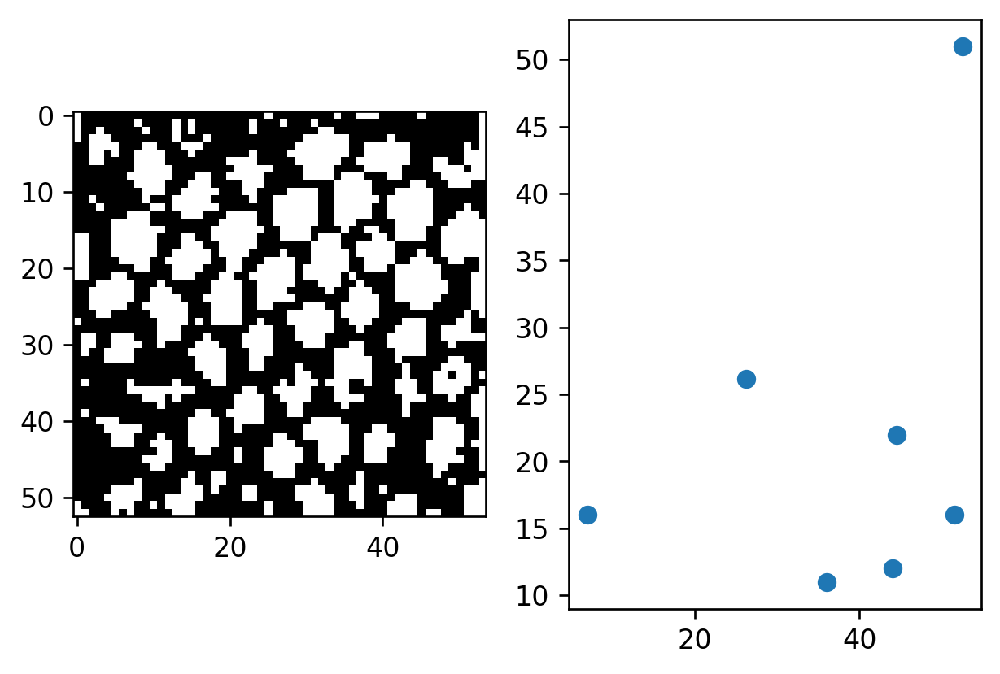

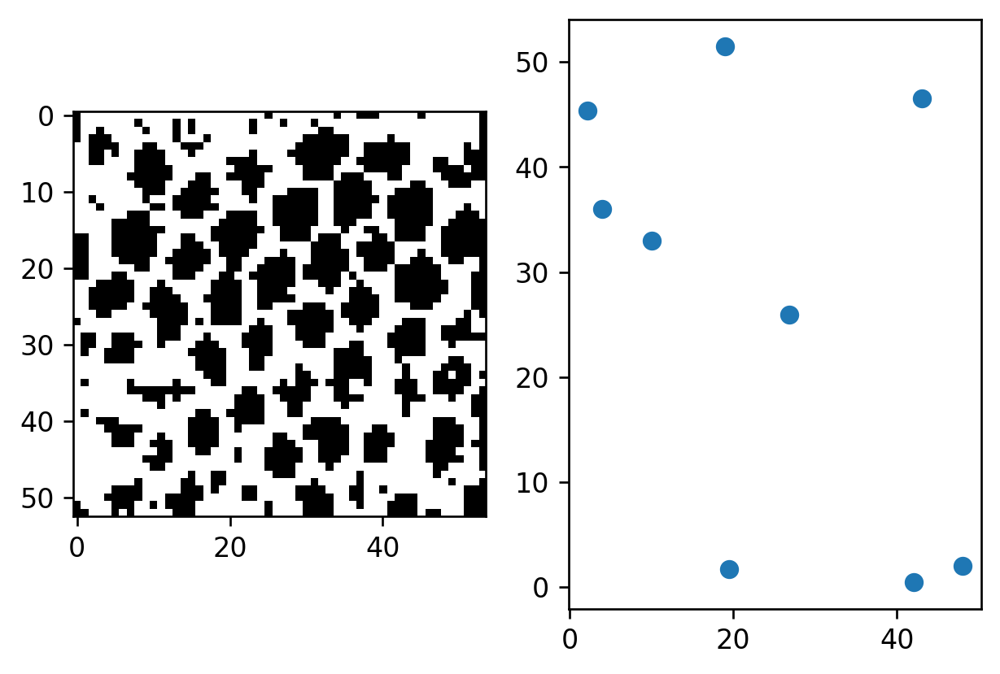

8.050519248319484
[13.247185549746275, 11.788686357456456, 38.59394849705544, 30.32330894793679, 14.87952149019338, 13.508109242037392, 8.164150146980093, 35.05771201458113, 33.18403487060513, 16.18748071809025, 12.746441756514944, 24.80004552076293, 21.877605217060104, 20.192345720523914, 14.560798841985976, 28.288336581696708, 25.431268876596498, 13.746509506116112, 18.16865025988747, 20.036766799060448, 17.991187607382184, 20.61919199254177, 17.52946404688742, 23.650964529758063, 33.13024238183553, 23.512965005384242, 12.077355838693652, 22.216533423607974, 20.829649449359014, 13.932074361236582, 28.857166210694057, 10.20182998137205, 22.69888857400598, 26.744881502769154, 22.922268368246108, 10.49047800312395, 11.00199463333826, 21.195836836180682, 11.261284629393991, 11.712749163217508, 17.304951712625304, 7.640252376561329, 13.314683225302222, 26.30609705419583, 14.810963174780056]
[9.570454660866675, 16.196749921268434, 23.24440056960923, 15.479265932507946, 14.831722694940897, 

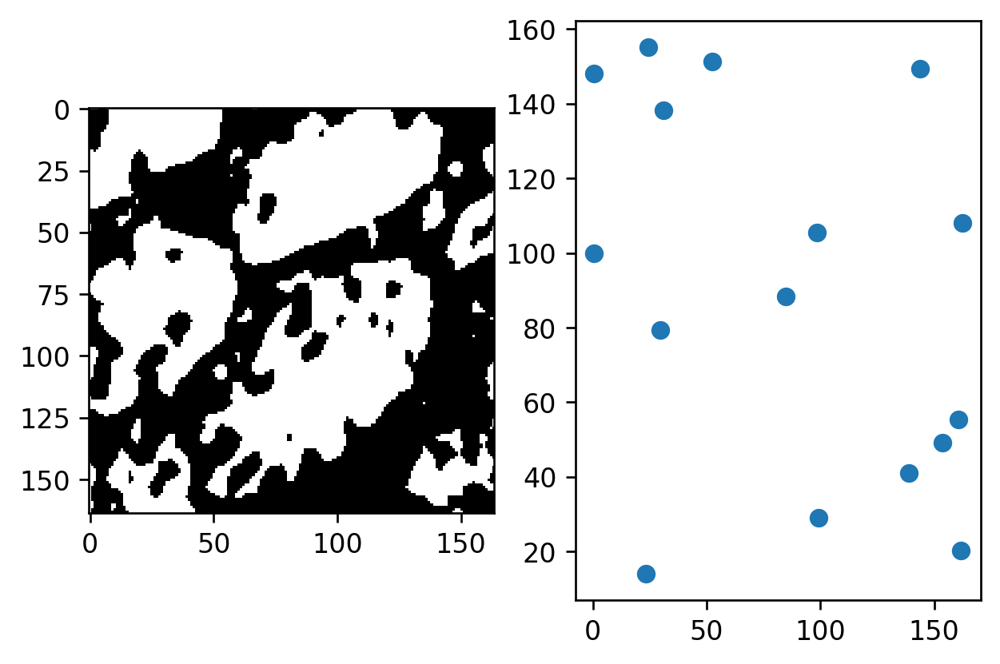

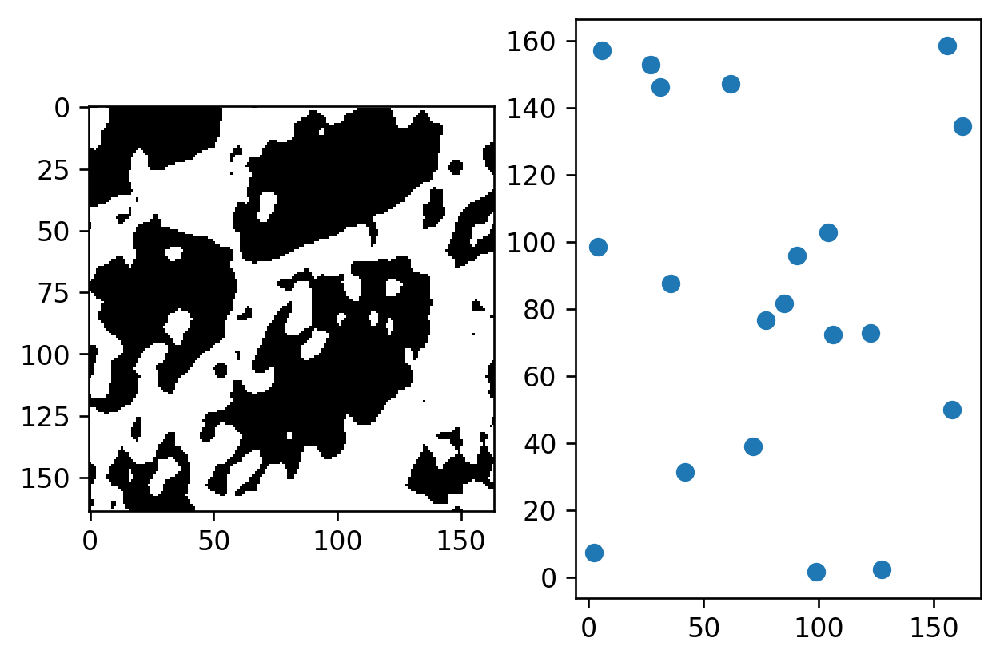

14.592062357188894
[13.247185549746275, 11.788686357456456, 38.59394849705544, 30.32330894793679, 14.87952149019338, 13.508109242037392, 8.164150146980093, 35.05771201458113, 33.18403487060513, 16.18748071809025, 12.746441756514944, 24.80004552076293, 21.877605217060104, 20.192345720523914, 14.560798841985976, 28.288336581696708, 25.431268876596498, 13.746509506116112, 18.16865025988747, 20.036766799060448, 17.991187607382184, 20.61919199254177, 17.52946404688742, 23.650964529758063, 33.13024238183553, 23.512965005384242, 12.077355838693652, 22.216533423607974, 20.829649449359014, 13.932074361236582, 28.857166210694057, 10.20182998137205, 22.69888857400598, 26.744881502769154, 22.922268368246108, 10.49047800312395, 11.00199463333826, 21.195836836180682, 11.261284629393991, 11.712749163217508, 17.304951712625304, 7.640252376561329, 13.314683225302222, 26.30609705419583, 14.810963174780056, 29.09921106504406]
[9.570454660866675, 16.196749921268434, 23.24440056960923, 15.479265932507946, 

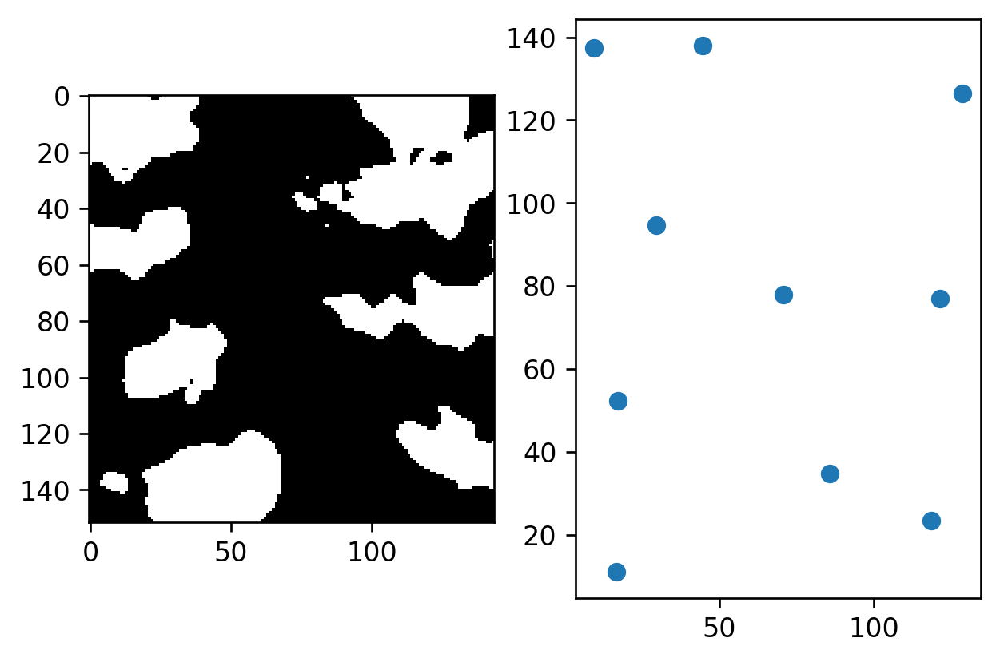

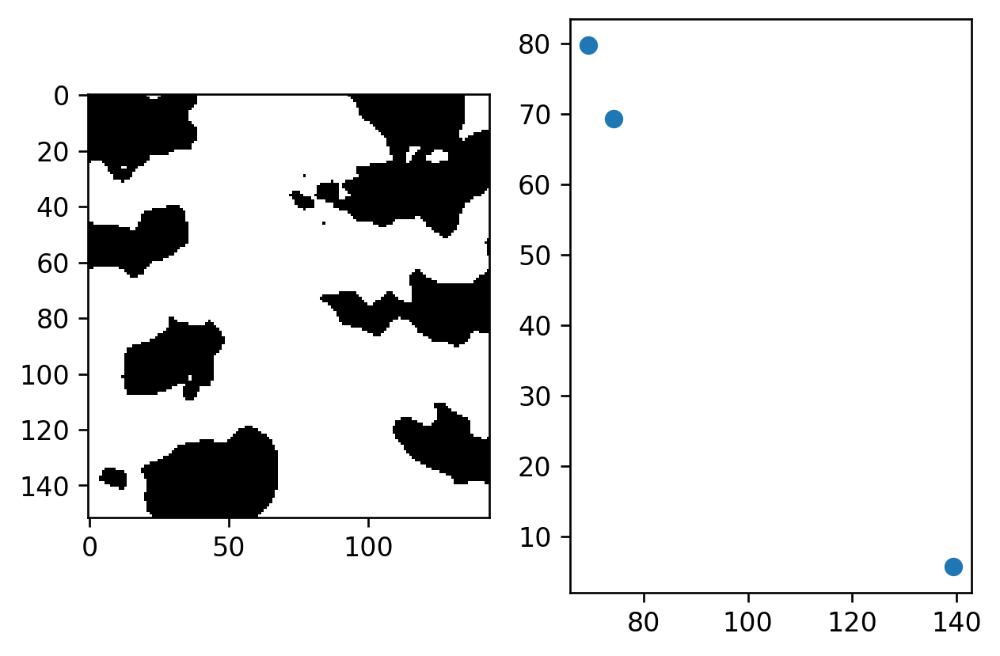

5.6606560420883465
[13.247185549746275, 11.788686357456456, 38.59394849705544, 30.32330894793679, 14.87952149019338, 13.508109242037392, 8.164150146980093, 35.05771201458113, 33.18403487060513, 16.18748071809025, 12.746441756514944, 24.80004552076293, 21.877605217060104, 20.192345720523914, 14.560798841985976, 28.288336581696708, 25.431268876596498, 13.746509506116112, 18.16865025988747, 20.036766799060448, 17.991187607382184, 20.61919199254177, 17.52946404688742, 23.650964529758063, 33.13024238183553, 23.512965005384242, 12.077355838693652, 22.216533423607974, 20.829649449359014, 13.932074361236582, 28.857166210694057, 10.20182998137205, 22.69888857400598, 26.744881502769154, 22.922268368246108, 10.49047800312395, 11.00199463333826, 21.195836836180682, 11.261284629393991, 11.712749163217508, 17.304951712625304, 7.640252376561329, 13.314683225302222, 26.30609705419583, 14.810963174780056, 29.09921106504406, 41.055670133584115]
[9.570454660866675, 16.196749921268434, 23.24440056960923, 

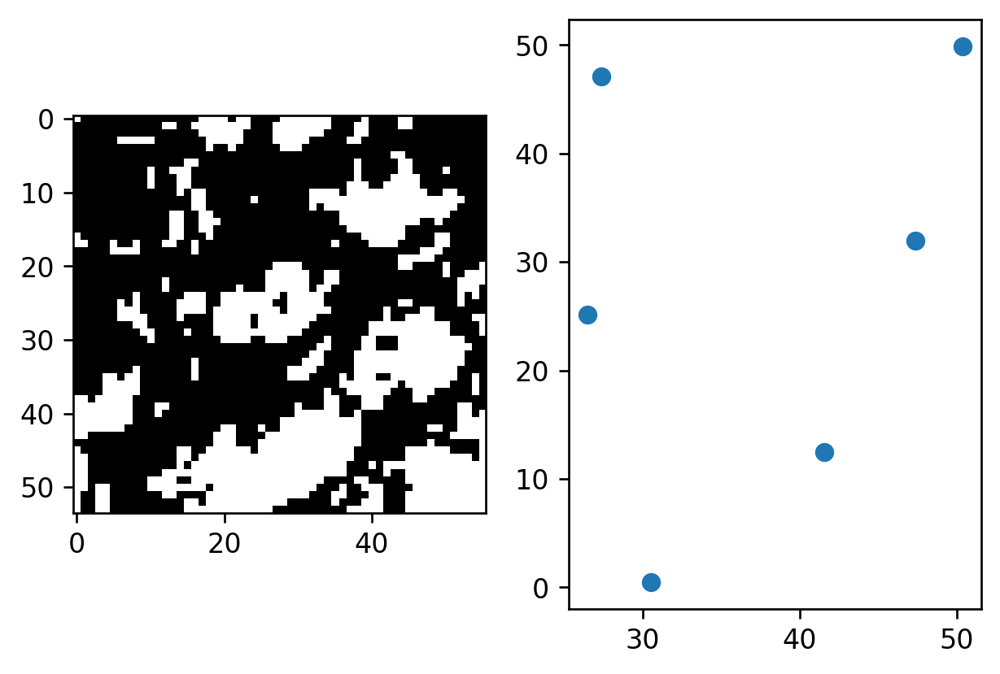

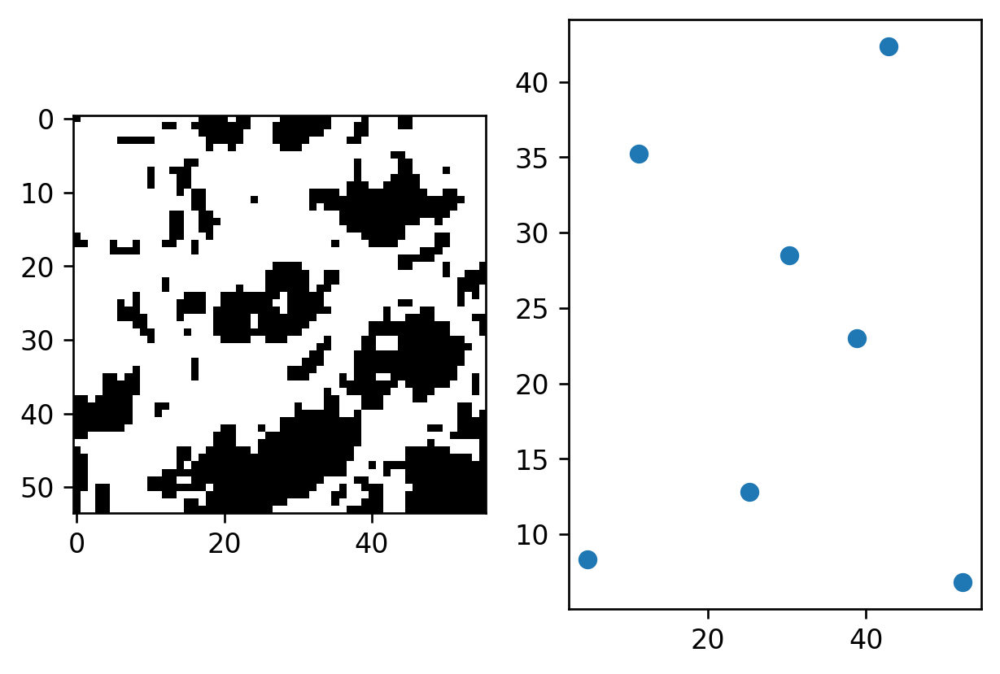

1.9899839030343176
[13.247185549746275, 11.788686357456456, 38.59394849705544, 30.32330894793679, 14.87952149019338, 13.508109242037392, 8.164150146980093, 35.05771201458113, 33.18403487060513, 16.18748071809025, 12.746441756514944, 24.80004552076293, 21.877605217060104, 20.192345720523914, 14.560798841985976, 28.288336581696708, 25.431268876596498, 13.746509506116112, 18.16865025988747, 20.036766799060448, 17.991187607382184, 20.61919199254177, 17.52946404688742, 23.650964529758063, 33.13024238183553, 23.512965005384242, 12.077355838693652, 22.216533423607974, 20.829649449359014, 13.932074361236582, 28.857166210694057, 10.20182998137205, 22.69888857400598, 26.744881502769154, 22.922268368246108, 10.49047800312395, 11.00199463333826, 21.195836836180682, 11.261284629393991, 11.712749163217508, 17.304951712625304, 7.640252376561329, 13.314683225302222, 26.30609705419583, 14.810963174780056, 29.09921106504406, 41.055670133584115, 18.440301336349126]
[9.570454660866675, 16.196749921268434,

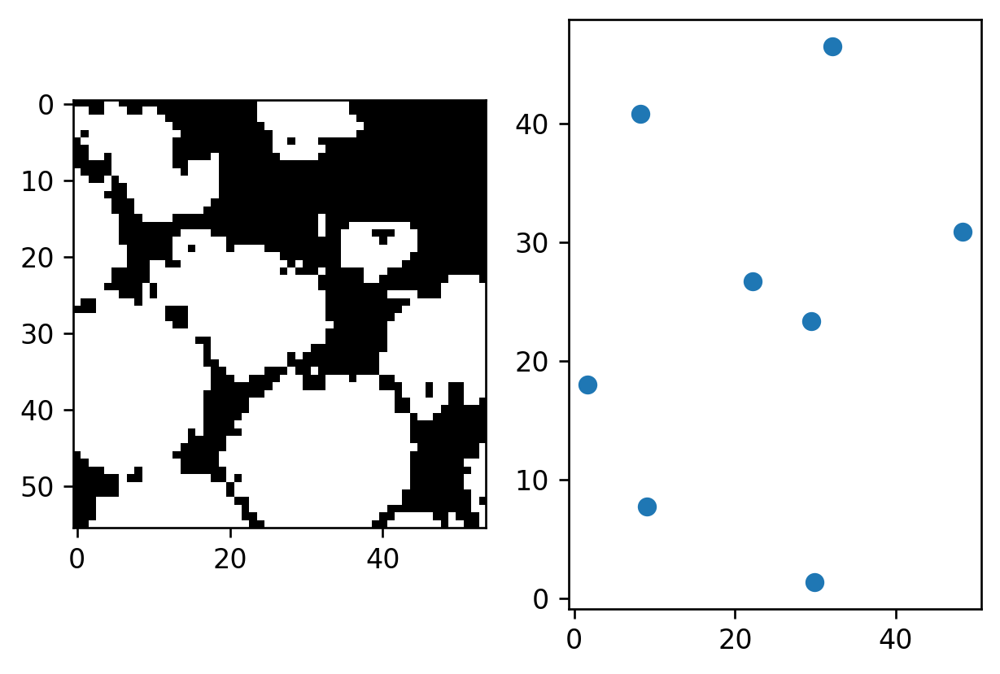

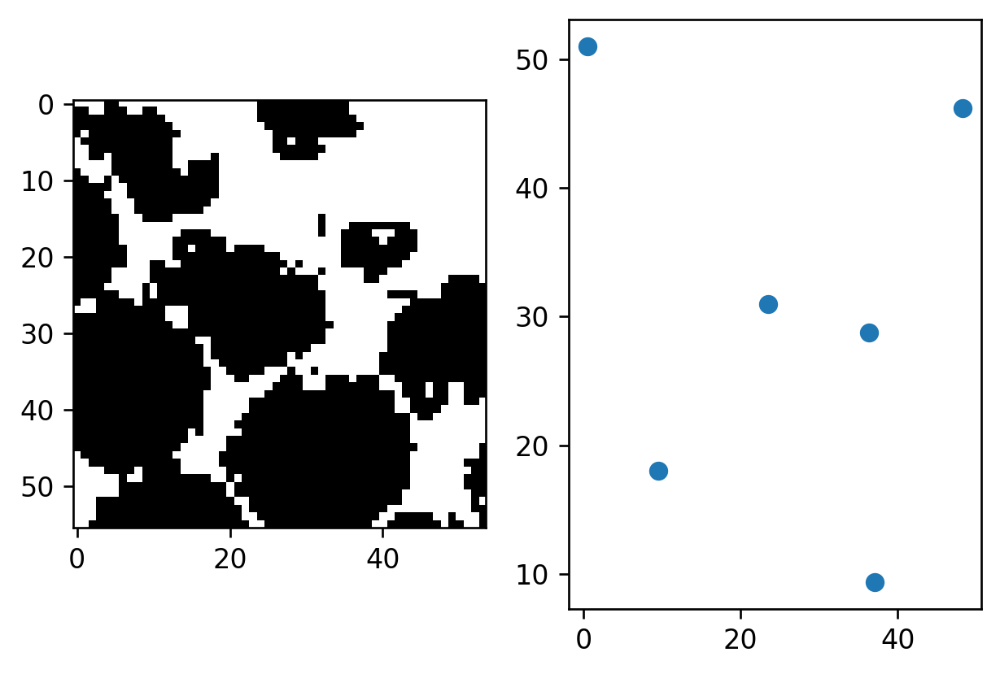

5.640950903369355
[13.247185549746275, 11.788686357456456, 38.59394849705544, 30.32330894793679, 14.87952149019338, 13.508109242037392, 8.164150146980093, 35.05771201458113, 33.18403487060513, 16.18748071809025, 12.746441756514944, 24.80004552076293, 21.877605217060104, 20.192345720523914, 14.560798841985976, 28.288336581696708, 25.431268876596498, 13.746509506116112, 18.16865025988747, 20.036766799060448, 17.991187607382184, 20.61919199254177, 17.52946404688742, 23.650964529758063, 33.13024238183553, 23.512965005384242, 12.077355838693652, 22.216533423607974, 20.829649449359014, 13.932074361236582, 28.857166210694057, 10.20182998137205, 22.69888857400598, 26.744881502769154, 22.922268368246108, 10.49047800312395, 11.00199463333826, 21.195836836180682, 11.261284629393991, 11.712749163217508, 17.304951712625304, 7.640252376561329, 13.314683225302222, 26.30609705419583, 14.810963174780056, 29.09921106504406, 41.055670133584115, 18.440301336349126, 15.658015666574249]
[9.570454660866675, 

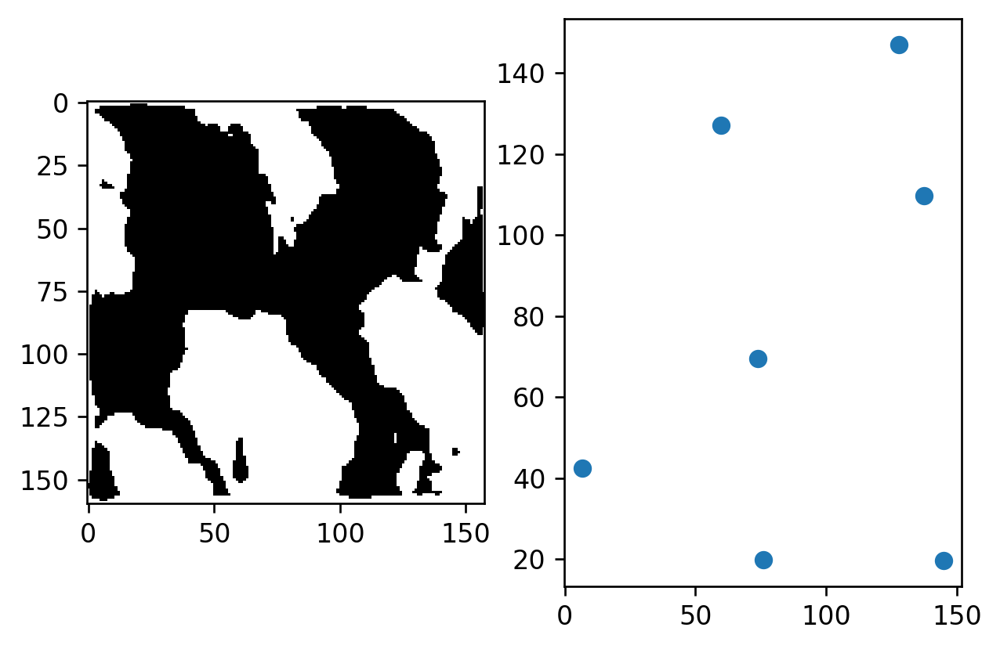

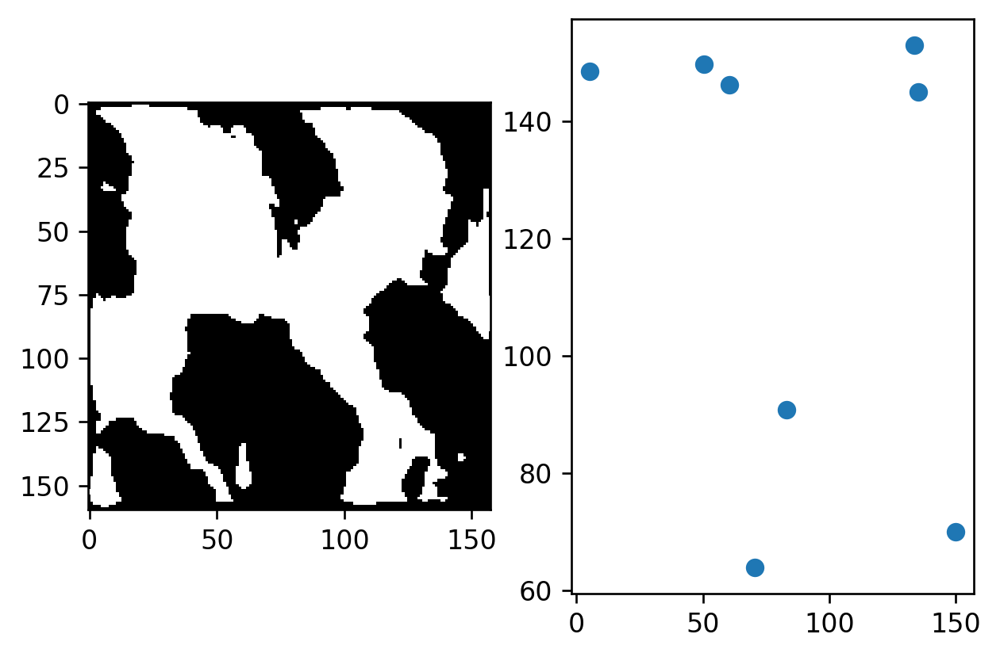

12.553121518263476
[13.247185549746275, 11.788686357456456, 38.59394849705544, 30.32330894793679, 14.87952149019338, 13.508109242037392, 8.164150146980093, 35.05771201458113, 33.18403487060513, 16.18748071809025, 12.746441756514944, 24.80004552076293, 21.877605217060104, 20.192345720523914, 14.560798841985976, 28.288336581696708, 25.431268876596498, 13.746509506116112, 18.16865025988747, 20.036766799060448, 17.991187607382184, 20.61919199254177, 17.52946404688742, 23.650964529758063, 33.13024238183553, 23.512965005384242, 12.077355838693652, 22.216533423607974, 20.829649449359014, 13.932074361236582, 28.857166210694057, 10.20182998137205, 22.69888857400598, 26.744881502769154, 22.922268368246108, 10.49047800312395, 11.00199463333826, 21.195836836180682, 11.261284629393991, 11.712749163217508, 17.304951712625304, 7.640252376561329, 13.314683225302222, 26.30609705419583, 14.810963174780056, 29.09921106504406, 41.055670133584115, 18.440301336349126, 15.658015666574249, 53.922896452655344]

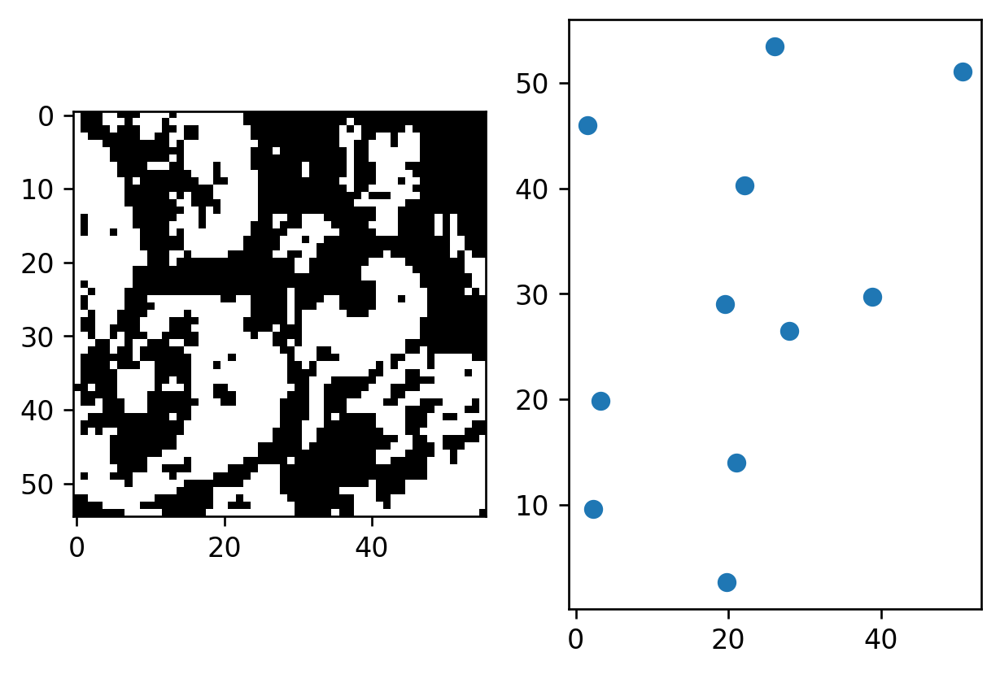

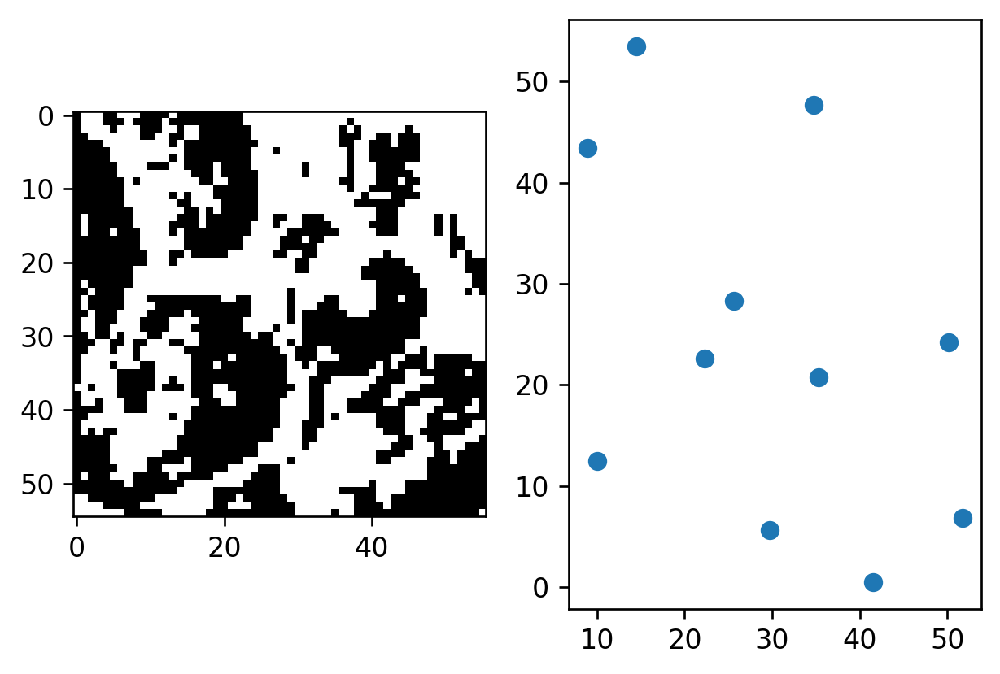

4.885173568002056
[13.247185549746275, 11.788686357456456, 38.59394849705544, 30.32330894793679, 14.87952149019338, 13.508109242037392, 8.164150146980093, 35.05771201458113, 33.18403487060513, 16.18748071809025, 12.746441756514944, 24.80004552076293, 21.877605217060104, 20.192345720523914, 14.560798841985976, 28.288336581696708, 25.431268876596498, 13.746509506116112, 18.16865025988747, 20.036766799060448, 17.991187607382184, 20.61919199254177, 17.52946404688742, 23.650964529758063, 33.13024238183553, 23.512965005384242, 12.077355838693652, 22.216533423607974, 20.829649449359014, 13.932074361236582, 28.857166210694057, 10.20182998137205, 22.69888857400598, 26.744881502769154, 22.922268368246108, 10.49047800312395, 11.00199463333826, 21.195836836180682, 11.261284629393991, 11.712749163217508, 17.304951712625304, 7.640252376561329, 13.314683225302222, 26.30609705419583, 14.810963174780056, 29.09921106504406, 41.055670133584115, 18.440301336349126, 15.658015666574249, 53.922896452655344, 

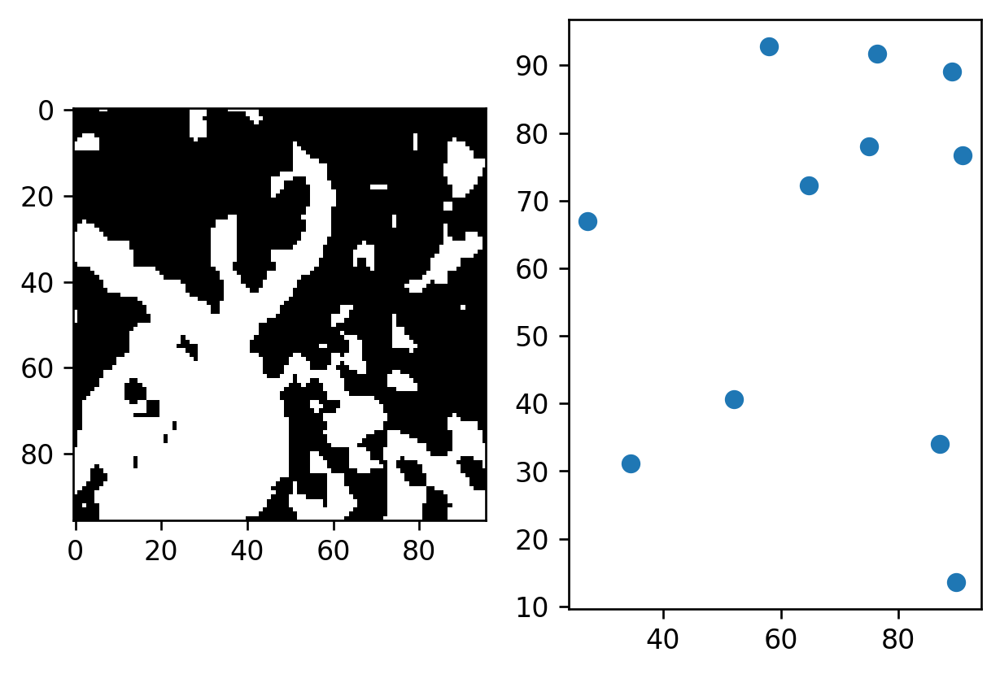

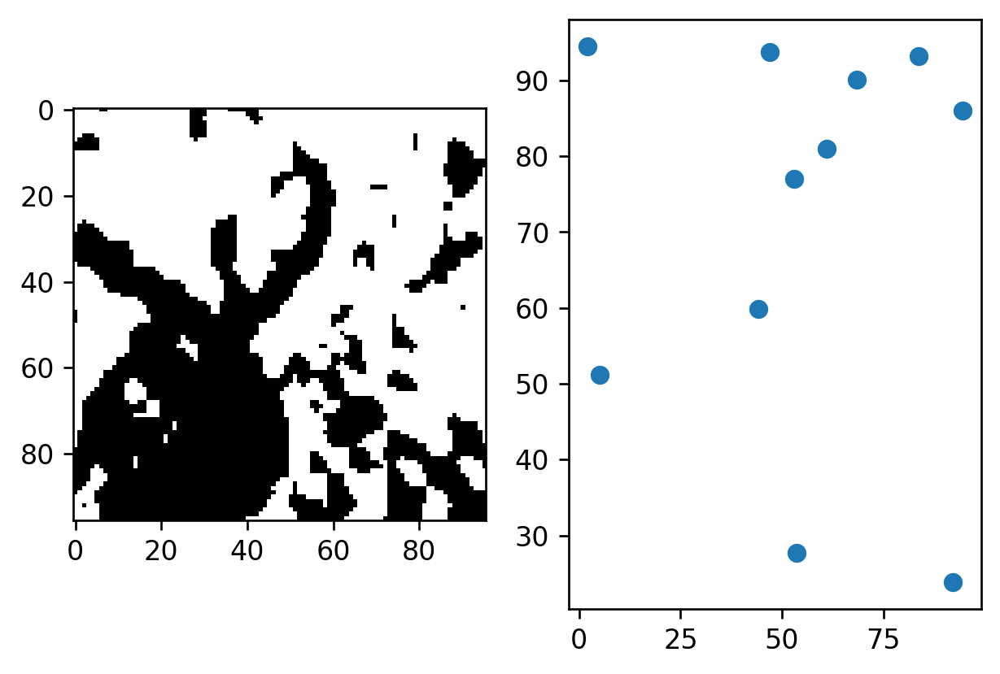

6.866238256579949
[13.247185549746275, 11.788686357456456, 38.59394849705544, 30.32330894793679, 14.87952149019338, 13.508109242037392, 8.164150146980093, 35.05771201458113, 33.18403487060513, 16.18748071809025, 12.746441756514944, 24.80004552076293, 21.877605217060104, 20.192345720523914, 14.560798841985976, 28.288336581696708, 25.431268876596498, 13.746509506116112, 18.16865025988747, 20.036766799060448, 17.991187607382184, 20.61919199254177, 17.52946404688742, 23.650964529758063, 33.13024238183553, 23.512965005384242, 12.077355838693652, 22.216533423607974, 20.829649449359014, 13.932074361236582, 28.857166210694057, 10.20182998137205, 22.69888857400598, 26.744881502769154, 22.922268368246108, 10.49047800312395, 11.00199463333826, 21.195836836180682, 11.261284629393991, 11.712749163217508, 17.304951712625304, 7.640252376561329, 13.314683225302222, 26.30609705419583, 14.810963174780056, 29.09921106504406, 41.055670133584115, 18.440301336349126, 15.658015666574249, 53.922896452655344, 

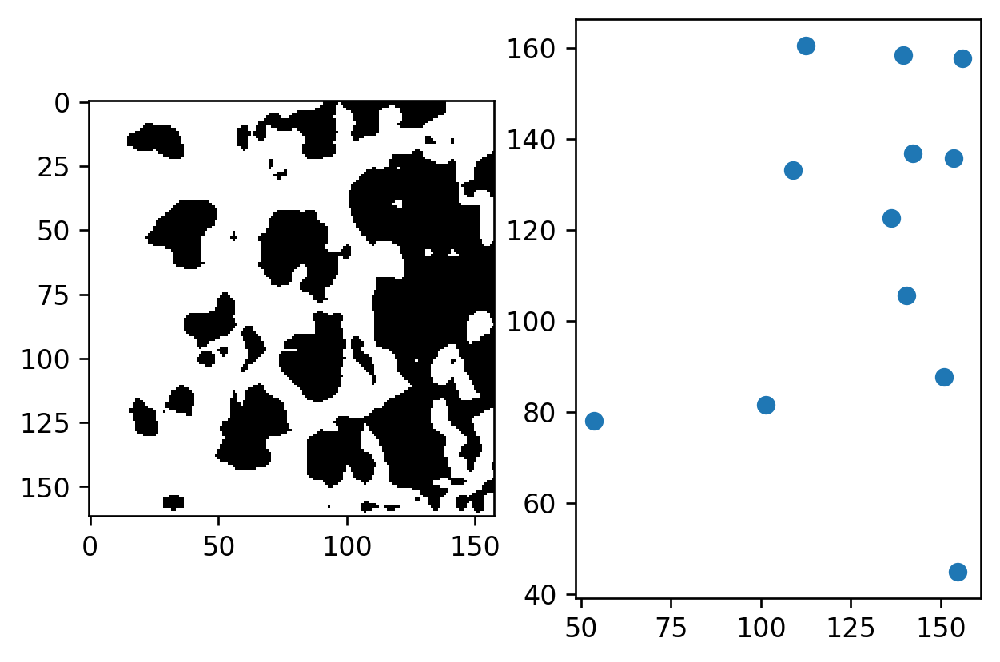

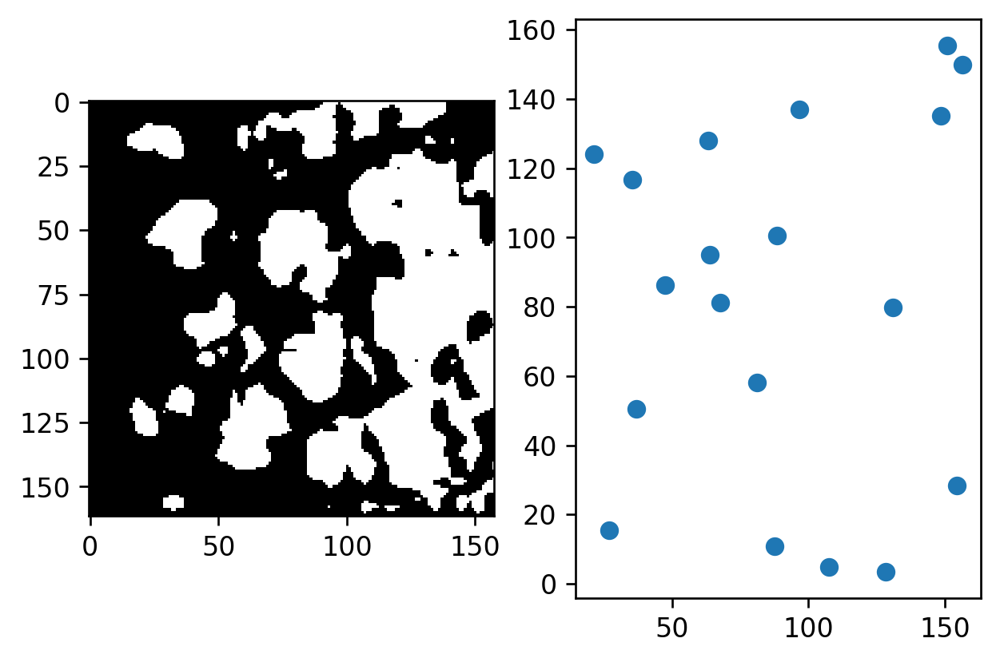

12.816001518091108
[13.247185549746275, 11.788686357456456, 38.59394849705544, 30.32330894793679, 14.87952149019338, 13.508109242037392, 8.164150146980093, 35.05771201458113, 33.18403487060513, 16.18748071809025, 12.746441756514944, 24.80004552076293, 21.877605217060104, 20.192345720523914, 14.560798841985976, 28.288336581696708, 25.431268876596498, 13.746509506116112, 18.16865025988747, 20.036766799060448, 17.991187607382184, 20.61919199254177, 17.52946404688742, 23.650964529758063, 33.13024238183553, 23.512965005384242, 12.077355838693652, 22.216533423607974, 20.829649449359014, 13.932074361236582, 28.857166210694057, 10.20182998137205, 22.69888857400598, 26.744881502769154, 22.922268368246108, 10.49047800312395, 11.00199463333826, 21.195836836180682, 11.261284629393991, 11.712749163217508, 17.304951712625304, 7.640252376561329, 13.314683225302222, 26.30609705419583, 14.810963174780056, 29.09921106504406, 41.055670133584115, 18.440301336349126, 15.658015666574249, 53.922896452655344,

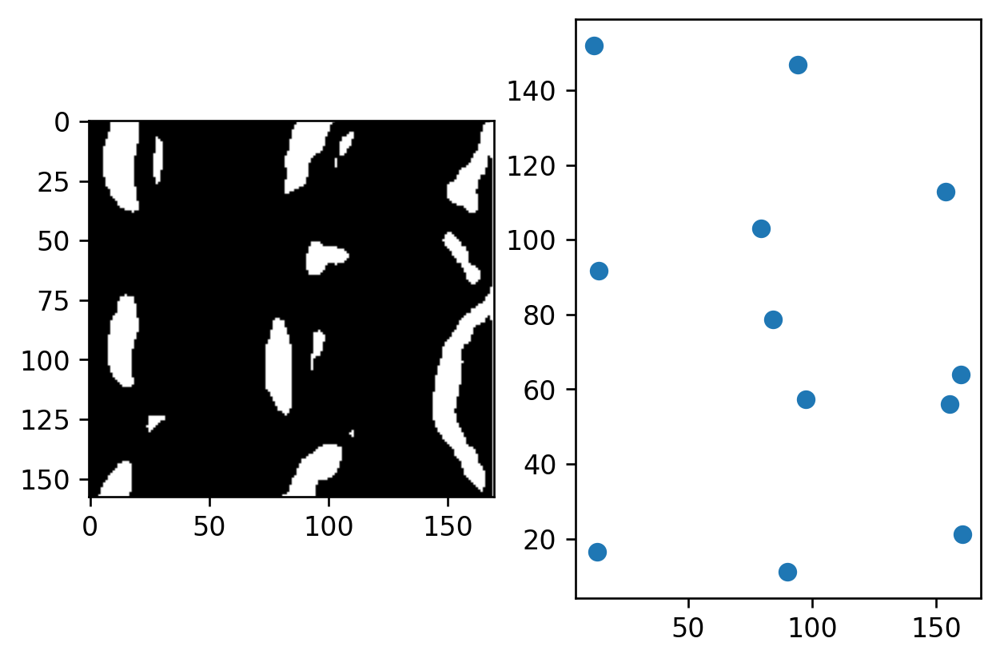

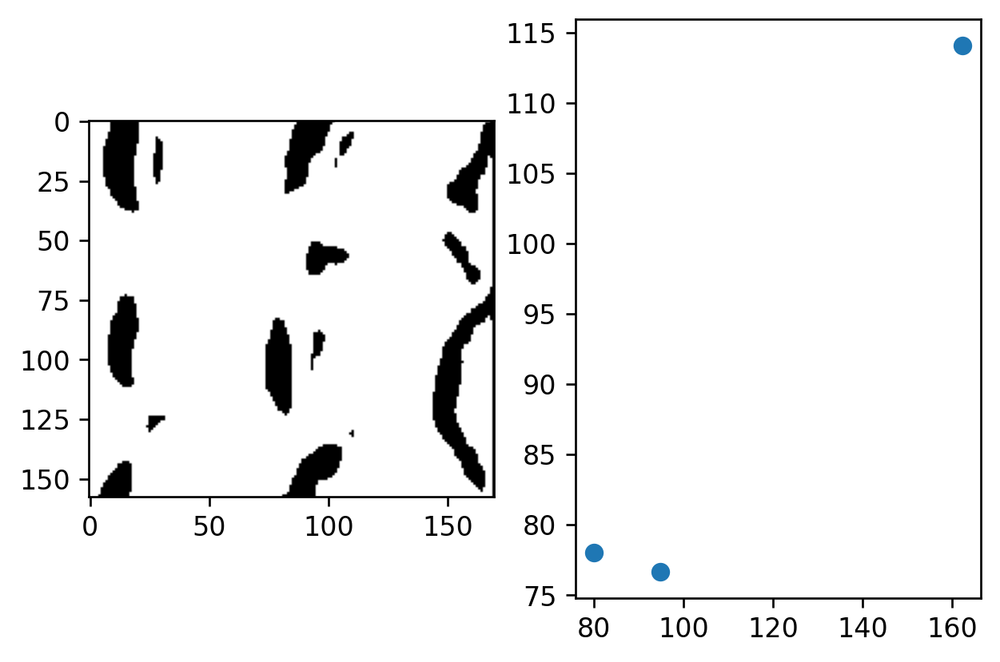

20.057914566040594
[13.247185549746275, 11.788686357456456, 38.59394849705544, 30.32330894793679, 14.87952149019338, 13.508109242037392, 8.164150146980093, 35.05771201458113, 33.18403487060513, 16.18748071809025, 12.746441756514944, 24.80004552076293, 21.877605217060104, 20.192345720523914, 14.560798841985976, 28.288336581696708, 25.431268876596498, 13.746509506116112, 18.16865025988747, 20.036766799060448, 17.991187607382184, 20.61919199254177, 17.52946404688742, 23.650964529758063, 33.13024238183553, 23.512965005384242, 12.077355838693652, 22.216533423607974, 20.829649449359014, 13.932074361236582, 28.857166210694057, 10.20182998137205, 22.69888857400598, 26.744881502769154, 22.922268368246108, 10.49047800312395, 11.00199463333826, 21.195836836180682, 11.261284629393991, 11.712749163217508, 17.304951712625304, 7.640252376561329, 13.314683225302222, 26.30609705419583, 14.810963174780056, 29.09921106504406, 41.055670133584115, 18.440301336349126, 15.658015666574249, 53.922896452655344,

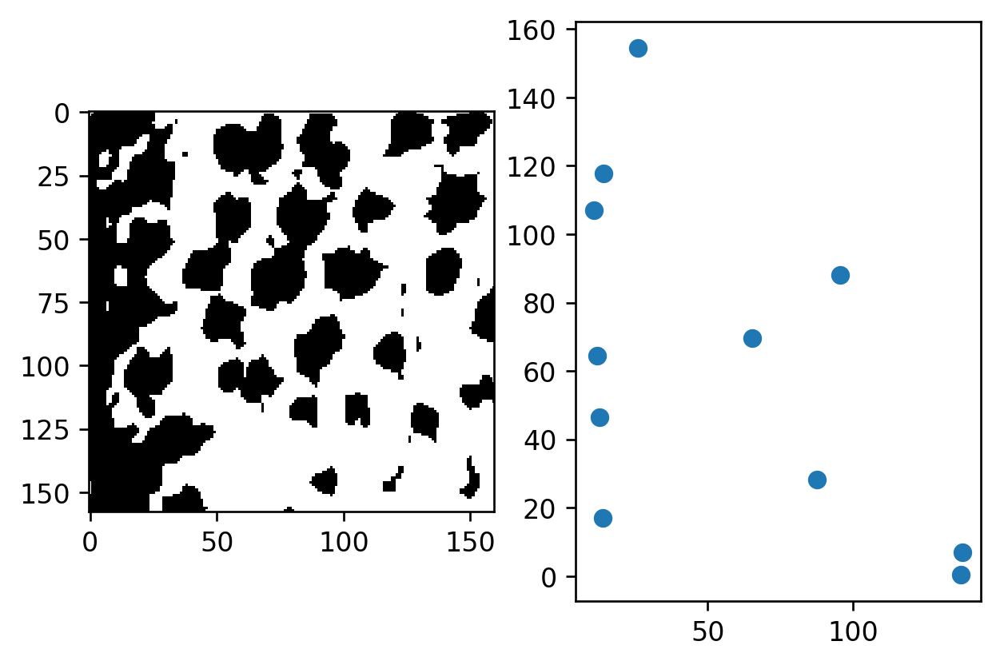

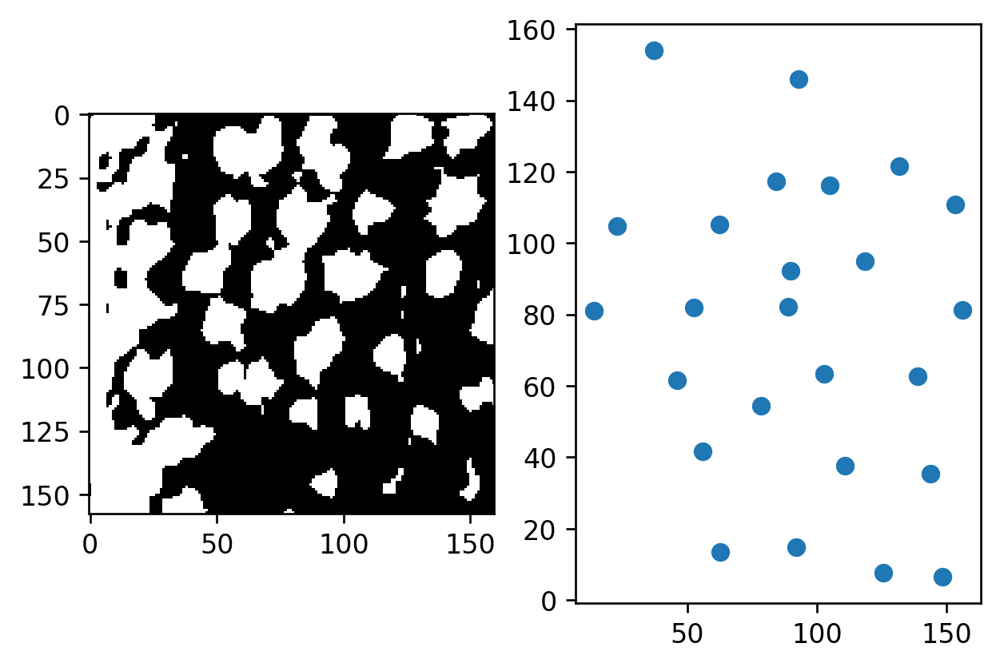

13.582468316340167
[13.247185549746275, 11.788686357456456, 38.59394849705544, 30.32330894793679, 14.87952149019338, 13.508109242037392, 8.164150146980093, 35.05771201458113, 33.18403487060513, 16.18748071809025, 12.746441756514944, 24.80004552076293, 21.877605217060104, 20.192345720523914, 14.560798841985976, 28.288336581696708, 25.431268876596498, 13.746509506116112, 18.16865025988747, 20.036766799060448, 17.991187607382184, 20.61919199254177, 17.52946404688742, 23.650964529758063, 33.13024238183553, 23.512965005384242, 12.077355838693652, 22.216533423607974, 20.829649449359014, 13.932074361236582, 28.857166210694057, 10.20182998137205, 22.69888857400598, 26.744881502769154, 22.922268368246108, 10.49047800312395, 11.00199463333826, 21.195836836180682, 11.261284629393991, 11.712749163217508, 17.304951712625304, 7.640252376561329, 13.314683225302222, 26.30609705419583, 14.810963174780056, 29.09921106504406, 41.055670133584115, 18.440301336349126, 15.658015666574249, 53.922896452655344,

In [12]:
standard_deviations = []
inverted_standard_deviations = []

def shortest_distance(n):
    min_dis = np.inf
    for i in c:
        if i[0] != n[0] and i[1] != n[1] and sum((n - i)**2)**.5 < min_dis :
             min_dis = sum((n - i)**2)**.5
                
    return min_dis
            
count = 0 

average_shortest_distance_squared = []
inverted_average_shortest_distance_squared = []

block_size = []
for i in np.arange(0, len(centers)):
    c = centers[i]
    inverted_c = inverted_centers[i]    

    
    plt.subplot(1,2,1), plt.imshow(thr_images[i], 'gray')
    plt.subplot(1,2,2), plt.scatter(c[:,0], c[:, 1])
    
    
    plt.show()
    plt.subplot(1,2,1), plt.imshow(inverted_thr_images[i], 'gray')
    plt.subplot(1,2,2), plt.scatter(inverted_c[:,0], inverted_c[:, 1])

    plt.show()
    shortest_dis = []
    inverted_shortest_dis = []

    for i in c:
        shortest_dis.append(shortest_distance(i))
    for i in inverted_c:
        inverted_shortest_dis.append(shortest_distance(i))
        
    print(np.std(shortest_dis))
    standard_deviations.append(np.std(shortest_dis))
    average_shortest_distance_squared.append(np.mean(shortest_dis))
    inverted_standard_deviations.append(np.std(inverted_shortest_dis))
    inverted_average_shortest_distance_squared.append(np.mean(inverted_shortest_dis))
    
   
    

    
    print(average_shortest_distance_squared)
    #print(np.sqrt(average_size[index]))
    print(inverted_average_shortest_distance_squared)
    #print(np.sqrt(inverted_average_size[index]))
    count = count +1

-----------SD-------------------------
55 55
55 55
[0.02294197 0.00383471 0.03253953 0.02725808 0.00328283 0.0022314
 0.0030303  0.04082875 0.01634587 0.00342793 0.02293515 0.00440771
 0.02085128 0.00280992 0.00359147 0.0020202  0.01425713 0.0271692
 0.00491293 0.00848059 0.00357582 0.0041168  0.00481424 0.00505727
 0.00290276 0.00317312 0.01746032 0.0046345  0.0053121  0.01116883
 0.00979681 0.01060698 0.00725552 0.01605704 0.00459192 0.00631772
 0.00601504 0.00422353 0.00818713 0.01503945 0.03195281 0.00320399
 0.00314465 0.0532362  0.00331936 0.02601378 0.02936667 0.01865079
 0.05328798 0.07000923 0.01201299 0.02557509 0.04736891 0.0076897
 0.04862737]


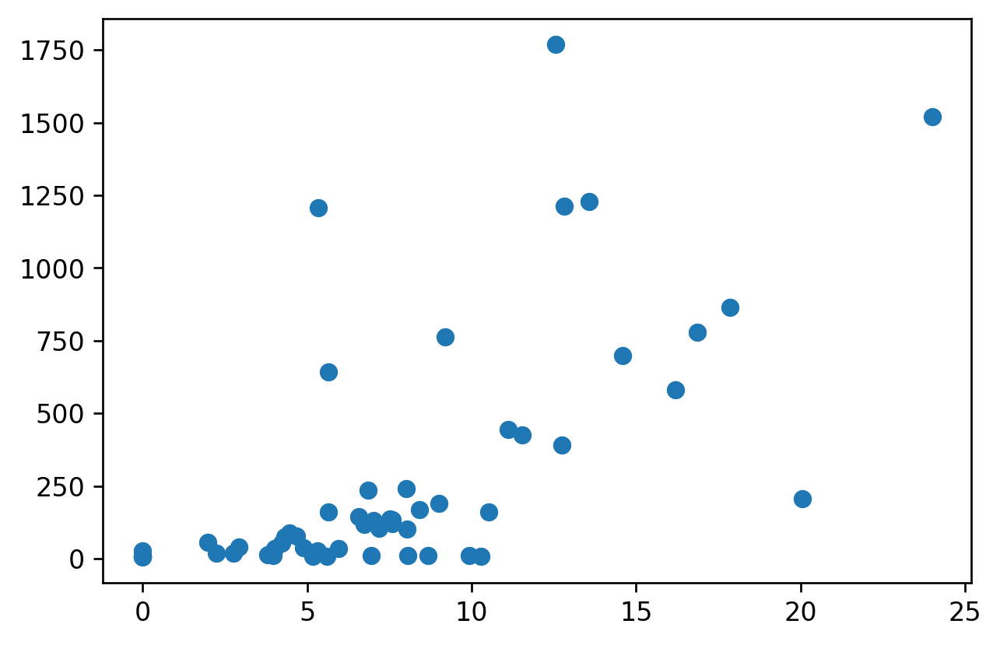

In [13]:
#print(average_size)



print("-----------SD-------------------------")

print(len(standard_deviations), len(average_sizes))
plt.scatter(standard_deviations, average_sizes)


#large average size, but huge SD indicates small scales are either being lumped together, while some small scales remain
#or that large scales are being broken apart into small scales: which is more likly?

#the ideal would be to get low SD: evenly spread out, rather than choose an arbitary value we can perhaps use machine learning
#to choose blocksize corresponding to the lowest value


#can block size be the ratio of the average size of the scale to the size of the entire image?

dimensions = []
for i in thr_images:
    dimensions.append(i.shape[0] * i.shape[1])
    
print(len(average_sizes), len(dimensions))
print(np.array(average_sizes)/np.array(dimensions))

55
[21.88075153 15.19456363 67.99207769 58.22084875 18.00202049 16.10618545
 11.16415015 69.80989591 54.27905798 19.46619998 21.53016797 28.45152924
 45.9815468  23.10782167 17.82678517 30.73782632 46.08768434 23.14186619
 30.22370415 35.59754862 28.99340468 32.23096762 28.97605263 35.31286832
 35.95866951 33.59595398 19.34371669 34.87595164 31.68914168 19.79722568
 34.05331863 16.12354145 36.49793902 46.51101415 35.93219014 14.86210369
 15.30621533 31.46322963 16.4638481  18.08979132 44.94188352 10.64025238
 16.31468323 65.29327443 17.89317018 55.55042402 66.40873263 25.95029468
 28.35222132 95.99228358 19.13105189 33.26704506 59.88793655 53.21879937
 58.49089528]
bs 23.0
it 2.0


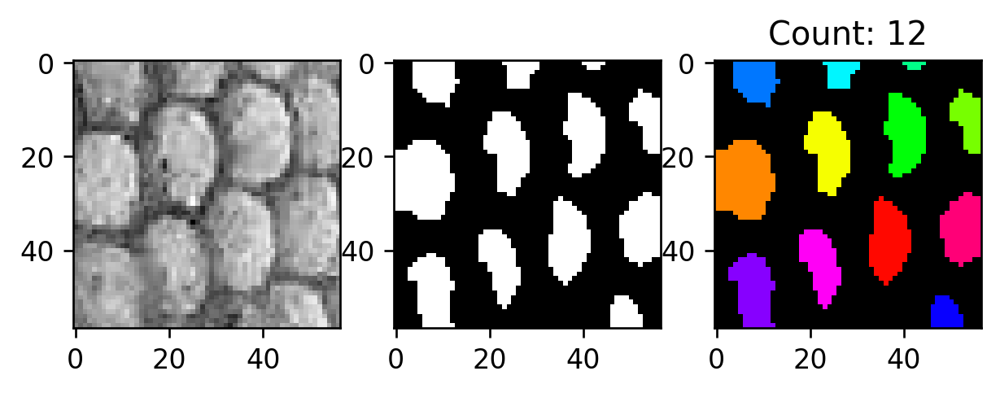

bs 15.0
it 1.0


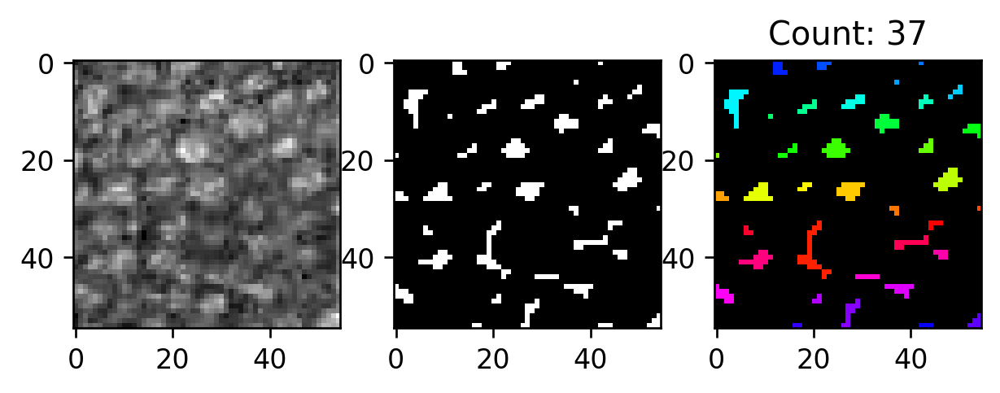

bs 69.0
it 5.0


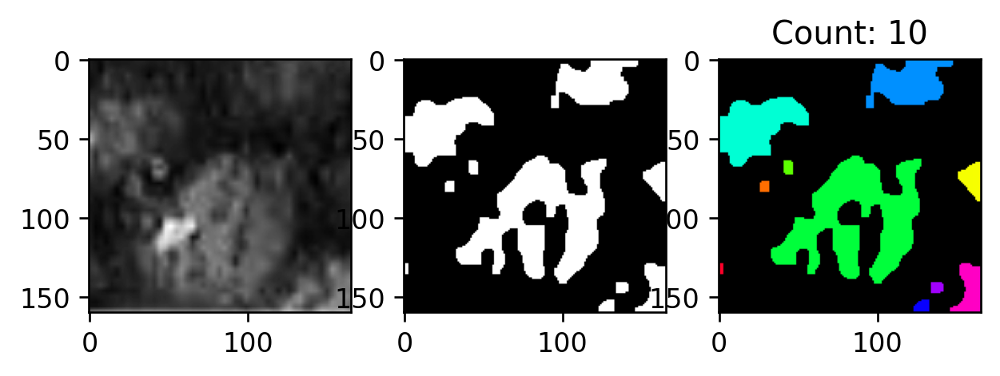

bs 59.0
it 4.0


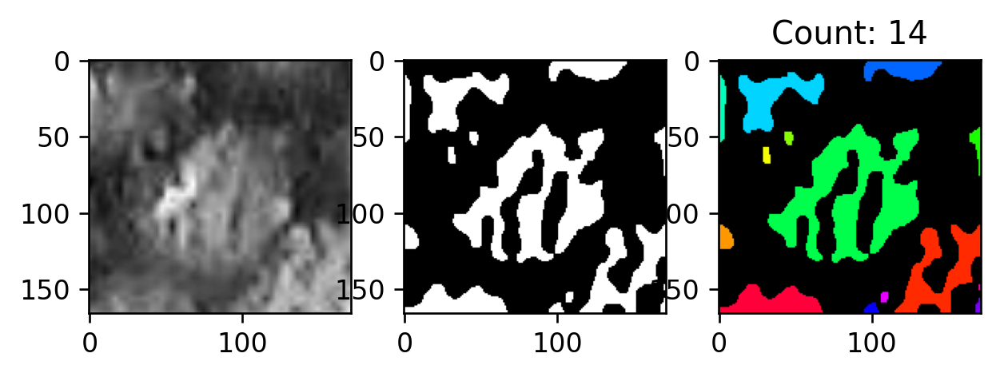

bs 19.0
it 1.0


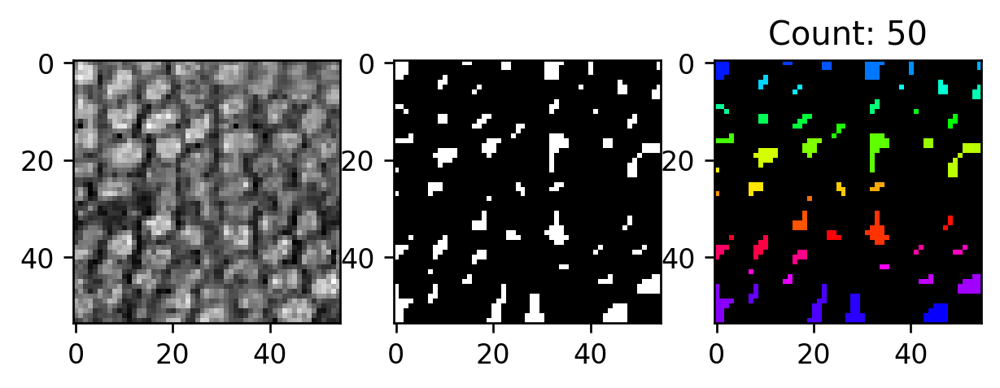

bs 17.0
it 1.0


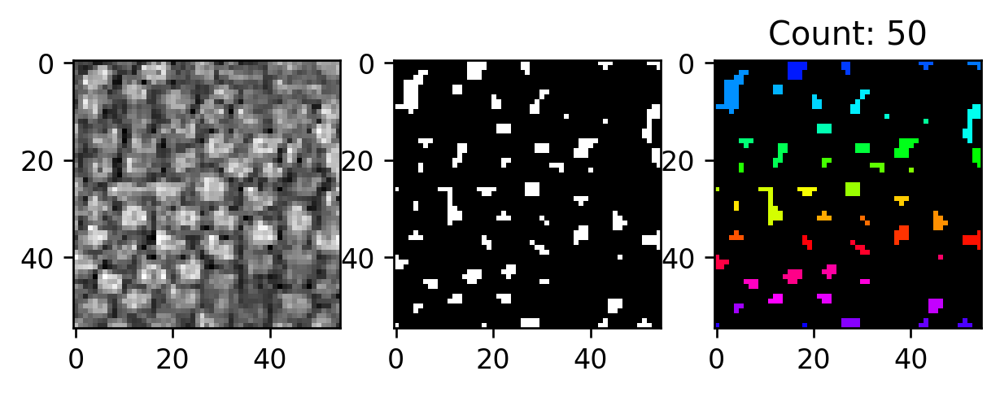

bs 11.0
it 1.0


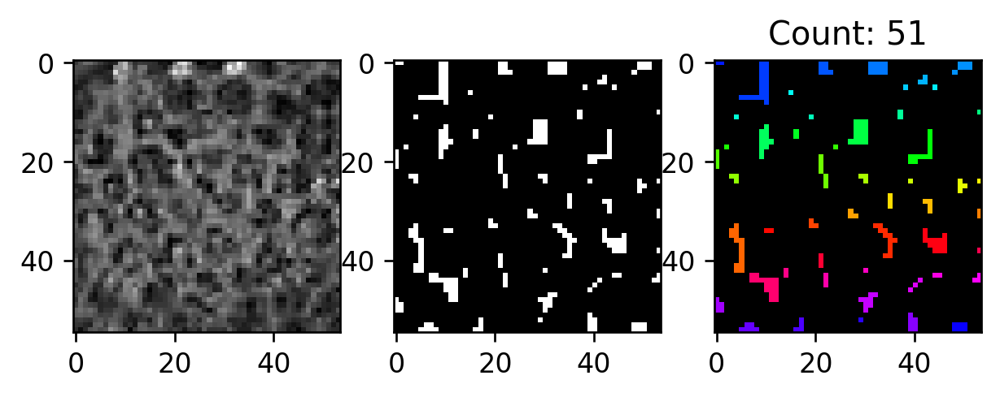

bs 71.0
it 5.0


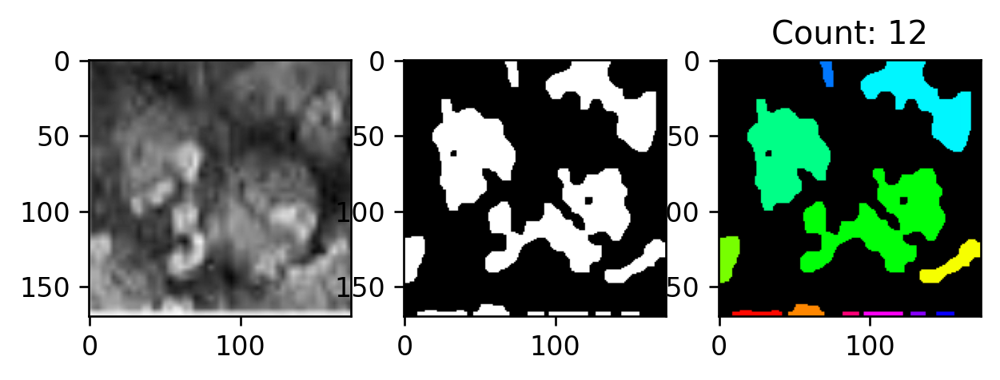

bs 55.0
it 4.0


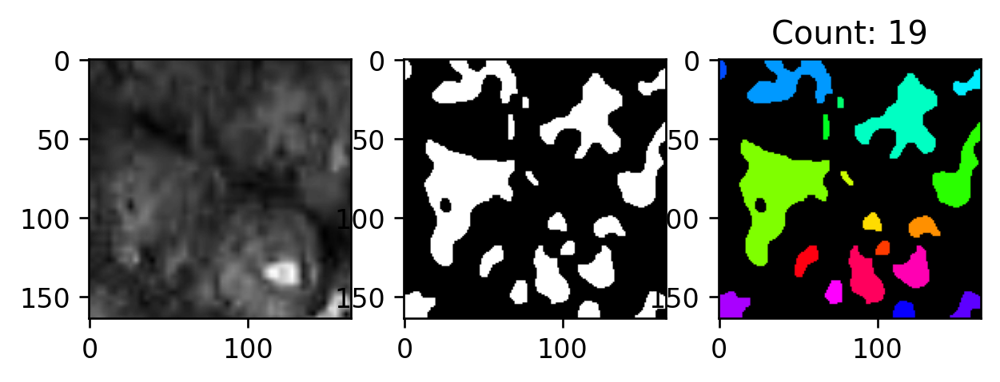

bs 19.0
it 1.0


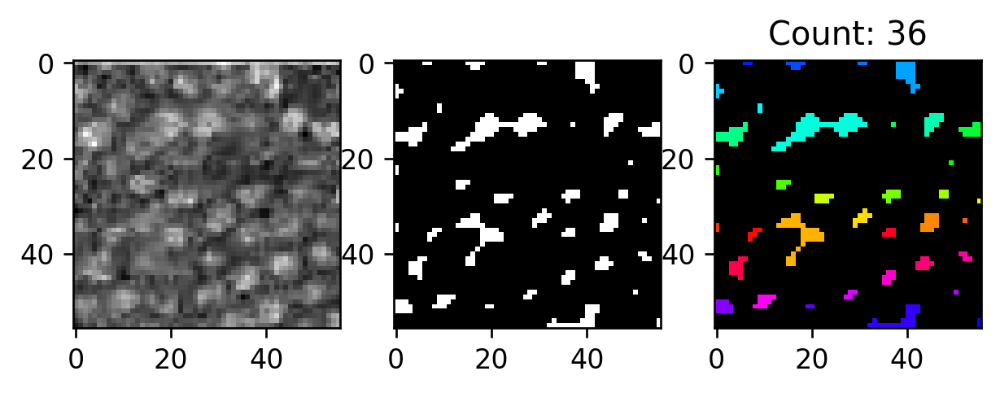

bs 23.0
it 2.0


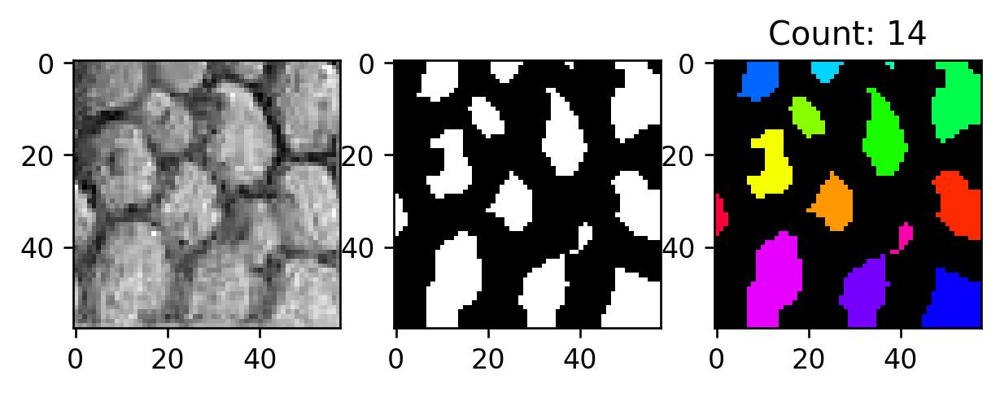

bs 29.0
it 2.0


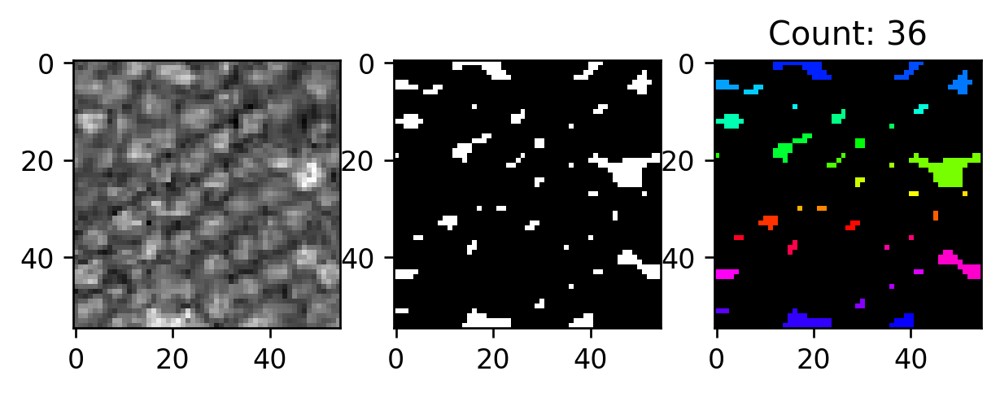

bs 47.0
it 3.0


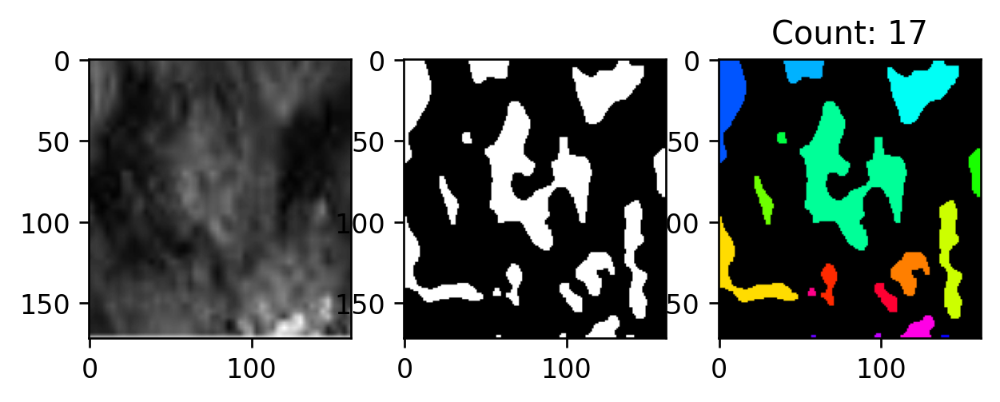

bs 23.0
it 2.0


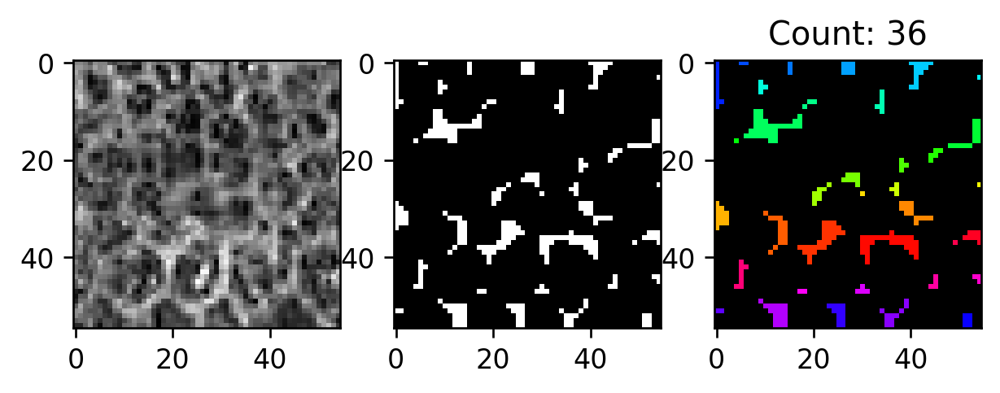

bs 19.0
it 1.0


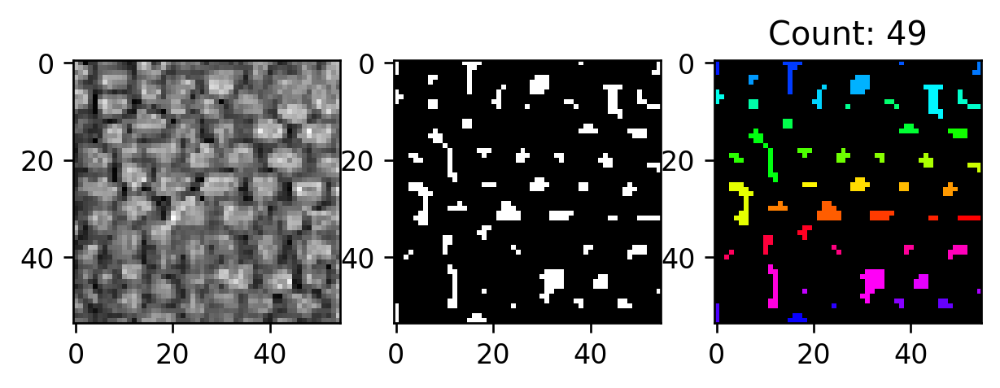

bs 31.0
it 2.0


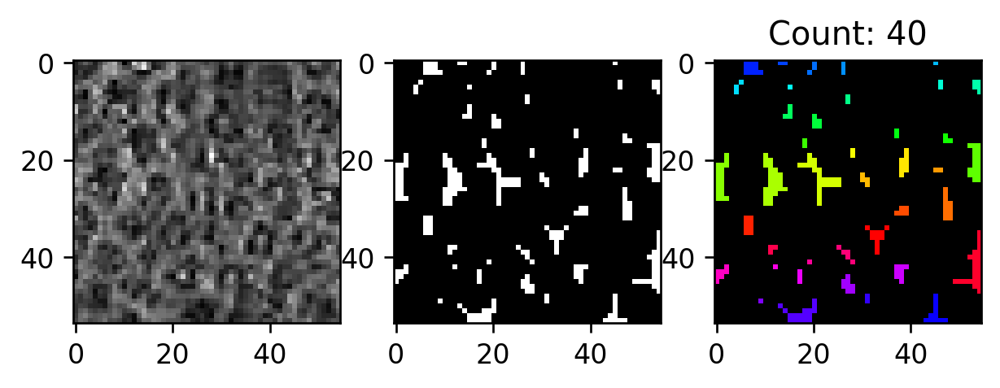

bs 47.0
it 3.0


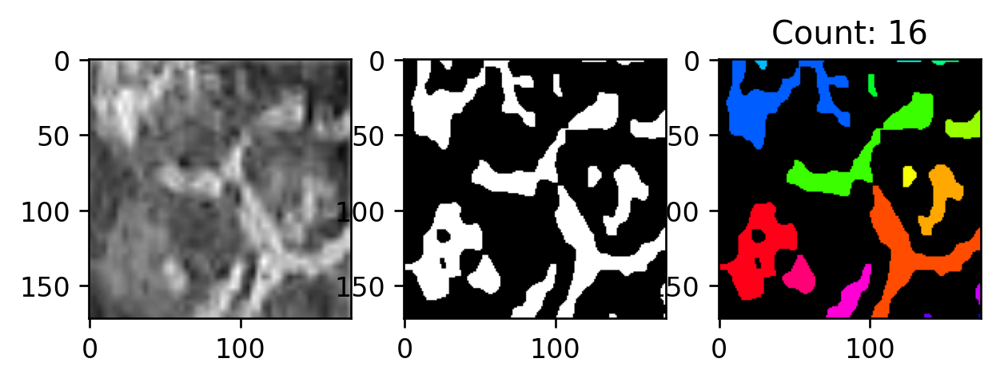

bs 23.0
it 2.0


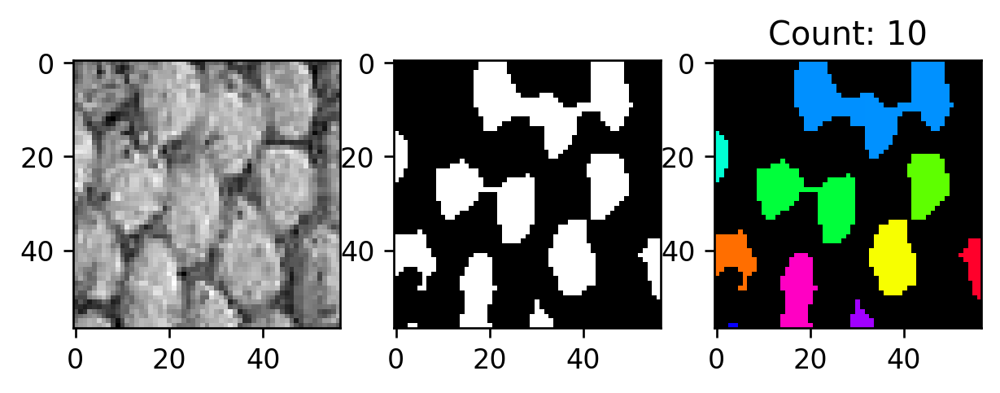

bs 31.0
it 2.0


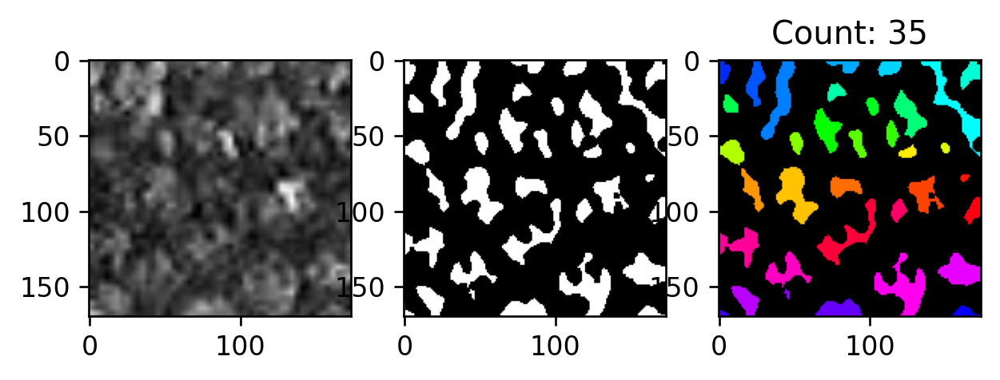

bs 37.0
it 2.0


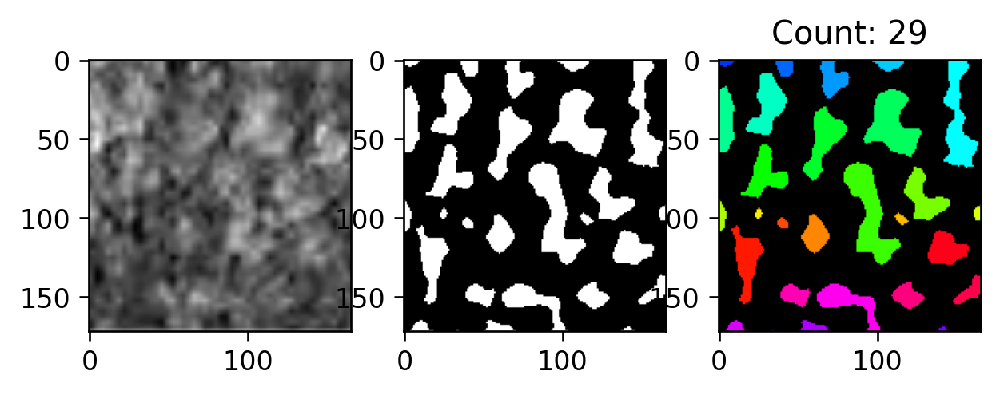

bs 29.0
it 2.0


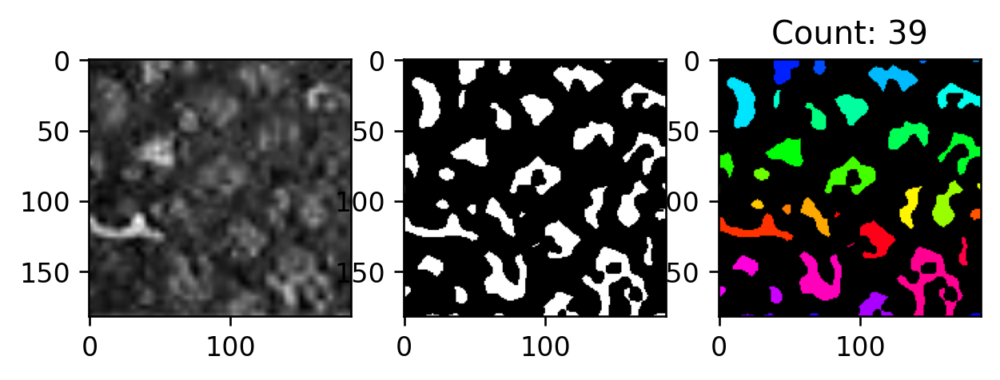

bs 33.0
it 2.0


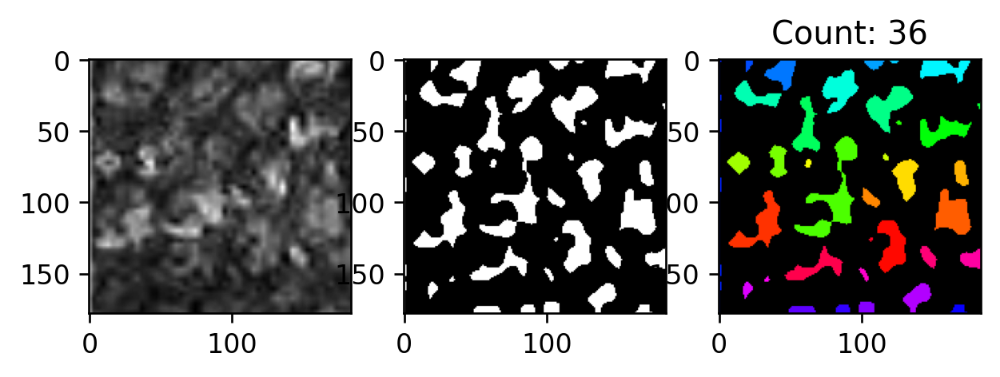

bs 29.0
it 2.0


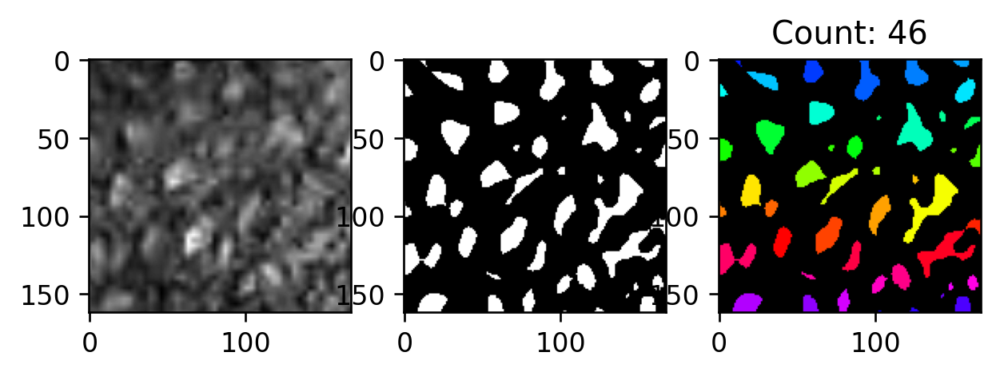

bs 35.0
it 2.0


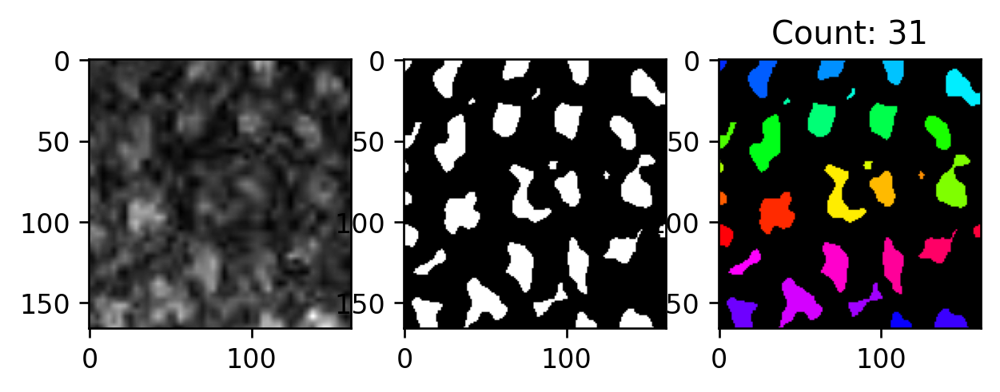

bs 37.0
it 2.0


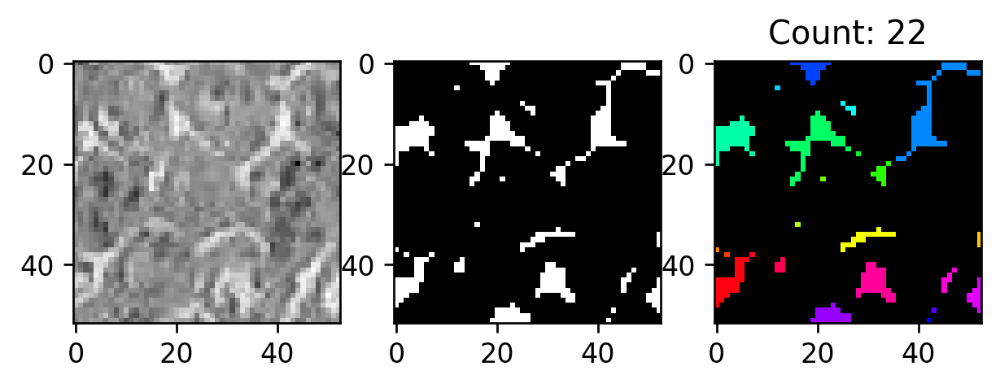

bs 35.0
it 2.0


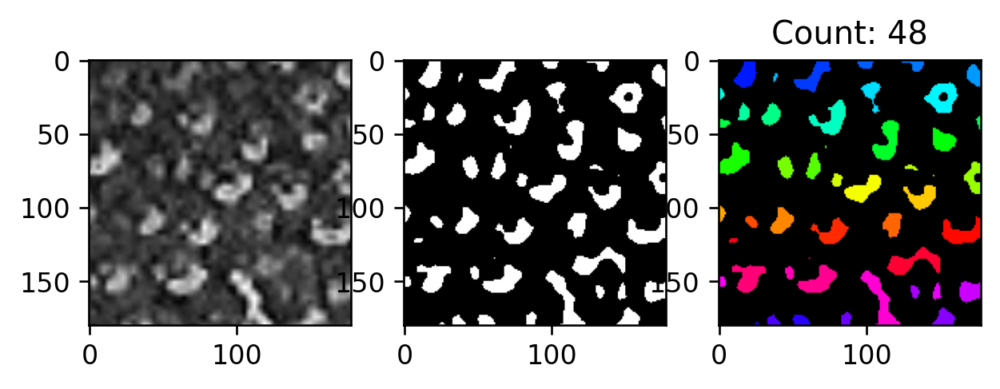

bs 19.0
it 1.0


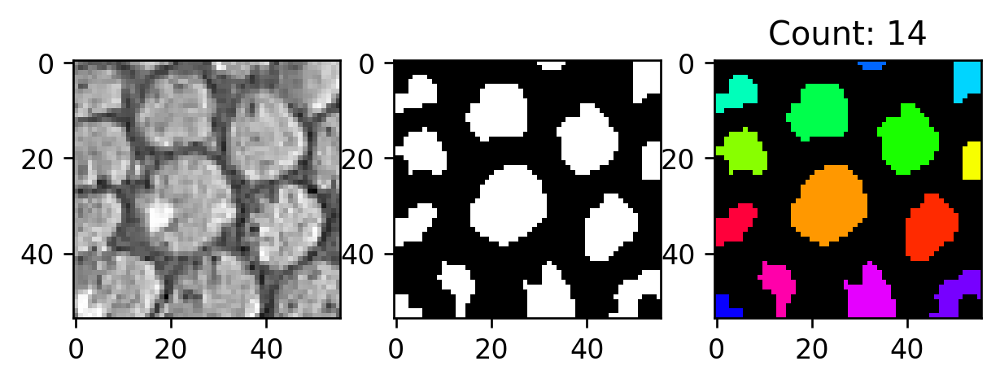

bs 35.0
it 2.0


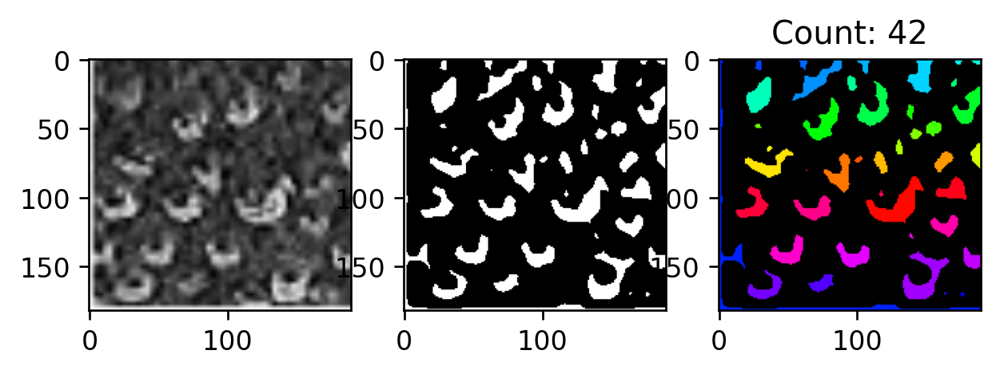

bs 33.0
it 2.0


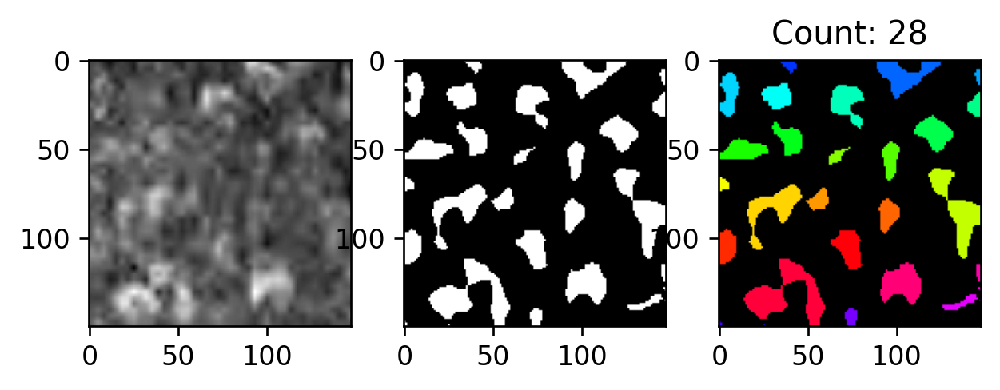

bs 21.0
it 1.0


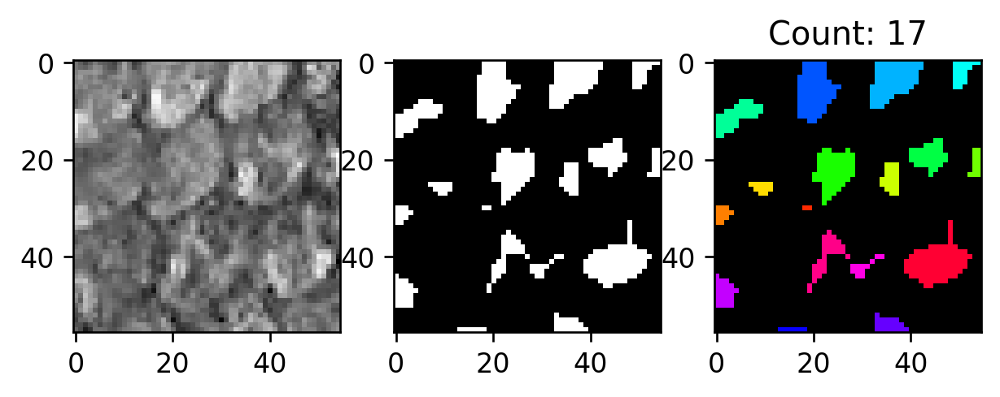

bs 35.0
it 2.0


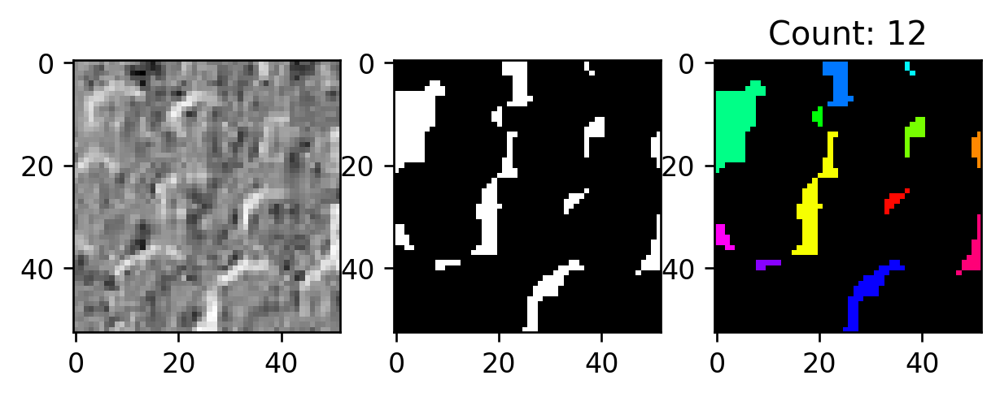

bs 17.0
it 1.0


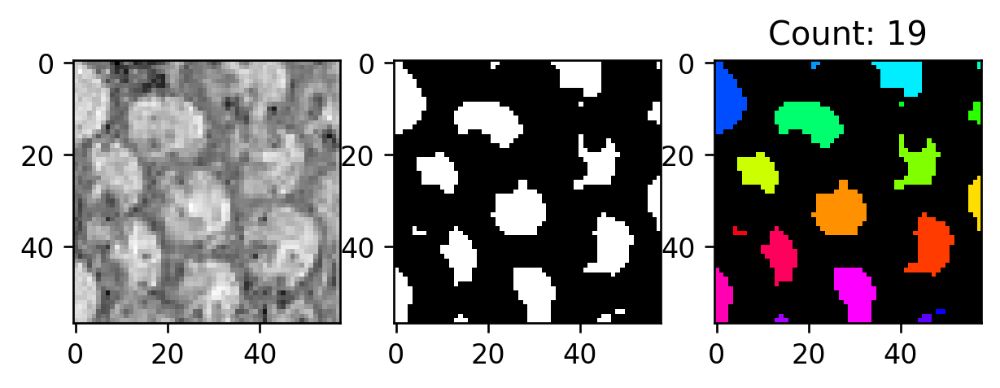

bs 37.0
it 2.0


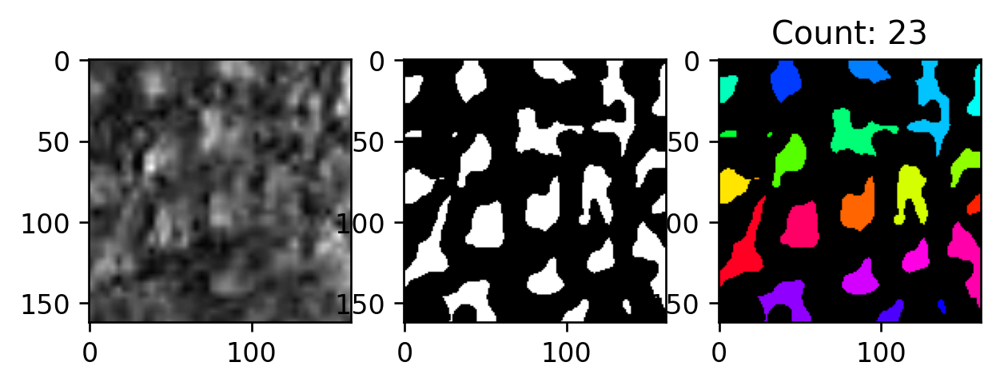

bs 47.0
it 3.0


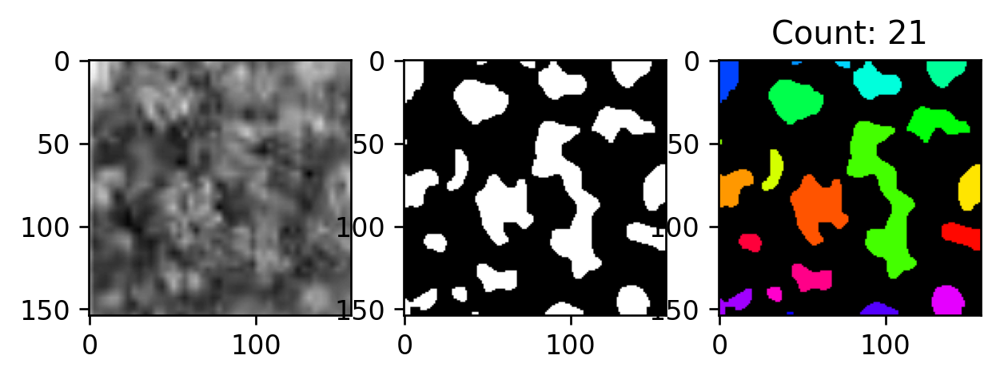

bs 37.0
it 2.0


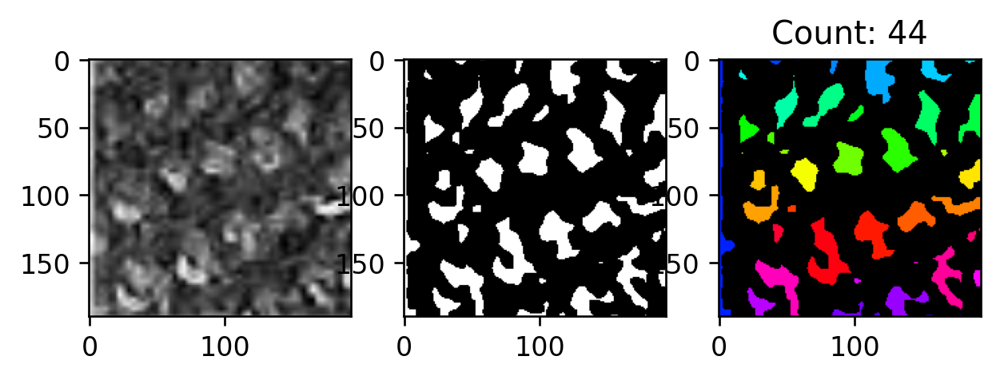

bs 15.0
it 1.0


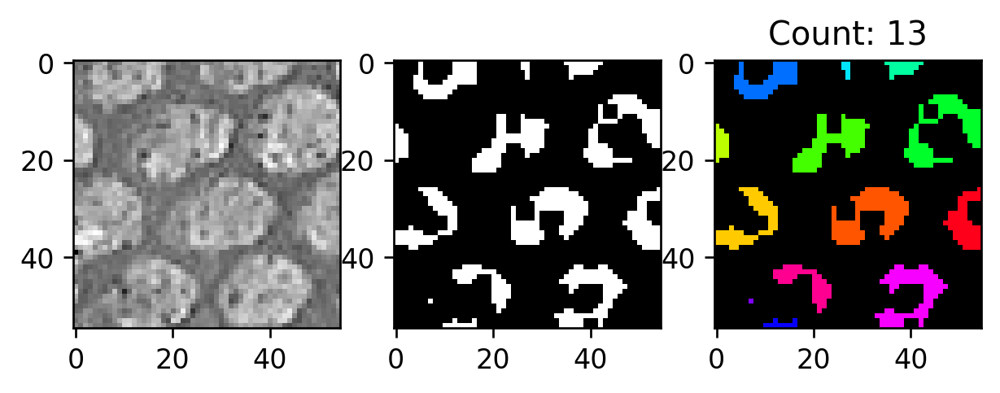

bs 15.0
it 1.0


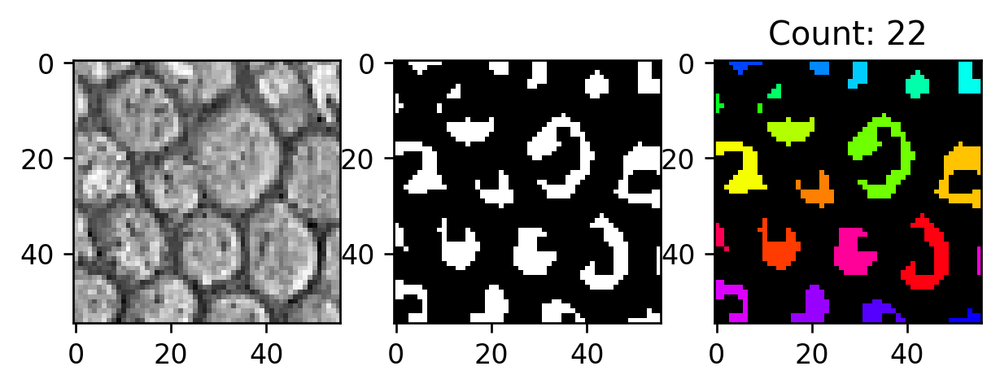

bs 31.0
it 2.0


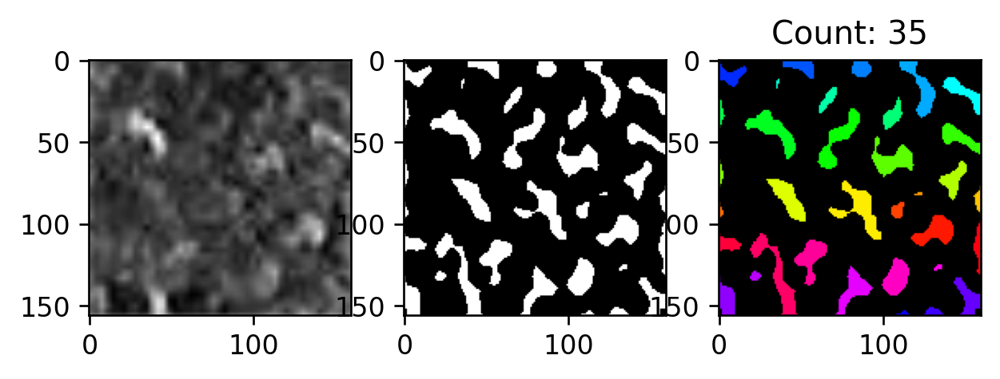

bs 17.0
it 1.0


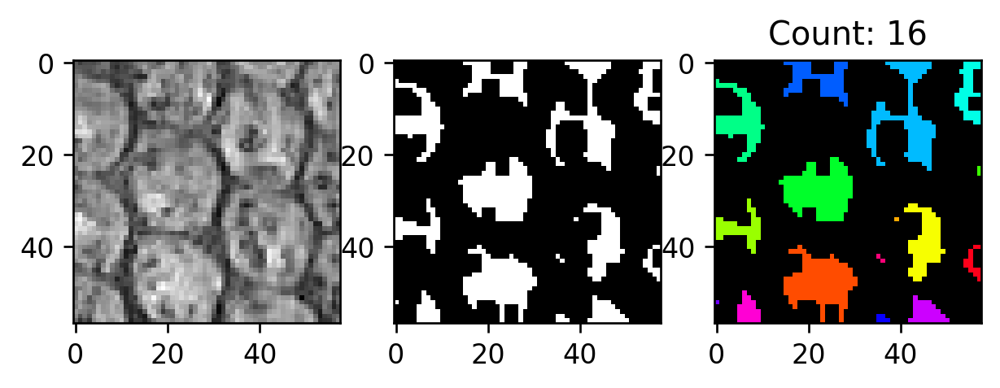

bs 19.0
it 1.0


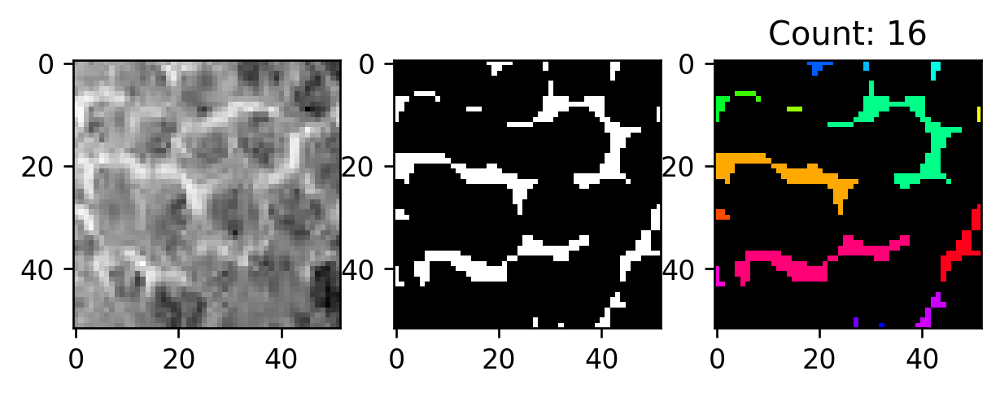

bs 45.0
it 3.0


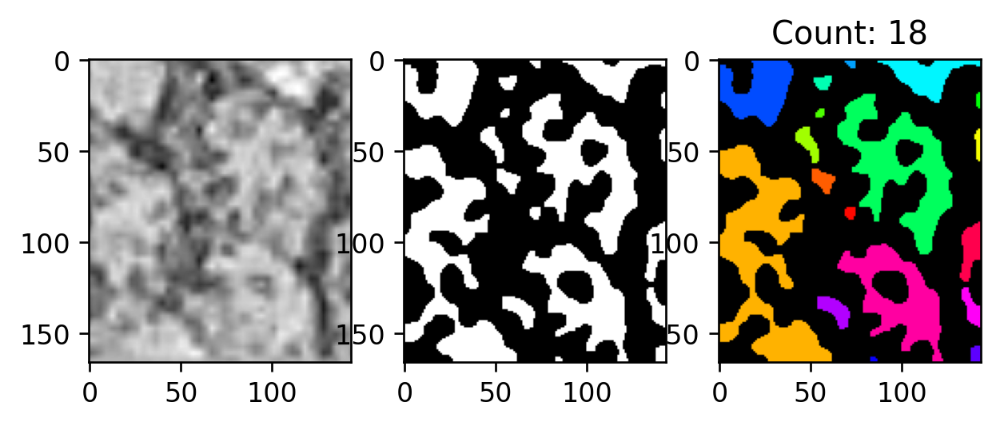

bs 11.0
it 1.0


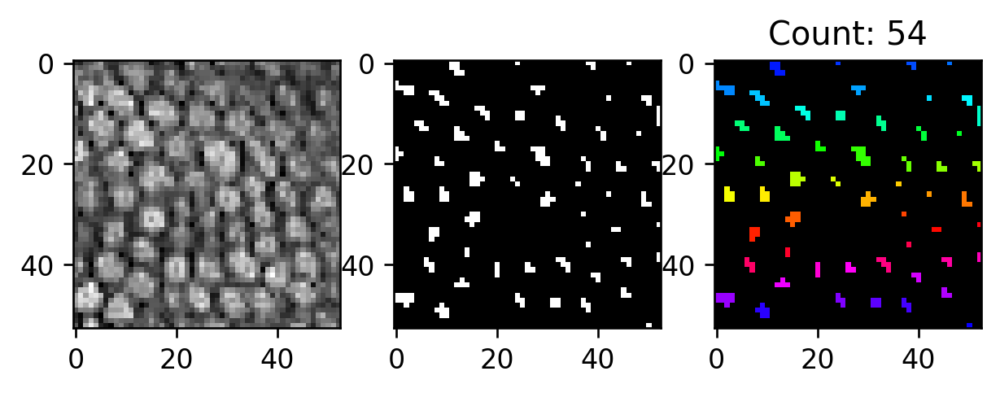

bs 17.0
it 1.0


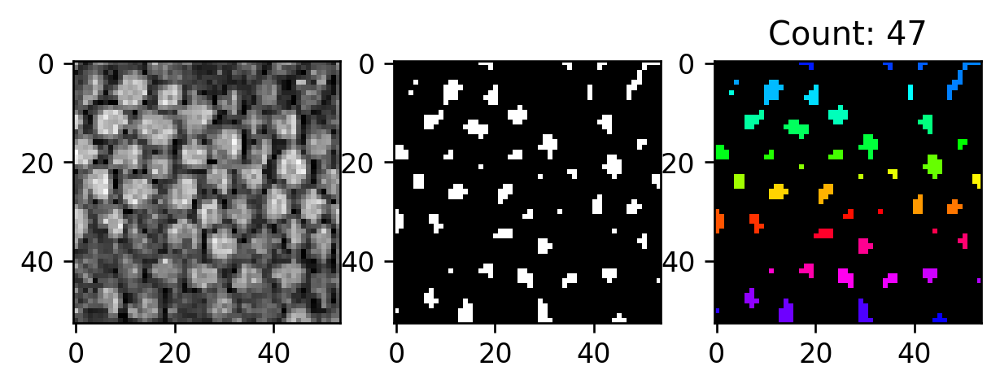

bs 65.0
it 4.0


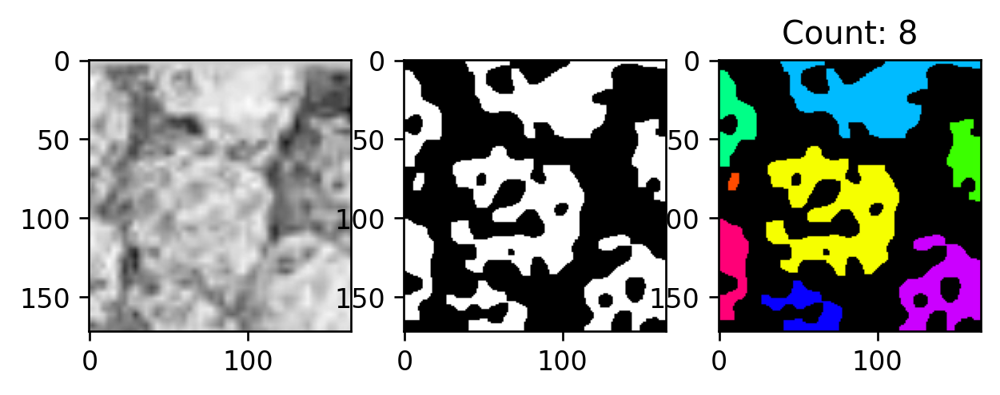

bs 19.0
it 1.0


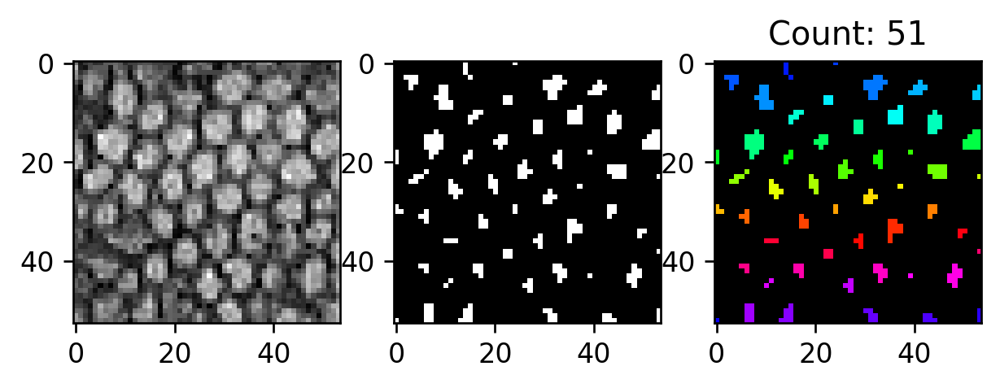

bs 57.0
it 4.0


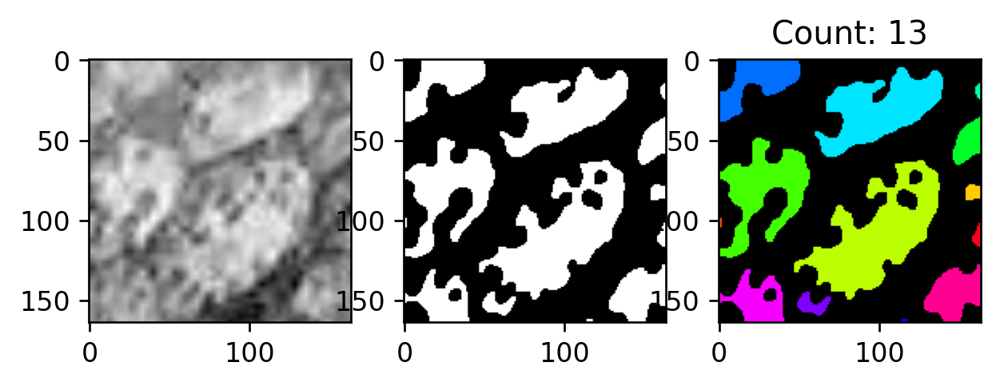

bs 67.0
it 4.0


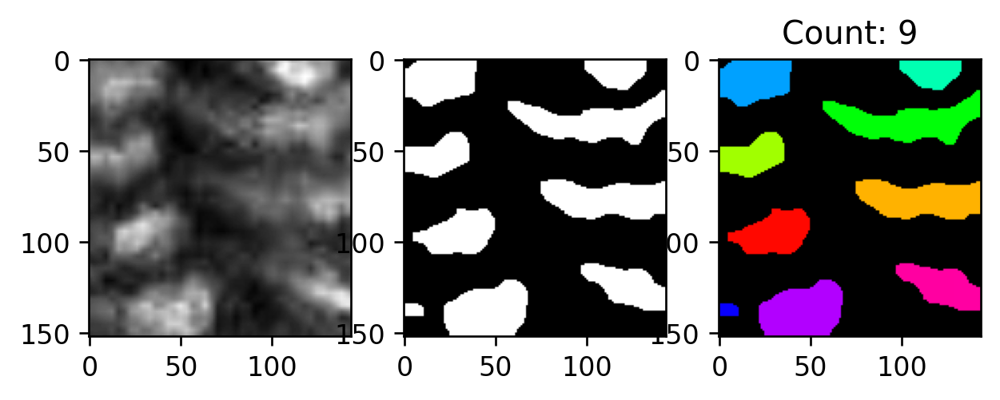

bs 27.0
it 2.0


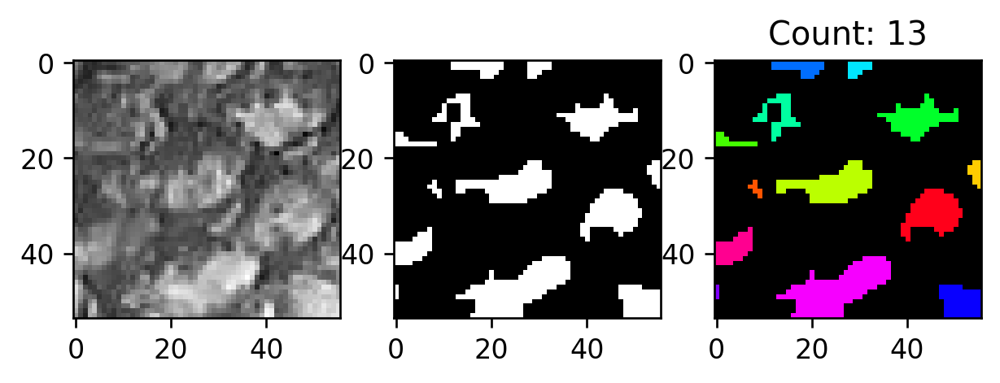

bs 29.0
it 2.0


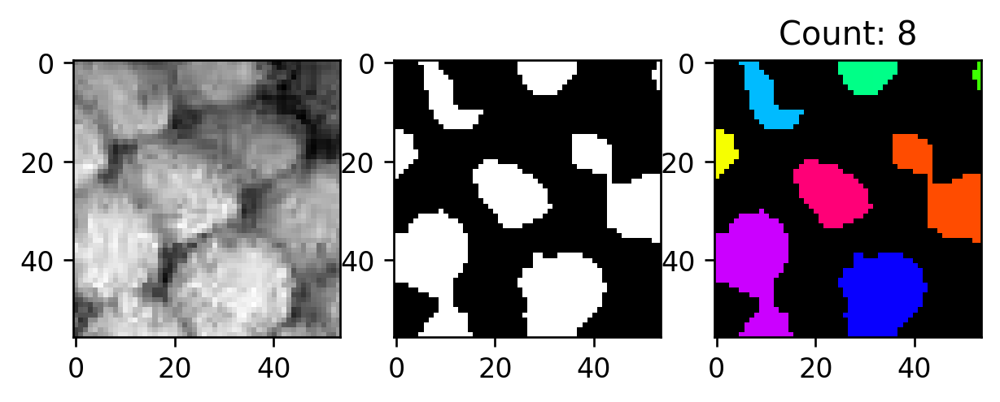

bs 97.0
it 6.0


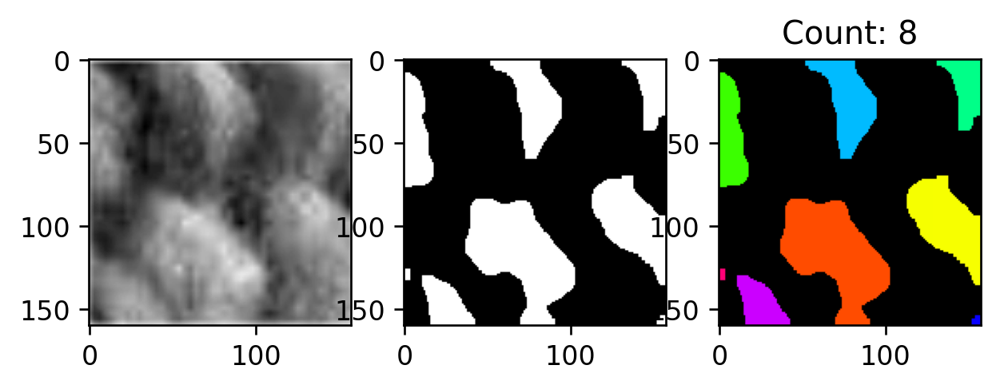

bs 19.0
it 1.0


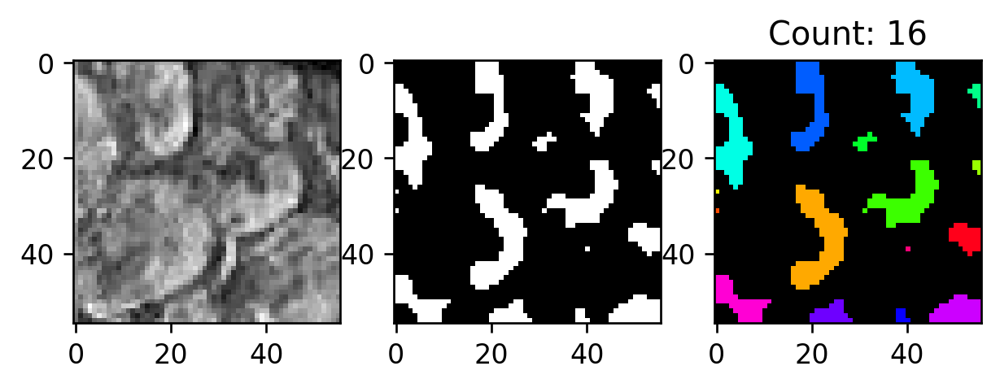

bs 33.0
it 2.0


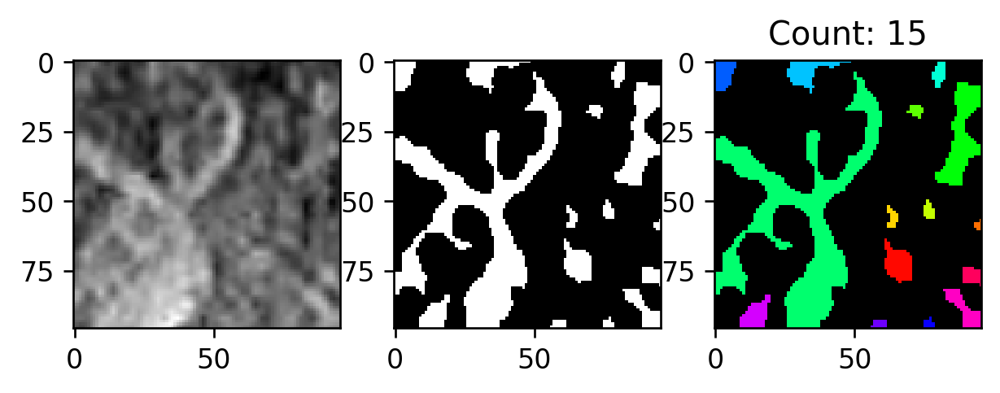

bs 61.0
it 4.0


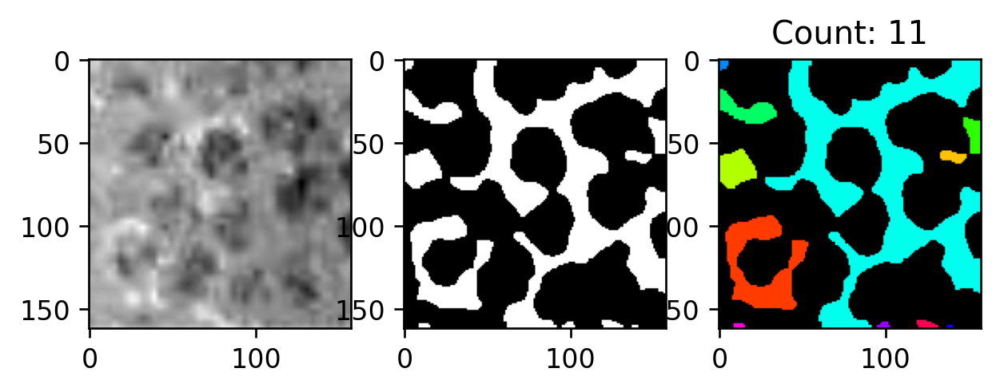

bs 53.0
it 4.0


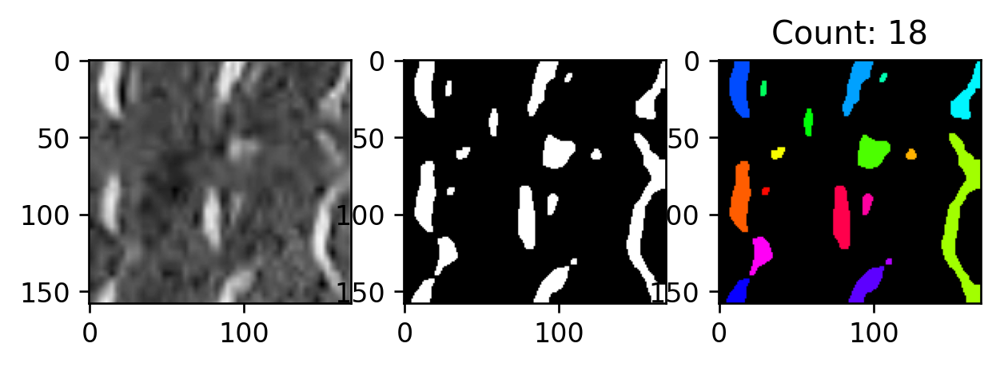

bs 59.0
it 4.0


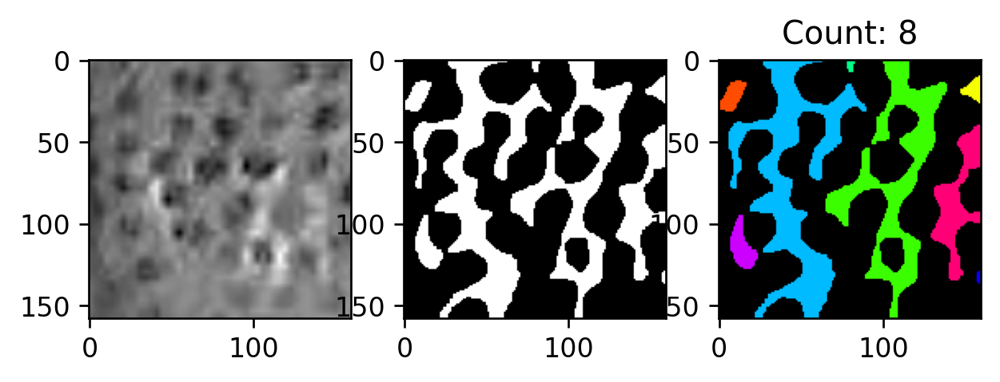

In [14]:
#to do this plotting method, should determine which factors are important: features will be the dimentionality of the array


#uniformity seems important, average size important

print(len(inverted_standard_deviations))
#maybe chooses either uniforminty ort the other
dirname = 'Anolis_cristatellus_images/'
directory = os.scandir(dirname)

block_size =  average_shortest_distance_squared + np.sqrt(average_sizes)
print(average_shortest_distance_squared + np.sqrt(average_sizes))

#print(average_sizes)
thr = []

index = 0
customized = [2,3]
for img in directory:
    img_name = img.name
    if (img_name != '.ipynb_checkpoints'):
        if(len(customized) > 0):
            image_names.append(img.name)
            
            #read the image, convert to grayscale add to array and title + blur
            
           
            img = cv2.imread(dirname + "" + img_name)
            if inverted_standard_deviations[index] + inverted_size_stds[index] < standard_deviations[index] + size_stds[index]:
                print("inverted")
                img = invert(img)
                
            original_img1.append(img)
            
            gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
            original_img.append(gray)
            title = img_name
            
            
            img = gray
            
            blur = cv2.GaussianBlur(img,(5,5),0)
            if average_sizes[index] > 20:
                blur = cv2.bilateralFilter(blur,15,15,100)
            
            filter_img.append(blur)
     
                
            #if customed block size has been determined
            
            if np.round(block_size[index]) % 2 != 1:
                block_size[index] = np.round(block_size[index]) + 1
            
            print("bs", np.round(block_size[index]))
            print("it", np.round(block_size[index]/15))
       
            thresh = cv2.adaptiveThreshold(blur, 255, cv2.ADAPTIVE_THRESH_MEAN_C, cv2.THRESH_BINARY, np.round(block_size[index]).astype(int), -2)
                
            kernel = np.ones((3,3),np.uint8)

            #if customized array is greater than size 0 iteration number has been determined
            opening = cv2.morphologyEx(thresh,cv2.MORPH_OPEN,kernel, iterations=np.round(block_size[index]/25).astype(int))

            
            # sure background area
            sure_bg = cv2.dilate(opening,kernel,iterations=1)

            # Finding sure foreground area: What does cv2.DIST do?
            dist_transform = cv2.distanceTransform(opening,cv2.DIST_L2,5)
            ret, sure_fg = cv2.threshold(dist_transform, 1.5, 255, 0) 

            # Finding unknown region
            sure_fg = np.uint8(sure_fg)
            unknown = cv2.subtract(sure_bg,sure_fg)
            
            #adding sure_fg binarization to list of images
            images.append(sure_fg)

            plt.subplot(1,3,1), plt.imshow(gray, 'gray')
            plt.subplot(1,3,2), plt.imshow(sure_fg, 'gray')
            
            
            # Label and count (taken from maggie's code)
            # source: https://medium.com/analytics-vidhya/images-processing-segmentation-and-objects-counting-in-an-image-with-python-and-opencv-216cd38aca8e
            count, labels = cv2.connectedComponents(sure_fg)                
            count = count - 1 # background doesn't count as a scale
            label_hue = np.uint8(179 * labels / np.max(labels))
            blank_ch = 255 * np.ones_like(label_hue)
            labeled_img = cv2.merge([label_hue, blank_ch, blank_ch])
            labeled_img = cv2.cvtColor(labeled_img, cv2.COLOR_HSV2BGR)
            labeled_img[label_hue == 0] = 0
            
            if(len(customized) != 0):
                labeled_imgs.append(labeled_img)

            plt.subplot(1, 3, 3), plt.imshow(labeled_img, 'gray')
            plt.title('Count: ' + str(count))
            plt.show()
            index += 1
            thr.append(sure_fg)
            
            
    

In [15]:
#https://stackoverflow.com/questions/13391073/adaptive-threshold-of-blurry-image

In [16]:
#maybe blocksize should be calculated from the average area around the specific point: the surrounding block
#the smallest? distance
average_size = []
scale_num_per_img = []
sizes_of_scales = []
total_stats = []
averages = []

print(len(images))
#iterates through images to determine average size and count of scales in␣initial binarization
for i in np.arange(len(thr)):    
    img = thr[i]
    #plt.imshow(img)
    #plt.show()
    binary_map = (img > 0).astype(np.uint8)
    connectivity = 4 # or whatever you prefer
    output = cv2.connectedComponentsWithStats(binary_map, connectivity, cv2.CV_32S)
    num_labels = output[0]
    # The second cell is the label matrix
    labels = output[1]
    # The third cell is the stat matrix
    stats = output[2]
    # The fourth cell is the centroid matrix
    centroids = output[3]
    #print("Sizes of all scales:", stats[1:,-1])
    #print("Number of scales detected (including noise)", num_labels - 1)
    #print("Average size of scales: ", np.average(stats[1:,-1]))
    #print("\n")
    sizes_of_scales.append((stats[1:,-1]))
    average_size.append(([num_labels, np.average(stats[1:,-1])]))
    averages.append(np.average(stats[1:,-1]))
    total_stats.append([num_labels,stats[1:,-1], stats[1:,-1]])
    


110


In [17]:
def overlay(bw_img, color_mask, w1=0.2, w2=0.95):
    a = cv2.cvtColor(bw_img, cv2.COLOR_GRAY2RGB)
    a -= np.min(a)
    a = a/np.max(a)*255
    a = np.clip(a, a_min=0, a_max=255).astype(int)
    #a = np.array([[i.tolist()+[0] if np.max(i)==0 else i.tolist()+[255] for i␣,in j] for j in a])
    b = np.clip(color_mask, a_min=0, a_max=255).astype(int)
    #b = np.array([[i.tolist()+[255] for i in j] for j in b])
    c = cv2.addWeighted(b,w1,a,w2,0)
    return c

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


TRYING TO CLEAN UP THE IMAGES AND REMOVE SMALL SPECKELS: SHOULD TAKE INTO ACCOUNT DISTANCE AND SIZE
Images 110
2
scales: 12
n,a [13, 90.0]
90.0


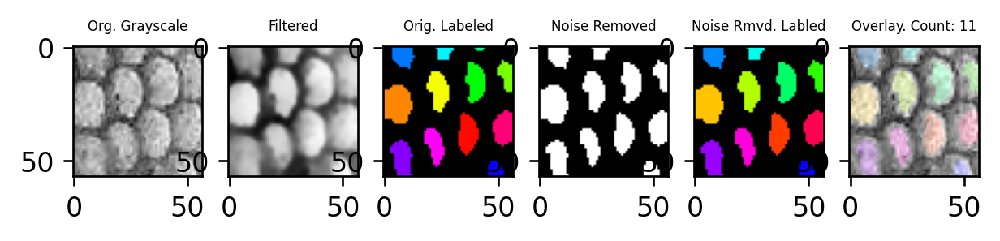

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2
scales: 37
n,a [38, 7.4324324324324325]
7.4324324324324325


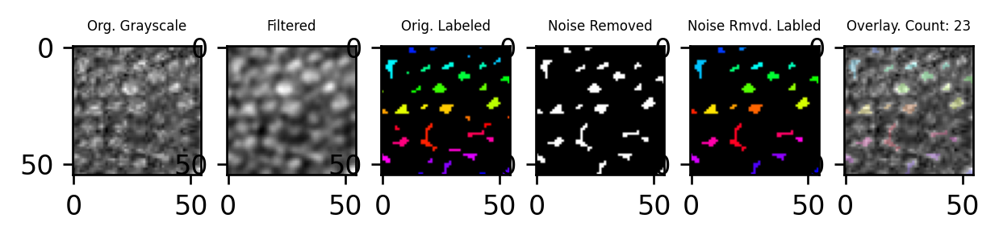

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2
scales: 10
n,a [11, 712.0]
712.0


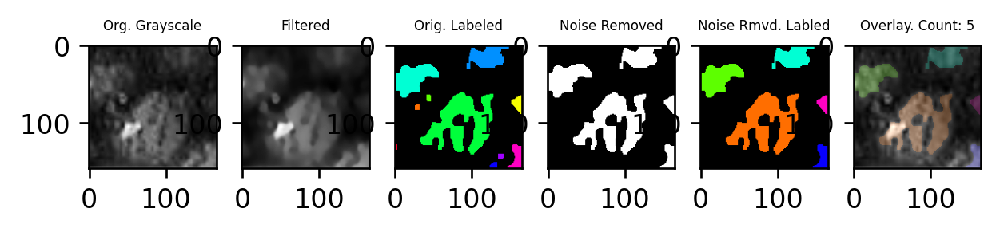

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2
scales: 14
n,a [15, 593.3571428571429]
593.3571428571429


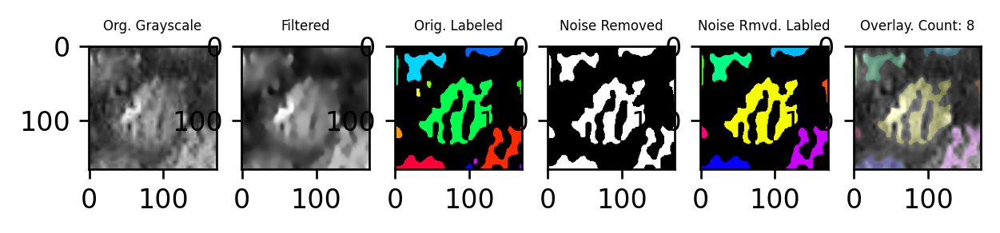

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2
scales: 50
n,a [51, 6.28]
6.28


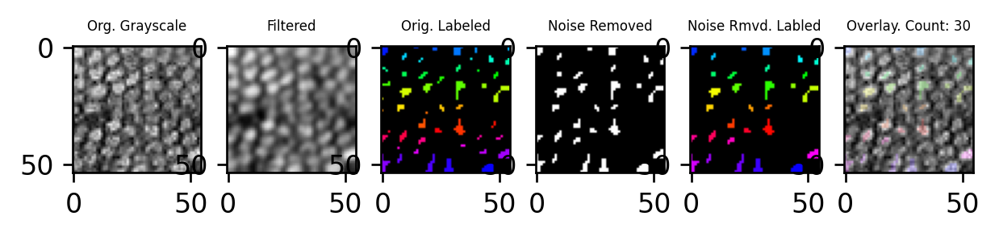

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2
scales: 50
n,a [51, 5.82]
5.82


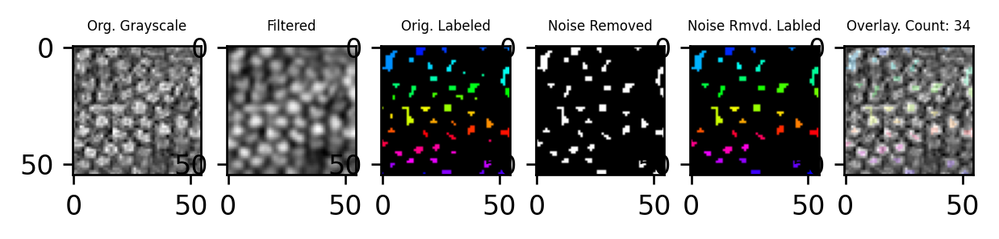

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2
scales: 51
n,a [52, 5.078431372549019]
5.078431372549019


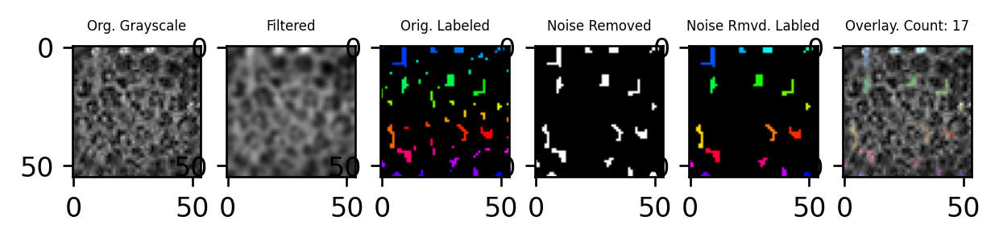

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2
scales: 12
n,a [13, 739.25]
739.25


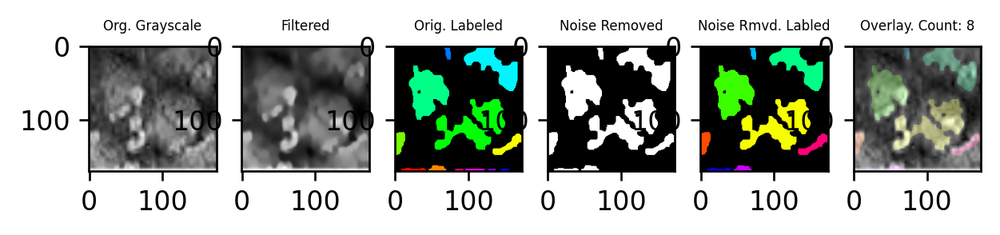

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2
scales: 19
n,a [20, 396.7368421052632]
396.7368421052632


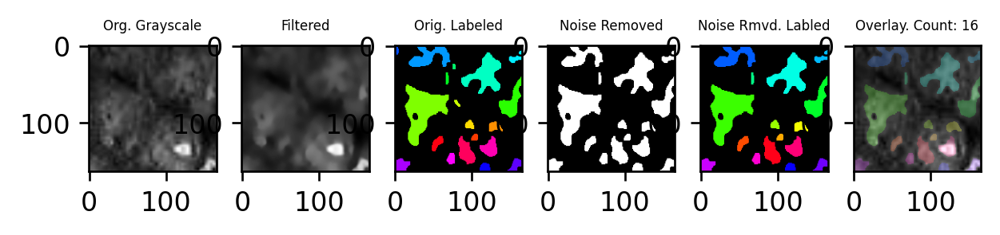

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2
scales: 36
n,a [37, 8.777777777777779]
8.777777777777779


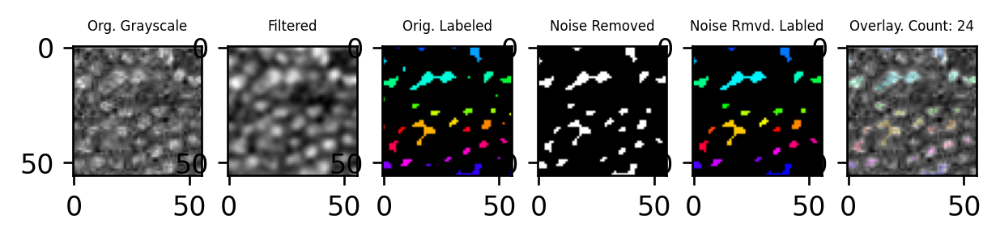

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2
scales: 14
n,a [15, 81.14285714285714]
81.14285714285714


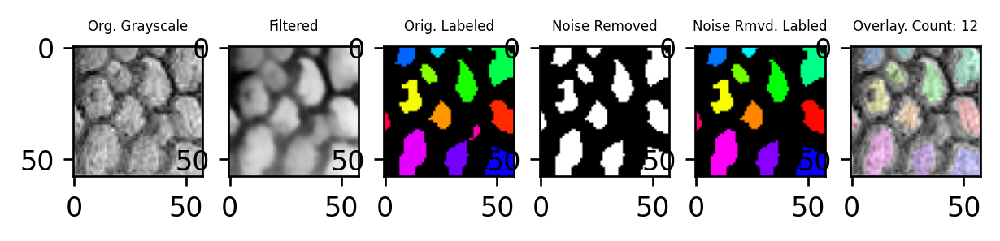

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2
scales: 36
n,a [37, 7.388888888888889]
7.388888888888889


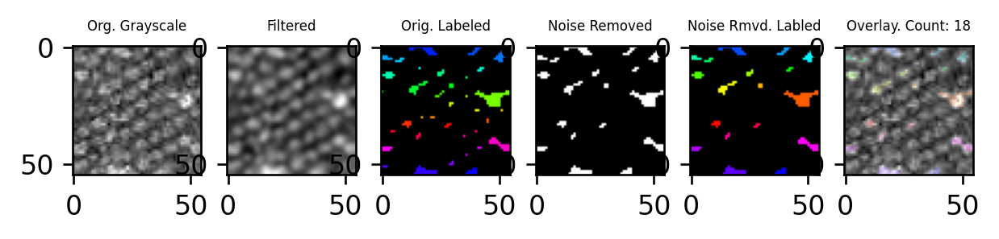

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2
scales: 17
n,a [18, 406.7647058823529]
406.7647058823529


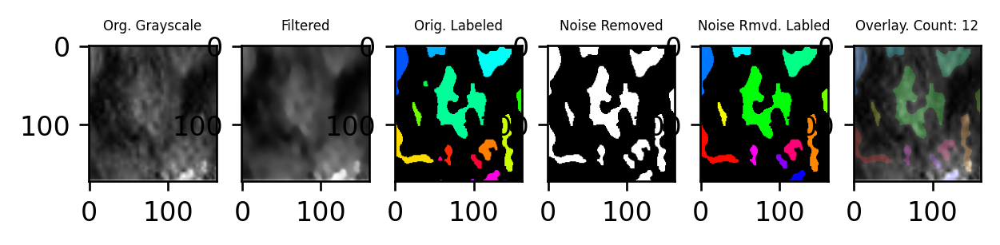

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2
scales: 36
n,a [37, 8.88888888888889]
8.88888888888889


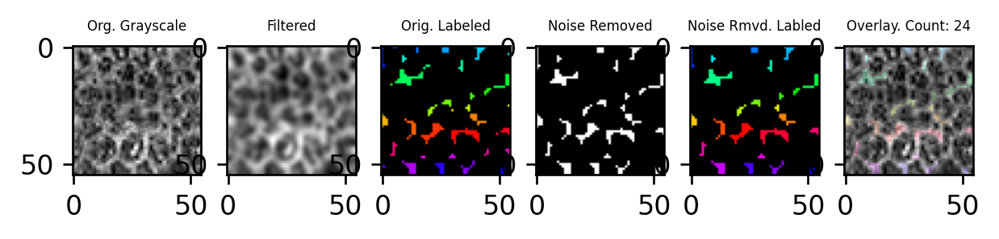

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2
scales: 49
n,a [50, 6.183673469387755]
6.183673469387755


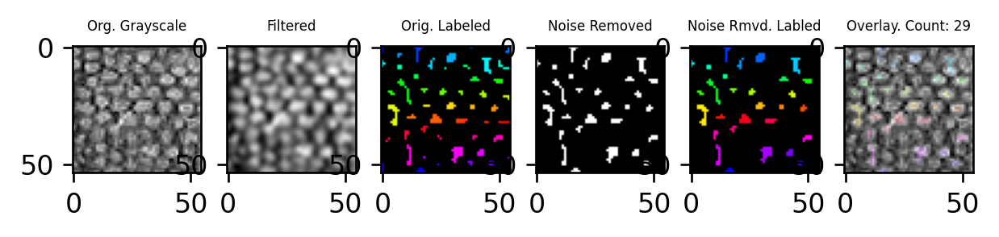

2
scales: 40
n,a [41, 7.1]
7.1


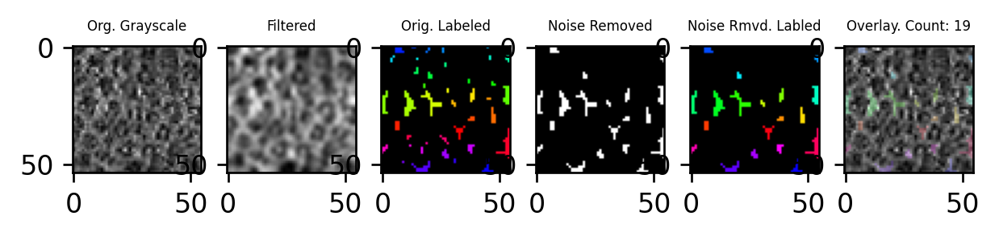

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2
scales: 16
n,a [17, 534.0]
534.0


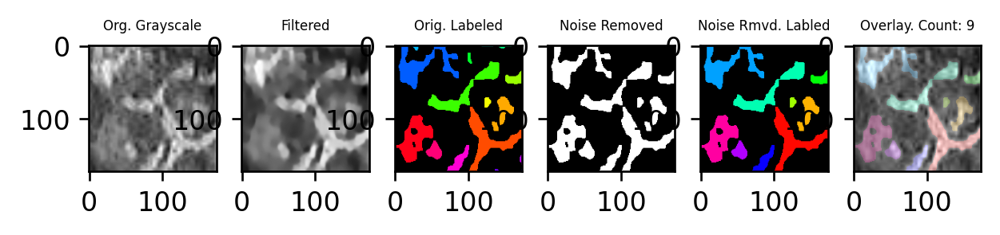

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2
scales: 10
n,a [11, 97.7]
97.7


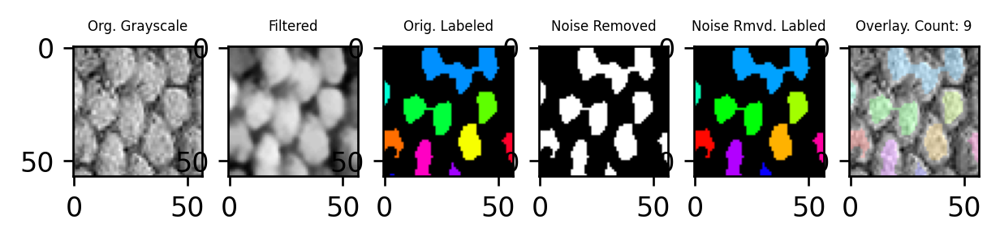

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2
scales: 35
n,a [36, 205.37142857142857]
205.37142857142857


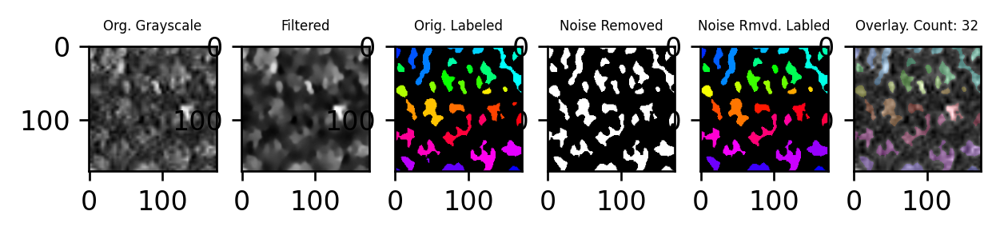

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2
scales: 29
n,a [30, 272.41379310344826]
272.41379310344826


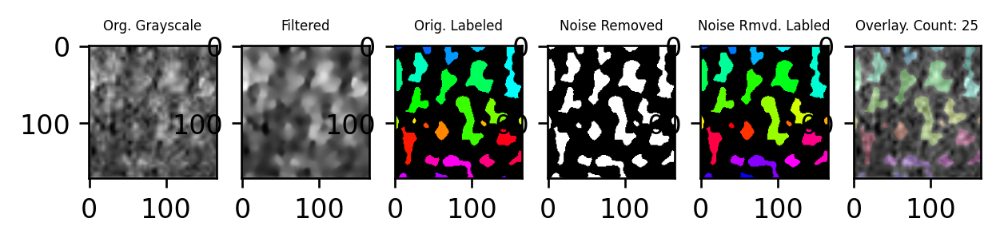

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2
scales: 39
n,a [40, 182.97435897435898]
182.97435897435898


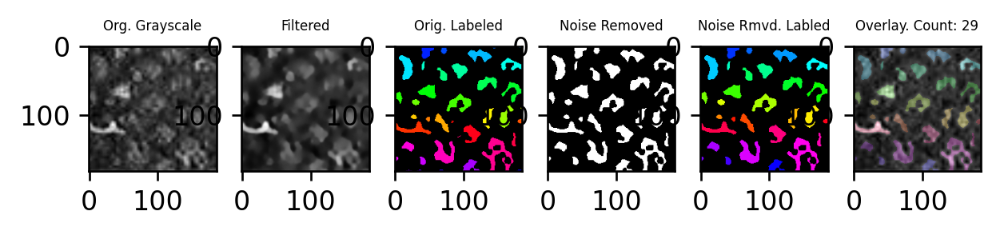

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2
scales: 36
n,a [37, 208.0]
208.0


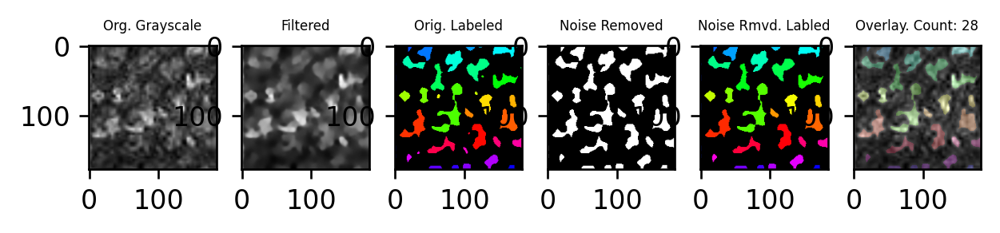

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2
scales: 46
n,a [47, 115.56521739130434]
115.56521739130434


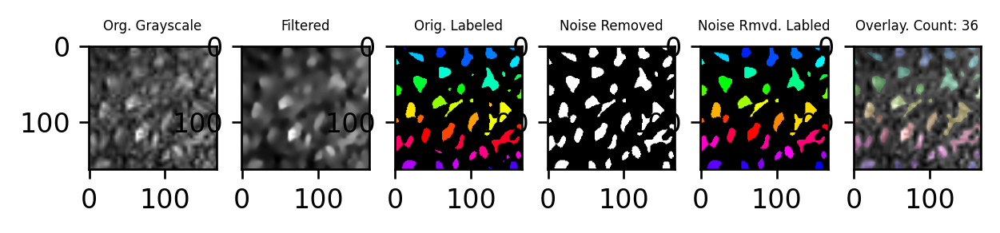

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2
scales: 31
n,a [32, 185.38709677419354]
185.38709677419354


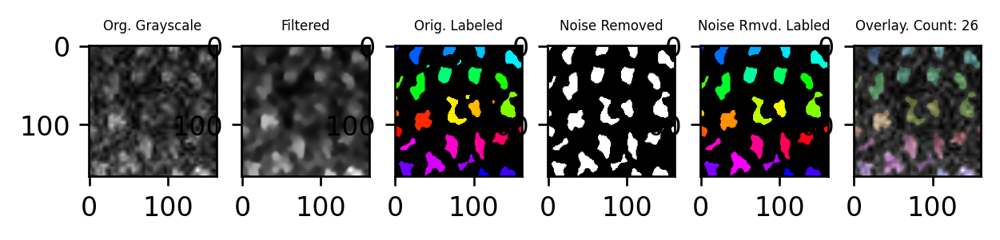

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2
scales: 22
n,a [23, 14.545454545454545]
14.545454545454545


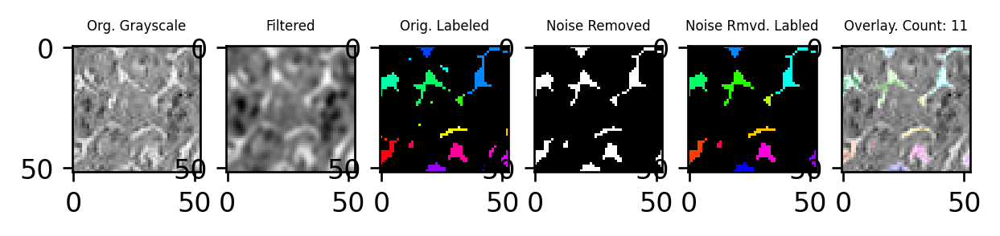

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2
scales: 48
n,a [49, 125.75]
125.75


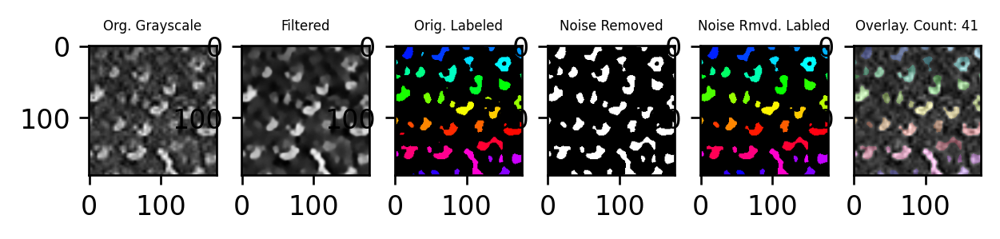

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2
scales: 14
n,a [15, 73.85714285714286]
73.85714285714286


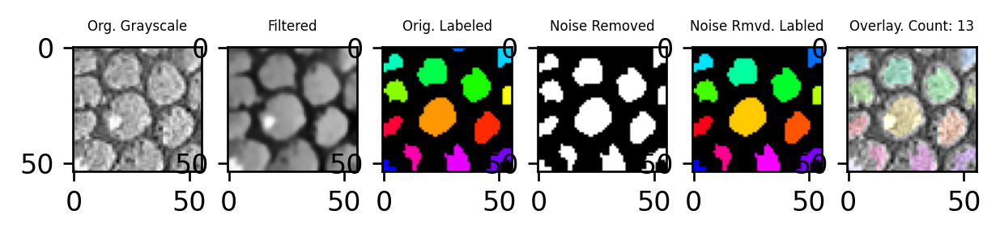

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2
scales: 42
n,a [43, 162.92857142857142]
162.92857142857142


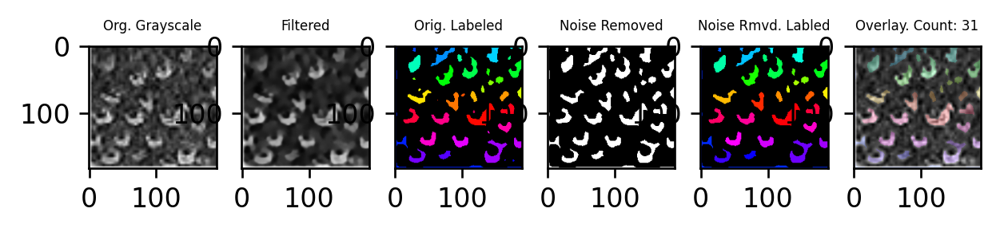

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2
scales: 28
n,a [29, 172.17857142857142]
172.17857142857142


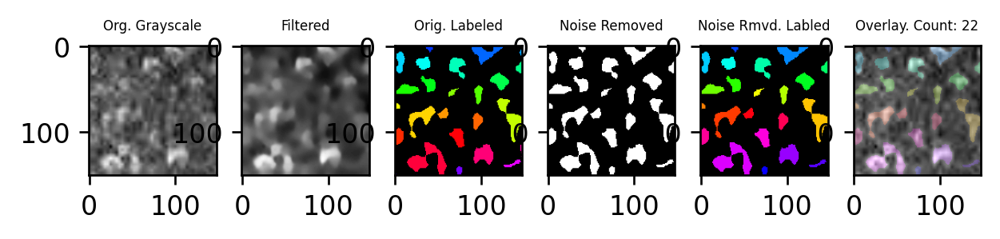

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2
scales: 17
n,a [18, 33.470588235294116]
33.470588235294116


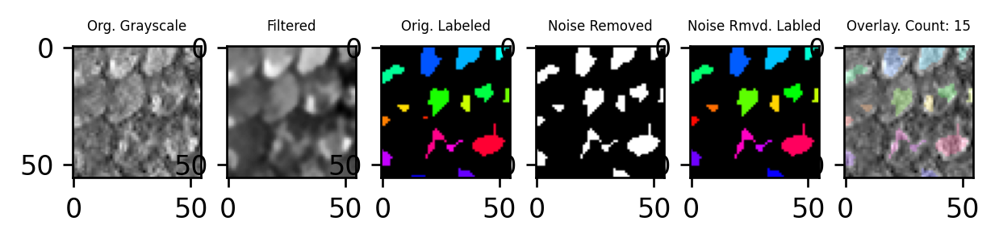

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2
scales: 12
n,a [13, 28.75]
28.75


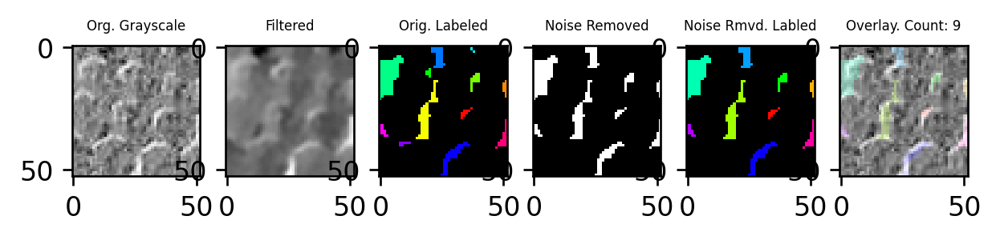

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2
scales: 19
n,a [20, 40.78947368421053]
40.78947368421053


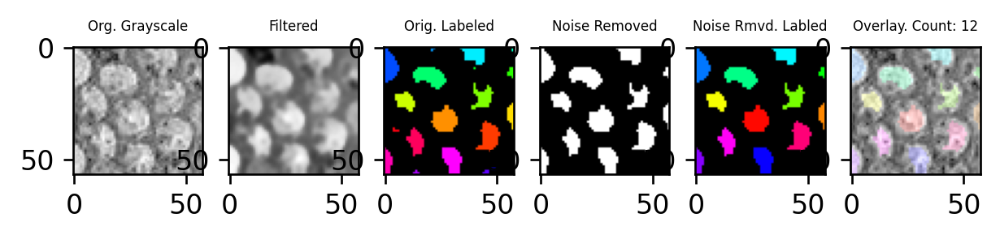

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2
scales: 23
n,a [24, 292.5652173913044]
292.5652173913044


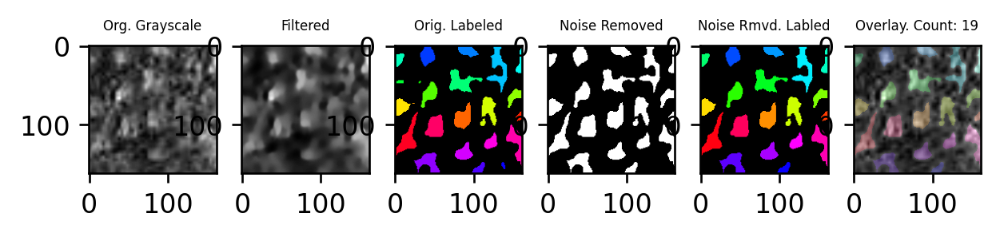

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2
scales: 21
n,a [22, 322.7142857142857]
322.7142857142857


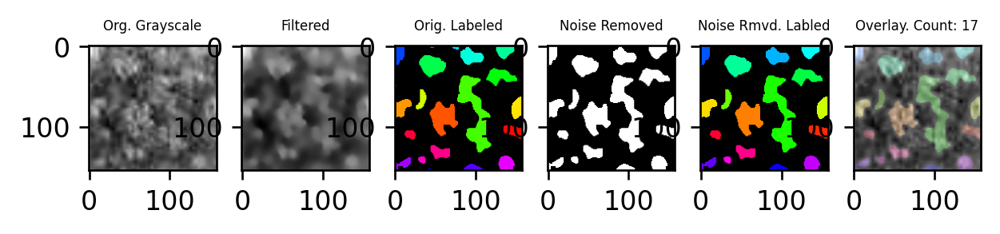

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2
scales: 44
n,a [45, 194.54545454545453]
194.54545454545453


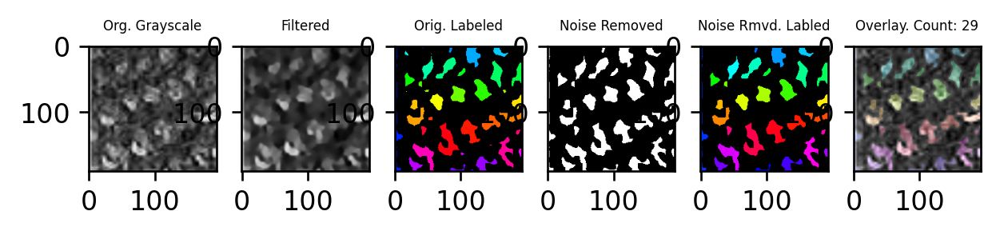

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2
scales: 13
n,a [14, 49.38461538461539]
49.38461538461539


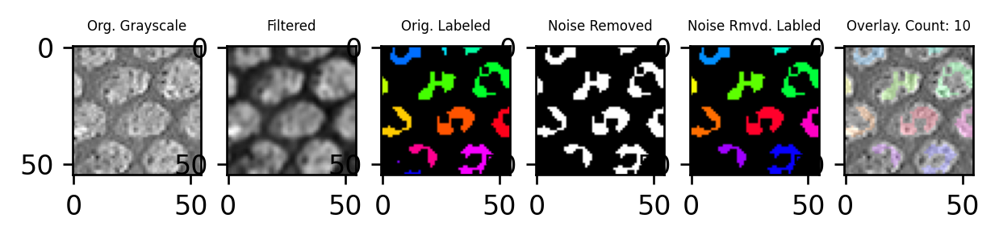

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2
scales: 22
n,a [23, 31.363636363636363]
31.363636363636363


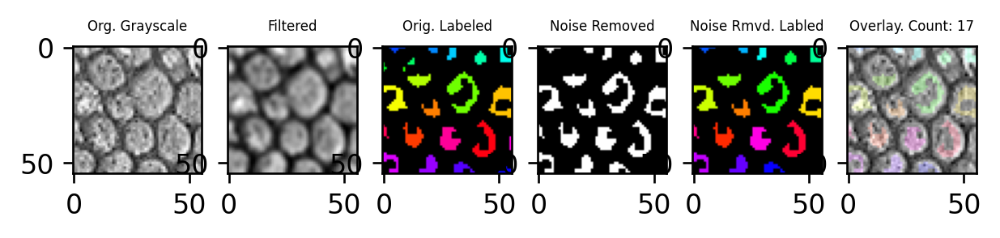

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2
scales: 35
n,a [36, 150.37142857142857]
150.37142857142857


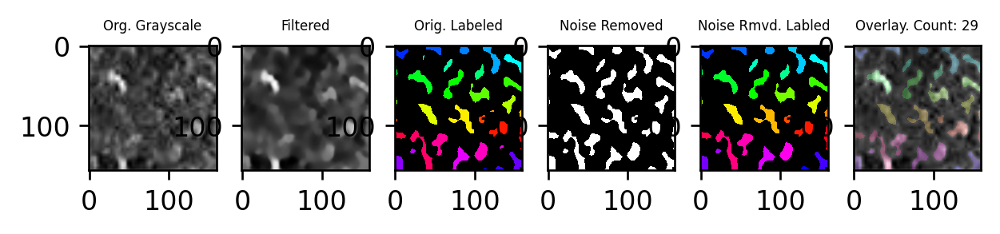

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2
scales: 16
n,a [17, 51.0]
51.0


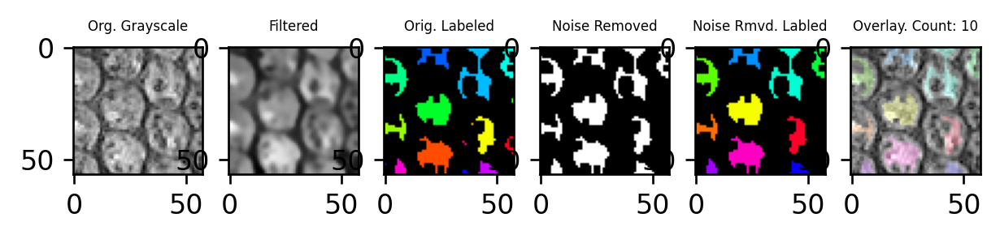

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2
scales: 16
n,a [17, 24.25]
24.25


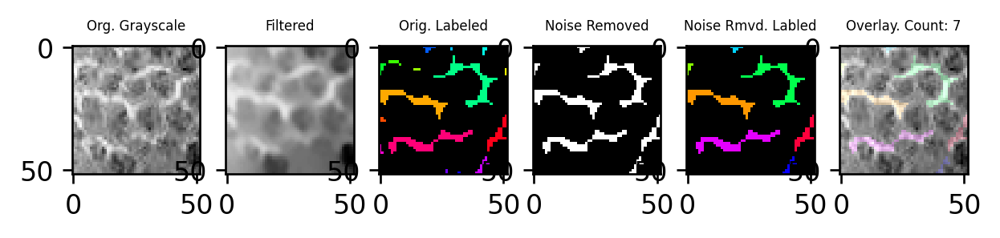

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2
scales: 18
n,a [19, 508.6111111111111]
508.6111111111111


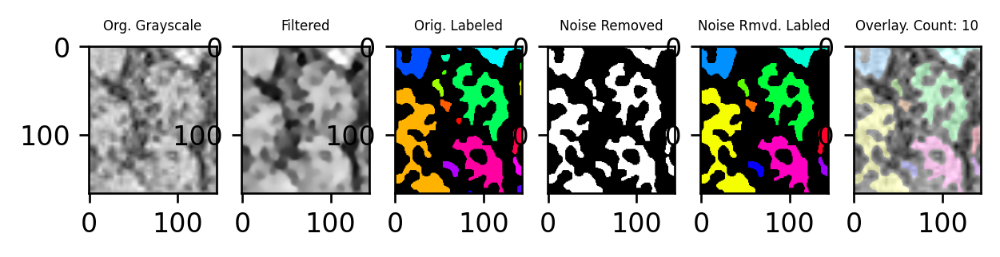

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2
scales: 54
n,a [55, 3.685185185185185]
3.685185185185185


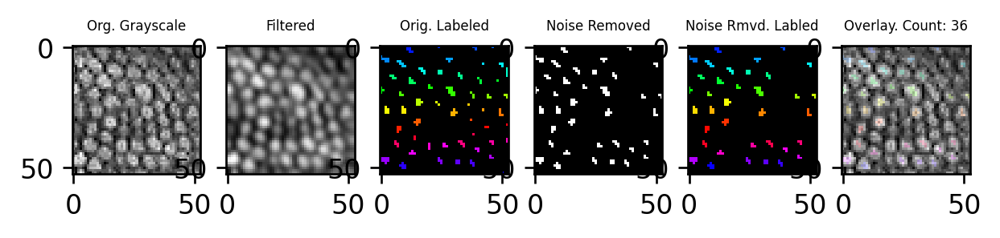

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2
scales: 47
n,a [48, 5.9787234042553195]
5.9787234042553195


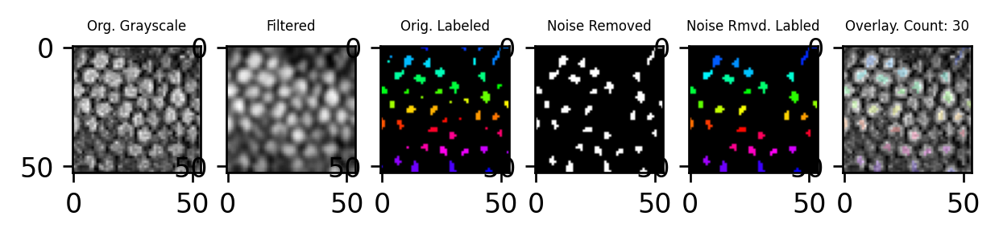

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2
scales: 8
n,a [9, 1447.25]
1447.25


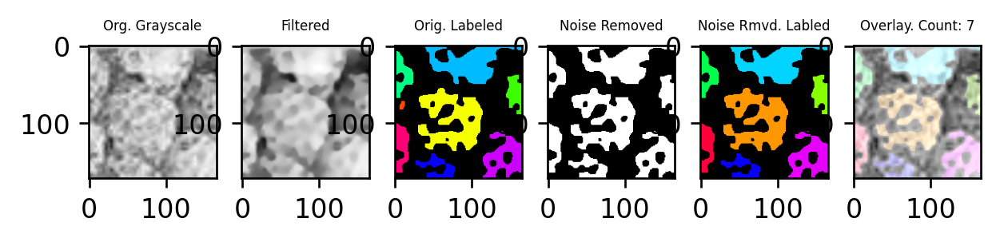

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2
scales: 51
n,a [52, 5.666666666666667]
5.666666666666667


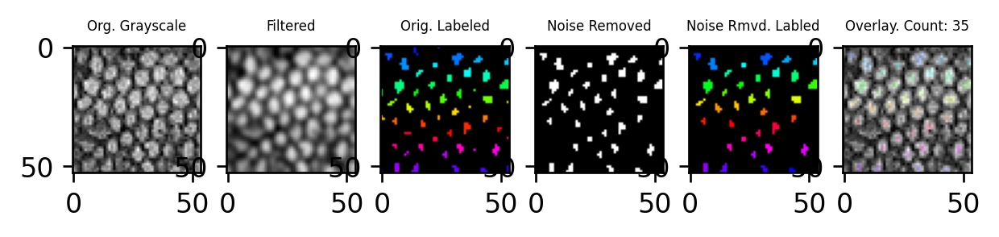

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2
scales: 13
n,a [14, 823.7692307692307]
823.7692307692307


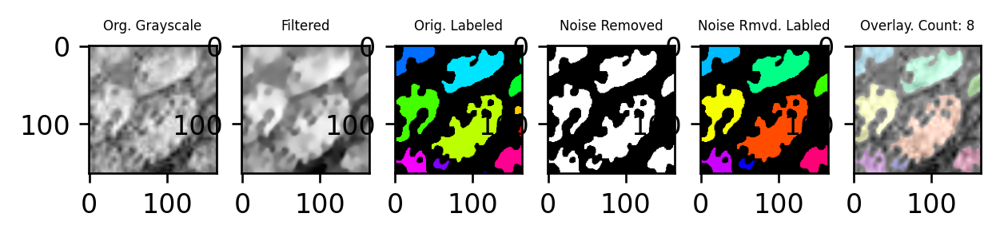

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2
scales: 9
n,a [10, 783.7777777777778]
783.7777777777778


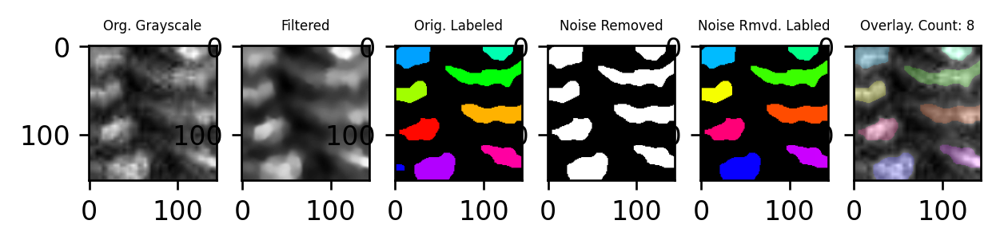

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2
scales: 13
n,a [14, 48.23076923076923]
48.23076923076923


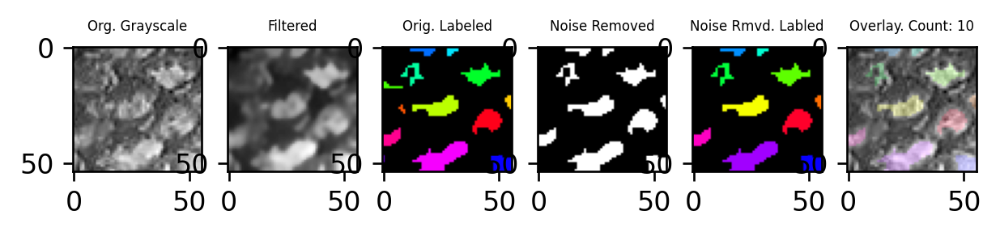

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2
scales: 8
n,a [9, 126.125]
126.125


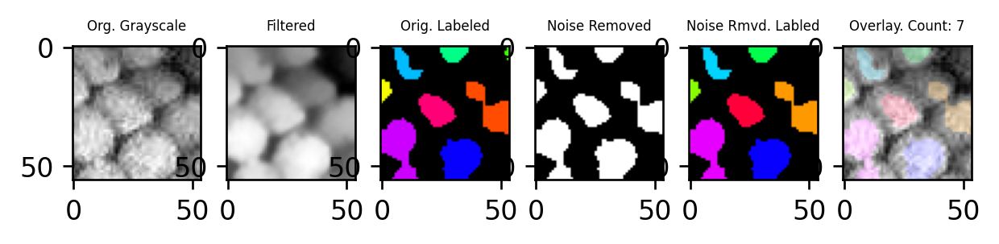

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2
scales: 8
n,a [9, 997.875]
997.875


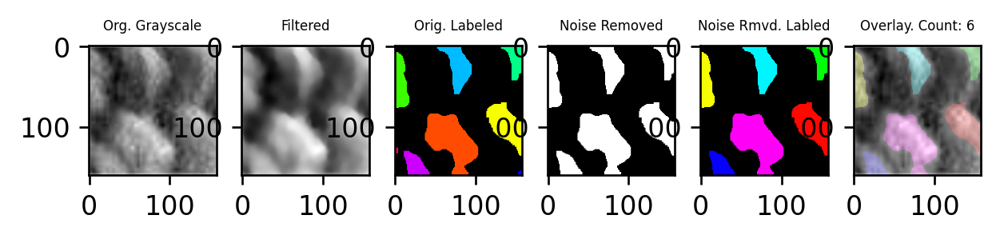

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2
scales: 16
n,a [17, 42.1875]
42.1875


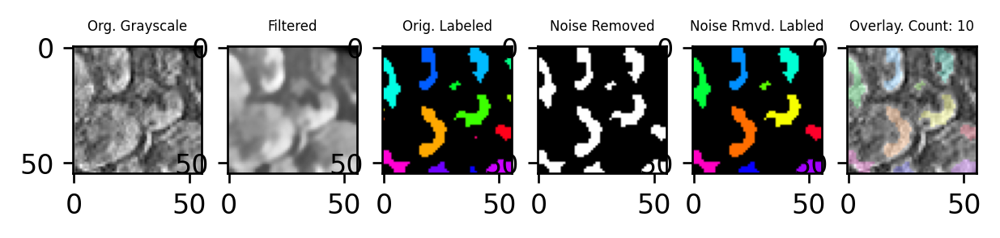

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2
scales: 15
n,a [16, 156.2]
156.2


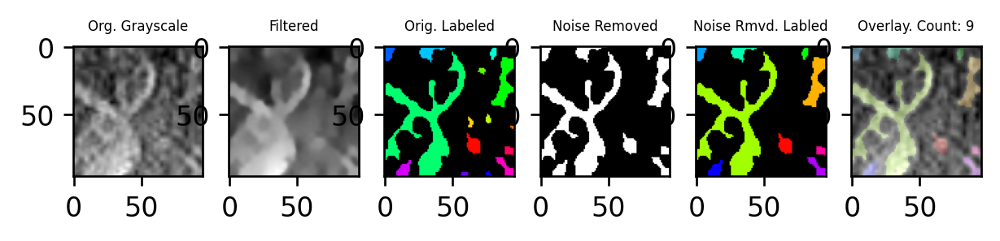

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2
scales: 11
n,a [12, 792.4545454545455]
792.4545454545455


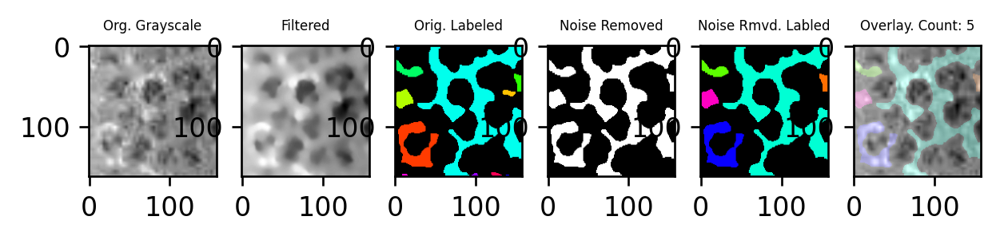

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2
scales: 18
n,a [19, 230.77777777777777]
230.77777777777777


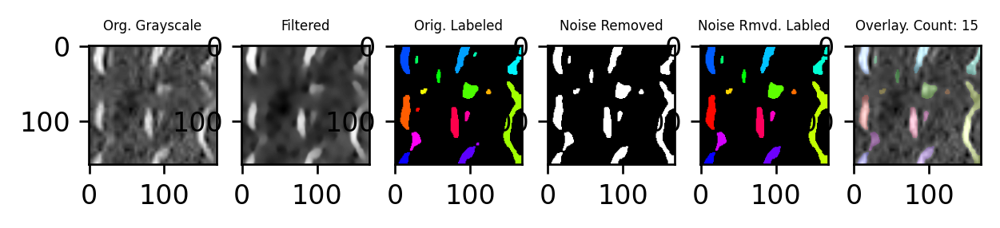

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2
scales: 8
n,a [9, 1069.25]
1069.25


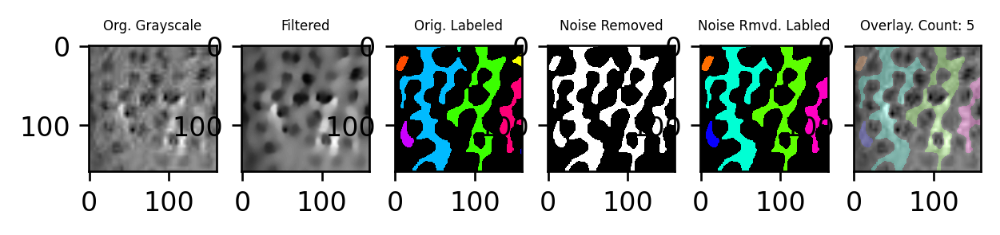

In [18]:
without_r = []
#find a way to draw the contors to see what is detected
#use a different thing????

print("TRYING TO CLEAN UP THE IMAGES AND REMOVE SMALL SPECKELS: SHOULD TAKE INTO ACCOUNT DISTANCE AND SIZE")

index = 0;
final_counts = []

print("Images", len(images))
for img in thr:
    binary_map = (img > 0).astype(np.uint8)
    connectivity = 4 # or whatever you prefer
    output = cv2.connectedComponentsWithStats(binary_map, connectivity, cv2.CV_32S)
    stats = output[2]


    kernel = np.ones((3,3),np.uint8)
    #opening = cv2.morphologyEx(img, cv2.MORPH_OPEN, kernel, iterations=1)
    #closing = cv2.morphologyEx(opening, cv2.MORPH_CLOSE, kernel, iterations = 1)

    
    #review: what exactly does this do?
    cnts = cv2.findContours(img, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
    print(len(cnts))
    cnts = cnts[0] if len(cnts) == 2 else cnts[1]

    
    print("scales:", len(cnts))
    print("n,a", average_size[index])
    
    
    for c in cnts:
        area = cv2.contourArea(c)
        if area < (averages[index]/10):
            img = cv2.drawContours(img, [c], -1, (0,0,0), -1)
            
    print(averages[index])



    plt.subplot(1,6,1), plt.imshow(original_img[index], 'gray')
    plt.title("Org. Grayscale", fontsize=5)
    plt.subplot(1,6,2), plt.imshow(filter_img[index], 'gray')
    plt.title("Filtered", fontsize=5)
    plt.subplot(1,6,3), plt.imshow(labeled_imgs[index], 'gray')
    plt.title("Orig. Labeled", fontsize=5)
    plt.subplot(1,6,4), plt.imshow(img, 'gray')
    plt.title("Noise Removed", fontsize=5)


    # Label and count (taken from maggie's code)
    # source: https://medium.com/analytics-vidhya/images-processing-segmentation-and-objects-counting-in-an-image-with-python-and-opencv-216cd38aca8e
    count, labels = cv2.connectedComponents(img)                
    count = count - 1 # background doesn't count as a scale
    label_hue = np.uint8(179 * labels / np.max(labels))
    blank_ch = 255 * np.ones_like(label_hue)
    labeled_img = cv2.merge([label_hue, blank_ch, blank_ch])
    labeled_img = cv2.cvtColor(labeled_img, cv2.COLOR_HSV2BGR)
    labeled_img[label_hue == 0] = 0
    without_r.append(labeled_img)

    plt.subplot(1, 6, 5), plt.imshow(labeled_img, 'gray')
    plt.title("Noise Rmvd. Labled", fontsize=5)
    plt.subplot(1, 6, 6), plt.imshow(overlay(original_img[index], labeled_img))
    
    final_counts.append(count)
    plt.title("Overlay. Count: " + str(count), fontsize=5)
    
    

    plt.show()
    index = index + 1





In [38]:
def trial(names):
    trials = []
    for name in names:
        trials.append("Trial " + str(name[-5]))
    return trials

In [39]:
def shorten(image_names):
    short_image_names = []
    for name in image_names:
        short_image_names.append(str(name[0:-6]))
    return short_image_names

In [40]:
short_image_names = shorten(image_names)
trial_num = Table().with_column("Img Name", short_image_names).group("Img Name").sort("Img Name").column("count")
data = Table().with_columns("Img Name", short_image_names, "trial", trial(image_names), "Counts", final_counts)
data = data.sort("Img Name")
data = data.pivot("trial", "Img Name", "Counts", sum).with_column("# Trials", trial_num)
data = data.with_column("Average", (data.column("Trial 1") + data.column("Trial 2") + data.column("Trial 3") + data.column("Trial 4"))/(data.column("# Trials")))

data.show()

Img Name,Trial 1,Trial 2,Trial 3,Trial 4,# Trials,Average
212010Ventral-NoFlash,10,10,7,0,3,9
212018Dorsal-NoFlash,29,34,30,0,3,31
212018Ventral-NoFlash,13,17,10,0,3,13.3333
212019Dorsal-NoFlash,18,23,24,0,3,21.6667
212019Ventral-NoFlash,9,12,11,0,3,10.6667
212020Dorsal-NoFlash,35,30,36,0,3,33.6667
212020Ventral-NoFlash,15,10,12,0,3,12.3333
214993Dorsal-NoFlash,17,19,24,0,3,20
214993Ventral-Flash,7,9,11,0,3,9
214993Ventral-NoFlash,5,5,15,0,3,8.33333


In [41]:
actual = [10, 60, 13, 55, 14, 48, 14, 41, 14, 18, 15, 6, 21, 19, 7, 21, 5, 5]

In [42]:
data = data.with_columns("Hand Counted Average", actual, "% Dif", abs(data.column("Average")/actual))
dif = abs(data.column("Average")/actual)
data.show()

Img Name,Trial 1,Trial 2,Trial 3,Trial 4,# Trials,Average,Hand Counted Average,% Dif
212010Ventral-NoFlash,10,10,7,0,3,9,10,0.9
212018Dorsal-NoFlash,29,34,30,0,3,31,60,0.516667
212018Ventral-NoFlash,13,17,10,0,3,13.3333,13,1.02564
212019Dorsal-NoFlash,18,23,24,0,3,21.6667,55,0.393939
212019Ventral-NoFlash,9,12,11,0,3,10.6667,14,0.761905
212020Dorsal-NoFlash,35,30,36,0,3,33.6667,48,0.701389
212020Ventral-NoFlash,15,10,12,0,3,12.3333,14,0.880952
214993Dorsal-NoFlash,17,19,24,0,3,20,41,0.487805
214993Ventral-Flash,7,9,11,0,3,9,14,0.642857
214993Ventral-NoFlash,5,5,15,0,3,8.33333,18,0.462963


### data.hist("% Dif")

In [19]:
#thoughtss
#average shortest distance works when not super big and super small: everything is roughtly the same size, or there are
#some lumps that otsu did not catch: where things are unfortunatley smushed together: it is better at preserving scales that
#multiple big clumps = scales, and not noise: one big clump = probably noise